In [1609]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

154


In [1610]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [1611]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [1641]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [1642]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [1643]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [1644]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,7271857,7413.0,269770.0,696.0,4181078.0,"+4,865",2821009,20403.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,South America,6201039,945.0,200051.0,92.0,4773295.0,"+1,835",1227693,15134.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
2,NaN,Asia,6903437,14561.0,139831.0,197.0,5527657.0,"+29,372",1235949,18867.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
3,NaN,Europe,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1241912,NaN,29472.0,NaN,972908.0,NaN,239532,1264.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [1645]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
225,NaN,Total:,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
226,NaN,Total:,1241912,NaN,29472.0,NaN,972908.0,NaN,239532,1264.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
227,NaN,Total:,28391,131.0,640.0,11.0,23166.0,262,4585,44.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
228,NaN,Total:,721,NaN,15.0,NaN,651.0,NaN,55,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
229,NaN,European Union,1856497,2094.0,139833.0,7.0,786766.0,NaN,362382,2423.0,4169.556107,314.054663,56121134.0,126043.951069,NaN,Europe,NaN,NaN,NaN


In [1646]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,7271857,7413.0,269770.0,696.0,4181078.0,"+4,865",2821009,20403.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,South America,6201039,945.0,200051.0,92.0,4773295.0,"+1,835",1227693,15134.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
2,NaN,Asia,6903437,14561.0,139831.0,197.0,5527657.0,"+29,372",1235949,18867.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
3,NaN,Europe,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1241912,NaN,29472.0,NaN,972908.0,NaN,239532,1264.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [1647]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
133,127.0,Lithuania,2839,0.0,86.0,0.0,1833.0,0,920,5.0,1045.0,32.0,634751.0,233729.0,"2,715,752",Europe,957,"31,579",4


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


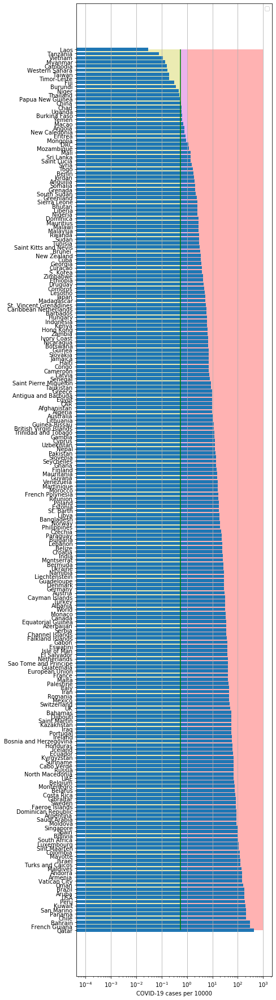

In [1648]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


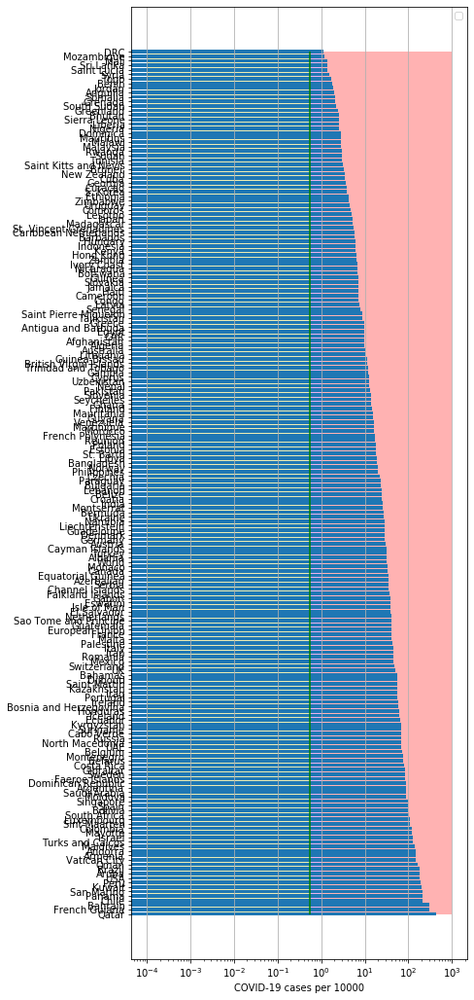

In [1649]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

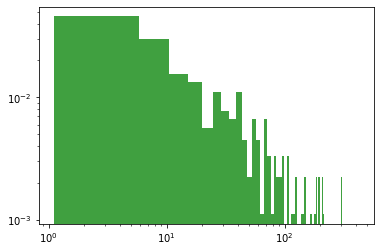

In [1650]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [1651]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
182 2020-08-25  423224       0  28924.0
183 2020-08-26  426818       0  28971.0
184 2020-08-27  451792       0  28996.0
185 2020-08-28  455621       0  29011.0
186 2020-08-29  455621       0  29011.0
GB
           date   cases  active    death
181 2020-08-25  327798       0  41449.0
182 2020-08-26  328846       0  41465.0
183 2020-08-27  330368       0  41477.0
184 2020-08-28  331644       0  41486.0
185 2020-08-29  332752       0  41498.0
IT
           date   cases  active    death
184 2020-08-25  261174   19714  35445.0
185 2020-08-26  262540   20753  35458.0
186 2020-08-27  263949   21932  35463.0
187 2020-08-28  265409   23035  35472.0
188 2020-08-29  266853   23156  35473.0
LT
           date   cases  active  death     tests
169 2020-08-25  2726.0     847   85.0  618405.0
170 2020-08-26  2762.0     875   85.0  623841.0
171 2020-08-27  2810.0     908   86.0  629443.0
172 2020-08-28  2839.0     920   86.0  634751.0
173 2020-08-29  2839.0  

FI
           date   cases  active  death
182 2020-08-25  7981.0     546  335.0
183 2020-08-26  8002.0     467  335.0
184 2020-08-27  8019.0     484  335.0
185 2020-08-28  8042.0     507  335.0
186 2020-08-29  8077.0     542  335.0
ID
           date    cases    active    death
178 2020-08-25  3235725  707405.0  59632.0
179 2020-08-26  3314953  729783.0  60652.0
180 2020-08-27  3392295  745540.0  61725.0
181 2020-08-28  3468272  755901.0  62750.0
182 2020-08-29  3546705  768020.0  63690.0
ED
           date     cases   active   death
178 2020-08-25  109030.0   7637.0  6368.0
179 2020-08-26  110549.0   9042.0  6410.0
180 2020-08-27  111219.0   9546.0  6471.0
181 2020-08-28  112141.0  10326.0  6504.0
182 2020-08-29  112906.0  10940.0  6537.0
PH
           date   cases   active   death
171 2020-08-25  202361  65764.0  3137.0
172 2020-08-26  205581  68357.0  3234.0
173 2020-08-27  209544  71835.0  3235.0
174 2020-08-28  213131  74611.0  3419.0
175 2020-08-29  217396  56473.0  3520.0
LX
   

In [1652]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [1653]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.46876735878317377
intercept: 0.4881932700396776
slope: [0.02834347]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


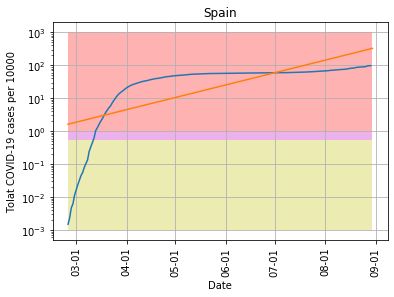

In [1654]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-08-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [1655]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.572176538098186
intercept: -0.8757620142245242
slope: [0.03506117]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


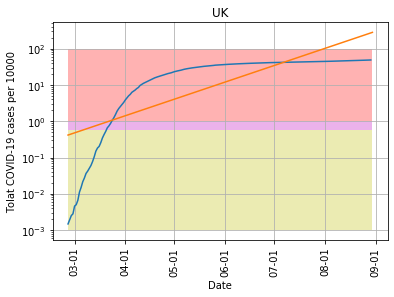

In [1656]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-08-30', "pictures/coronaGB.png", model1, 'UK',100)

In [1657]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.1378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.8472294340720053
intercept: 0.8327498021082258
slope: [-0.02061669]


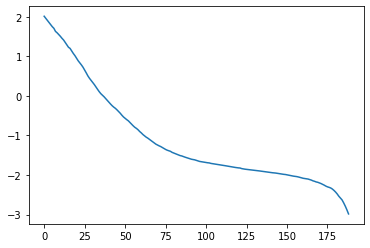

In [1658]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


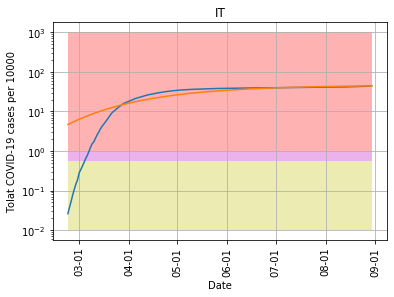

In [1659]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-08-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [1660]:
cs=y_pred11[-1]/10000.*populationIT

In [1661]:
cs

267894.3078781725

In [1662]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.4399092305948091
intercept: -0.19741810539311833
slope: [0.018273]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


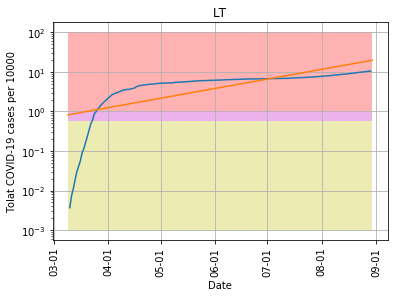

In [1663]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-08-30', "pictures/coronaLT.png", model1, 'LT',100)

In [1664]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7057629764805954
intercept: -2.8026515917832513
slope: [0.04307279]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


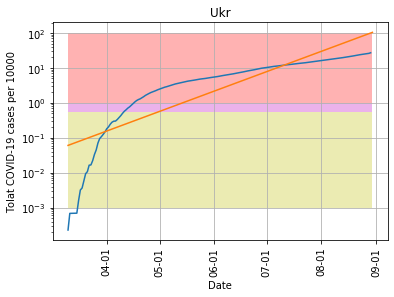

In [1665]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-08-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


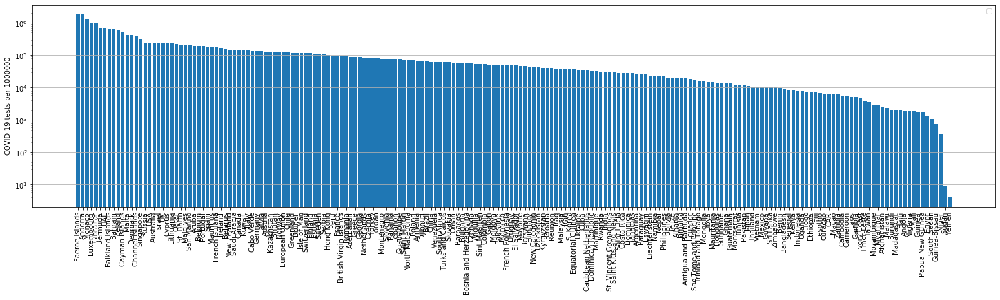

In [1666]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [1667]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6426876285348748
intercept: -0.45949189937102597
slope: [0.03950177]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


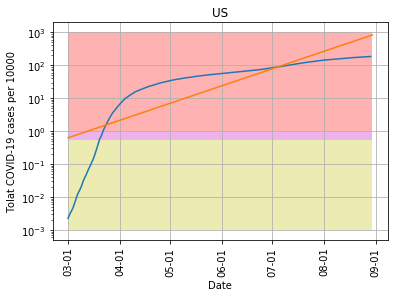

In [1668]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-08-30', "pictures/coronaUS.png", model11, 'US',1000)

In [1669]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.075321


Text(0.5, 1.0, 'Death rate')

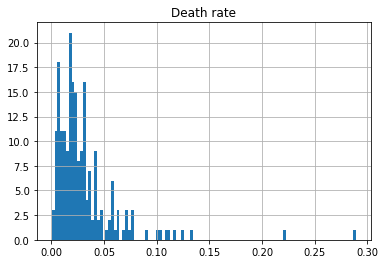

In [1670]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

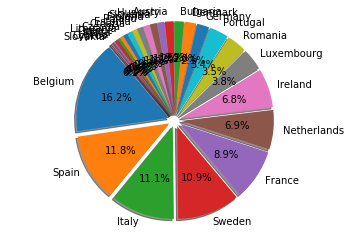

In [1671]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [1672]:
dfTTh.head()

,Country,Deathsper1Mpop
42,Belgium,853.0
15,Spain,620.0
25,Italy,587.0
44,Sweden,576.0
23,France,469.0


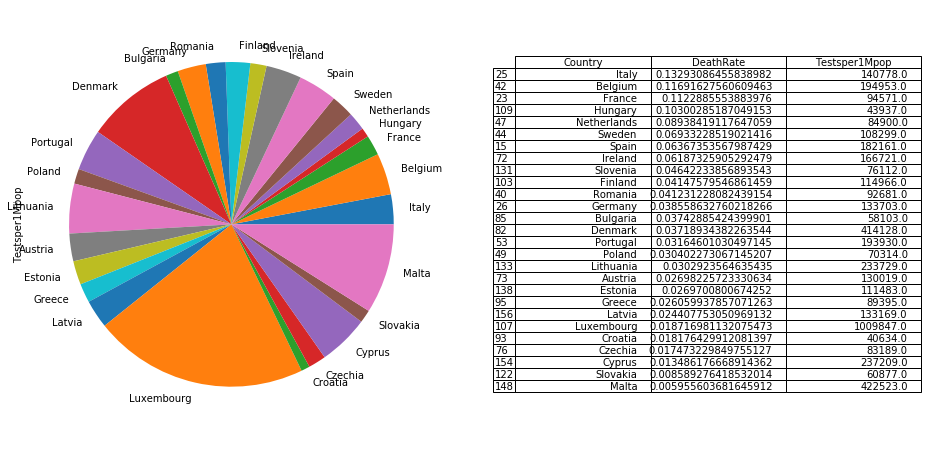

In [1673]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

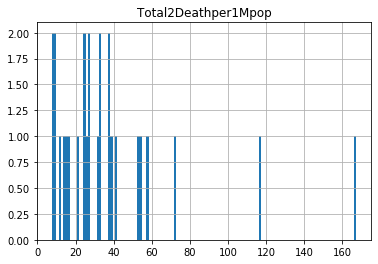

In [1674]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [1675]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,9744.0,620.0
23,France,4174.0,469.0
25,Italy,4415.0,587.0
26,Germany,2897.0,112.0
40,Romania,4467.0,184.0


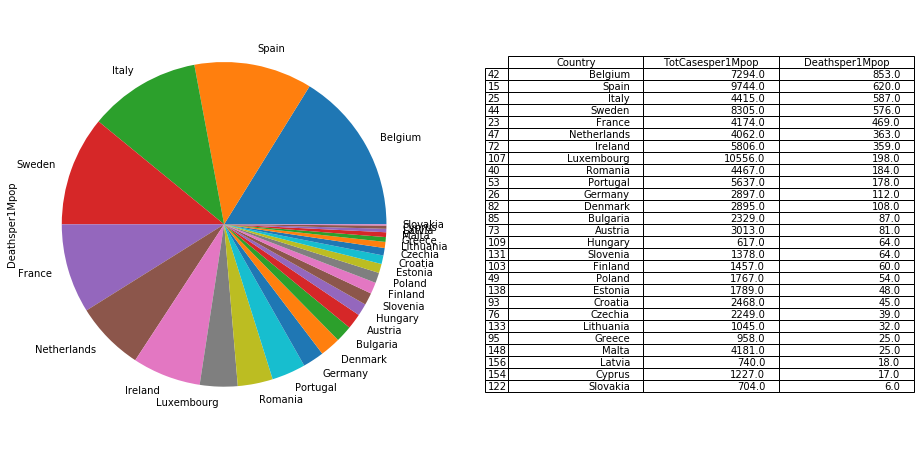

In [1676]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [1677]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,7271857,7413.0,269770.0,696.0,4181078.0,"+4,865",2821009,20403.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,South America,6201039,945.0,200051.0,92.0,4773295.0,"+1,835",1227693,15134.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
2,0.0,Asia,6903437,14561.0,139831.0,197.0,5527657.0,"+29,372",1235949,18867.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
3,0.0,Europe,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1241912,0.0,29472.0,0.0,972908.0,0,239532,1264.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [1678]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.053491
23,France,0.044136
25,Italy,0.031361
26,Germany,0.021667
40,Romania,0.048198


In [1679]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.076686
     Croatia             0.060737
       Spain             0.053491
     Romania             0.048198
 Netherlands             0.047845
      France             0.044136
    Bulgaria             0.040084
     Belgium             0.037414
     Ireland             0.034825
       Italy             0.031361
    Portugal             0.029067
     Czechia             0.027035
      Poland             0.025130
     Austria             0.023174
     Germany             0.021667
    Slovenia             0.018105
     Estonia             0.016047
     Hungary             0.014043
     Finland             0.012673
    Slovakia             0.011564
      Greece             0.010716
  Luxembourg             0.010453
       Malta             0.009895
     Denmark             0.006991
      Latvia             0.005557
      Cyprus             0.005173
   Lithuania             0.004471


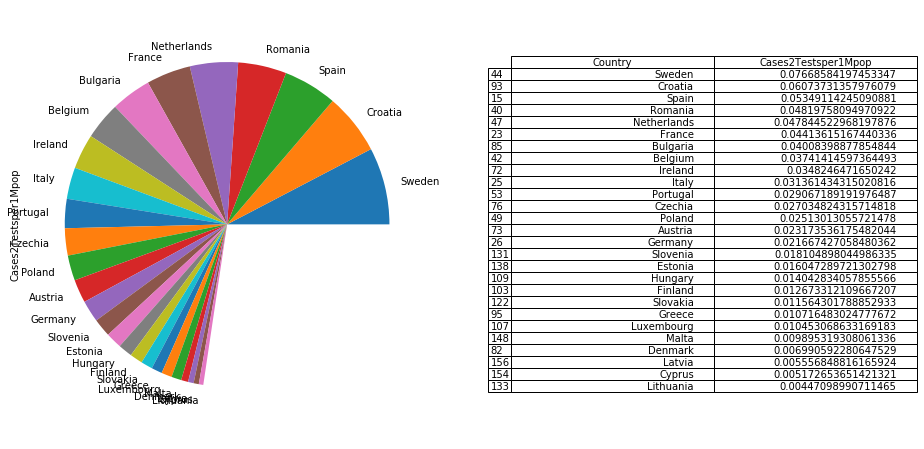

In [1680]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [1681]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
54,Singapore,0.000476,312883.0
32,Qatar,0.001655,220859.0
180,Burundi,0.002247,2064.0
151,Botswana,0.003674,46437.0
56,Bahrain,0.003678,640417.0
...,...,...,...
42,Belgium,0.116916,194953.0
19,UK,0.124711,239508.0
25,Italy,0.132931,140778.0
218,MS Zaandam,0.222222,0.0


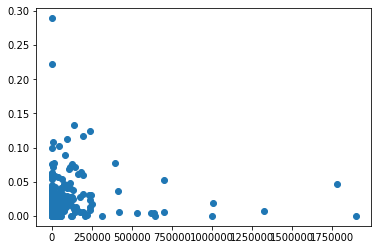

In [1682]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


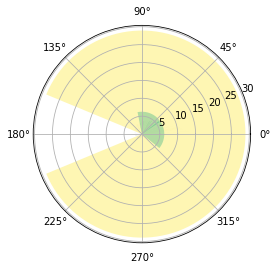

In [1683]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

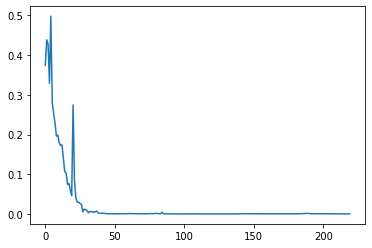

In [1684]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [1685]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


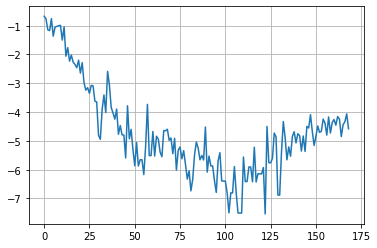

In [1686]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

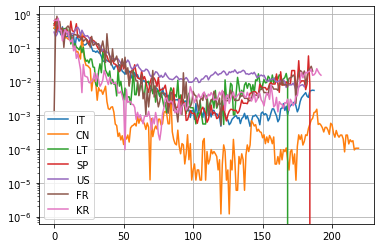

In [1687]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

181 181
coefficient of determination: 0.7038662414598926
intercept: -12.099971475229598
slope: [-0.05672855]


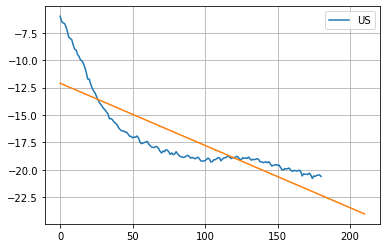

In [1688]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [1689]:
#np.diff(dfIT["cases"])

188 188
coefficient of determination: 0.674927687214216
intercept: -12.400570044750907
slope: [-0.04786713]


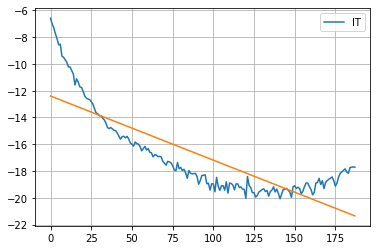

In [1690]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [1691]:
#model11.coef_

In [1692]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

170 170
coefficient of determination: 0.8703732395105731
intercept: -16.193045547350092
slope: [-0.03608053]


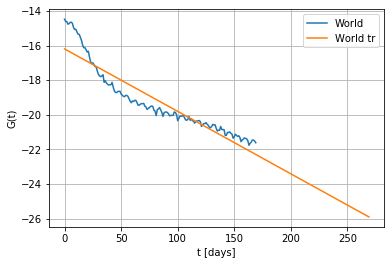

In [1693]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

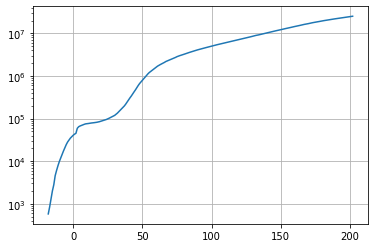

In [1694]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [1695]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.09414858e+08  3.34147825e-01 -2.31594247e+02  2.32048513e-02]


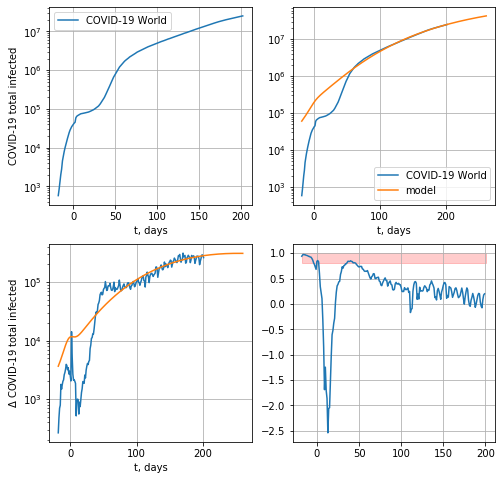

277400.6319969273


In [1696]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

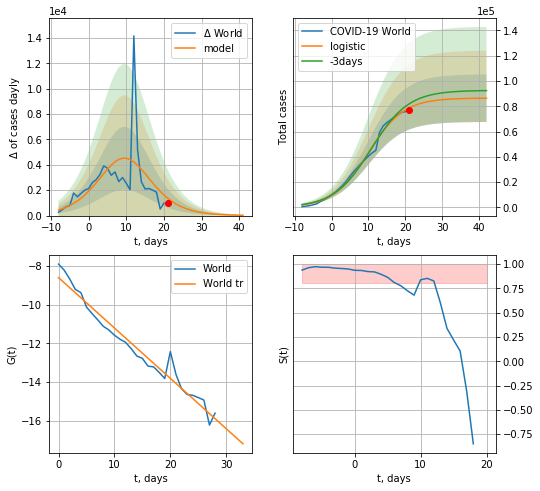

World data at: 2020-08-29
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +21 days
	 deltaDaycases:  24
	 total cases:  86368 ± 18811
	 total death:  2904 ± 1897
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


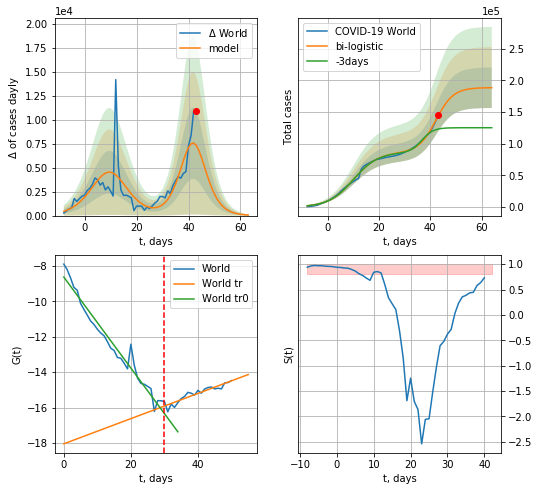

World data at: 2020-08-29
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +21 days
	 deltaDaycases:  56
	 total cases:  188536 ± 32037
	 total death:  6340 ± 3232
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


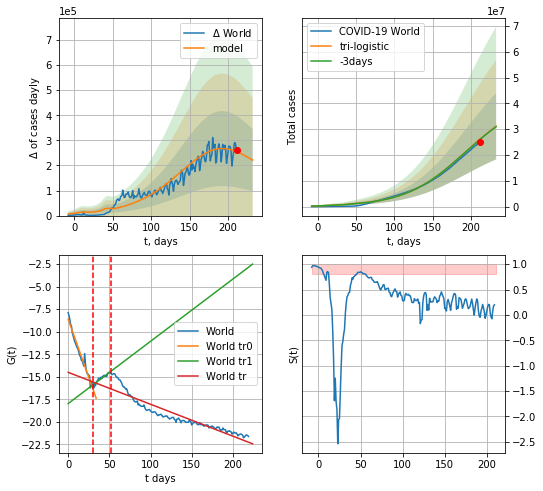

World data at: 2020-08-29
+3 day model MAPE: 0.003743045834671214
model: tri-logistic
coeffs:  [3.77422712e+07 2.63159980e-02 1.87904472e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.4116379304018154
forecast at the end of period: +21 days
	 deltaDaycases:  221008
	 total cases:  31148732 ± 12821999
	 total death:  1047477 ± 1293543
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.870473
 intercept: -14.506312
 slope: -0.035362


In [1698]:
vL = 30
T18 = 25
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

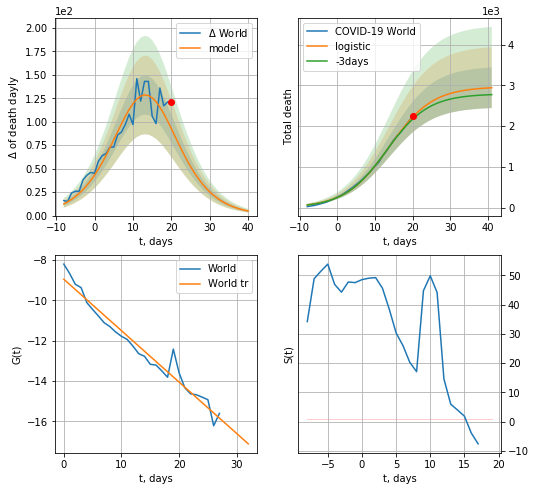

World data at: 2020-08-29
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +21 days
	 total death:  2943 ± 498
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


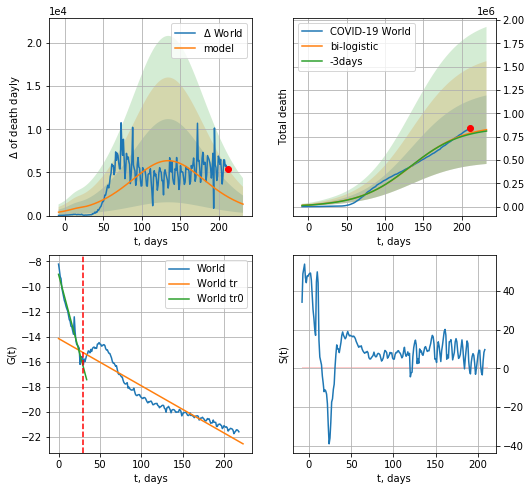

World data at: 2020-08-29
+3 day model MAPE: 0.014360311445074556
model: bi-logistic
coeffs:  [8.68798178e+05 2.93102682e-02 1.34540293e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.4454146044259774
forecast at the end of period: +21 days
	 deltaDaydeath:  1325
	 total death:  824554 ± 367268
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.897082
 intercept: -14.158440
 slope: -0.037733


In [1699]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [1700]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


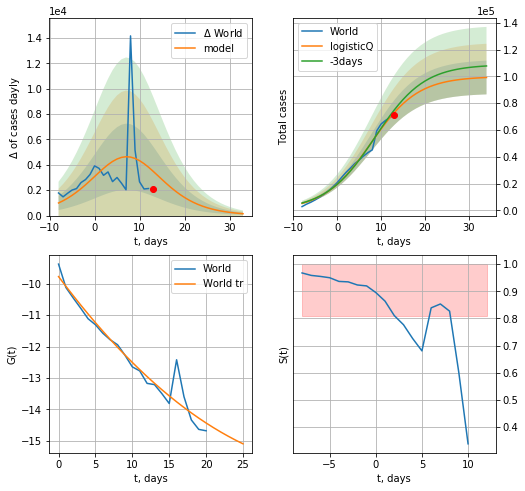

World data at: 2020-08-29
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +21 days
	 deltaDaycases: 148
	 total cases: 99134 ± 12586
	 total death: 3333 ± 1269
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


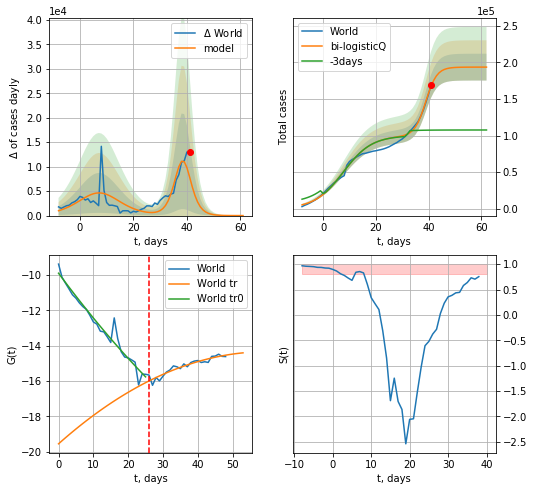

World data at: 2020-08-29
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 193621 ± 18335
	 total death: 6511 ± 1849
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


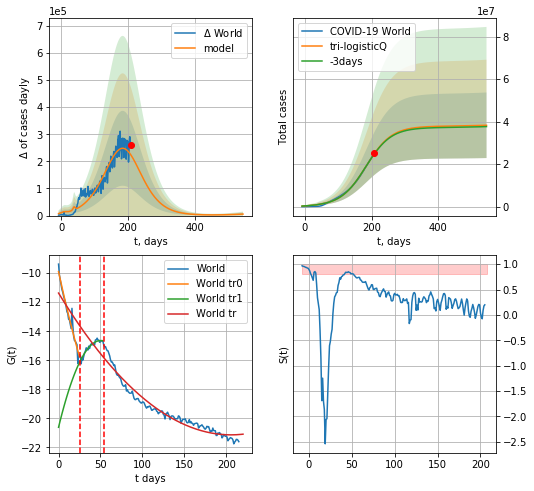

World data at: 2020-08-29
+3 day model MAPE: 0.004712
model: tri-logisticQ
coeffs: [ 3.76808580e+07  2.31280945e-07  1.83798209e+02 -1.13766554e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402995
forecast at the end of period: +336 days
	 deltaDaycases: 5539
	 total cases: 38300876 ± 15435067
	 total death: 1287991 ± 1557162
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.955739
 intercept_: -11.370544966180848
 coeffs_: [ 0.         -0.09504863  0.0002311 ]


In [1701]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


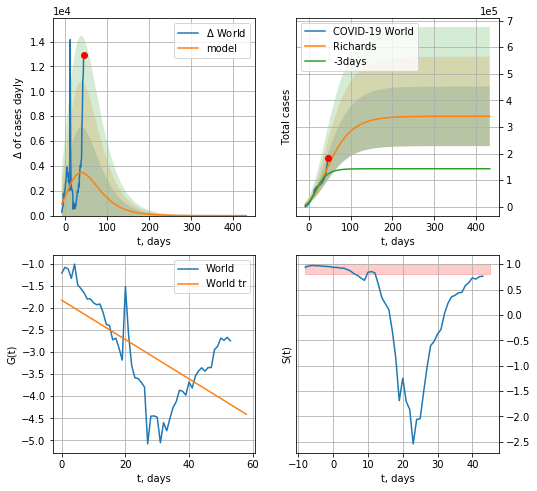

World data at: 2020-08-29
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +386 days
	 deltaDaycases: 0
	 total cases: 340070 ± 111977
	 total death: 11435 ± 11295
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


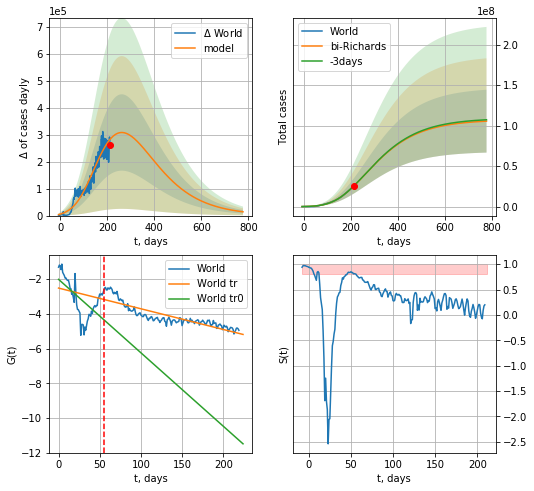

World data at: 2020-08-29
+3 day model MAPE: 0.001262
model: bi-Richards
coeffs: [ 1.06934389e+08  3.55962667e-01 -2.19867552e+02  2.22172322e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.367644
forecast at the end of period: +566 days
	 deltaDaycases: 14044
	 total cases: 105490488 ± 38782953
	 total death: 3547460 ± 3912607
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.364080
 intercept: -2.010777
 slope: -0.042333
trend coefficient of determination: 0.761149
 intercept: -2.513309
 slope: -0.011932


In [1702]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

221


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


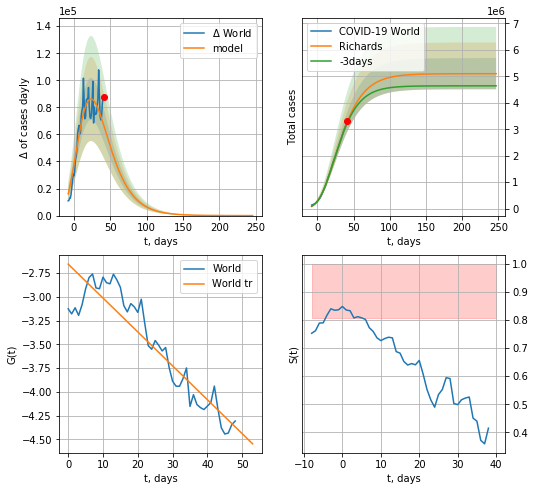

World data at: 2020-08-29
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +206 days
	 deltaDaycases: 6
	 total cases: 5102390 ± 589467
	 total death: 171584 ± 59468
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


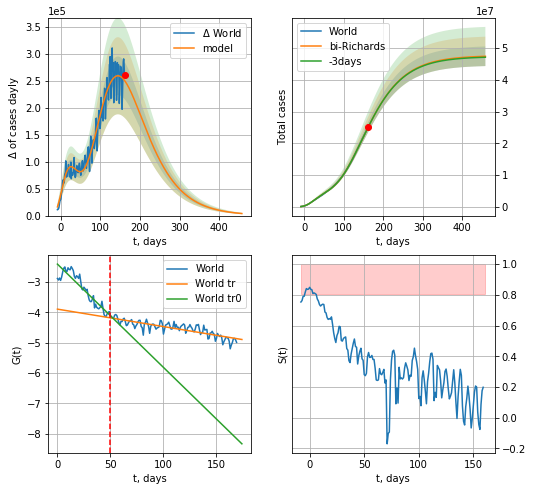

World data at: 2020-08-29
+3 day model MAPE: 0.000533
model: bi-Richards
coeffs: [ 4.25266201e+07  6.82113730e-01 -7.58608069e+01  2.45503686e-02]
rational stdev: 0.065035
forecast at the end of period: +296 days
	 deltaDaycases: 3811
	 total cases: 47402806 ± 3082823
	 total death: 1594073 ± 311009
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.847095
 intercept: -2.409826
 slope: -0.034030
trend coefficient of determination: 0.710452
 intercept: -3.893170
 slope: -0.005748


In [1703]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


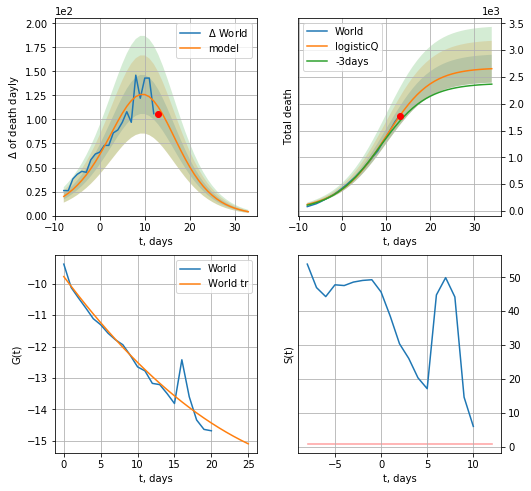

World data at: 2020-08-29
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +21 days
	 total death: 2654 ± 260
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


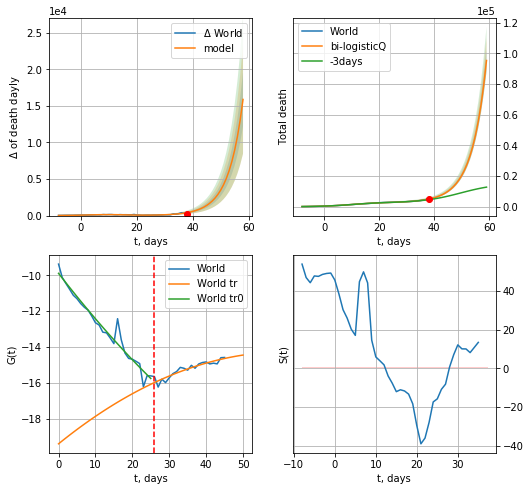

World data at: 2020-08-29
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +21 days
	 total death: 95273 ± 7297
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


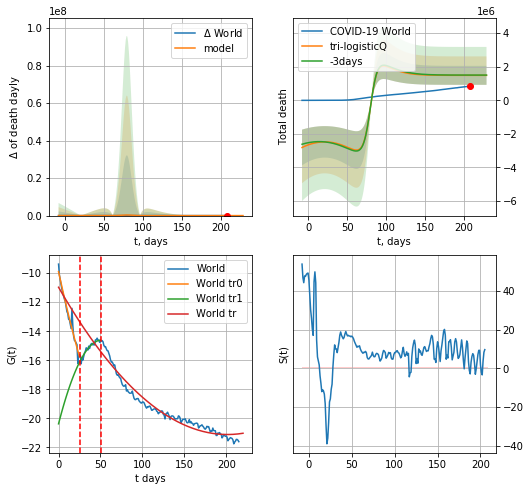

World data at: 2020-08-29
+3 day model MAPE: 0.010561
model: tri-logisticQ
coeffs: [-4.95327929e+06  3.21389059e-04  2.22277345e+01  1.98067517e+01]
rational stdev: 0.378898
forecast at the end of period: +21 days
	 total death: 1489499 ± 564368
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.956509
 intercept_: -10.96947906460528
 coeffs_: [ 0.         -0.10080026  0.00025026]


In [1705]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


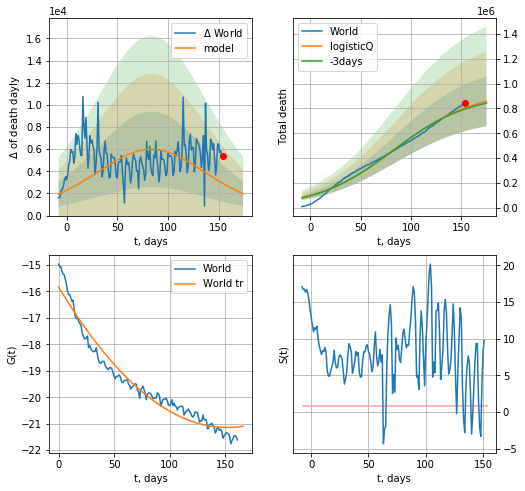

World data at: 2020-08-29
+3 day model MAPE: 0.012087
model: logisticQ
coeffs: [ 9.40300617e+05  2.56353186e-07  8.38971219e+01 -9.92793073e+04]
rational stdev: 0.232817
forecast at the end of period: +21 days
	 total death: 856369 ± 199377
trend coefficient of determination: 0.955739
 intercept_: -15.829172941437784
 coeffs_: [ 0.         -0.07009339  0.00023113]


In [1706]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [1707]:
#trend(dfSP,'SP',10)

In [1708]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
182 2020-08-25  423224       0  28924.0
183 2020-08-26  426818       0  28971.0
184 2020-08-27  451792       0  28996.0
185 2020-08-28  455621       0  29011.0
186 2020-08-29  455621       0  29011.0


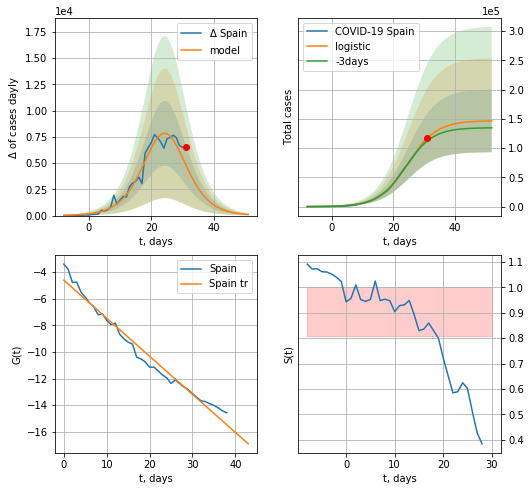

Spain data at: 2020-08-29
+3 day model MAPE: 0.04563372044274735
model: logistic
coeffs:  [1.46958525e+05 2.13815551e-01 2.47398602e+01]
rational stdev:  0.3655850946268679
forecast at the end of period: +21 days
	 deltaDaycases:  102
	 total cases:  146527 ± 53568
	 total death:  9329 ± 10231
trend coefficient of determination: 0.974093
 intercept: -4.614870
 slope: -0.285807
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


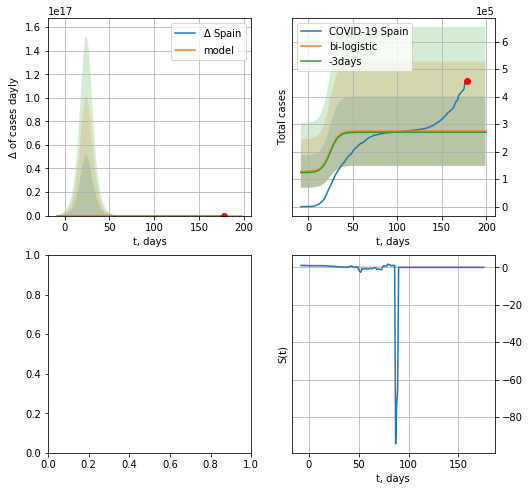

In [1709]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

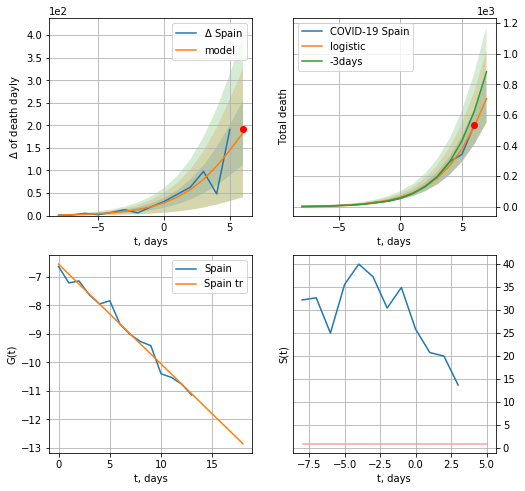

Spain data at: 2020-08-28
+3 day model MAPE: 0.19925761196778652
model: logistic
coeffs:  [2.74529161e+03 3.87912521e-01 9.73356211e+00]
rational stdev:  0.22139702081914042
forecast at the end of period: +1 days
	 total death:  706 ± 156
trend coefficient of determination: 0.980313
 intercept: -6.551108
 slope: -0.350542


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


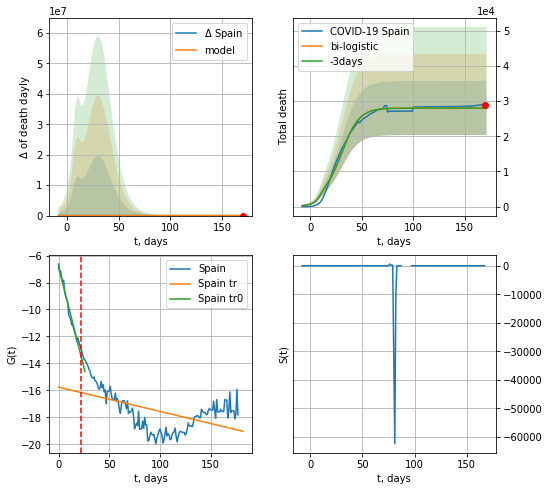

Spain data at: 2020-08-28
+3 day model MAPE: 0.0009982631488833949
model: bi-logistic
coeffs:  [2.52915478e+04 1.18366658e-01 3.06632159e+01] [2.74529161e+03 3.87912521e-01 9.73356211e+00]
rational stdev:  0.2741160926879089
forecast at the end of period: +1 days
	 deltaDaydeath:  0
	 total death:  28036 ± 7685
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976996
 intercept: -6.841826
 slope: -0.298029
trend coefficient of determination: 0.262972
 intercept: -15.762083
 slope: -0.017981


In [1294]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


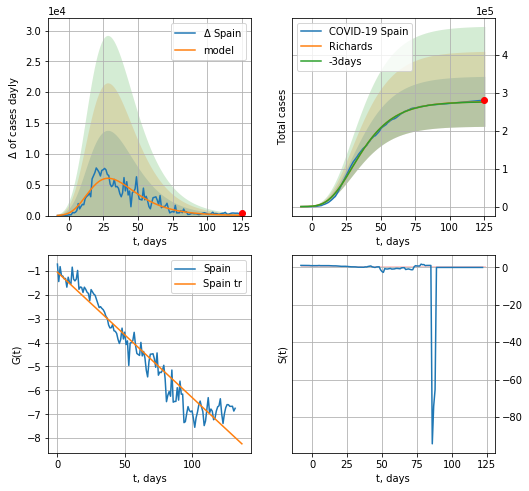

Spain data at: 2020-08-28
+3 day model MAPE: 0.001276
model: Richards
coeffs: [ 2.76941945e+05  8.52811226e+00 -5.41754135e+01  6.98918284e-03]
rational stdev: 0.238540
forecast at the end of period: +1 days
	 deltaDaycases: 52
	 total cases: 276084 ± 65857
	 total death: 17579 ± 12579
trend coefficient of determination: 0.934271
 intercept: -1.054438
 slope: -0.052422


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


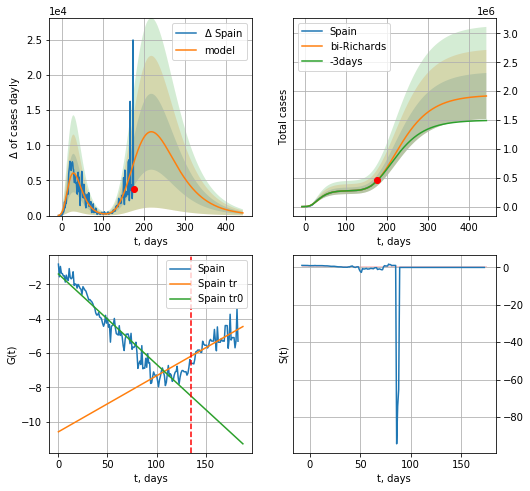

Spain data at: 2020-08-28
+3 day model MAPE: 0.007063
model: bi-Richards
coeffs: [1.65808435e+06 4.86608144e-01 5.89102633e+01 4.09915582e-02]
rational stdev: 0.208232
forecast at the end of period: +267 days
	 deltaDaycases: 378
	 total cases: 1916101 ± 398993
	 total death: 122004 ± 76215
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.923283
 intercept: -1.395247
 slope: -0.052648
trend coefficient of determination: 0.501405
 intercept: -10.591839
 slope: 0.032620


In [1295]:
vL = 135+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*60-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


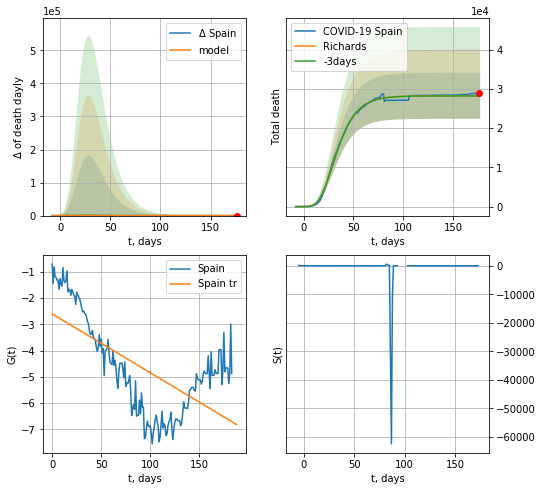

Spain data at: 2020-08-28
+3 day model MAPE: 0.000827
model: Richards
coeffs: [ 2.82587661e+04  1.07642826e+01 -3.63848242e+01  7.05777262e-03]
rational stdev: 0.207396
forecast at the end of period: +1 days
	 total death: 28258 ± 5860
trend coefficient of determination: 0.425681
 intercept: -2.608757
 slope: -0.022366


In [1296]:
x = forecastRR('Spain',dfSP[1:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


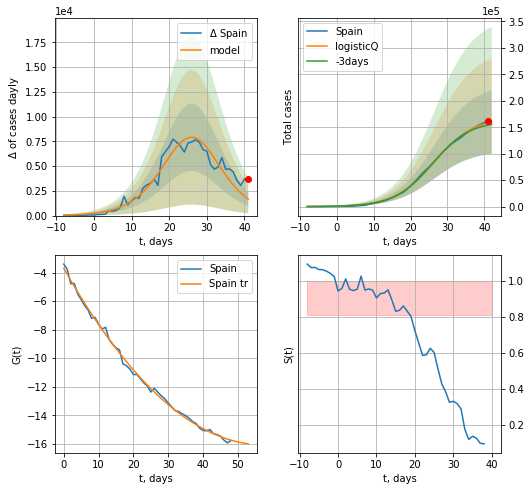

Spain data at: 2020-08-28
+3 day model MAPE: 0.028152
model: logisticQ
coeffs: [ 1.68478682e+05  5.32017405e-06  2.63951016e+01 -3.53630511e+04]
rational stdev: 0.374281
forecast at the end of period: +1 days
	 deltaDaycases: 1649
	 total cases: 160013 ± 59890
	 total death: 10188 ± 11439
trend coefficient of determination: 0.997237
 intercept_: -3.7029066425697694
 coeffs_: [ 0.         -0.43064712  0.00374821]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


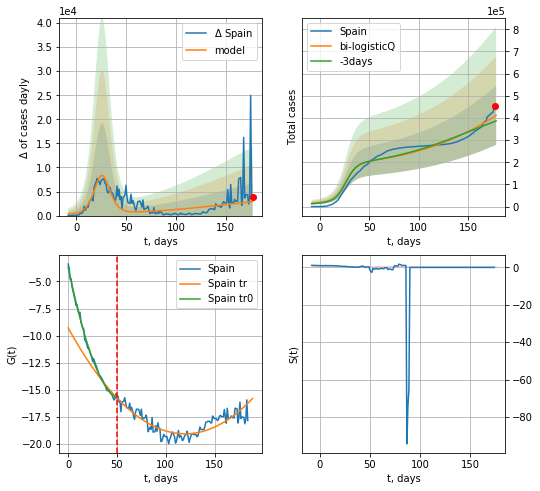

Spain data at: 2020-08-28
+3 day model MAPE: 0.065456
model: bi-logisticQ
coeffs: [ 8.52499352e+05  1.91246450e-07  2.32839901e+02 -8.72808249e+04]
rational stdev: 0.322809
forecast at the end of period: +1 days
	 deltaDaycases: 2896
	 total cases: 411880 ± 132958
	 total death: 26225 ± 25396
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997047
 intercept_: -3.67948427062914
 coeffs_: [ 0.         -0.43465795  0.00385215]
trend coefficient of determination: 0.726555
 intercept_: -9.290832185692055
 coeffs_: [ 0.         -0.16294857  0.00068041]


In [1297]:
x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


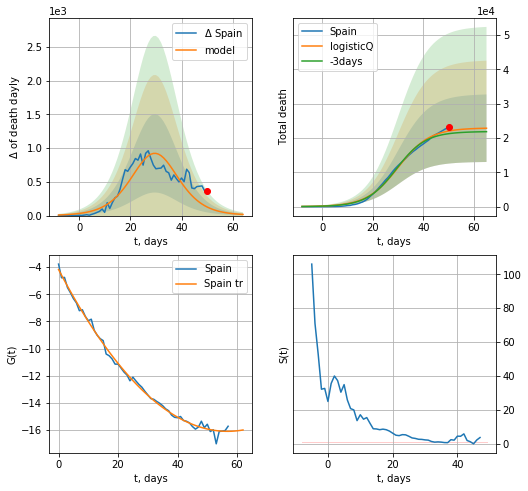

Spain data at: 2020-08-28
+3 day model MAPE: 0.037625
model: logisticQ
coeffs: [ 2.28798060e+04  1.92558820e-06  3.00460867e+01 -8.38208205e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +15 days
	 total death: 22837 ± 9838
trend coefficient of determination: 0.995913
 intercept_: -4.179836262485469
 coeffs_: [ 0.         -0.41930876  0.00369052]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


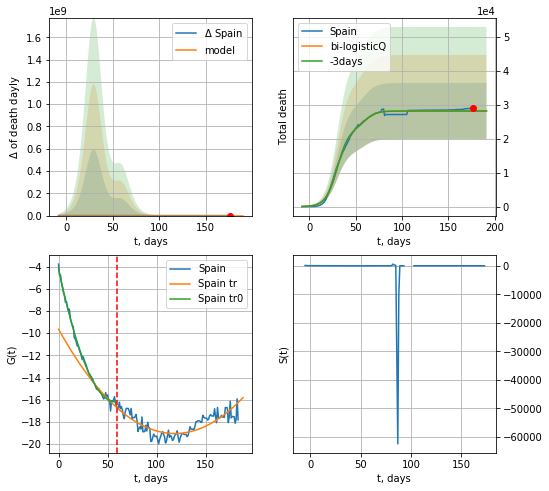

Spain data at: 2020-08-28
+3 day model MAPE: 0.001005
model: bi-logisticQ
coeffs: [ 5.30404734e+03  2.81880754e-07  5.98975536e+01 -5.70571474e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.292665
forecast at the end of period: +15 days
	 total death: 28190 ± 8250
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995756
 intercept_: -4.211374679634396
 coeffs_: [ 0.         -0.41483981  0.00359415]
trend coefficient of determination: 0.638585
 intercept_: -9.648234312477737
 coeffs_: [ 0.         -0.1585296   0.00066903]


In [1298]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [1299]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

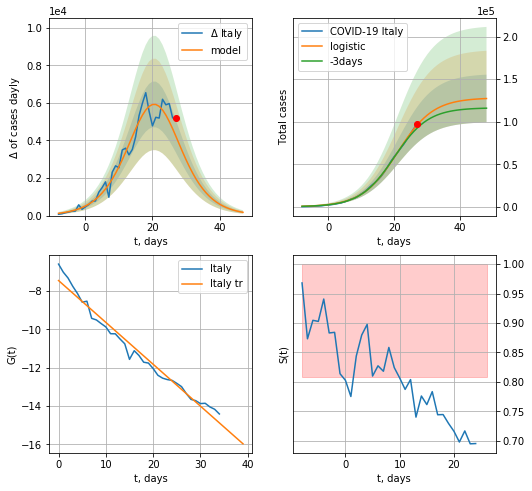

Italy data at: 2020-08-29
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +21 days
	 deltaDaycases:  173
	 total cases:  127278 ± 28084
	 total death:  16919 ± 11199
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


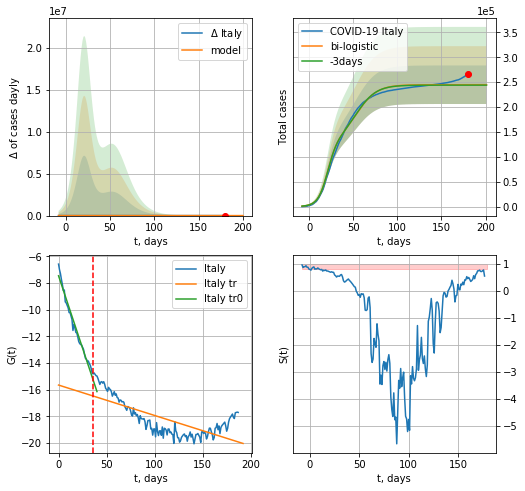

Italy data at: 2020-08-29
+3 day model MAPE: 0.003466277888386353
model: bi-logistic
coeffs:  [1.16713205e+05 8.65389977e-02 5.35986756e+01] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.15799461612800678
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  244851 ± 38685
	 total death:  32548 ± 15427
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.523994
 intercept: -15.661447
 slope: -0.022811


In [1710]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

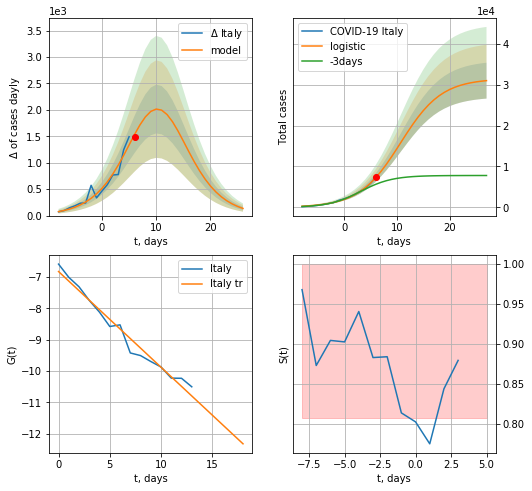

Italy data at: 2020-08-29
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +21 days
	 deltaDaycases:  135
	 total cases:  31024 ± 4389
	 total death:  4124 ± 1750
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


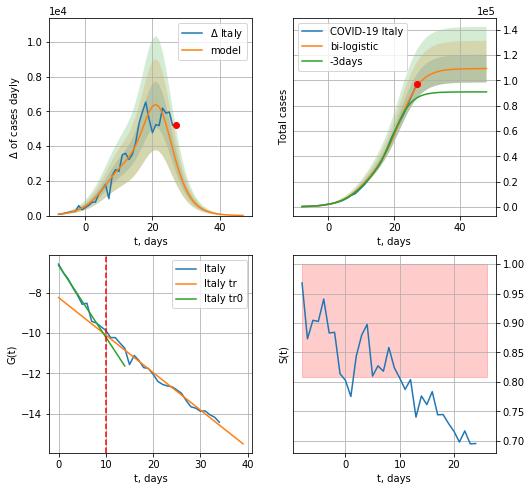

Italy data at: 2020-08-29
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +21 days
	 deltaDaycases:  9
	 total cases:  109335 ± 10987
	 total death:  14534 ± 4381
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


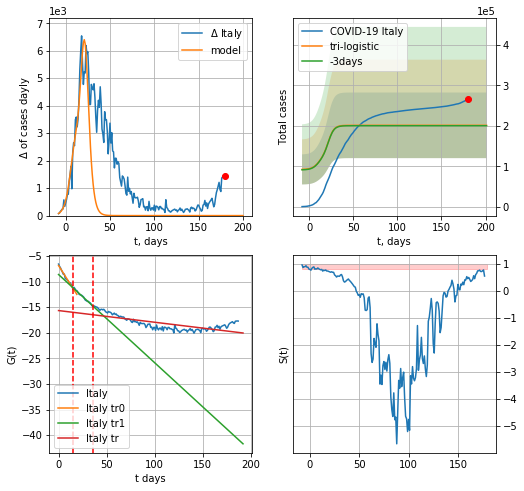

Italy data at: 2020-08-29
+3 day model MAPE: 0.005159728079028379
model: tri-logistic
coeffs:  [ 9.19663157e+04 -1.81004067e+00  2.09440275e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.4031359543326116
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  201328 ± 81162
	 total death:  26762 ± 32366
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.523994
 intercept: -15.661447
 slope: -0.022811


In [1711]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

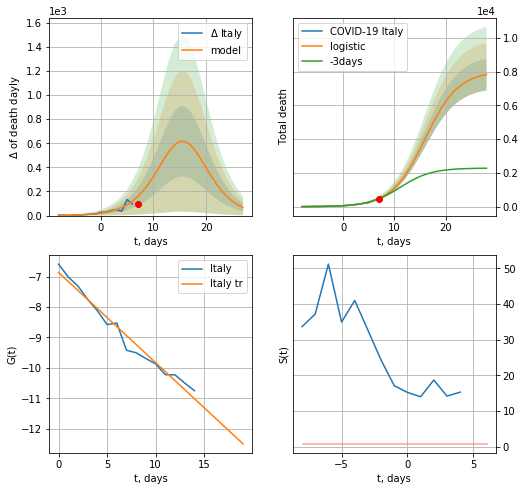

Italy data at: 2020-08-29
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +21 days
	 total death:  7829 ± 940
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


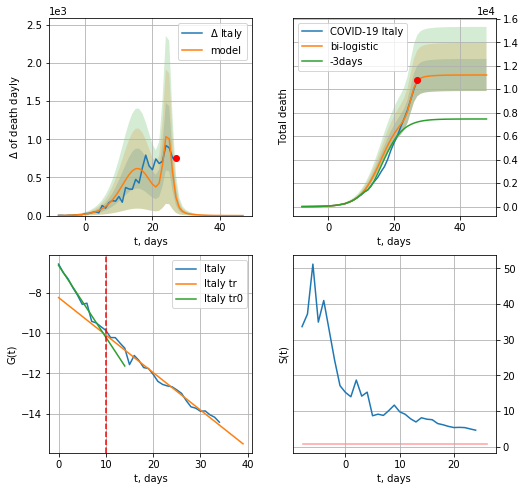

Italy data at: 2020-08-29
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +21 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


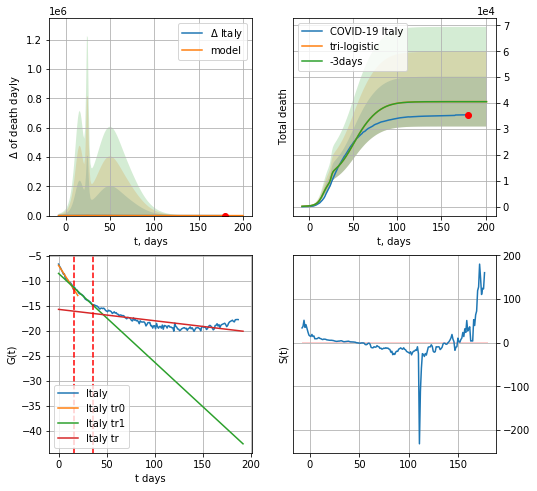

Italy data at: 2020-08-29
+3 day model MAPE: 0.0008441917591390225
model: tri-logistic
coeffs:  [2.34873132e+04 9.45786026e-02 4.89929810e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2370977028066966
forecast at the end of period: +21 days
	 deltaDaydeath:  0
	 total death:  40570 ± 9619
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.523994
 intercept: -15.661447
 slope: -0.022811


In [1712]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


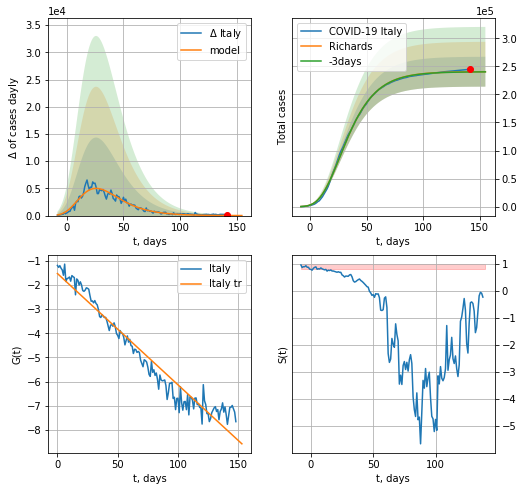

Italy data at: 2020-08-29
+3 day model MAPE: 0.001131
model: Richards
coeffs: [ 2.40632242e+05  7.48009413e+00 -5.95531564e+01  7.59110932e-03]
rational stdev: 0.110661
forecast at the end of period: +14 days
	 deltaDaycases: 9
	 total cases: 240470 ± 26610
	 total death: 31965 ± 10611
trend coefficient of determination: 0.947741
 intercept: -1.532596
 slope: -0.045965


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


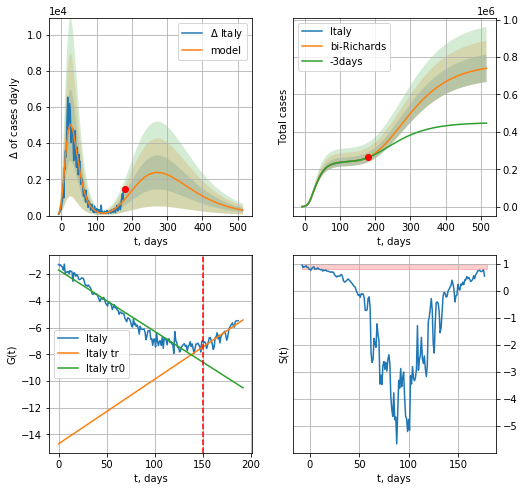

Italy data at: 2020-08-29
+3 day model MAPE: 0.007006
model: bi-Richards
coeffs: [ 5.23835331e+05  5.65068062e-01 -3.19504267e+01  2.21255092e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.099633
forecast at the end of period: +336 days
	 deltaDaycases: 300
	 total cases: 740004 ± 73728
	 total death: 98369 ± 29402
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.943760
 intercept: -1.691964
 slope: -0.045943
trend coefficient of determination: 0.753389
 intercept: -14.702476
 slope: 0.048284


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


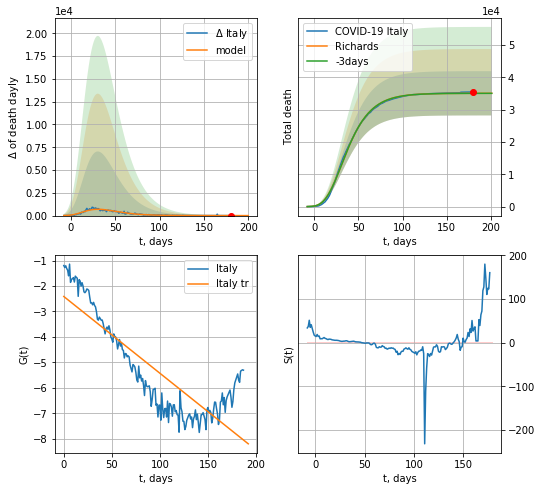

Italy data at: 2020-08-29
+3 day model MAPE: 0.000458
model: Richards
coeffs: [ 3.50748216e+04  7.95119738e+00 -6.12027921e+01  6.81798939e-03]
rational stdev: 0.195225
forecast at the end of period: +21 days
	 total death: 35071 ± 6846
trend coefficient of determination: 0.724085
 intercept: -2.410889
 slope: -0.030137


In [1713]:
vL=150
x = forecastRR('Italy',dfIT[:vL],d1,24*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,70*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


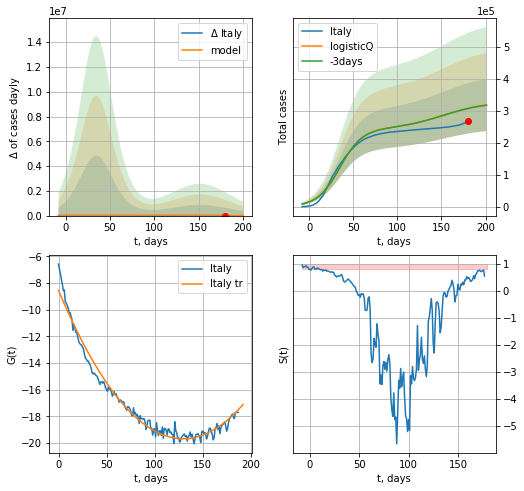

Italy data at: 2020-08-29
+3 day model MAPE: 0.001400
model: logisticQ
coeffs: [ 2.42921729e+05  1.54347219e-07  3.48423801e+01 -5.11285872e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.255926
forecast at the end of period: +21 days
	 deltaDaycases: 377
	 total cases: 318249 ± 81448
	 total death: 42305 ± 32480
trend coefficient of determination: 0.977915
 intercept_: -8.570409883243297
 coeffs_: [ 0.         -0.17142131  0.00066072]


In [1714]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


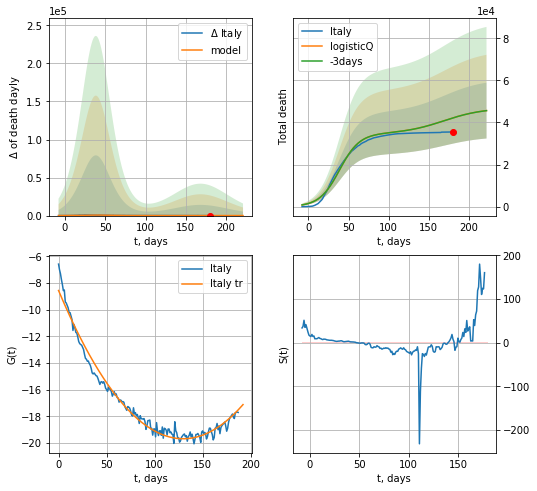

Italy data at: 2020-08-29
+3 day model MAPE: 0.000328
model: logisticQ
coeffs: [ 3.46450003e+04  1.68360521e-07  3.87012578e+01 -4.76304797e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290504
forecast at the end of period: +42 days
	 total death: 45636 ± 13257
trend coefficient of determination: 0.977915
 intercept_: -8.570409883243297
 coeffs_: [ 0.         -0.17142131  0.00066072]


In [1715]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [1716]:
dT

154

FR
           date     cases  active    death
192 2020-08-25  248158.0  132090  30544.0
193 2020-08-26  253587.0  137519  30544.0
194 2020-08-27  259698.0  143138  30576.0
195 2020-08-28  267077.0  150304  30596.0
196 2020-08-29  272530.0  155751  30602.0


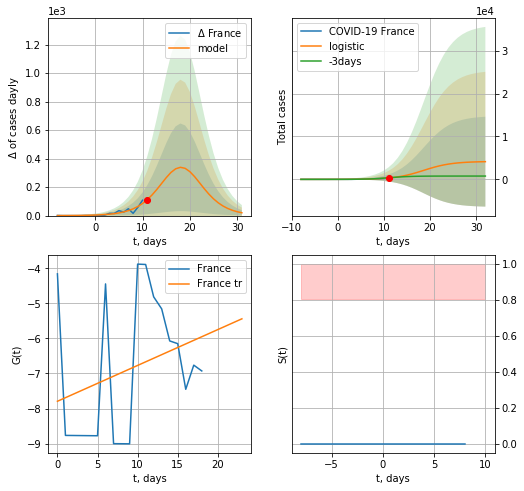

France data at: 2020-08-29
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +21 days
	 deltaDaycases:  19
	 total cases:  4121 ± 10464
	 total death:  462 ± 3519
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


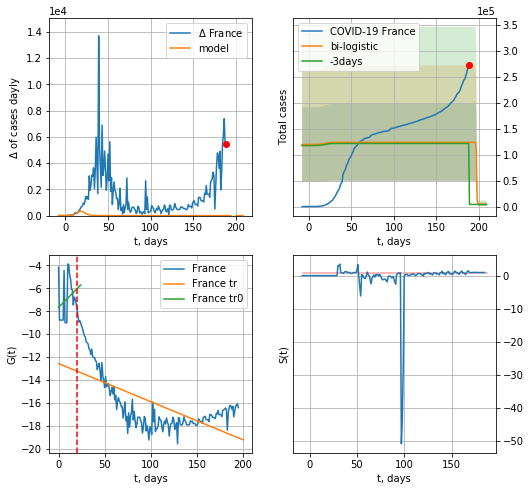

France data at: 2020-08-29
+3 day model MAPE: 28.679556076269684
model: bi-logistic
coeffs:  [ 1.19703541e+05 -4.66059319e+00  1.97447918e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  0.5982951509763723
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  4173 ± 2497
	 total death:  468 ± 840
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.449494
 intercept: -12.570479
 slope: -0.033336


In [1717]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [1718]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

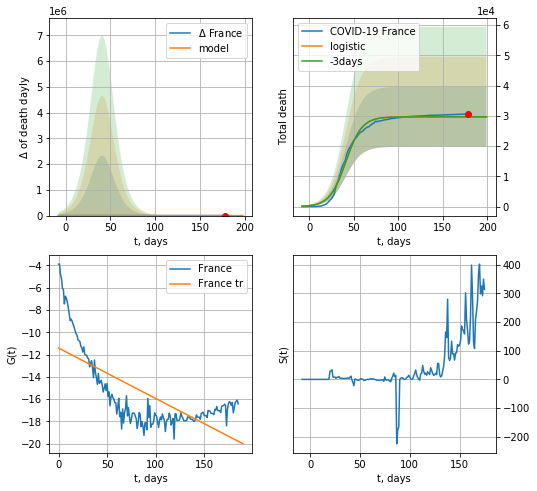

France data at: 2020-08-29
+3 day model MAPE: 0.000971093688784084
model: logistic
coeffs:  [2.96678272e+04 1.10329638e-01 4.11352984e+01]
rational stdev:  0.3335357469705643
forecast at the end of period: +21 days
	 total death:  29667 ± 9895
trend coefficient of determination: 0.511294
 intercept: -11.415276
 slope: -0.045235


In [1719]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


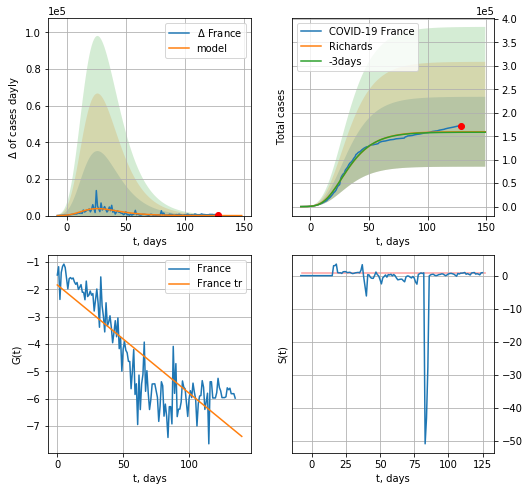

France data at: 2020-08-29
+3 day model MAPE: 0.006184
model: Richards
coeffs: [ 1.59620335e+05  1.29952709e+01 -5.49079687e+01  5.00874523e-03]
rational stdev: 0.466722
forecast at the end of period: +21 days
	 deltaDaycases: 3
	 total cases: 159565 ± 74472
	 total death: 17917 ± 25086
trend coefficient of determination: 0.746214
 intercept: -1.832930
 slope: -0.039654


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


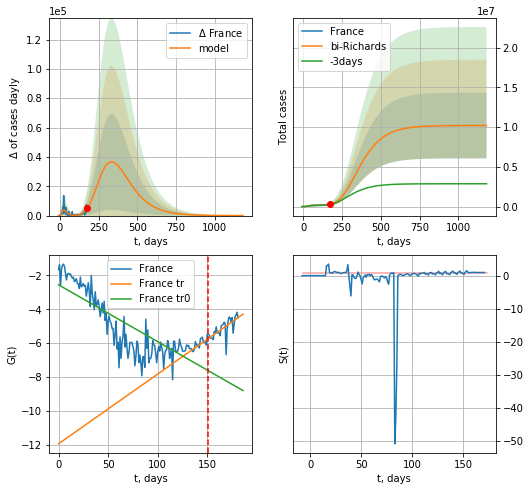

France data at: 2020-08-29
+3 day model MAPE: 0.025519
model: bi-Richards
coeffs: [1.00452641e+07 2.15518456e-01 3.29169582e+01 4.70938832e-02]
rational stdev: 0.405019
forecast at the end of period: +1008 days
	 deltaDaycases: 18
	 total cases: 10203048 ± 4132425
	 total death: 1145685 ± 1392071
bi-Richards approximation splitting point: 151
trend coefficient of determination: 0.665499
 intercept: -2.554125
 slope: -0.033585
trend coefficient of determination: 0.465351
 intercept: -11.942671
 slope: 0.041179


In [1727]:
vL = 86+14+40+25
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,166*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


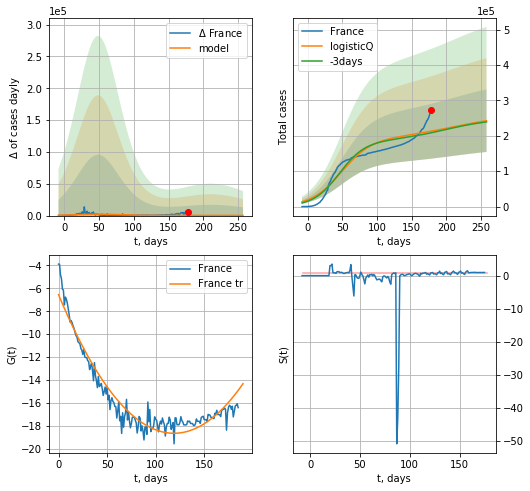

France data at: 2020-08-29
+3 day model MAPE: 0.020852
model: logisticQ
coeffs: [ 1.92232330e+05  2.64881943e-08  4.88368062e+01 -1.73235873e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363905
forecast at the end of period: +80 days
	 deltaDaycases: 305
	 total cases: 242550 ± 88265
	 total death: 27235 ± 29732
trend coefficient of determination: 0.934635
 intercept_: -6.552763285443824
 coeffs_: [ 0.         -0.20379579  0.00085709]


In [1728]:
x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


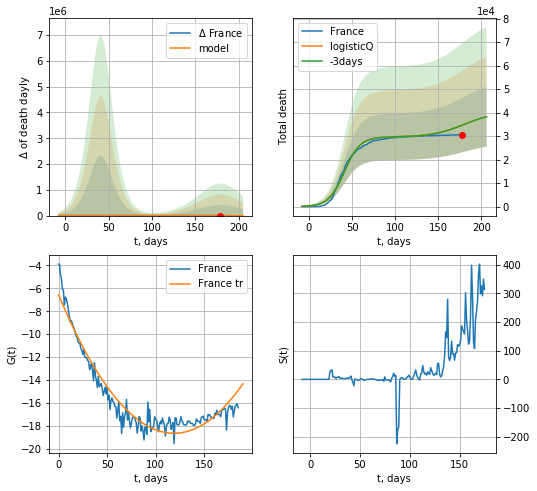

France data at: 2020-08-29
+3 day model MAPE: 0.000409
model: logisticQ
coeffs: [ 2.96678427e+04  2.66137931e-07  4.11361246e+01 -4.14380739e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333581
forecast at the end of period: +28 days
	 total death: 38229 ± 12752
trend coefficient of determination: 0.934635
 intercept_: -6.552763285443824
 coeffs_: [ 0.         -0.20379579  0.00085709]


In [1729]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [1730]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [1731]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
183 2020-08-25  237572   18627  9345.0
184 2020-08-26  239000   15415  9352.0
185 2020-08-27  240565   15711  9359.0
186 2020-08-28  242114   15693  9360.0
187 2020-08-29  242825   15978  9363.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


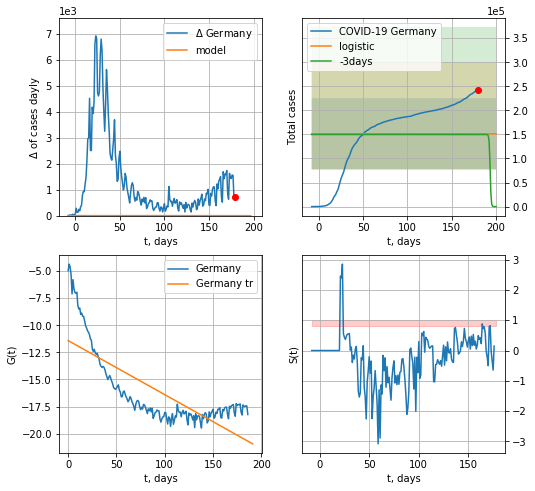

Germany data at: 2020-08-29
+3 day model MAPE: 0.009796845643652739
model: logistic
coeffs:  [ 1.51309553e+05 -1.55056702e+00  2.04088874e+02]
rational stdev:  0.48939334964573894
forecast at the end of period: +21 days
	 deltaDaycases:  -209
	 total cases:  151043 ± 73919
	 total death:  5824 ± 8550
trend coefficient of determination: 0.586706
 intercept: -11.416533
 slope: -0.049858


In [1732]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


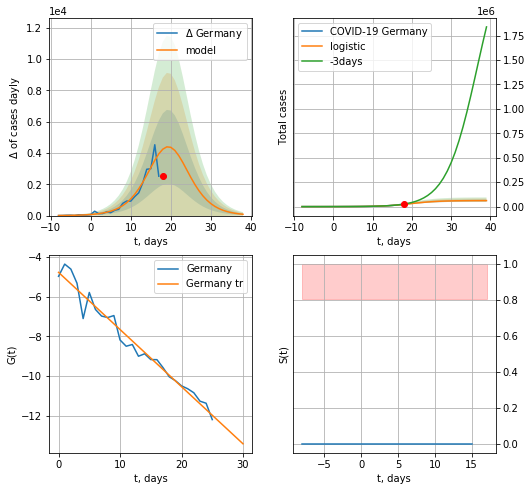

Germany data at: 2020-08-29
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +21 days
	 deltaDaycases:  83
	 total cases:  61296 ± 10918
	 total death:  2363 ± 1262
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


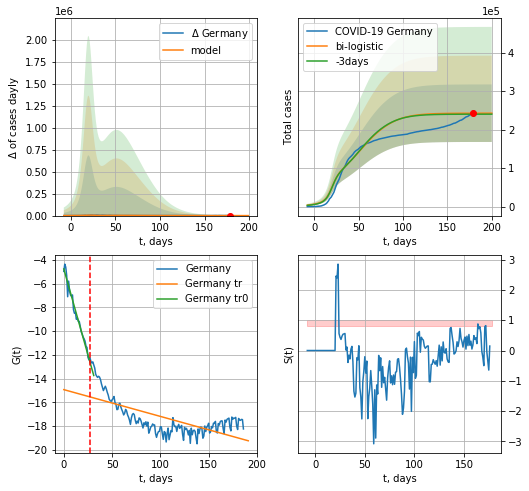

Germany data at: 2020-08-29
+3 day model MAPE: 0.010353395404097545
model: bi-logistic
coeffs:  [1.44952070e+05 6.48547763e-02 4.88611038e+01] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.30791681624217127
forecast at the end of period: +21 days
	 deltaDaycases:  1
	 total cases:  242719 ± 74737
	 total death:  9358 ± 8644
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.456831
 intercept: -14.923605
 slope: -0.022535


In [1733]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
183 2020-08-25  237572   18627  9345.0
184 2020-08-26  239000   15415  9352.0
185 2020-08-27  240565   15711  9359.0
186 2020-08-28  242114   15693  9360.0
187 2020-08-29  242825   15978  9363.0


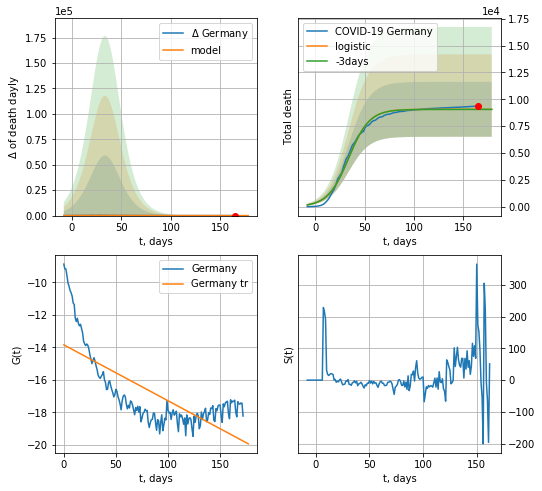

Germany data at: 2020-08-29
+3 day model MAPE: 0.0011361539133026045
model: logistic
coeffs:  [9.06656707e+03 9.50593358e-02 3.39623046e+01]
rational stdev:  0.2821655822949122
forecast at the end of period: +14 days
	 total death:  9066 ± 2558
trend coefficient of determination: 0.534517
 intercept: -13.848899
 slope: -0.034429


In [1734]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


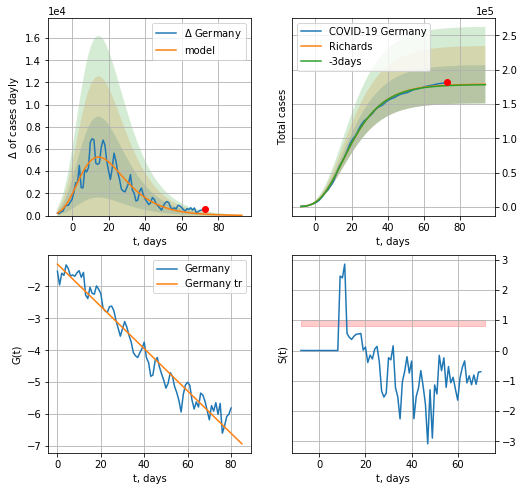

Germany data at: 2020-08-29
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +21 days
	 deltaDaycases: 25
	 total cases: 178800 ± 27878
	 total death: 6894 ± 3224
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


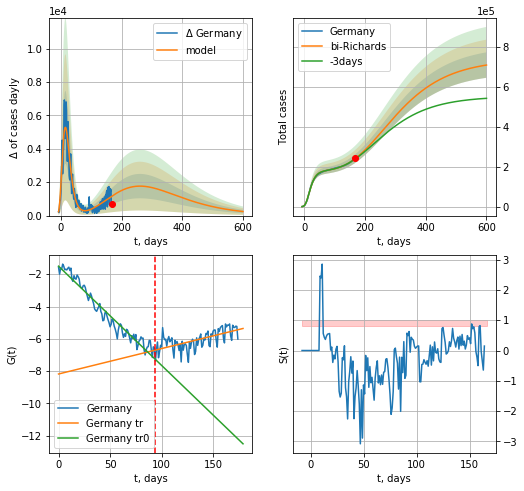

Germany data at: 2020-08-29
+3 day model MAPE: 0.006766
model: bi-Richards
coeffs: [ 5.59641238e+05  5.93415135e-01 -2.28771202e+02  1.45594030e-02]
rational stdev: 0.089754
forecast at the end of period: +434 days
	 deltaDaycases: 243
	 total cases: 709931 ± 63718
	 total death: 27373 ± 7370
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950687
 intercept: -1.501748
 slope: -0.061432
trend coefficient of determination: 0.393289
 intercept: -8.176132
 slope: 0.015737


In [1735]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,84*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


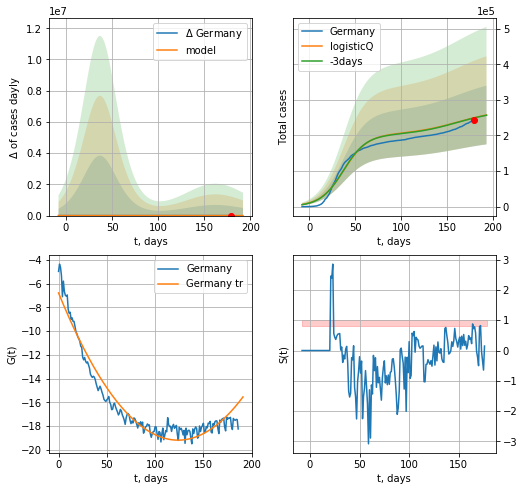

Germany data at: 2020-08-29
+3 day model MAPE: 0.002144
model: logisticQ
coeffs: [ 2.02256996e+05  6.80039674e-08  3.72723267e+01 -1.15134173e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320574
forecast at the end of period: +14 days
	 deltaDaycases: 506
	 total cases: 257349 ± 82499
	 total death: 9923 ± 9543
trend coefficient of determination: 0.945732
 intercept_: -6.783824993150576
 coeffs_: [ 0.         -0.20010916  0.0008078 ]


In [1736]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


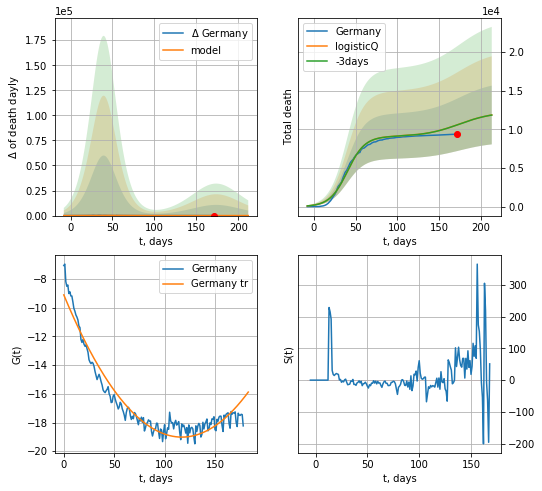

Germany data at: 2020-08-29
+3 day model MAPE: 0.000519
model: logisticQ
coeffs: [ 9.06554644e+03  2.29285288e-07  3.99623928e+01 -4.15469988e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320511
forecast at the end of period: +42 days
	 total death: 11844 ± 3796
trend coefficient of determination: 0.939594
 intercept_: -9.099917408792727
 coeffs_: [ 0.         -0.16938231  0.00072324]


In [1737]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
177 2020-08-25  5956036  2518885  182412.0
178 2020-08-26  6001103  2502762  183677.0
179 2020-08-27  6048317  2515137  184803.0
180 2020-08-28  6096756  2534261  185965.0
181 2020-08-29  6139466  2543701  186857.0


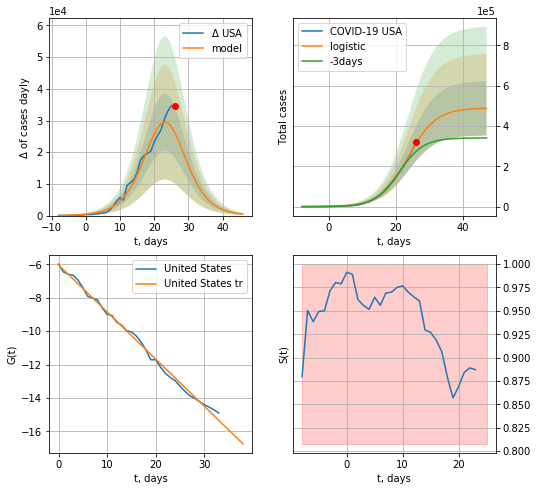

USA data at: 2020-08-29
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +21 days
	 deltaDaycases:  462
	 total cases:  487327 ± 134536
	 total death:  14831 ± 12283
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


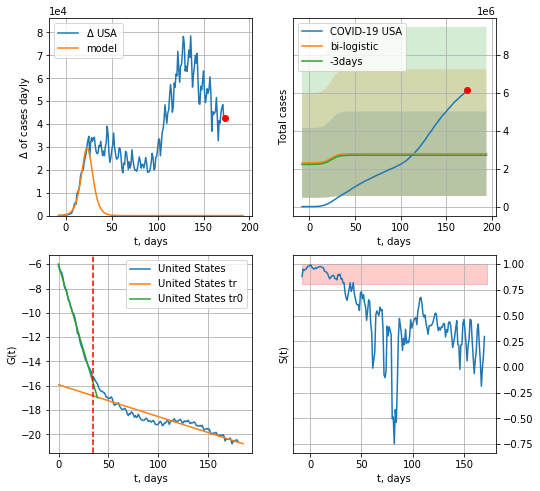

USA data at: 2020-08-29
+3 day model MAPE: 0.029020799633550035
model: bi-logistic
coeffs:  [ 1.84419589e+06 -2.18262522e+01  5.27433799e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7990926601610416
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  2794270 ± 2232881
	 total death:  85044 ± 203874
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.858759
 intercept: -15.915609
 slope: -0.026239


In [1738]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

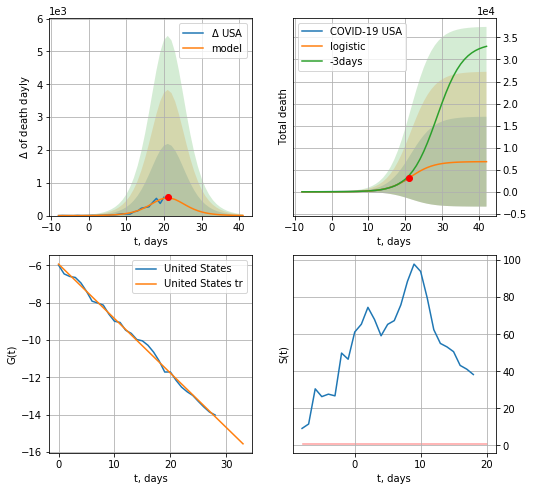

USA data at: 2020-08-29
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +21 days
	 total death:  6823 ± 10186
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


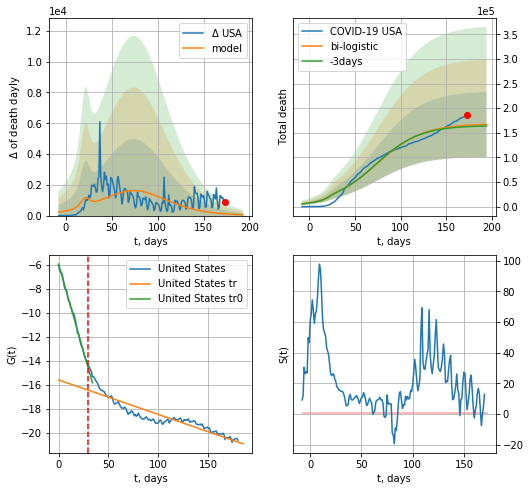

USA data at: 2020-08-29
+3 day model MAPE: 0.017091685683109443
model: bi-logistic
coeffs:  [1.61447005e+05 4.02117388e-02 7.43424278e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.3958217418726583
forecast at the end of period: +21 days
	 deltaDaydeath:  53
	 total death:  166978 ± 66093
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.835201
 intercept: -15.585687
 slope: -0.028758


In [1739]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


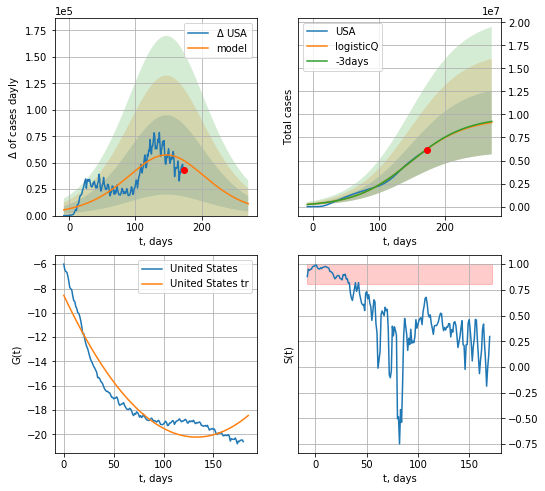

USA data at: 2020-08-29
+3 day model MAPE: 0.004059
model: logisticQ
coeffs: [ 9.55296119e+06  2.45756139e-07  1.47010049e+02 -9.73637322e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378721
forecast at the end of period: +98 days
	 deltaDaycases: 11181
	 total cases: 9127994 ± 3456966
	 total death: 277814 ± 315642
trend coefficient of determination: 0.911242
 intercept_: -8.56179136944682
 coeffs_: [ 0.         -0.17532748  0.00065888]


In [1740]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


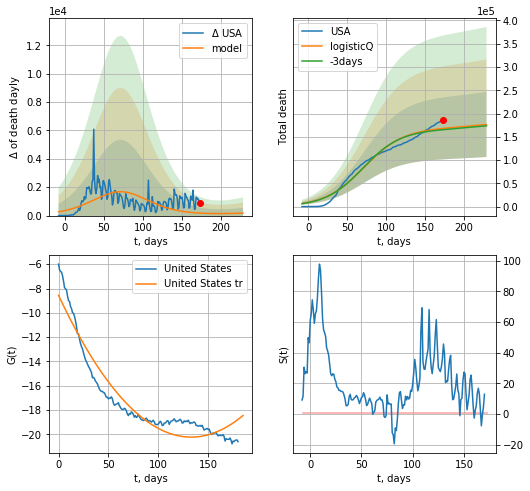

USA data at: 2020-08-29
+3 day model MAPE: 0.016337
model: logisticQ
coeffs: [ 1.67395160e+05  4.81869827e-08  7.15256677e+01 -8.29834284e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395937
forecast at the end of period: +56 days
	 total death: 176520 ± 69891
trend coefficient of determination: 0.911242
 intercept_: -8.56179136944682
 coeffs_: [ 0.         -0.17532748  0.00065888]


In [1741]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


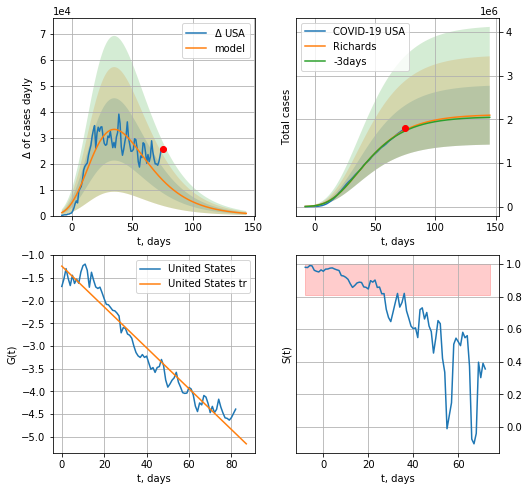

USA data at: 2020-08-29
+3 day model MAPE: 0.011172
model: Richards
coeffs: [ 2.11547275e+06  4.55740072e+00 -7.32299429e+01  9.40207859e-03]
rational stdev: 0.321873
forecast at the end of period: +70 days
	 deltaDaycases: 847
	 total cases: 2096014 ± 674650
	 total death: 63793 ± 61599
trend coefficient of determination: 0.952323
 intercept: -1.242017
 slope: -0.044961


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


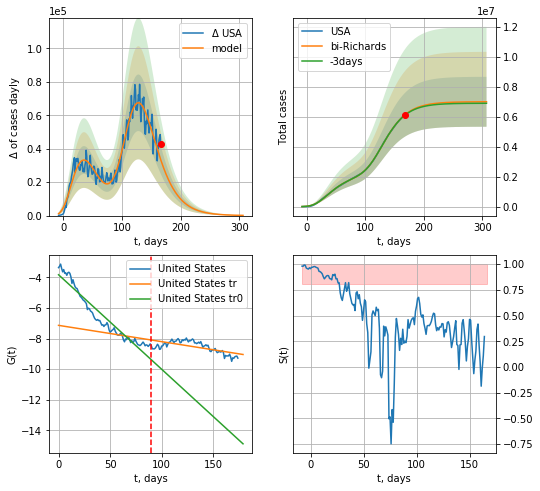

USA data at: 2020-08-29
+3 day model MAPE: 0.003769
model: bi-Richards
coeffs: [4.87752937e+06 1.50997078e-01 9.81703163e+01 2.75709939e-01]
rational stdev: 0.238058
forecast at the end of period: +140 days
	 deltaDaycases: 126
	 total cases: 6990019 ± 1664030
	 total death: 212743 ± 151935
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.922147
 intercept: -3.829490
 slope: -0.061712
trend coefficient of determination: 0.453056
 intercept: -7.136247
 slope: -0.010632


In [1742]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*42-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1743]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
181 2020-08-25  327798       0  41449.0
182 2020-08-26  328846       0  41465.0
183 2020-08-27  330368       0  41477.0
184 2020-08-28  331644       0  41486.0
185 2020-08-29  332752       0  41498.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


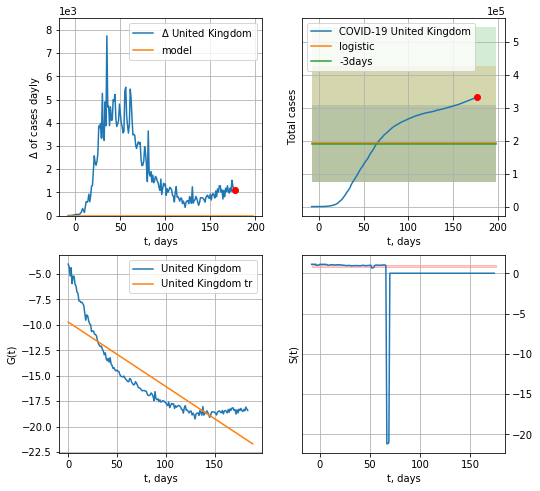

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.012105515276777959
model: logistic
coeffs:  [ 1.91713226e+05 -1.03556472e+01  2.64174085e+02]
rational stdev:  0.6138504474673949
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  191713 ± 117683
	 total death:  23908 ± 44027
trend coefficient of determination: 0.758249
 intercept: -9.726755
 slope: -0.063352


In [1744]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


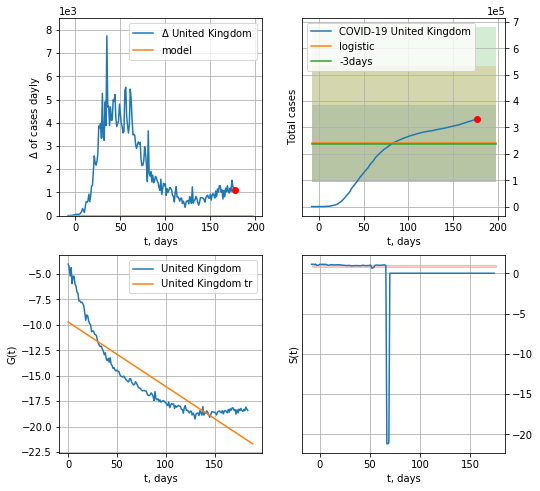

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.01210551527677805
model: logistic
coeffs:  [ 1.91713226e+05 -1.03556472e+01  2.64174085e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6138504474673949
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  239641 ± 147104
	 total death:  29886 ± 55036
trend coefficient of determination: 0.758249
 intercept: -9.726755
 slope: -0.063352


In [1745]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


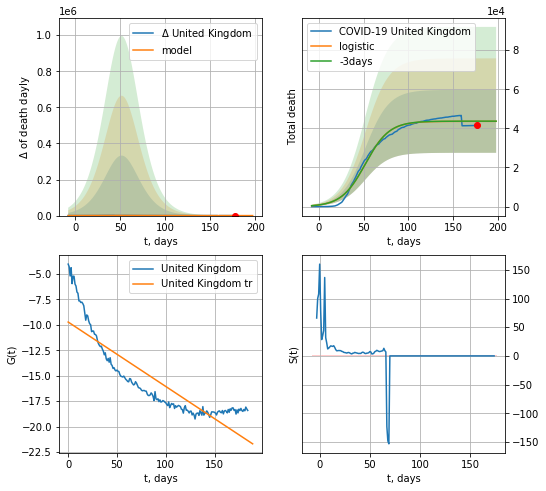

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.0020863184105106266
model: logistic
coeffs:  [4.36044056e+04 7.55815541e-02 5.18803866e+01]
rational stdev:  0.369109953260633
forecast at the end of period: +21 days
	 total death:  43603 ± 16094
trend coefficient of determination: 0.758249
 intercept: -9.726755
 slope: -0.063352


In [1746]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


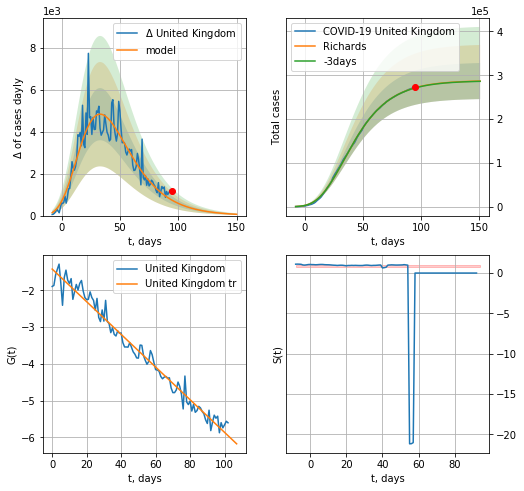

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.001530
model: Richards
coeffs: [ 2.88040344e+05  3.82469918e+00 -6.26359665e+01  1.20178265e-02]
rational stdev: 0.143621
forecast at the end of period: +56 days
	 deltaDaycases: 61
	 total cases: 286740 ± 41181
	 total death: 35759 ± 15407
trend coefficient of determination: 0.974342
 intercept: -1.421044
 slope: -0.044452


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


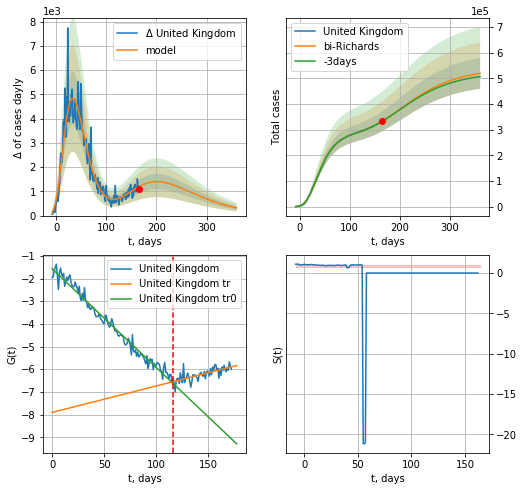

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.000800
model: bi-Richards
coeffs: [ 2.53158772e+05  6.49987412e-01 -4.54367868e+01  2.33390378e-02]
rational stdev: 0.115858
forecast at the end of period: +196 days
	 deltaDaycases: 317
	 total cases: 519433 ± 60180
	 total death: 64779 ± 22515
bi-Richards approximation splitting point: 116
trend coefficient of determination: 0.977046
 intercept: -1.567986
 slope: -0.043627
trend coefficient of determination: 0.506822
 intercept: -7.906092
 slope: 0.011684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


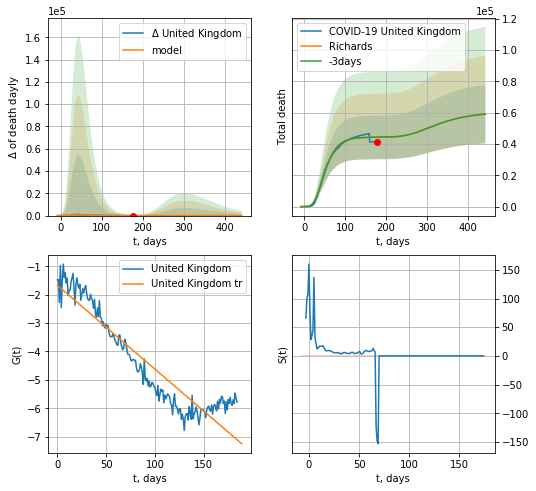

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.003112
model: Richards
coeffs: [ 4.42774533e+04  7.96356105e+00 -5.52648817e+01  6.41491710e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.315364
forecast at the end of period: +266 days
	 total death: 58991 ± 18603
trend coefficient of determination: 0.871083
 intercept: -1.674398
 slope: -0.029505


In [1747]:
vL = 116+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,50*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


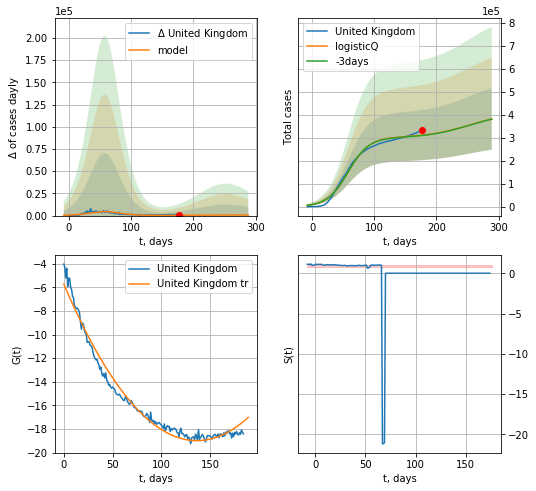

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.005435
model: logisticQ
coeffs: [ 3.02176268e+05  8.50977996e-08  5.79532034e+01 -6.99522215e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350151
forecast at the end of period: +112 days
	 deltaDaycases: 607
	 total cases: 382276 ± 133854
	 total death: 47674 ± 50079
trend coefficient of determination: 0.977899
 intercept_: -5.720681800026288
 coeffs_: [ 0.         -0.19469985  0.00071385]


In [1748]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


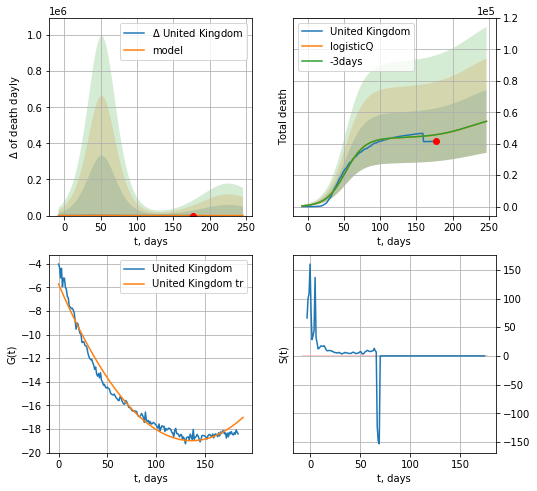

United Kingdom data at: 2020-08-29
+3 day model MAPE: 0.001851
model: logisticQ
coeffs: [ 4.36042105e+04  1.55030913e-07  5.18808638e+01 -4.87292011e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369134
forecast at the end of period: +70 days
	 total death: 54237 ± 20020
trend coefficient of determination: 0.977899
 intercept_: -5.720681800026288
 coeffs_: [ 0.         -0.19469985  0.00071385]


In [1749]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1750]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [1751]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [1752]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [1753]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [1754]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
180 2020-08-25  16480.0    1392  623.0
181 2020-08-26  16537.0    1311  623.0
182 2020-08-27  16627.0    1240  624.0
183 2020-08-28  16700.0    1199  624.0
184 2020-08-29  16779.0    1166  624.0


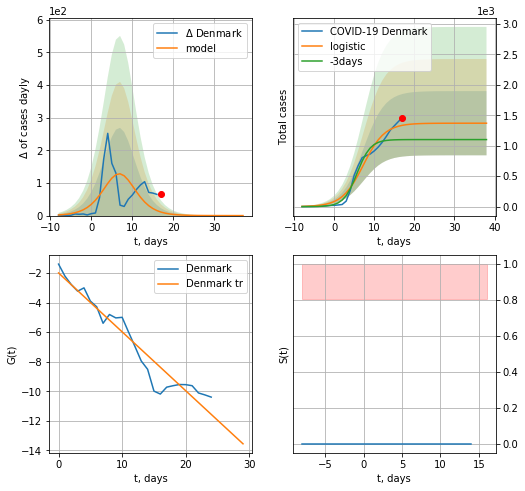

Denmark data at: 2020-08-29
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  50 ± 57
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


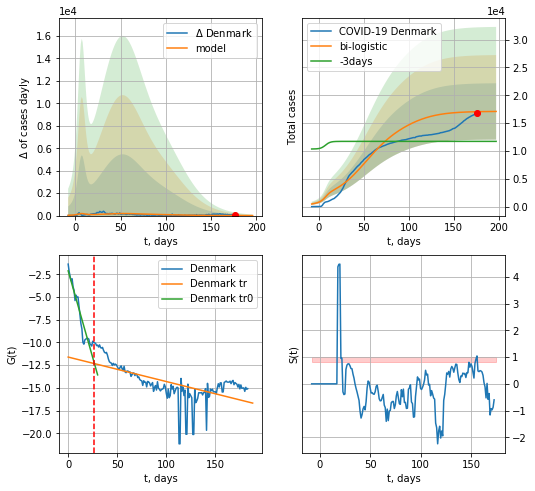

Denmark data at: 2020-08-29
+3 day model MAPE: 0.4554648557837095
model: bi-logistic
coeffs:  [1.25900283e+04 5.56255156e-02 5.08937066e+01] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.29611947918024895
forecast at the end of period: +21 days
	 deltaDaycases:  1
	 total cases:  17087 ± 5060
	 total death:  635 ± 564
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.383738
 intercept: -11.610649
 slope: -0.026923


In [1755]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [1756]:
d12f(4)

'2020-08-26'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


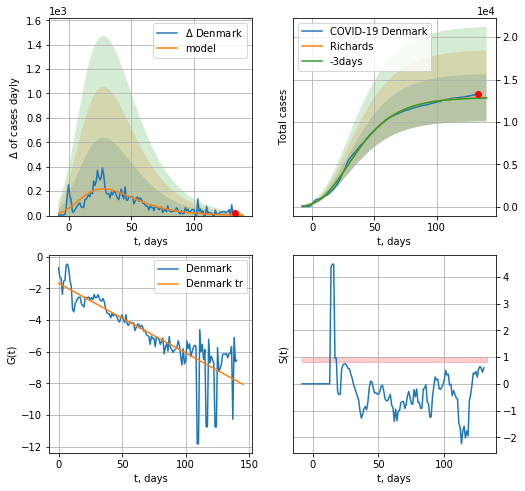

Denmark data at: 2020-08-29
+3 day model MAPE: 0.003205
model: Richards
coeffs: [ 1.29346492e+04  5.54024476e+00 -7.51621135e+01  8.35187087e-03]
rational stdev: 0.216347
forecast at the end of period: +7 days
	 deltaDaycases: 3
	 total cases: 12861 ± 2782
	 total death: 478 ± 310
trend coefficient of determination: 0.712007
 intercept: -1.674251
 slope: -0.044008


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


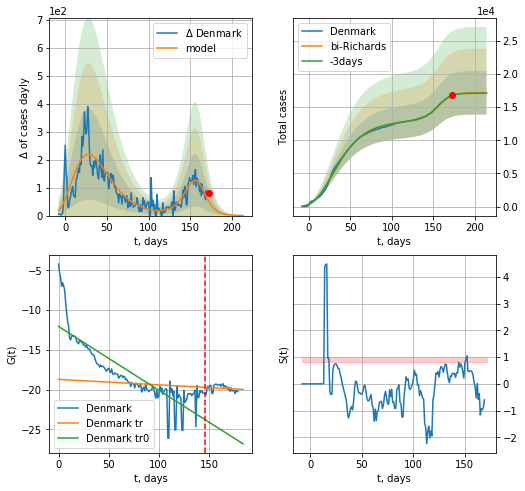

Denmark data at: 2020-08-29
+3 day model MAPE: 0.002000
model: bi-Richards
coeffs: [4.27702467e+03 8.83888375e-02 1.59340660e+02 1.52649644e+00]
rational stdev: 0.191955
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 17207 ± 3303
	 total death: 639 ± 367
bi-Richards approximation splitting point: 146
trend coefficient of determination: 0.722484
 intercept: -12.052887
 slope: -0.080244
trend coefficient of determination: 0.026543
 intercept: -18.712444
 slope: -0.006838


In [1757]:
vL = 150#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,28*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


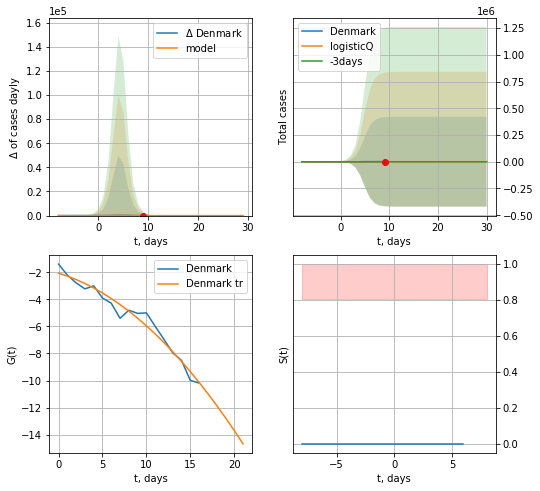

Denmark data at: 2020-08-29
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480486e+02  2.49394711e-04  4.73670535e+00 -4.50101209e+03]
rational stdev: 487.273007
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 862 ± 420263
	 total death: 32 ± 46778
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


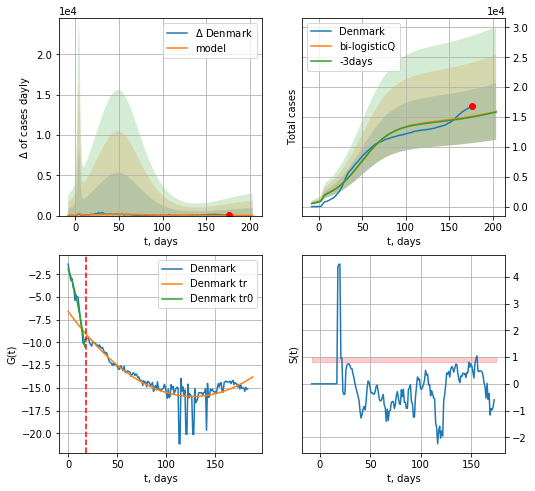

Denmark data at: 2020-08-29
+3 day model MAPE: 0.008776
model: bi-logisticQ
coeffs: [ 1.30844592e+04  4.76449679e-08  4.92132408e+01 -1.15418369e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.296584
forecast at the end of period: +28 days
	 deltaDaycases: 31
	 total cases: 15927 ± 4723
	 total death: 592 ± 526
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.763390
 intercept_: -6.600619832859514
 coeffs_: [ 0.        -0.1469708  0.0005781]


In [1758]:
x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
181 2020-08-25  10454.0    1040  264.0
182 2020-08-26  10504.0    1090  264.0
183 2020-08-27  10542.0     930  264.0
184 2020-08-28  10582.0     970  264.0
185 2020-08-29  10611.0     999  264.0


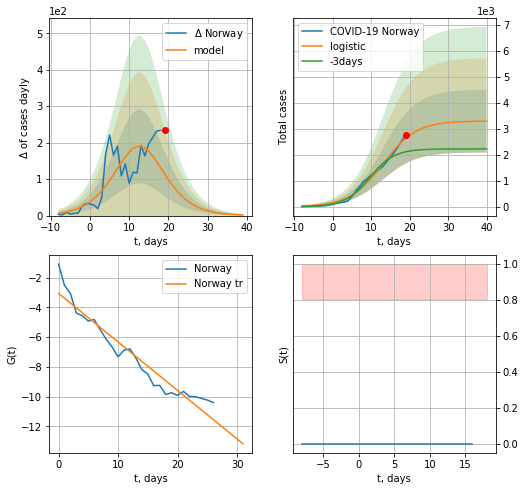

Norway data at: 2020-08-29
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +21 days
	 deltaDaycases:  1
	 total cases:  3291 ± 1209
	 total death:  81 ± 89
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


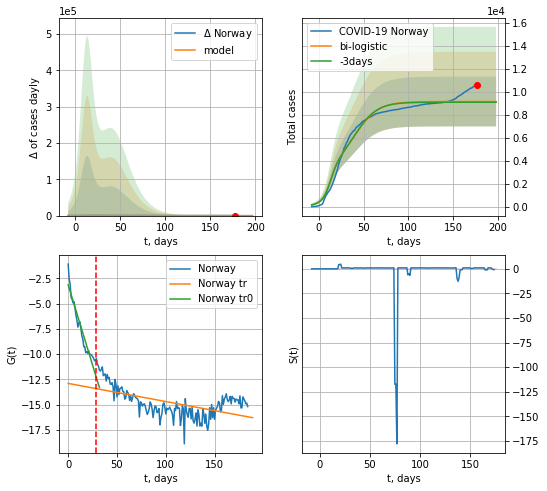

Norway data at: 2020-08-29
+3 day model MAPE: 0.00675318900217938
model: bi-logistic
coeffs:  [5.83751128e+03 7.72597778e-02 4.03940044e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.23670138129915722
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  9135 ± 2162
	 total death:  227 ± 161
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.311387
 intercept: -12.887136
 slope: -0.017908


In [1759]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

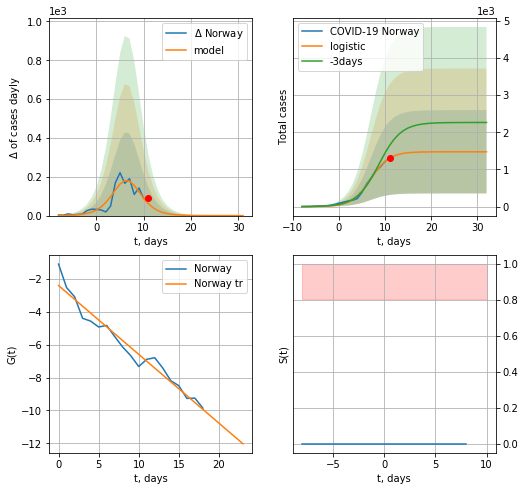

Norway data at: 2020-08-29
+3 day model MAPE: 0.24765534865647335
model: logistic
coeffs:  [1.47478892e+03 4.95866797e-01 6.87524750e+00]
rational stdev:  0.7596156046192828
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1474 ± 1120
	 total death:  36 ± 82
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


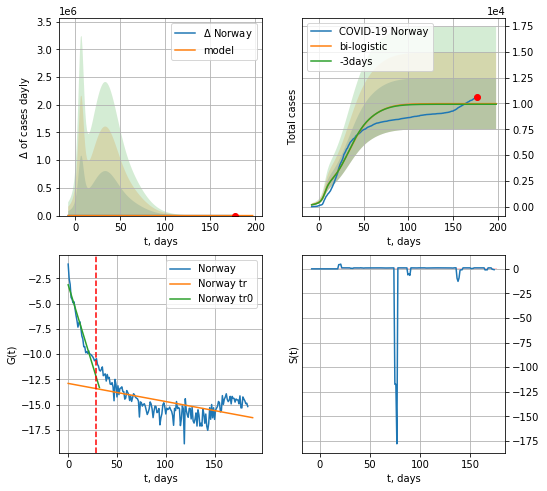

Norway data at: 2020-08-29
+3 day model MAPE: 0.00598946196214405
model: bi-logistic
coeffs:  [7.56224764e+03 8.99161702e-02 3.32153560e+01] [1.47478892e+03 4.95866797e-01 6.87524750e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.2483880757866519
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  9982 ± 2479
	 total death:  248 ± 184
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.311387
 intercept: -12.887136
 slope: -0.017908


In [1760]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


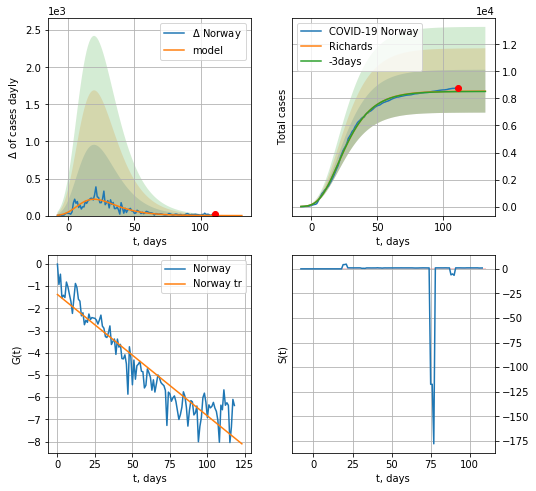

Norway data at: 2020-08-29
+3 day model MAPE: 0.002349
model: Richards
coeffs: [ 8.53893504e+03  9.40298407e+00 -4.93140335e+01  7.49676920e-03]
rational stdev: 0.185681
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 8535 ± 1584
	 total death: 212 ± 118
trend coefficient of determination: 0.886133
 intercept: -1.376205
 slope: -0.054692


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


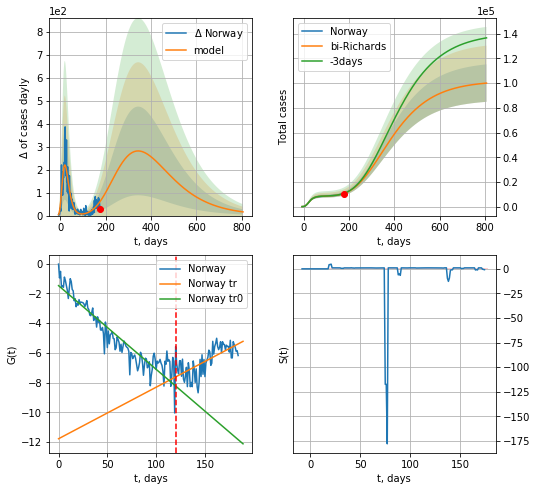

Norway data at: 2020-08-29
+3 day model MAPE: 0.002399
model: bi-Richards
coeffs: [ 9.34586772e+04  2.78710821e-01 -7.80578061e+01  2.98680742e-02]
rational stdev: 0.151632
forecast at the end of period: +630 days
	 deltaDaycases: 16
	 total cases: 100043 ± 15169
	 total death: 2489 ± 1132
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.884553
 intercept: -1.480612
 slope: -0.056279
trend coefficient of determination: 0.444551
 intercept: -11.776857
 slope: 0.034661


In [1761]:
vL = 120#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,112*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


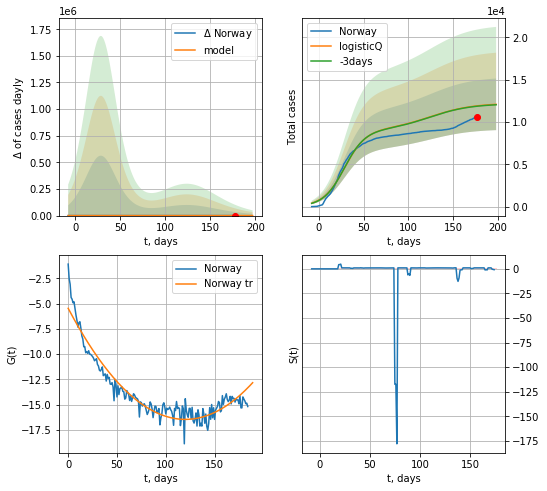

Norway data at: 2020-08-29
+3 day model MAPE: 0.003614
model: logisticQ
coeffs: [ 9.02857513e+03  8.50304681e-08  2.86372606e+01 -9.94649655e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252301
forecast at the end of period: +21 days
	 deltaDaycases: 5
	 total cases: 12090 ± 3050
	 total death: 300 ± 227
trend coefficient of determination: 0.913774
 intercept_: -5.467562303770116
 coeffs_: [ 0.         -0.18288432  0.00076187]


In [1763]:
x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


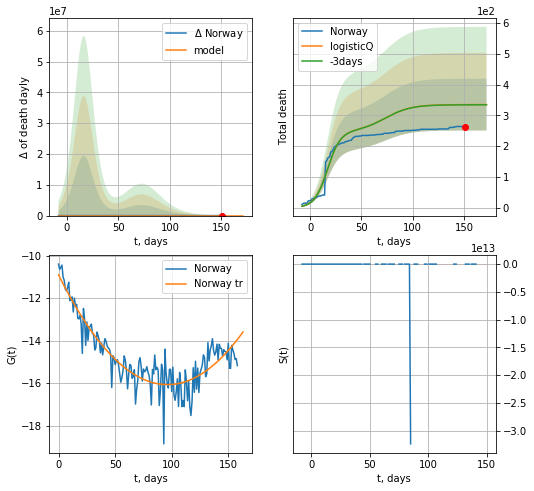

Norway data at: 2020-08-29
+3 day model MAPE: 0.001946
model: logisticQ
coeffs: [ 2.47597340e+02  3.41018430e-07  1.67973282e+01 -4.63876988e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.250946
forecast at the end of period: +21 days
	 total death: 335 ± 84
trend coefficient of determination: 0.812539
 intercept_: -10.909938372135837
 coeffs_: [ 0.         -0.10721608  0.00055683]


In [1765]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
182 2020-08-25  83550       0  5814.0
183 2020-08-26  83724       0  5817.0
184 2020-08-27  83898       0  5820.0
185 2020-08-28  83958       0  5821.0
186 2020-08-29  83958       0  5821.0


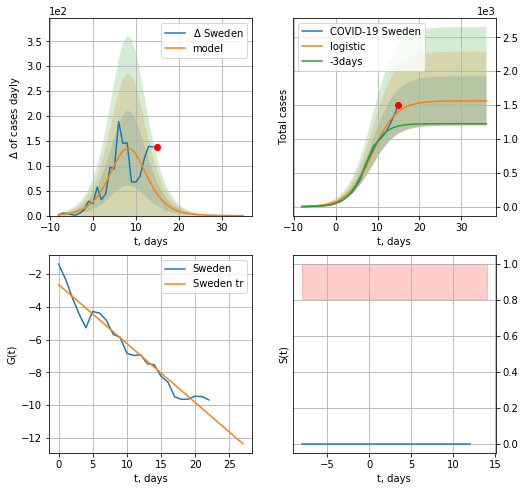

Sweden data at: 2020-08-29
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1562 ± 363
	 total death:  108 ± 75
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


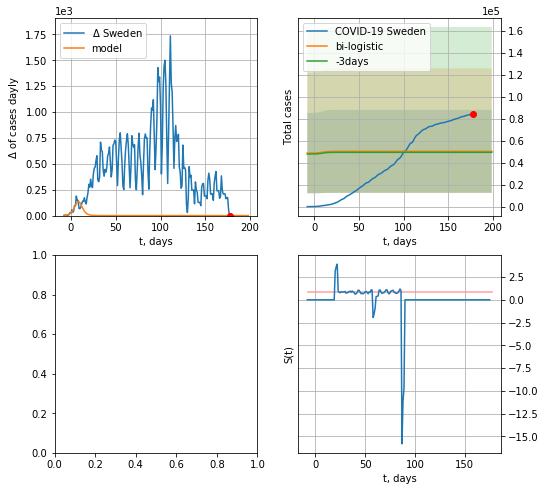

In [1766]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
181 2020-08-24  83387       0  5813.0
182 2020-08-25  83550       0  5814.0
183 2020-08-26  83724       0  5817.0
184 2020-08-27  83898       0  5820.0
185 2020-08-28  83958       0  5821.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


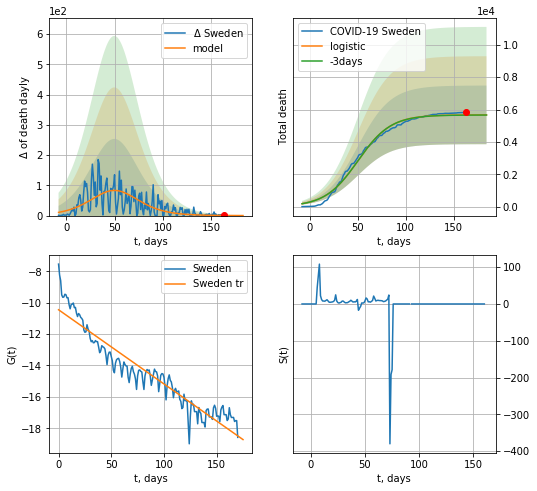

Sweden data at: 2020-08-28
+3 day model MAPE: 0.0017357353884500455
model: logistic
coeffs:  [5.67303022e+03 5.86387854e-02 5.02485343e+01]
rational stdev:  0.3196999647707
forecast at the end of period: +21 days
	 total death:  5670 ± 1812
trend coefficient of determination: 0.900903
 intercept: -10.450392
 slope: -0.047272


In [1352]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


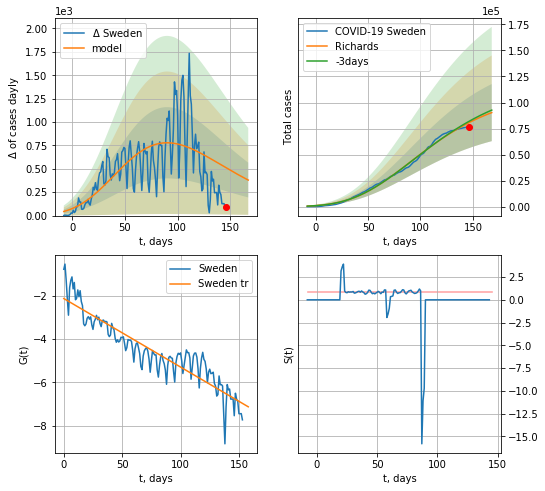

Sweden data at: 2020-08-28
+3 day model MAPE: 0.015179
model: Richards
coeffs: [ 1.11703688e+05  2.10862768e-01 -2.88394660e+01  9.40207180e-02]
rational stdev: 0.303841
forecast at the end of period: +22 days
	 deltaDaycases: 379
	 total cases: 90307 ± 27439
	 total death: 6261 ± 5707
trend coefficient of determination: 0.847962
 intercept: -2.115492
 slope: -0.031754


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


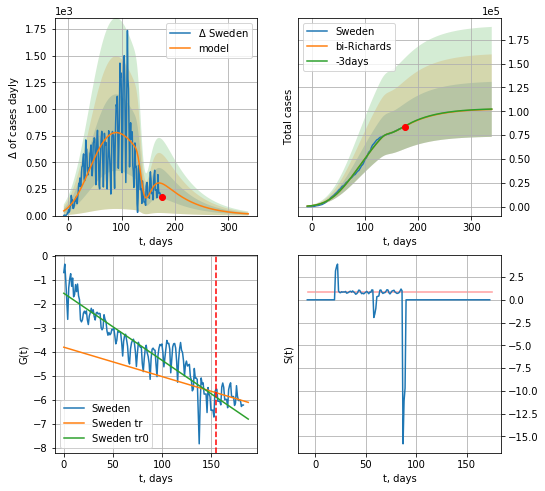

Sweden data at: 2020-08-28
+3 day model MAPE: 0.003053
model: bi-Richards
coeffs: [-8.87056349e+03  2.78109854e+01  9.31530824e+01  3.86589402e-03]
rational stdev: 0.282647
forecast at the end of period: +162 days
	 deltaDaycases: 16
	 total cases: 102011 ± 28833
	 total death: 7072 ± 5996
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.832239
 intercept: -1.560345
 slope: -0.027912
trend coefficient of determination: 0.106505
 intercept: -3.809482
 slope: -0.012235


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [1353]:
iL = 0
vL = 155+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[iL:-1],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


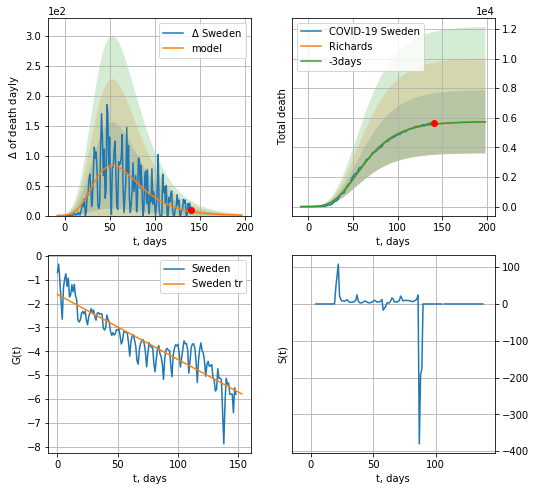

Sweden data at: 2020-08-28
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +57 days
	 total death: 5732 ± 2134
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


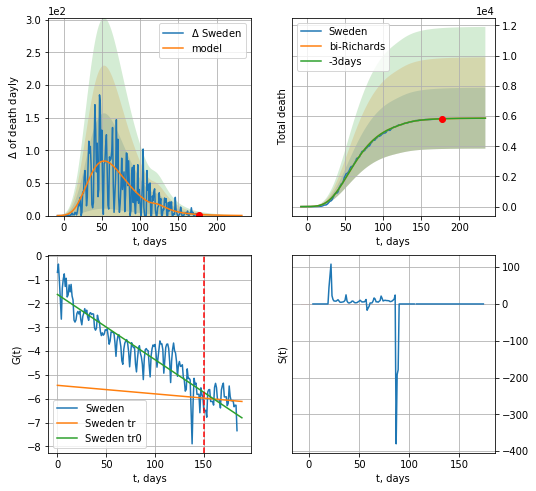

Sweden data at: 2020-08-28
+3 day model MAPE: 0.000021
model: bi-Richards
coeffs: [1.11870267e+02 1.32964550e+01 8.23600704e+01 8.31611181e-03]
rational stdev: 0.344065
forecast at the end of period: +57 days
	 total death: 5858 ± 2015
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.818708
 intercept: -1.624473
 slope: -0.027369
trend coefficient of determination: 0.007436
 intercept: -5.436492
 slope: -0.003578


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [1354]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


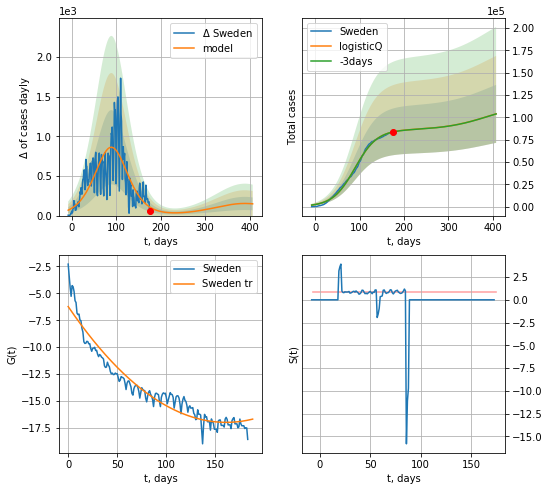

Sweden data at: 2020-08-28
+3 day model MAPE: 0.001015
model: logisticQ
coeffs: [ 8.58767325e+04  6.17286472e-07  8.94595139e+01 -6.49233751e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312438
forecast at the end of period: +232 days
	 deltaDaycases: 148
	 total cases: 103826 ± 32439
	 total death: 7198 ± 6746
trend coefficient of determination: 0.928498
 intercept_: -6.230630080616882
 coeffs_: [ 0.         -0.13373207  0.00041522]


In [1355]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


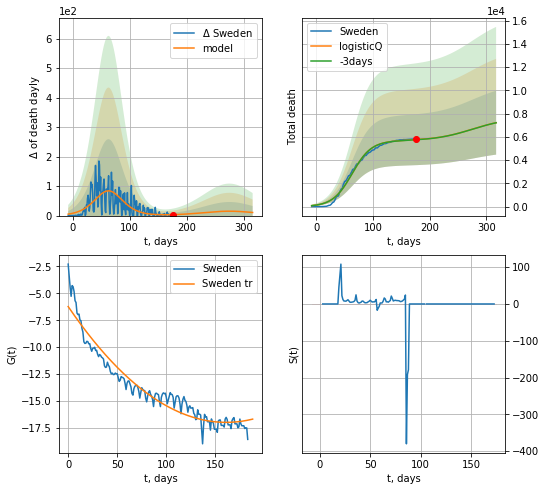

Sweden data at: 2020-08-28
+3 day model MAPE: 0.001749
model: logisticQ
coeffs: [ 5.66793777e+03  1.21373513e-07  6.32243606e+01 -4.86811090e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380509
forecast at the end of period: +141 days
	 total death: 7221 ± 2747
trend coefficient of determination: 0.928498
 intercept_: -6.230630080616882
 coeffs_: [ 0.         -0.13373207  0.00041522]


In [1356]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
216 2020-08-25  84996.0     347  4634.0
217 2020-08-26  85004.0     324  4634.0
218 2020-08-27  85013.0     288  4634.0
219 2020-08-28  85022.0     262  4634.0
220 2020-08-29  85031.0     244  4634.0


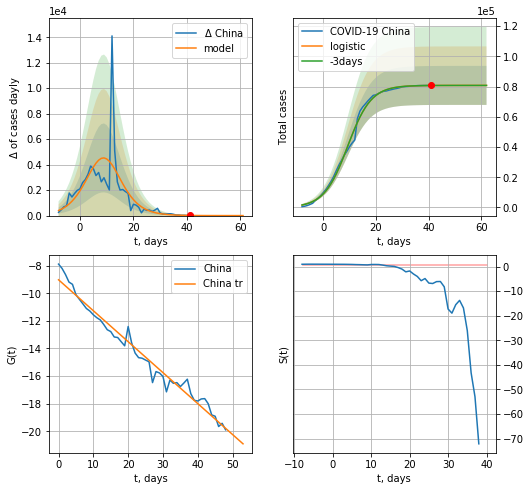

China data at: 2020-08-29
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  80809 ± 12906
	 total death:  4403 ± 2109
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


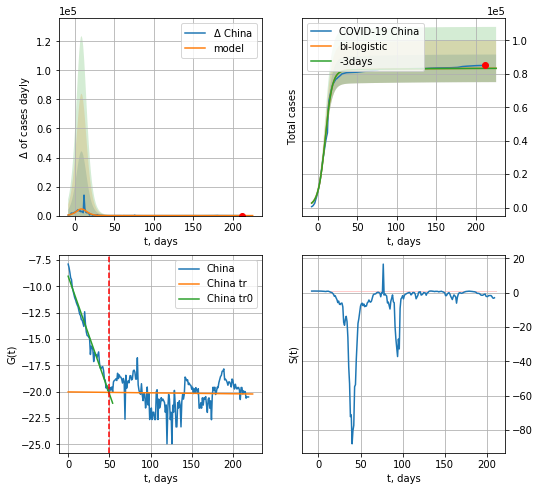

China data at: 2020-08-29
+3 day model MAPE: 0.000457974786620275
model: bi-logistic
coeffs:  [2.53148309e+03 1.74437199e-02 1.04034606e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09911750480812997
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  83284 ± 8254
	 total death:  4538 ± 1349
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.001006
 intercept: -20.025603
 slope: -0.000876


In [1767]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,24*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [1768]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

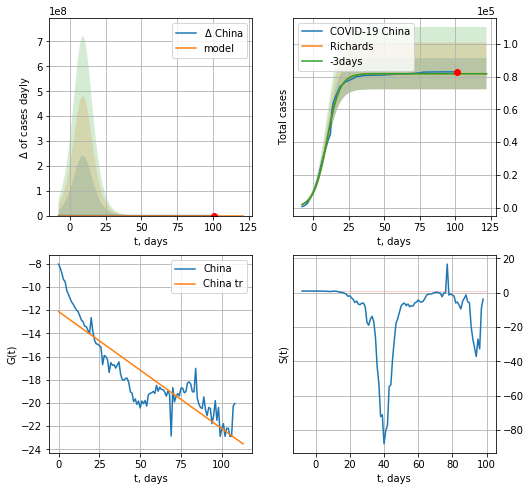

China data at: 2020-08-29
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4456 ± 1556
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


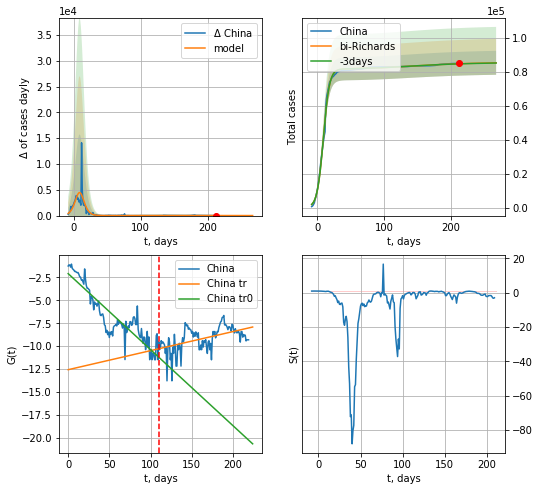

China data at: 2020-08-29
+3 day model MAPE: 0.000699
model: bi-Richards
coeffs: [ 4.03275164e+03  1.22610403e+00 -1.38937028e+02  1.29715958e-02]
rational stdev: 0.082670
forecast at the end of period: +56 days
	 deltaDaycases: 6
	 total cases: 85353 ± 7056
	 total death: 4651 ± 1153
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820953
 intercept: -2.082806
 slope: -0.082863
trend coefficient of determination: 0.260949
 intercept: -12.560091
 slope: 0.020774


In [1769]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,30*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

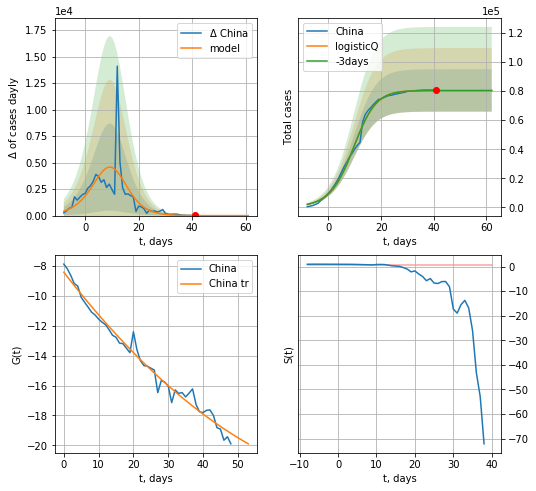

China data at: 2020-08-29
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4382 ± 2379
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


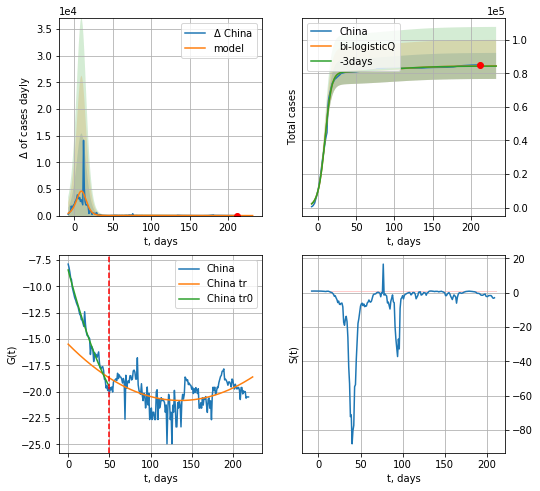

China data at: 2020-08-29
+3 day model MAPE: 0.001204
model: bi-logisticQ
coeffs: [ 4.06187564e+03  1.45340951e-07  9.52807015e+01 -2.12503814e+05]
rational stdev: 0.091808
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 84422 ± 7750
	 total death: 4600 ± 1266
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.212235
 intercept_: -15.489814562077179
 coeffs_: [ 0.         -0.07868053  0.00028924]


In [1770]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [1771]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
192 2020-08-25  18265  3585.0  312.0
193 2020-08-26  18706  3932.0  313.0
194 2020-08-27  19077  4210.0  316.0
195 2020-08-28  19400  4314.0  321.0
196 2020-08-29  19699  4473.0  323.0


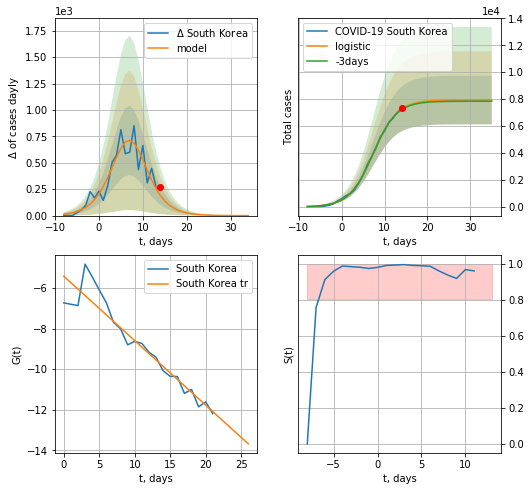

South Korea data at: 2020-08-29
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  7940 ± 1807
	 total death:  130 ± 88
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


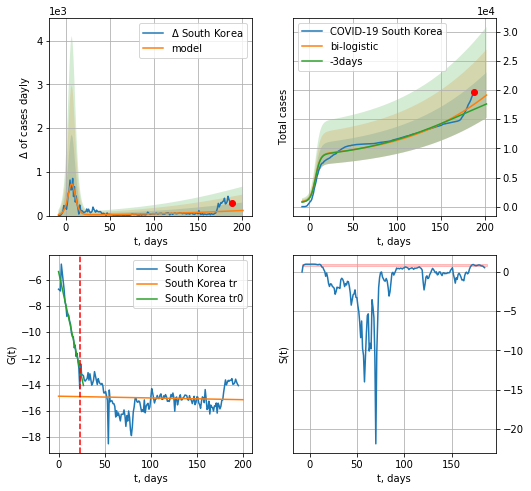

South Korea data at: 2020-08-29
+3 day model MAPE: 0.05409349302853543
model: bi-logistic
coeffs:  [5.69142454e+04 1.31135146e-02 3.09466427e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.20357596866132135
forecast at the end of period: +14 days
	 deltaDaycases:  117
	 total cases:  19116 ± 3891
	 total death:  313 ± 191
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.004546
 intercept: -14.882396
 slope: -0.001332


In [1772]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,24*7-dT,x,1.0,vL=23)

In [1773]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

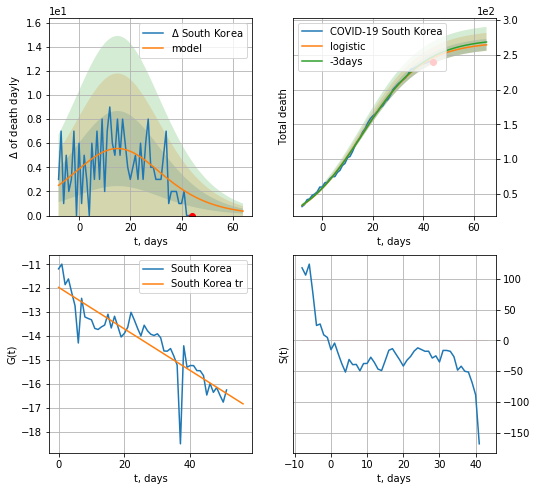

South Korea data at: 2020-08-29
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +21 days
	 total death:  264 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


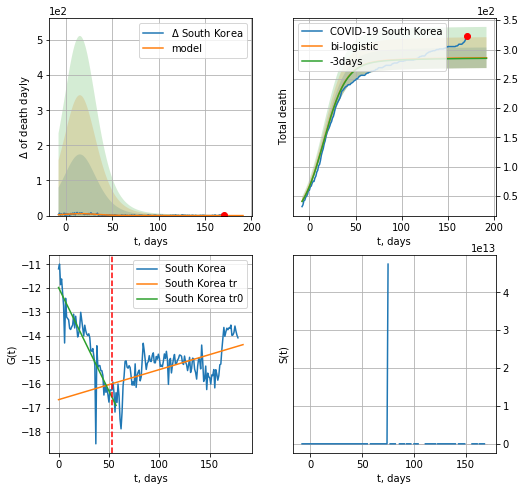

South Korea data at: 2020-08-29
+3 day model MAPE: 0.003204925846013438
model: bi-logistic
coeffs:  [1.81451330e+01 1.71841693e-02 9.76418759e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.061401210123316195
forecast at the end of period: +21 days
	 deltaDaydeath:  0
	 total death:  285 ± 17
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.337132
 intercept: -16.662775
 slope: 0.012574


In [1774]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


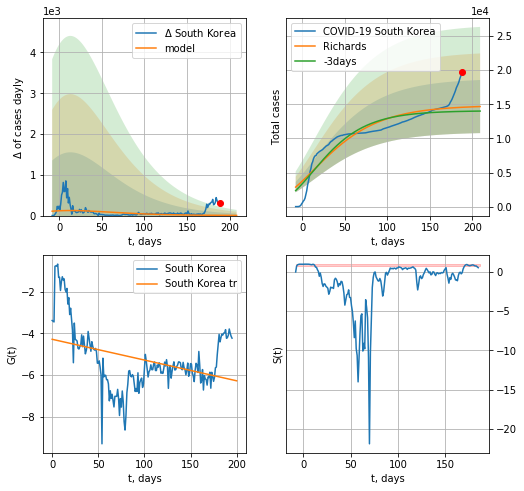

South Korea data at: 2020-08-29
+3 day model MAPE: 0.043355
model: Richards
coeffs: [ 1.48412835e+04  5.85711322e+00 -2.29184625e+02  3.89768846e-03]
rational stdev: 0.264819
forecast at the end of period: +21 days
	 deltaDaycases: 3
	 total cases: 14670 ± 3884
	 total death: 240 ± 190
trend coefficient of determination: 0.135257
 intercept: -4.280094
 slope: -0.009948


In [1775]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


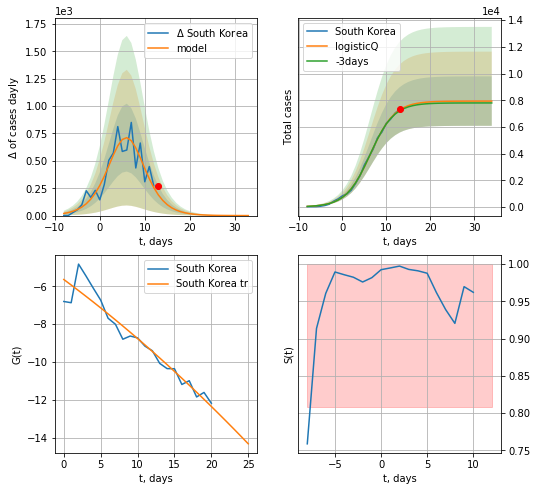

South Korea data at: 2020-08-29
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 130 ± 91
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


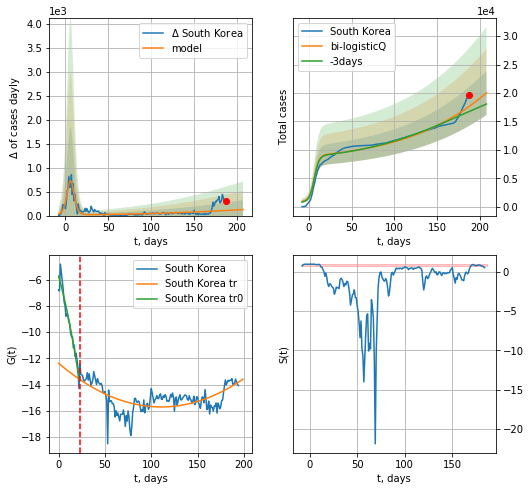

South Korea data at: 2020-08-29
+3 day model MAPE: 0.054281
model: bi-logisticQ
coeffs: [ 5.84707385e+04  5.63282270e-07  3.09996779e+02 -2.32378373e+04]
rational stdev: 0.193606
forecast at the end of period: +21 days
	 deltaDaycases: 125
	 total cases: 20002 ± 3872
	 total death: 327 ± 189
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.372009
 intercept_: -12.371271213223439
 coeffs_: [ 0.         -0.06018901  0.00027182]


In [1776]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [1777]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [1778]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


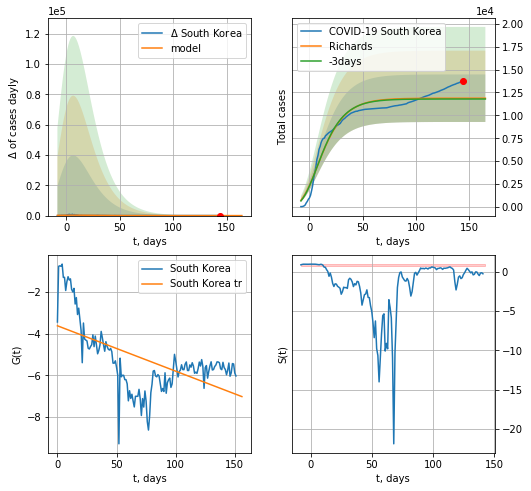

South Korea data at: 2020-08-29
+3 day model MAPE: 0.007391
model: Richards
coeffs: [ 1.18728381e+04  2.29888656e+01 -7.81985998e+01  2.96586293e-03]
rational stdev: 0.218661
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 11872 ± 2596
	 total death: 194 ± 127
trend coefficient of determination: 0.335305
 intercept: -3.625965
 slope: -0.021749


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


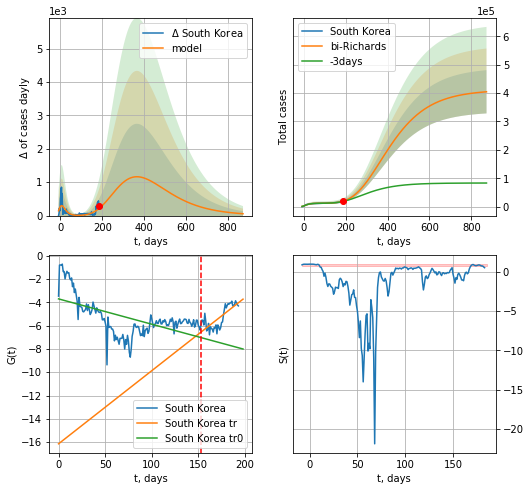

South Korea data at: 2020-08-29
+3 day model MAPE: 0.041276
model: bi-Richards
coeffs: [ 3.99718466e+05  6.33453280e-01 -1.84268591e+02  1.25616371e-02]
rational stdev: 0.188317
forecast at the end of period: +686 days
	 deltaDaycases: 55
	 total cases: 404535 ± 76180
	 total death: 6633 ± 3747
bi-Richards approximation splitting point: 153
trend coefficient of determination: 0.337198
 intercept: -3.711564
 slope: -0.021708
trend coefficient of determination: 0.596175
 intercept: -16.141388
 slope: 0.062664


In [1779]:
vL = 2
vL1 = 155
x = forecastRR('South Korea',dfKR[vL:vL1],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,120*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [1780]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [1781]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
215 2020-08-25  56495.0    1652   27.0
216 2020-08-26  56572.0    1574   27.0
217 2020-08-27  56666.0    1500   27.0
218 2020-08-28  56717.0    1353   27.0
219 2020-08-29  56771.0    1297   27.0


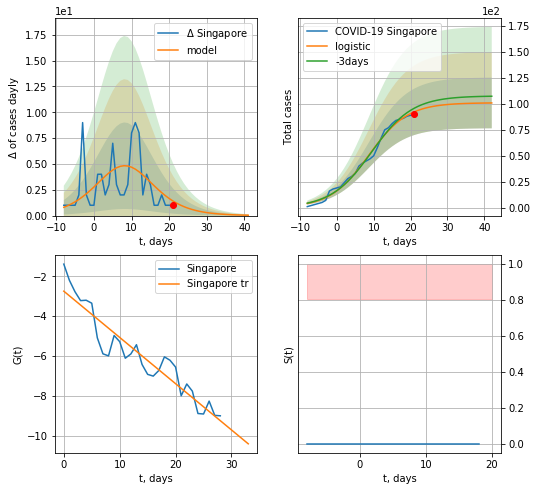

Singapore data at: 2020-08-29
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  100 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


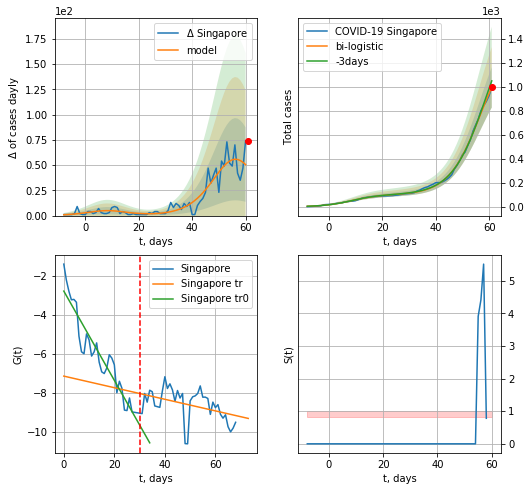

Singapore data at: 2020-08-29
Exception occurs


In [1782]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,22*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

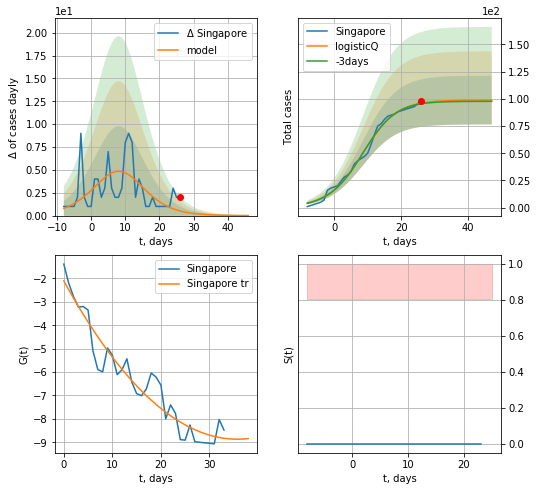

Singapore data at: 2020-08-29
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


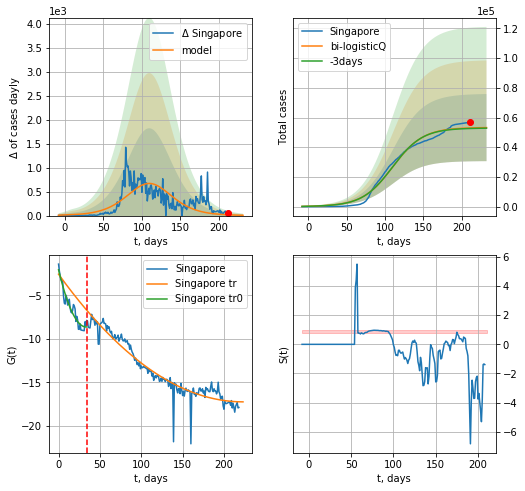

Singapore data at: 2020-08-29
+3 day model MAPE: 0.006964
model: bi-logisticQ
coeffs: [ 5.32015308e+04  7.48156159e-08  1.09942881e+02 -6.74237485e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.424690
forecast at the end of period: +21 days
	 deltaDaycases: 6
	 total cases: 53223 ± 22603
	 total death: 25 ± 31
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.914736
 intercept_: -2.546716782674416
 coeffs_: [ 0.         -0.1319911   0.00029606]


In [1784]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [1785]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


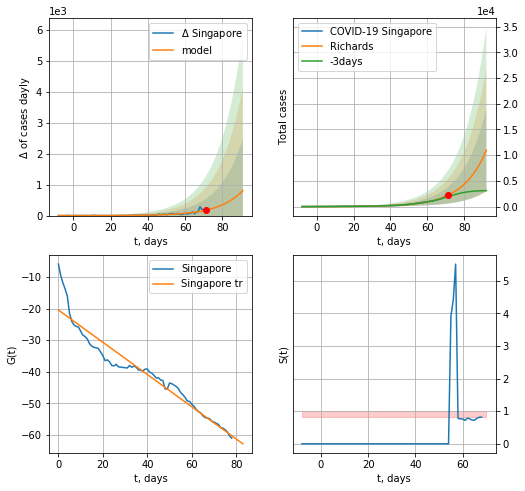

Singapore data at: 2020-08-29
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +21 days
	 deltaDaycases: 806
	 total cases: 10964 ± 7985
	 total death: 5 ± 10
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


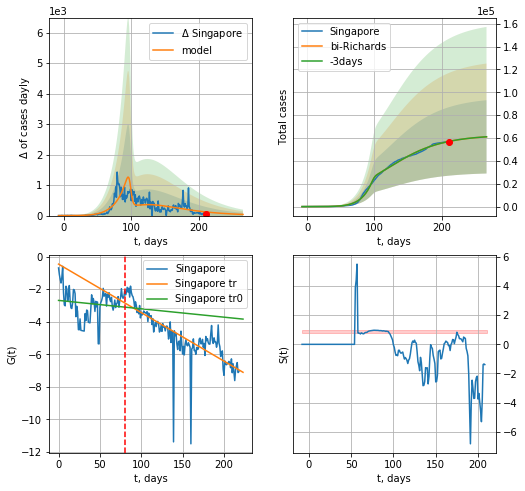

Singapore data at: 2020-08-29
+3 day model MAPE: 0.000504
model: bi-Richards
coeffs: [ 4.34587179e+04  2.24214899e+00 -7.78200866e+01  1.01230453e-02]
rational stdev: 0.525241
forecast at the end of period: +56 days
	 deltaDaycases: 37
	 total cases: 61009 ± 32044
	 total death: 29 ± 45
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.016012
 intercept: -2.694575
 slope: -0.005144
trend coefficient of determination: 0.611524
 intercept: -0.465469
 slope: -0.029789


In [1786]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
166 2020-08-25  2311.0     193   64.0
167 2020-08-26  2325.0     194   64.0
168 2020-08-27  2343.0     203   64.0
169 2020-08-28  2363.0     213   64.0
170 2020-08-29  2373.0     221   64.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


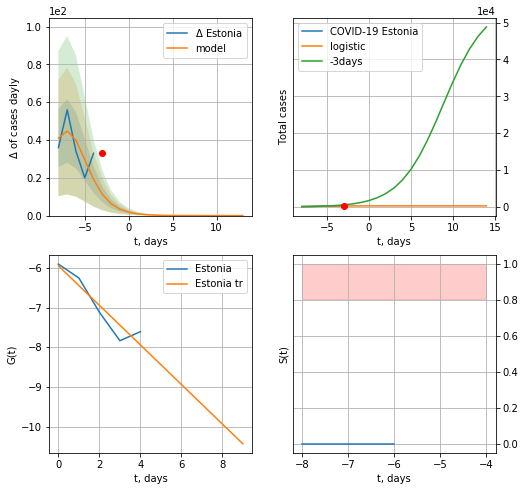

Estonia data at: 2020-08-29
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  7 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


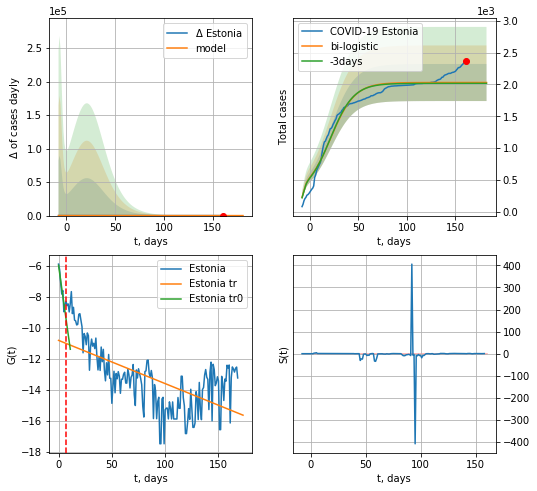

Estonia data at: 2020-08-29
+3 day model MAPE: 0.006576899333690641
model: bi-logistic
coeffs:  [1.75321362e+03 8.11170514e-02 2.14389274e+01] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.14351639195900634
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  2030 ± 291
	 total death:  54 ± 23
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.391924
 intercept: -10.819536
 slope: -0.027864


In [1787]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


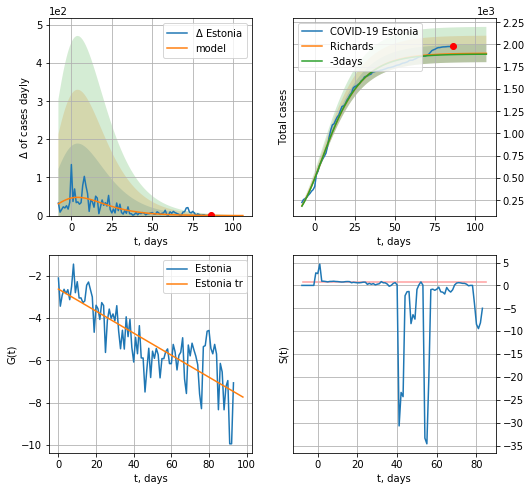

Estonia data at: 2020-08-29
+3 day model MAPE: 0.004828
model: Richards
coeffs: [ 1.90234229e+03  8.05122761e+00 -6.49439772e+01  8.53882183e-03]
rational stdev: 0.052085
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1900 ± 98
	 total death: 51 ± 7
trend coefficient of determination: 0.683583
 intercept: -2.627136
 slope: -0.052184


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


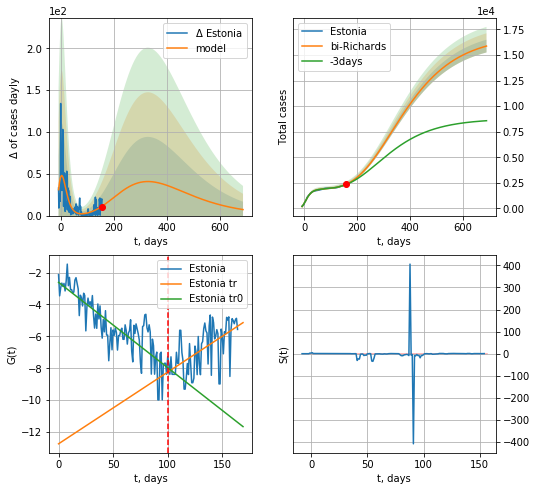

Estonia data at: 2020-08-29
+3 day model MAPE: 0.008262
model: bi-Richards
coeffs: [ 1.49745007e+04  6.03932573e-01 -2.61667393e+02  1.23138748e-02]
rational stdev: 0.039319
forecast at the end of period: +532 days
	 deltaDaycases: 7
	 total cases: 15878 ± 624
	 total death: 428 ± 50
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.719174
 intercept: -2.609754
 slope: -0.053565
trend coefficient of determination: 0.347234
 intercept: -12.741249
 slope: 0.044979


In [1788]:
iL = 5
vL=100+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[iL:],d1,7*98-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


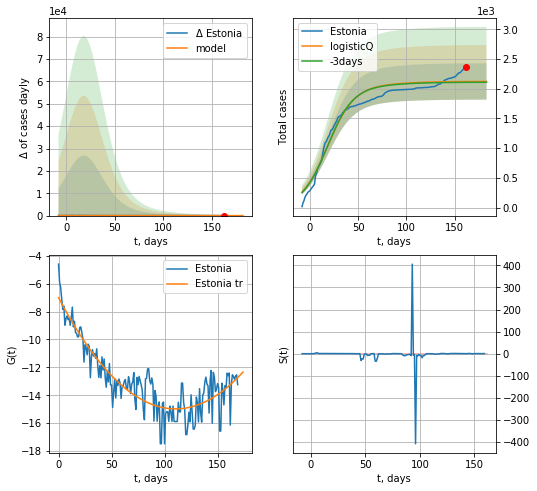

Estonia data at: 2020-08-29
+3 day model MAPE: 0.006186
model: logisticQ
coeffs: [ 2.03517556e+03  6.03405888e-08  1.83485870e+01 -1.21614231e+06]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.144100
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 2122 ± 305
	 total death: 57 ± 24
trend coefficient of determination: 0.804297
 intercept_: -7.005723710398278
 coeffs_: [ 0.         -0.144508    0.00065441]


In [1789]:
x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
171 2020-08-25  1360.0     192   33.0
172 2020-08-26  1366.0     169   34.0
173 2020-08-27  1375.0     178   34.0
174 2020-08-28  1381.0     184   34.0
175 2020-08-29  1393.0     196   34.0


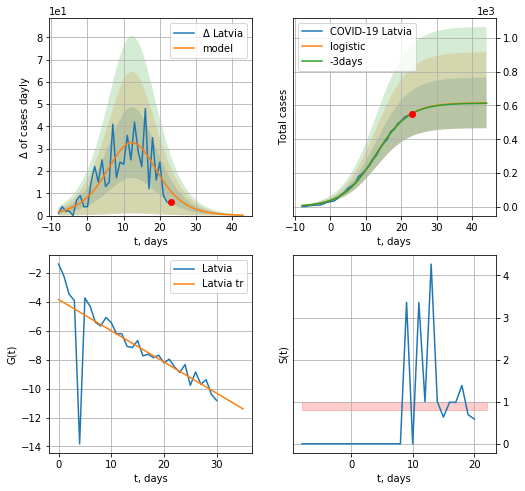

Latvia data at: 2020-08-29
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  615 ± 149
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


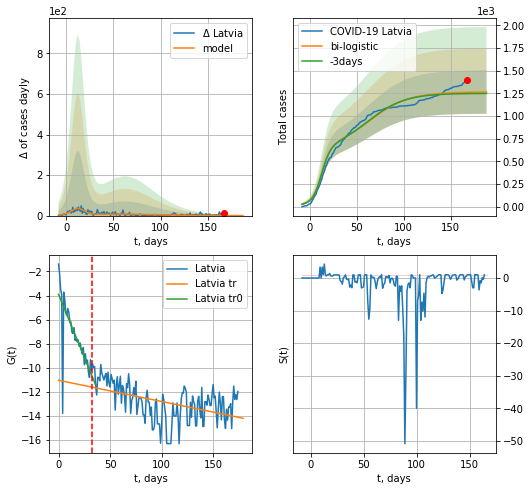

Latvia data at: 2020-08-29
+3 day model MAPE: 0.011697119822735122
model: bi-logistic
coeffs:  [6.50028783e+02 4.73989315e-02 6.27314080e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.18948016947957208
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1264 ± 239
	 total death:  30 ± 17
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.219055
 intercept: -11.056795
 slope: -0.017667


In [1790]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


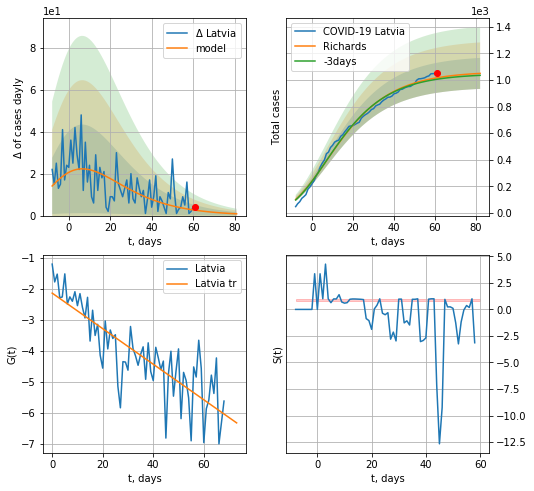

Latvia data at: 2020-08-29
+3 day model MAPE: 0.011078
model: Richards
coeffs: [ 1.06333537e+03  7.08982273e+00 -7.72639807e+01  8.06725773e-03]
rational stdev: 0.110885
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1048 ± 116
	 total death: 25 ± 8
trend coefficient of determination: 0.685809
 intercept: -2.142789
 slope: -0.057409


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


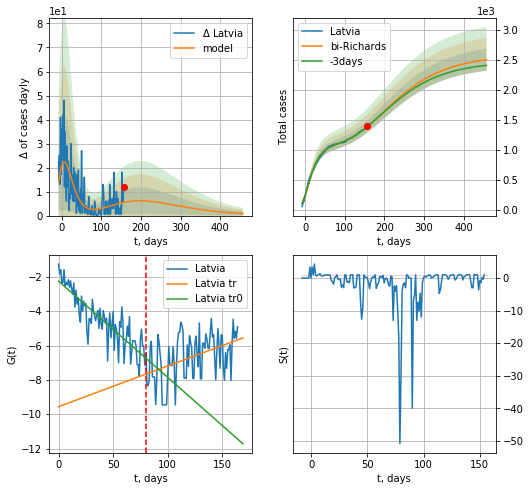

Latvia data at: 2020-08-29
+3 day model MAPE: 0.001632
model: bi-Richards
coeffs: [ 1.51114821e+03  5.56459712e-01 -1.50408710e+02  2.01717520e-02]
rational stdev: 0.073146
forecast at the end of period: +301 days
	 deltaDaycases: 0
	 total cases: 2495 ± 182
	 total death: 60 ± 13
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.732719
 intercept: -2.250123
 slope: -0.056071
trend coefficient of determination: 0.187187
 intercept: -9.563598
 slope: 0.023733


In [1791]:
iL=10
vL = 80+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*65-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


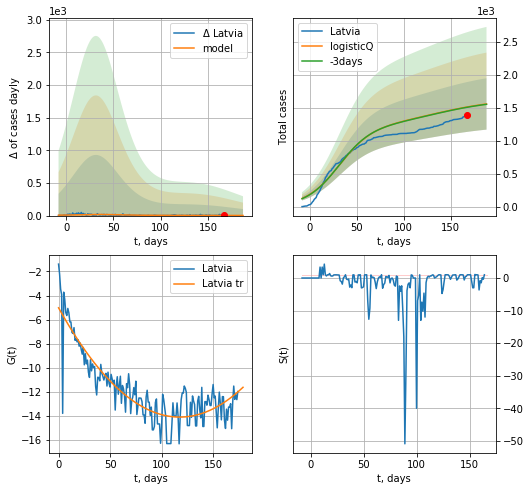

Latvia data at: 2020-08-29
+3 day model MAPE: 0.002902
model: logisticQ
coeffs: [ 1.21191148e+03  5.70234618e-08  3.13942247e+01 -9.88871643e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.249979
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 1559 ± 389
	 total death: 38 ± 28
trend coefficient of determination: 0.785226
 intercept_: -5.0242418196483385
 coeffs_: [ 0.         -0.15478094  0.00065815]


In [1792]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


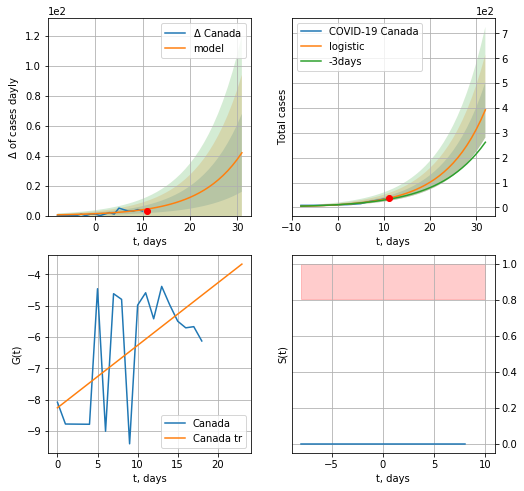

Canada data at: 2020-08-29
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  28 ± 23
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


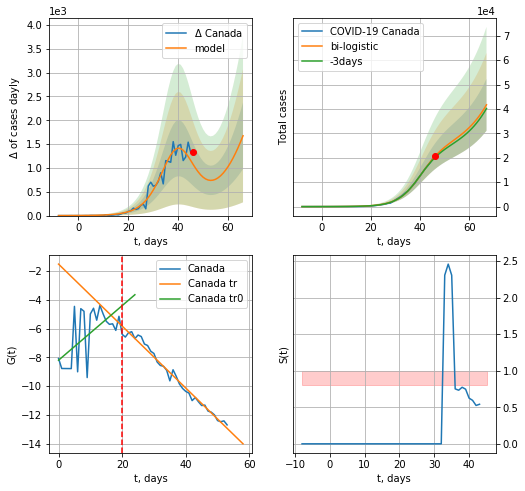

Canada data at: 2020-08-29
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +21 days
	 deltaDaycases:  1675
	 total cases:  41716 ± 10634
	 total death:  2977 ± 2276
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


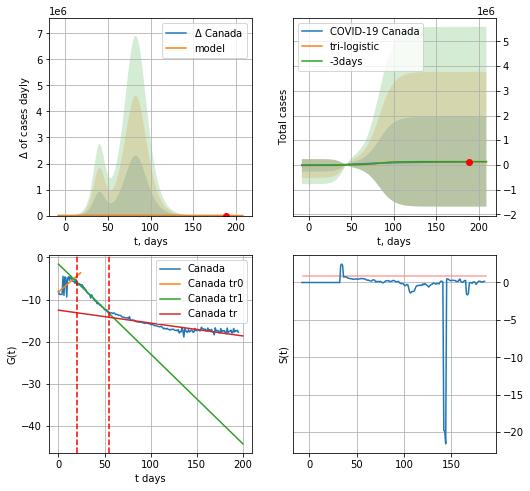

Canada data at: 2020-08-29
+3 day model MAPE: 0.00045214859083012753
model: tri-logistic
coeffs:  [-1.82286529e+04  2.11217376e+00 -3.79936053e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  13.865401936050189
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  131129 ± 1818165
	 total death:  9359 ± 389298
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.774970
 intercept: -12.518847
 slope: -0.030621


In [1793]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
192 2020-08-25  125969.0    4829  9090.0
193 2020-08-26  126417.0    4868  9094.0
194 2020-08-27  126848.0    4921  9102.0
195 2020-08-28  127358.0    5016  9108.0
196 2020-08-29  127673.0    5059  9113.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


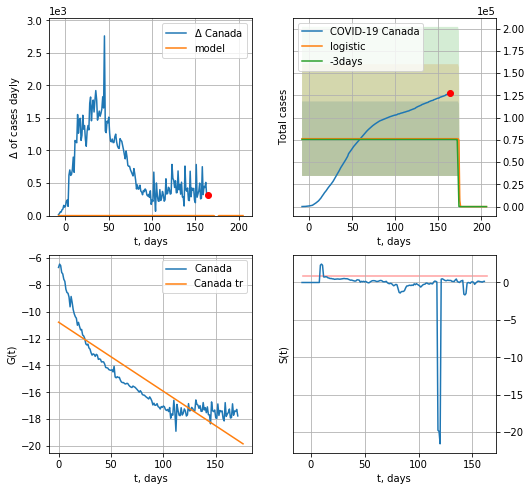

Canada data at: 2020-08-29
+3 day model MAPE: 0.01192475787002785
model: logistic
coeffs:  [ 7.63251214e+04 -6.16581429e+00  1.74612045e+02]
rational stdev:  0.5485931001201434
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.765884
 intercept: -10.775097
 slope: -0.051518


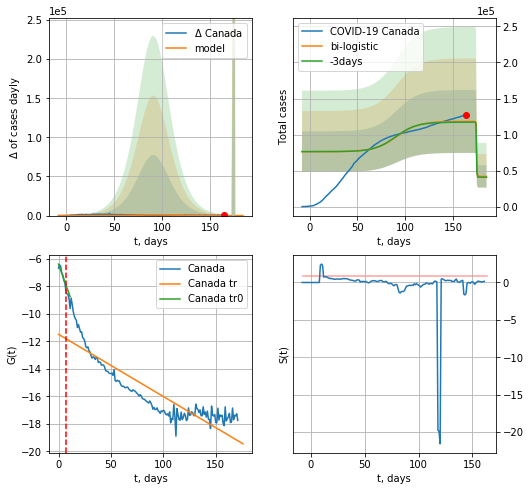

Canada data at: 2020-08-29
+3 day model MAPE: 0.009307832424918177
model: bi-logistic
coeffs:  [4.19981740e+04 8.74759578e-02 9.10924500e+01] [ 7.63251214e+04 -6.16581429e+00  1.74612045e+02]
rational stdev:  0.3693303189128279
forecast at the end of period: +21 days
	 deltaDaycases:  1
	 total cases:  41986 ± 15507
	 total death:  2996 ± 3319
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.778821
 intercept: -11.499011
 slope: -0.045241


In [1794]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

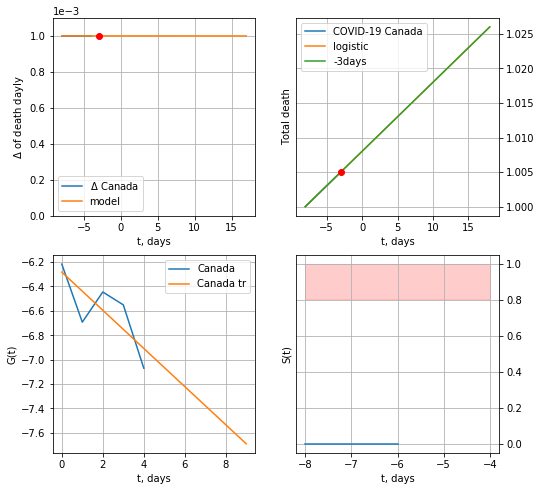

Canada data at: 2020-08-29
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


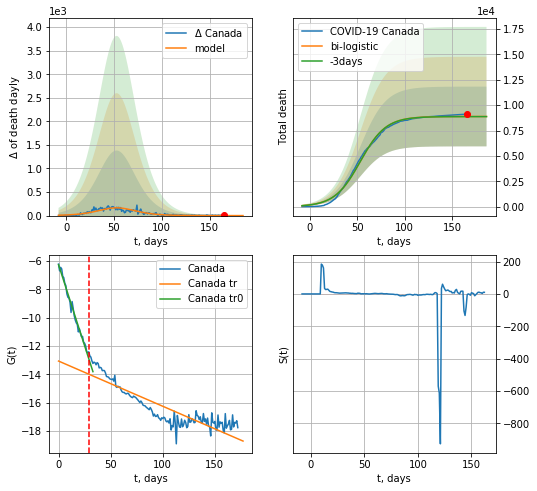

Canada data at: 2020-08-29
+3 day model MAPE: 0.001303011445178479
model: bi-logistic
coeffs:  [8.88342822e+03 7.42784316e-02 5.32335360e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.3313201792831893
forecast at the end of period: +21 days
	 deltaDaydeath:  0
	 total death:  8884 ± 2943
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.783568
 intercept: -13.062020
 slope: -0.031910


In [1795]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


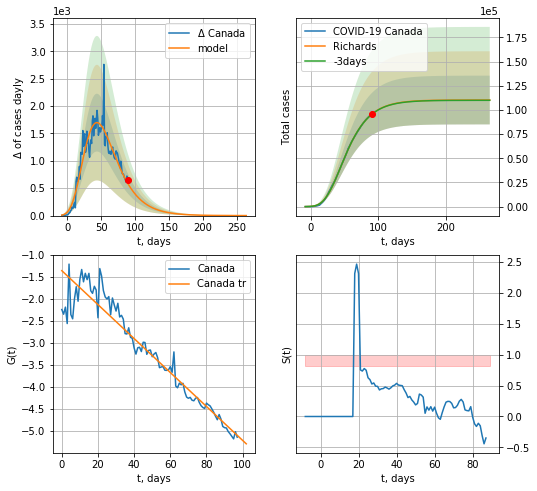

Canada data at: 2020-08-29
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207939e+05  3.57046378e+00 -6.12039169e+01  1.17938660e-02]
rational stdev: 0.228612
forecast at the end of period: +175 days
	 deltaDaycases: 0
	 total cases: 110197 ± 25192
	 total death: 7865 ± 5394
trend coefficient of determination: 0.921084
 intercept: -1.352092
 slope: -0.038614


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


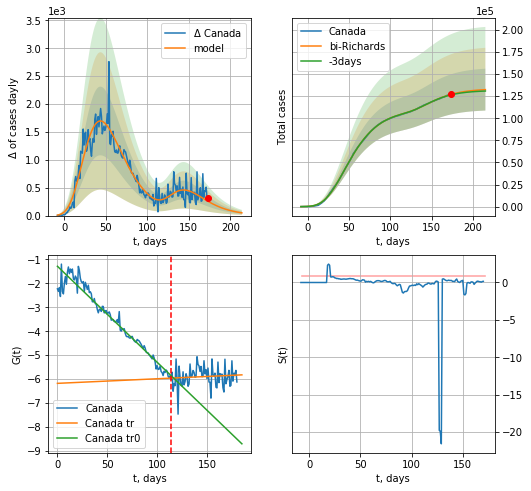

Canada data at: 2020-08-29
+3 day model MAPE: 0.004332
model: bi-Richards
coeffs: [2.32724055e+04 4.73579902e+00 4.79858168e+01 9.82251603e-03]
rational stdev: 0.178702
forecast at the end of period: +42 days
	 deltaDaycases: 49
	 total cases: 132417 ± 23663
	 total death: 9451 ± 5066
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.948109
 intercept: -1.285106
 slope: -0.040101
trend coefficient of determination: 0.007910
 intercept: -6.177341
 slope: 0.001918


In [1796]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,28*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


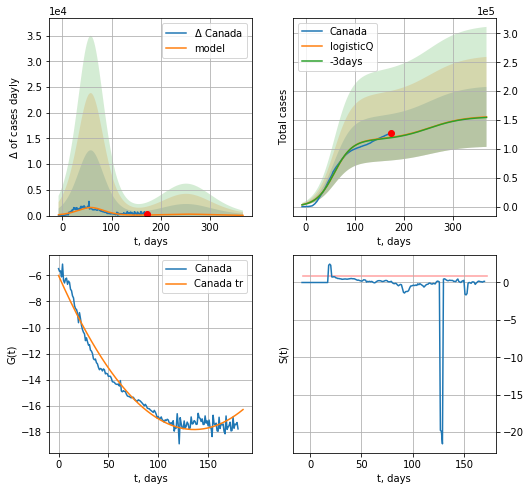

Canada data at: 2020-08-29
+3 day model MAPE: 0.006466
model: logisticQ
coeffs: [ 1.15965660e+05  8.40289506e-08  5.79345785e+01 -6.43857809e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334357
forecast at the end of period: +196 days
	 deltaDaycases: 43
	 total cases: 155383 ± 51953
	 total death: 11090 ± 11124
trend coefficient of determination: 0.973059
 intercept_: -6.0178886615736875
 coeffs_: [ 0.         -0.1734188   0.00063751]


In [1797]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
176 2020-08-25  55912   13086  1805.0
177 2020-08-26  56274   13283  1807.0
178 2020-08-27  56673   13507  1809.0
179 2020-08-28  57074   13703  1815.0
180 2020-08-29  57448   13864  1818.0


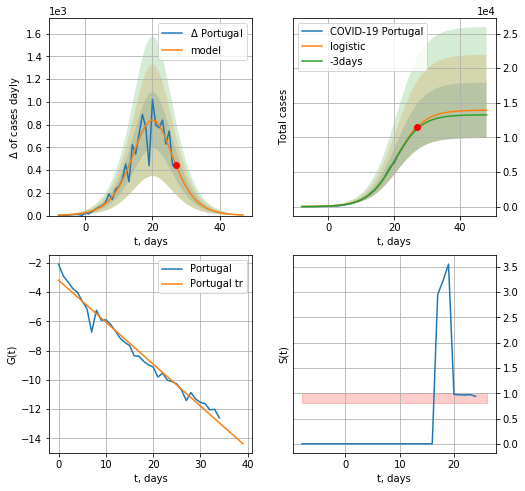

Portugal data at: 2020-08-29
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +21 days
	 deltaDaycases:  4
	 total cases:  13925 ± 4011
	 total death:  440 ± 380
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


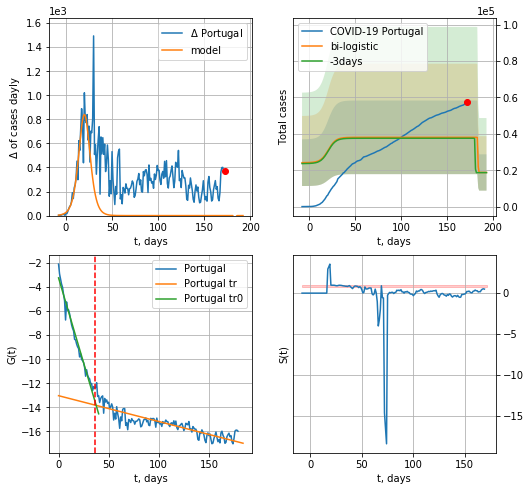

Portugal data at: 2020-08-29
+3 day model MAPE: 0.013341285511138416
model: bi-logistic
coeffs:  [ 1.93175722e+04 -7.21490228e+00  1.83772932e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.53127930375998
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  18772 ± 9973
	 total death:  594 ± 946
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.752862
 intercept: -13.036184
 slope: -0.021514


In [1798]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


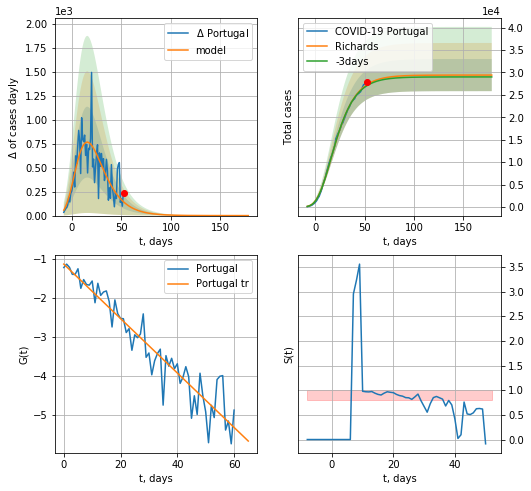

Portugal data at: 2020-08-29
+3 day model MAPE: 0.008857
model: Richards
coeffs: [ 2.94208673e+04  7.56194935e+00 -4.94130809e+01  9.41350515e-03]
rational stdev: 0.121788
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 29420 ± 3583
	 total death: 931 ± 340
trend coefficient of determination: 0.903152
 intercept: -1.140009
 slope: -0.069674


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


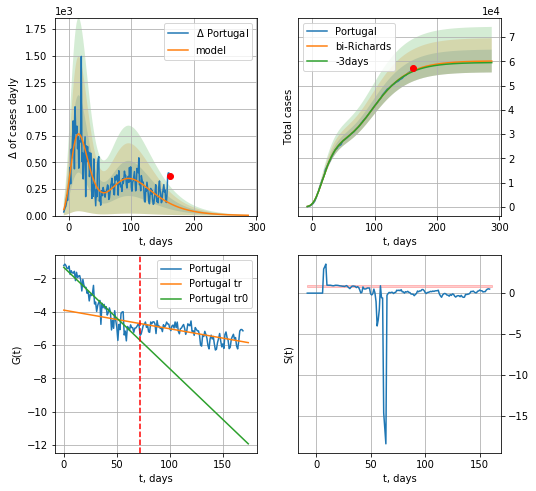

Portugal data at: 2020-08-29
+3 day model MAPE: 0.004919
model: bi-Richards
coeffs: [ 3.07855848e+04  2.98820364e+00 -5.35029563e+01  1.01605549e-02]
rational stdev: 0.078106
forecast at the end of period: +126 days
	 deltaDaycases: 2
	 total cases: 60111 ± 4695
	 total death: 1902 ± 445
bi-Richards approximation splitting point: 72
trend coefficient of determination: 0.889492
 intercept: -1.339635
 slope: -0.060814
trend coefficient of determination: 0.448676
 intercept: -3.904007
 slope: -0.011199


In [1799]:
iL = 10
vL=72+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


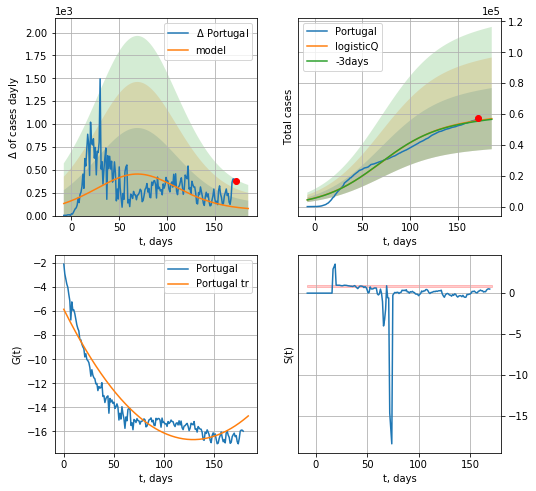

Portugal data at: 2020-08-29
+3 day model MAPE: 0.007537
model: logisticQ
coeffs: [ 5.56215872e+04  6.25356584e-08  6.89717905e+01 -5.13908433e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347516
forecast at the end of period: +14 days
	 deltaDaycases: 77
	 total cases: 57027 ± 19818
	 total death: 1804 ± 1880
trend coefficient of determination: 0.889120
 intercept_: -5.8413481497694875
 coeffs_: [ 0.         -0.16822263  0.00065195]


In [1800]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

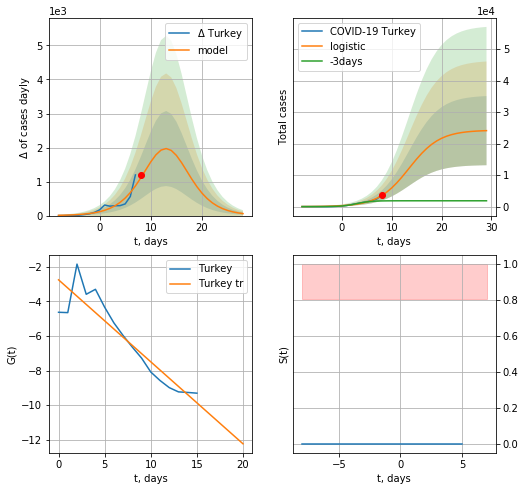

Turkey data at: 2020-08-29
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +21 days
	 deltaDaycases:  58
	 total cases:  24114 ± 10976
	 total death:  567 ± 774
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


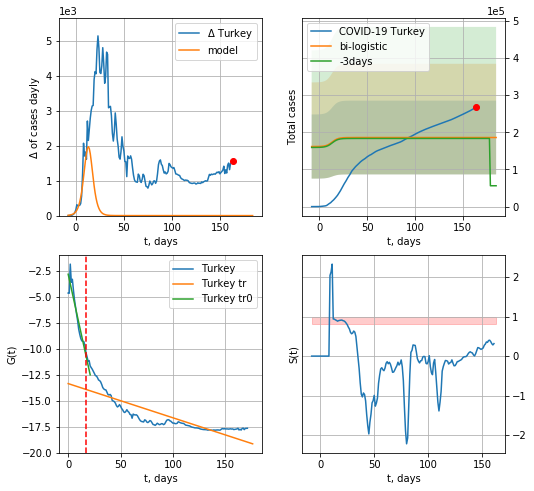

Turkey data at: 2020-08-29
+3 day model MAPE: 0.01347200981678005
model: bi-logistic
coeffs:  [ 1.29264387e+05 -2.06907860e+00  2.00141628e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5336472951920582
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  185847 ± 99177
	 total death:  4372 ± 6999
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.691205
 intercept: -13.343978
 slope: -0.032946


In [1801]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


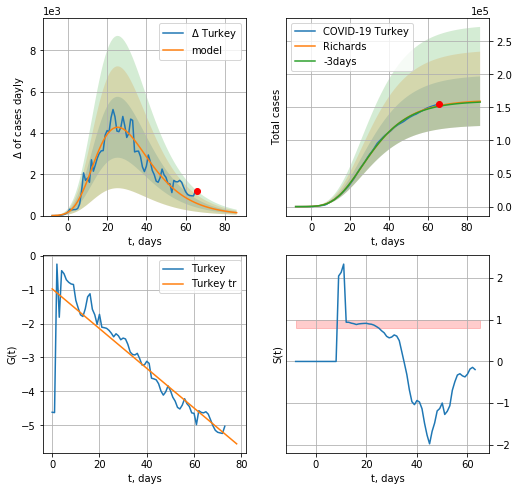

Turkey data at: 2020-08-29
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +21 days
	 deltaDaycases: 141
	 total cases: 159343 ± 37457
	 total death: 3749 ± 2643
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


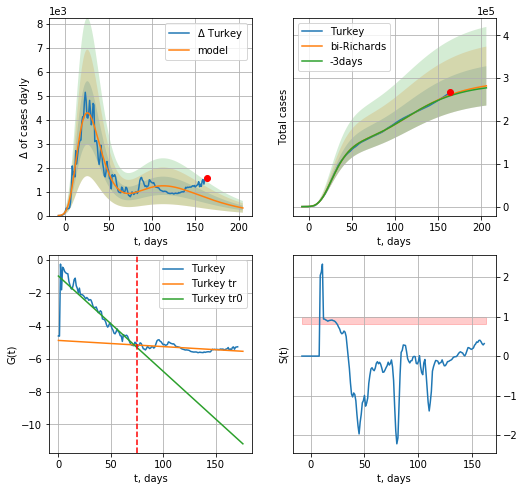

Turkey data at: 2020-08-29
+3 day model MAPE: 0.007671
model: bi-Richards
coeffs: [ 1.34058758e+05  2.51218752e+00 -7.00138882e+01  9.91349993e-03]
rational stdev: 0.162785
forecast at the end of period: +42 days
	 deltaDaycases: 317
	 total cases: 282017 ± 45908
	 total death: 6635 ± 3240
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.777560
 intercept: -0.969955
 slope: -0.057998
trend coefficient of determination: 0.285143
 intercept: -4.887616
 slope: -0.003754


In [1802]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [1803]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


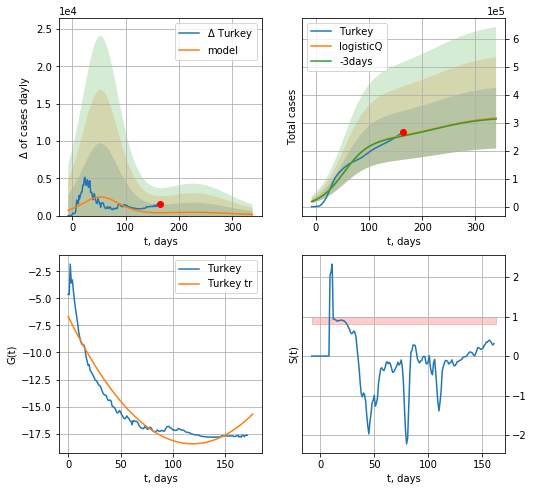

Turkey data at: 2020-08-29
+3 day model MAPE: 0.009991
model: logisticQ
coeffs: [ 2.39455106e+05  4.96361635e-08  5.27639823e+01 -8.27619895e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342839
forecast at the end of period: +175 days
	 deltaDaycases: 152
	 total cases: 316199 ± 108405
	 total death: 7440 ± 7652
trend coefficient of determination: 0.897884
 intercept_: -6.672325606084593
 coeffs_: [ 0.         -0.19826245  0.00083527]


In [1804]:
x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [1805]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.024407753050969132

In [1806]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
174 2020-08-25  63073.0   18312  1977.0
175 2020-08-26  63802.0   17711  1994.0
176 2020-08-27  64689.0   18582  2010.0
177 2020-08-28  65480.0   18677  2018.0
178 2020-08-29  66239.0   18645  2033.0


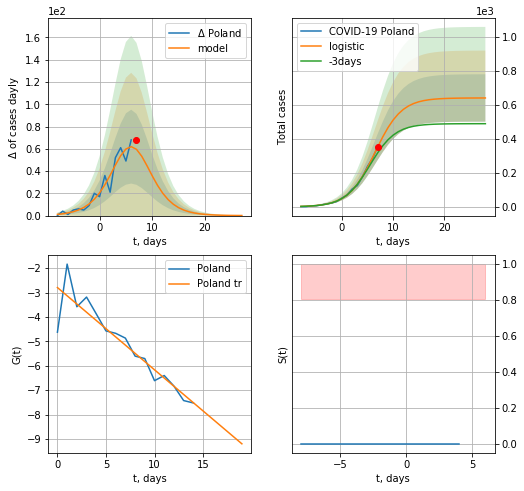

Poland data at: 2020-08-29
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  640 ± 139
	 total death:  19 ± 12
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


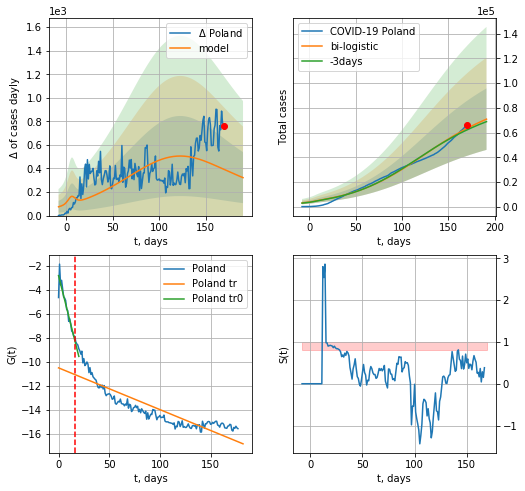

Poland data at: 2020-08-29
+3 day model MAPE: 0.020036187284492784
model: bi-logistic
coeffs:  [7.67233515e+04 2.51965541e-02 1.19612120e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3515069840369758
forecast at the end of period: +21 days
	 deltaDaycases:  322
	 total cases:  70857 ± 24907
	 total death:  2154 ± 2271
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.765451
 intercept: -10.494977
 slope: -0.034838


In [1809]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


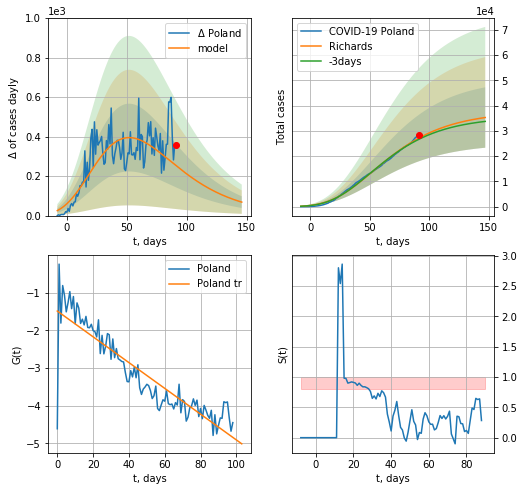

Poland data at: 2020-08-29
+3 day model MAPE: 0.018746
model: Richards
coeffs: [ 3.77002909e+04  3.30859191e+00 -1.13558446e+02  8.65036538e-03]
rational stdev: 0.339020
forecast at the end of period: +56 days
	 deltaDaycases: 68
	 total cases: 35267 ± 11956
	 total death: 1072 ± 1090
trend coefficient of determination: 0.798492
 intercept: -1.487027
 slope: -0.034259


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


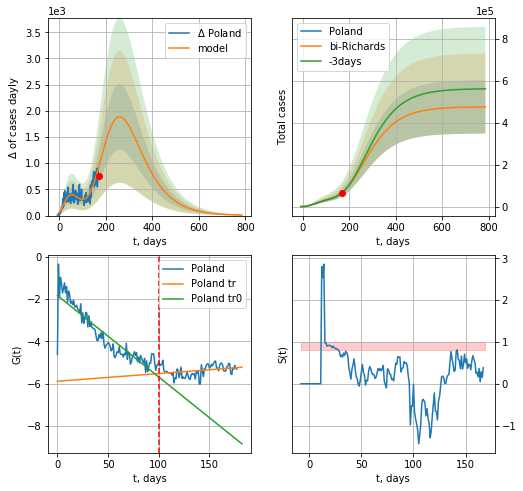

Poland data at: 2020-08-29
+3 day model MAPE: 0.006086
model: bi-Richards
coeffs: [4.38859422e+05 1.58933844e-01 4.70073291e+01 7.61815775e-02]
rational stdev: 0.267461
forecast at the end of period: +616 days
	 deltaDaycases: 9
	 total cases: 475811 ± 127261
	 total death: 14465 ± 11606
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.827022
 intercept: -1.832303
 slope: -0.038528
trend coefficient of determination: 0.093942
 intercept: -5.886135
 slope: 0.003623


In [1810]:
vL = 100
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,110*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


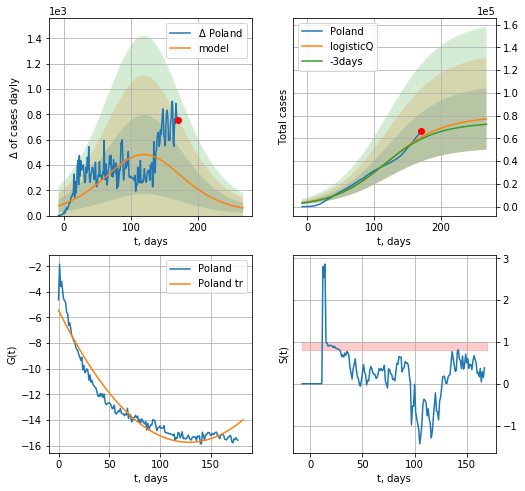

Poland data at: 2020-08-29
+3 day model MAPE: 0.027149
model: logisticQ
coeffs: [ 7.78058110e+04  8.85599476e-08  1.19326586e+02 -2.79042860e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350106
forecast at the end of period: +98 days
	 deltaDaycases: 60
	 total cases: 77036 ± 26970
	 total death: 2342 ± 2459
trend coefficient of determination: 0.935071
 intercept_: -5.442018478014408
 coeffs_: [ 0.         -0.15979341  0.00062009]


In [1811]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active  death
185 2020-08-25  107078.0   20336  859.0
186 2020-08-26  109039.0   21145  877.0
187 2020-08-27  110403.0   21793  884.0
188 2020-08-28  112000.0   20055  894.0
189 2020-08-29  113648.0   20151  909.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


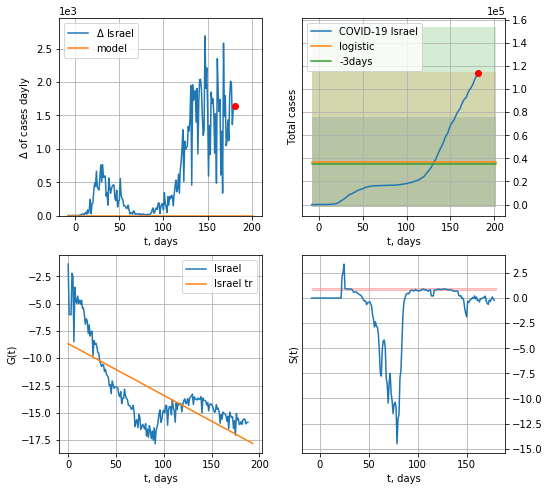

Israel data at: 2020-08-29
+3 day model MAPE: 0.046499923077418626
model: logistic
coeffs:  [ 2.97150636e+04 -1.27396281e+01  3.20331575e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0478160542073411
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  37143 ± 38919
	 total death:  297 ± 933
trend coefficient of determination: 0.533901
 intercept: -8.668650
 slope: -0.047303


In [1812]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


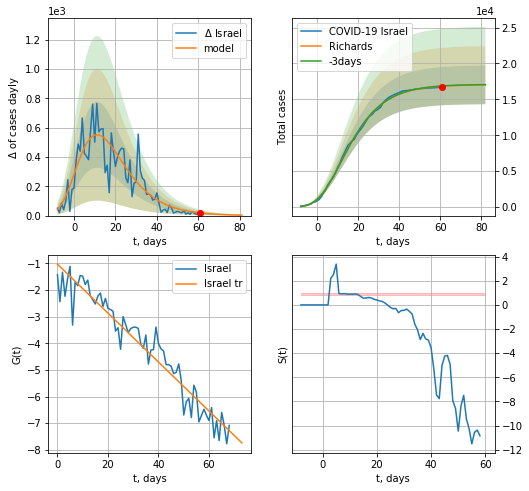

Israel data at: 2020-08-29
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 1.70515692e+04  6.43104023e+00 -3.67761649e+01  1.37703182e-02]
rational stdev: 0.158197
forecast at the end of period: +21 days
	 deltaDaycases: 3
	 total cases: 17018 ± 2692
	 total death: 136 ± 64
trend coefficient of determination: 0.925544
 intercept: -1.027515
 slope: -0.091953


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


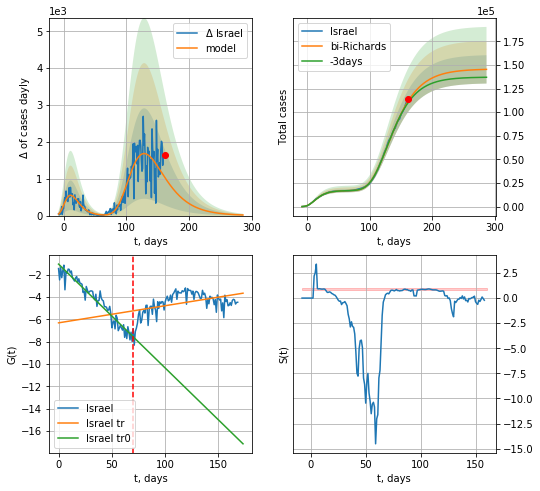

Israel data at: 2020-08-29
+3 day model MAPE: 0.014607
model: bi-Richards
coeffs: [1.28644786e+05 1.71686851e+00 2.12875748e+01 2.09299030e-02]
rational stdev: 0.103115
forecast at the end of period: +126 days
	 deltaDaycases: 15
	 total cases: 145258 ± 14978
	 total death: 1161 ± 359
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.929534
 intercept: -1.064143
 slope: -0.092959
trend coefficient of determination: 0.215704
 intercept: -6.319395
 slope: 0.015331


In [1813]:
x = forecastRR('Israel',dfIS[20:90],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


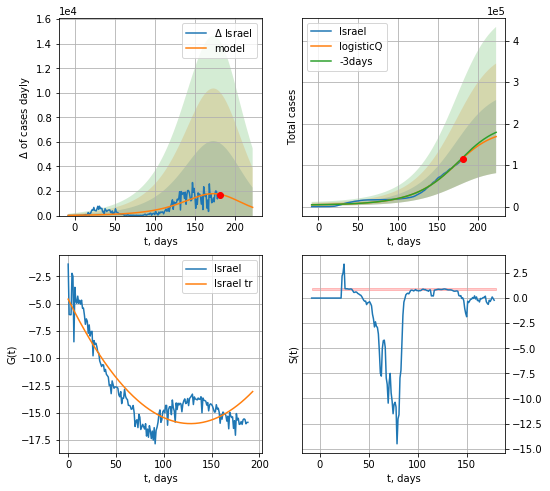

Israel data at: 2020-08-29
+3 day model MAPE: 0.016141
model: logisticQ
coeffs: [ 1.82902251e+05  9.88100961e-05  1.66991661e+02 -2.21734201e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.522215
forecast at the end of period: +42 days
	 deltaDaycases: 669
	 total cases: 168707 ± 88101
	 total death: 1349 ± 2113
trend coefficient of determination: 0.808451
 intercept_: -4.595742687249077
 coeffs_: [ 0.         -0.17798496  0.00069512]


In [1814]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


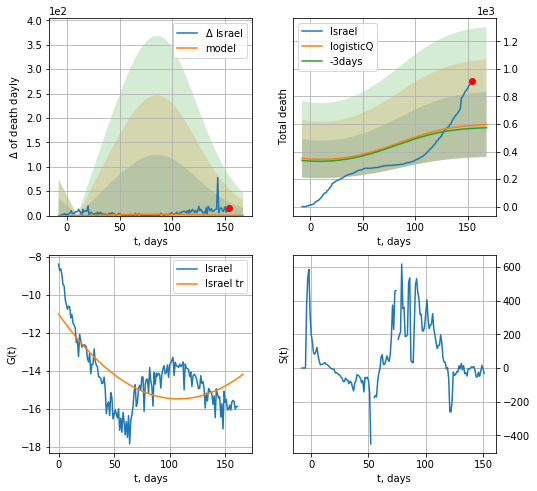

Israel data at: 2020-08-29
+3 day model MAPE: 0.039087
model: logisticQ
coeffs: [5.09261723e+02 1.83394556e-04 1.75253644e+01 2.35252643e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395288
forecast at the end of period: +14 days
	 total death: 596 ± 235
trend coefficient of determination: 0.465725
 intercept_: -11.015099587124705
 coeffs_: [ 0.         -0.08271362  0.00038344]


In [1815]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date    cases  active   death
182 2020-08-25  40262.0    3460  2002.0
183 2020-08-26  40645.0    3842  2003.0
184 2020-08-27  41006.0    4203  2003.0
185 2020-08-28  41346.0    4542  2004.0
186 2020-08-29  41722.0    4517  2005.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


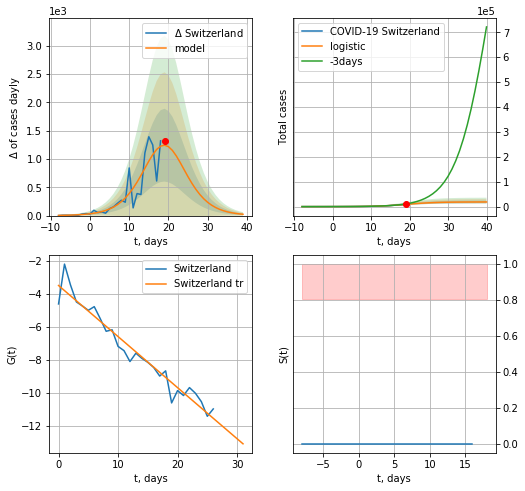

Switzerland data at: 2020-08-29
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +21 days
	 deltaDaycases:  23
	 total cases:  18629 ± 5701
	 total death:  895 ± 821
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


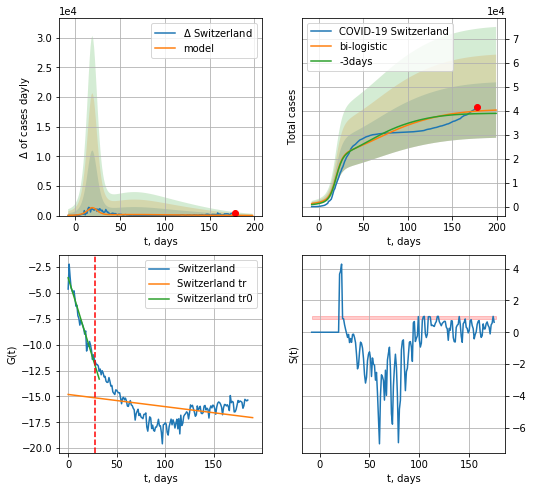

Switzerland data at: 2020-08-29
+3 day model MAPE: 0.028597790575565392
model: bi-logistic
coeffs:  [1.75295732e+04 3.67121876e-02 6.23926412e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.28722237803465606
forecast at the end of period: +21 days
	 deltaDaycases:  13
	 total cases:  40232 ± 11555
	 total death:  1933 ± 1665
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.126075
 intercept: -14.806777
 slope: -0.011792


In [1816]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


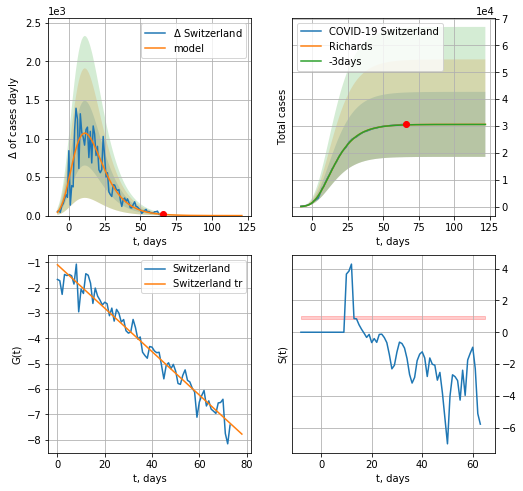

Switzerland data at: 2020-08-29
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 30630 ± 12088
	 total death: 1471 ± 1741
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


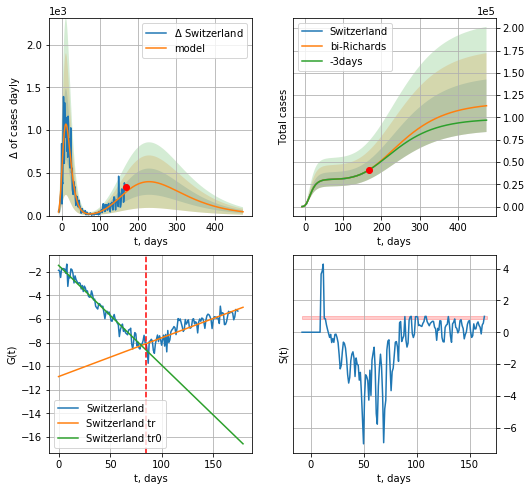

Switzerland data at: 2020-08-29
+3 day model MAPE: 0.002956
model: bi-Richards
coeffs: [ 8.60277208e+04  2.57583023e-01 -4.29159956e+00  4.99037774e-02]
rational stdev: 0.260425
forecast at the end of period: +308 days
	 deltaDaycases: 45
	 total cases: 113100 ± 29454
	 total death: 5435 ± 4246
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.964118
 intercept: -1.458348
 slope: -0.084461
trend coefficient of determination: 0.737763
 intercept: -10.880421
 slope: 0.032795


In [1817]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:-1],d1,7*66-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


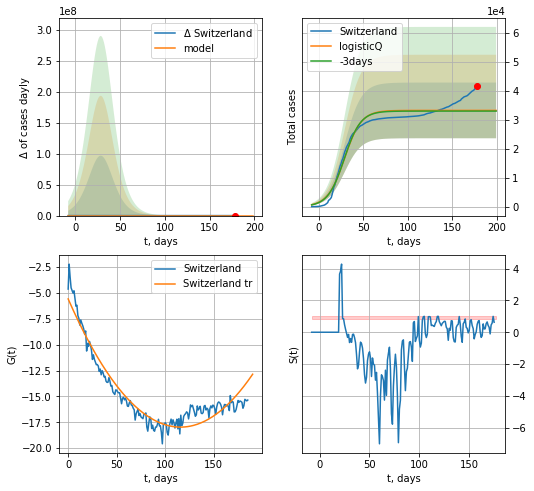

Switzerland data at: 2020-08-29
+3 day model MAPE: 0.007121
model: logisticQ
coeffs: [ 3.32503369e+04  1.35578089e-07  2.88228770e+01 -7.85686328e+05]
rational stdev: 0.289278
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 33250 ± 9618
	 total death: 1597 ± 1385
trend coefficient of determination: 0.921827
 intercept_: -5.578891534579615
 coeffs_: [ 0.         -0.21411595  0.00092543]


In [1819]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [1820]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
168 2020-08-25  108415.0   54313  2318.0
169 2020-08-26  110085.0   55439  2403.0
170 2020-08-27  112059.0   56963  2451.0
171 2020-08-28  114497.0   58348  2492.0
172 2020-08-29  116978.0   59813  2527.0


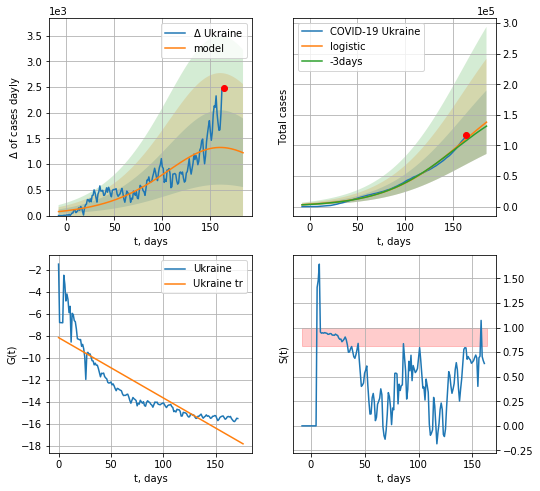

Ukraine data at: 2020-08-29
+3 day model MAPE: 0.02599917348223076
model: logistic
coeffs:  [2.07731710e+05 2.50723220e-02 1.59318951e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37626639124414035
forecast at the end of period: +21 days
	 deltaDaycases:  1222
	 total cases:  137954 ± 51907
	 total death:  2927 ± 3303
trend coefficient of determination: 0.754130
 intercept: -8.176268
 slope: -0.054784


In [1822]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


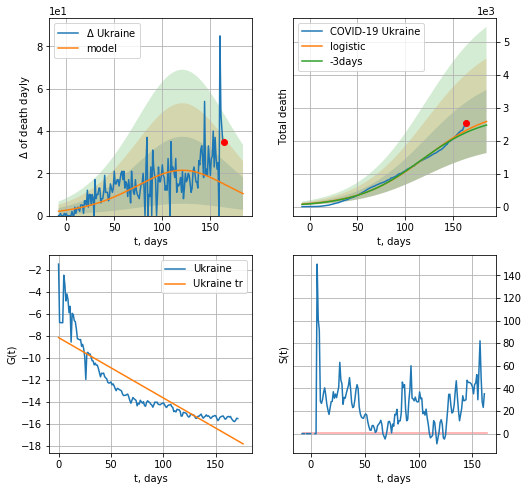

Ukraine data at: 2020-08-29
+3 day model MAPE: 0.028799662814250563
model: logistic
coeffs:  [3.00188299e+03 2.85674699e-02 1.21309663e+02]
rational stdev:  0.3706486072866191
forecast at the end of period: +21 days
	 total death:  2583 ± 957
trend coefficient of determination: 0.754130
 intercept: -8.176268
 slope: -0.054784


In [1823]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


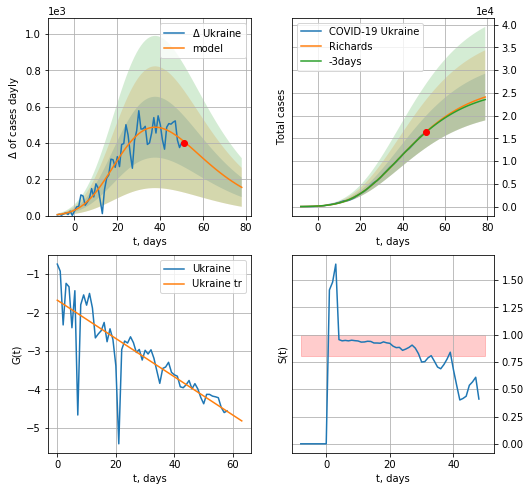

Ukraine data at: 2020-08-29
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +28 days
	 deltaDaycases: 155
	 total cases: 24091 ± 5138
	 total death: 511 ± 326
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


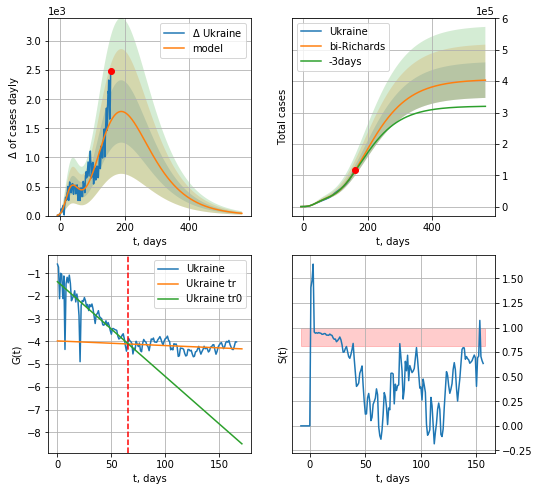

Ukraine data at: 2020-08-29
+3 day model MAPE: 0.019137
model: bi-Richards
coeffs: [ 3.78963944e+05  8.98664934e-01 -1.37719752e+02  1.43842404e-02]
rational stdev: 0.140393
forecast at the end of period: +406 days
	 deltaDaycases: 38
	 total cases: 403301 ± 56620
	 total death: 8558 ± 3604
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.665296
 intercept: -1.370482
 slope: -0.041710
trend coefficient of determination: 0.074040
 intercept: -3.976856
 slope: -0.002036


In [1824]:
vL = 70#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*26-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*80-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


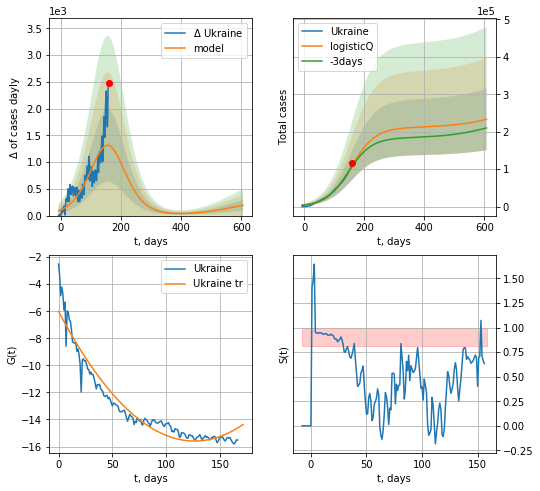

Ukraine data at: 2020-08-29
+3 day model MAPE: 0.027821
model: logisticQ
coeffs: [ 2.11114645e+05  2.72932603e-07  1.55545238e+02 -9.10665099e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353294
forecast at the end of period: +448 days
	 deltaDaycases: 192
	 total cases: 232914 ± 82287
	 total death: 4942 ± 5237
trend coefficient of determination: 0.932626
 intercept_: -6.0062424632082365
 coeffs_: [ 0.         -0.15211879  0.0006034 ]


In [1825]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [1826]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

IN
           date   cases  active    death
188 2020-08-25  363363   29404  20901.0
189 2020-08-26  365606   29716  21020.0
190 2020-08-27  367796   30021  21137.0
191 2020-08-28  369911   30392  21249.0
192 2020-08-29  371816   30610  21359.0


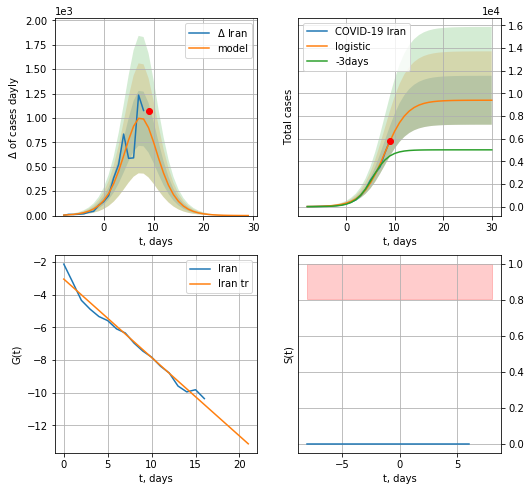

Iran data at: 2020-08-29
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  9384 ± 2156
	 total death:  539 ± 371
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


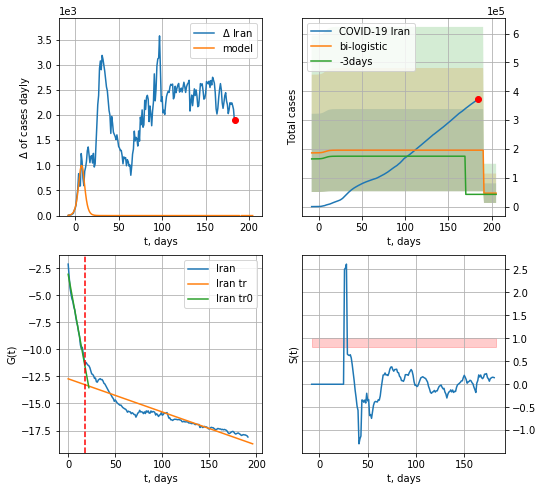

Iran data at: 2020-08-29
+3 day model MAPE: 3.60777890766532
model: bi-logistic
coeffs:  [ 1.48999663e+05 -5.81908366e+01  1.90484199e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7281428750070962
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  46635 ± 33957
	 total death:  2678 ± 5849
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.844482
 intercept: -12.720844
 slope: -0.030659


In [1827]:
dfIN = read_df(pd.DataFrame(),"IN")
x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


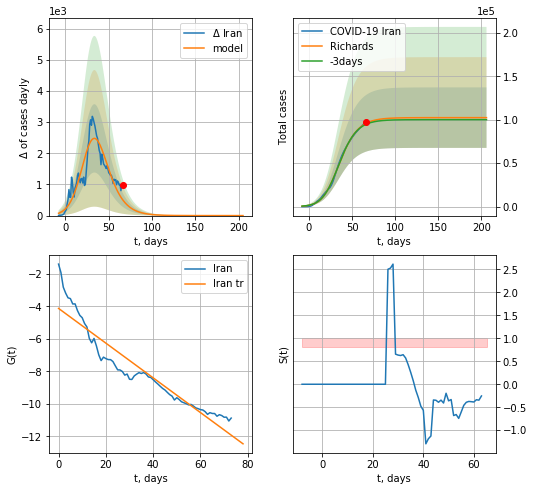

Iran data at: 2020-08-29
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478152e+05 1.52216307e-01 2.65523943e+01 5.45962781e-01]
rational stdev: 0.339941
forecast at the end of period: +140 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 5886 ± 6002
trend coefficient of determination: 0.893485
 intercept: -4.118018
 slope: -0.106957


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


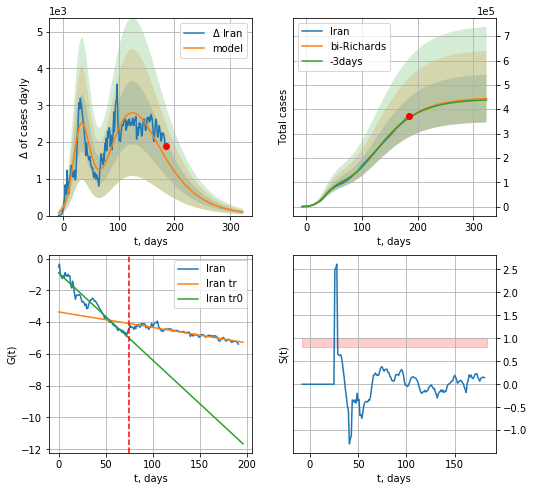

Iran data at: 2020-08-29
+3 day model MAPE: 0.004926
model: bi-Richards
coeffs: [ 3.45723947e+05  2.48280162e+00 -8.88077939e+01  8.88250358e-03]
rational stdev: 0.220823
forecast at the end of period: +140 days
	 deltaDaycases: 95
	 total cases: 443899 ± 98023
	 total death: 25499 ± 16892
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949233
 intercept: -0.899123
 slope: -0.054896
trend coefficient of determination: 0.880077
 intercept: -3.360480
 slope: -0.009728


In [1828]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


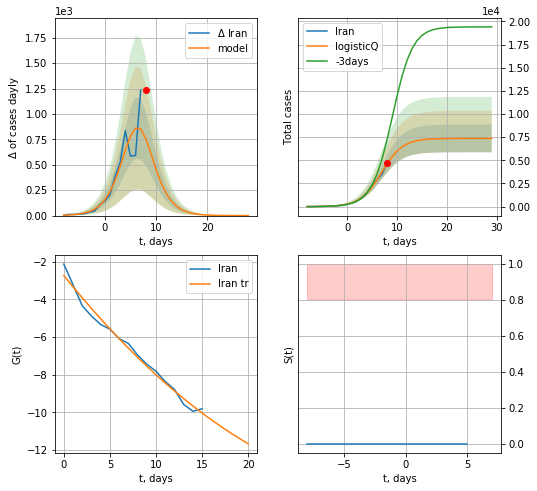

Iran data at: 2020-08-29
+3 day model MAPE: 0.437962
model: logisticQ
coeffs: [ 7.36885077e+03  7.42724103e-05 -6.37161781e+03  6.90116795e+00]
rational stdev: 0.203007
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 423 ± 257
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


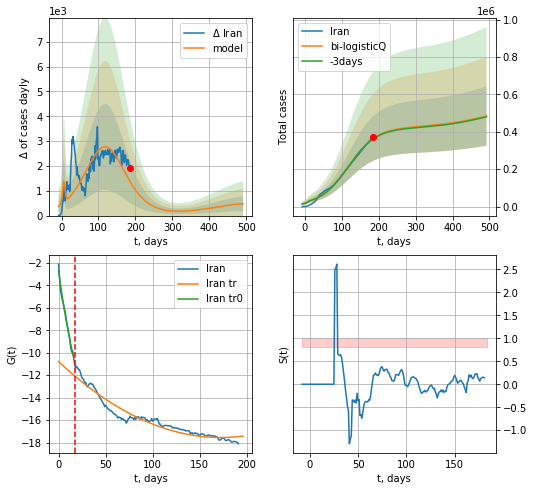

Iran data at: 2020-08-29
+3 day model MAPE: 0.006452
model: bi-logisticQ
coeffs: [ 4.14811168e+05  1.15835713e-07  1.18235785e+02 -2.29552652e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327813
forecast at the end of period: +308 days
	 deltaDaycases: 479
	 total cases: 484238 ± 158739
	 total death: 27817 ± 27356
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.933586
 intercept_: -10.786221340597963
 coeffs_: [ 0.         -0.07830941  0.00022696]


In [1829]:
x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
178 2020-08-25  966189.0  168032  16683.0
179 2020-08-26  970865.0  166211  16804.0
180 2020-08-27  975576.0  165025  16914.0
181 2020-08-28  980405.0  163938  17025.0
182 2020-08-29  985346.0  166251  17093.0


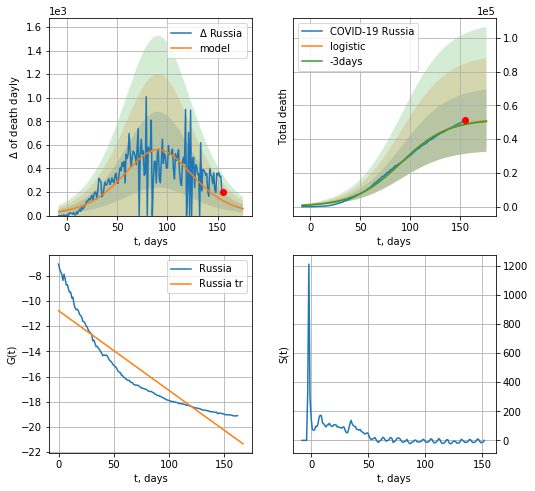

Russia data at: 2020-08-29
+3 day model MAPE: 0.008760898869657632
model: logistic
coeffs:  [5.24432335e+04 4.26495021e-02 9.11288403e+01]
rational stdev:  0.36254826124538914
forecast at the end of period: +21 days
	 total death:  51074 ± 18517
trend coefficient of determination: 0.846533
 intercept: -10.774463
 slope: -0.063228


In [1832]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


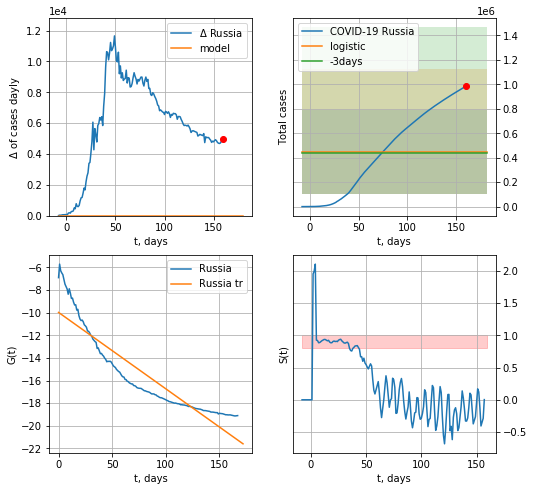

Russia data at: 2020-08-29
+3 day model MAPE: 0.02213367222374074
model: logistic
coeffs:  [ 4.46018680e+05 -1.16914523e+01  2.92384525e+02]
rational stdev:  0.7653294008990558
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  446018 ± 341351
	 total death:  7698 ± 17674
trend coefficient of determination: 0.841363
 intercept: -9.973893
 slope: -0.067539


In [1833]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


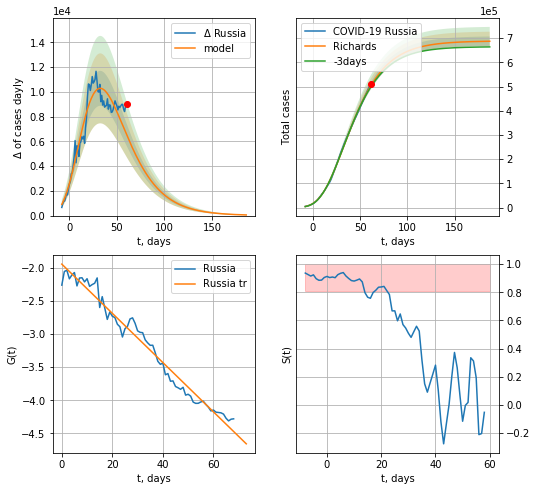

Russia data at: 2020-08-29
+3 day model MAPE: 0.010822
model: Richards
coeffs: [ 6.88418485e+05  2.24771706e+00 -6.48448453e+01  1.82243445e-02]
rational stdev: 0.028811
forecast at the end of period: +126 days
	 deltaDaycases: 52
	 total cases: 687169 ± 19798
	 total death: 11860 ± 1025
trend coefficient of determination: 0.974032
 intercept: -1.941717
 slope: -0.037219


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


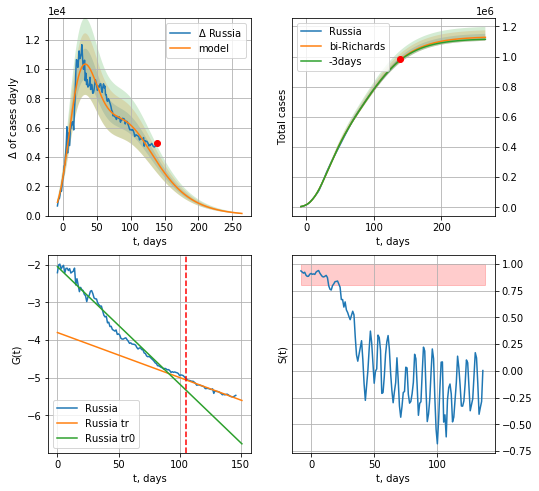

Russia data at: 2020-08-29
+3 day model MAPE: 0.002920
model: bi-Richards
coeffs: [ 4.44088757e+05  2.28562495e+00 -4.99984695e+01  1.23214646e-02]
rational stdev: 0.020430
forecast at the end of period: +126 days
	 deltaDaycases: 144
	 total cases: 1127425 ± 23033
	 total death: 19459 ± 1192
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.971855
 intercept: -2.048259
 slope: -0.031150
trend coefficient of determination: 0.967375
 intercept: -3.797788
 slope: -0.011941


In [1834]:
vL = 105 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


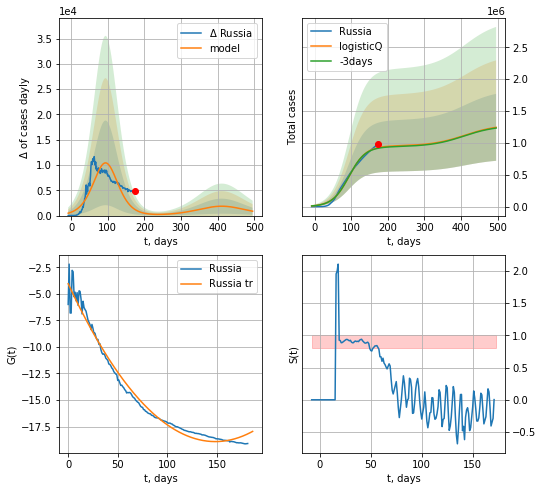

Russia data at: 2020-08-29
+3 day model MAPE: 0.010010
model: logisticQ
coeffs: [ 9.51558049e+05  1.02738604e-07  9.43142862e+01 -4.26157192e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422180
forecast at the end of period: +322 days
	 deltaDaycases: 865
	 total cases: 1243597 ± 525021
	 total death: 21464 ± 27184
trend coefficient of determination: 0.981486
 intercept_: -4.057519911695458
 coeffs_: [ 0.         -0.2003814   0.00067564]


In [1835]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active   death
216 2020-08-25  63121.0   11494  1196.0
217 2020-08-26  63822.0   10925  1209.0
218 2020-08-27  64668.0   10619  1226.0
219 2020-08-28  65573.0   10340  1238.0
220 2020-08-29  66423.0    9827  1255.0


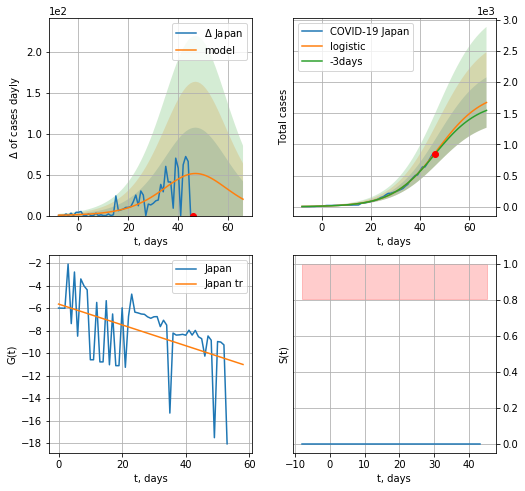

Japan data at: 2020-08-29
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +21 days
	 deltaDaycases:  19
	 total cases:  1672 ± 404
	 total death:  31 ± 22
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


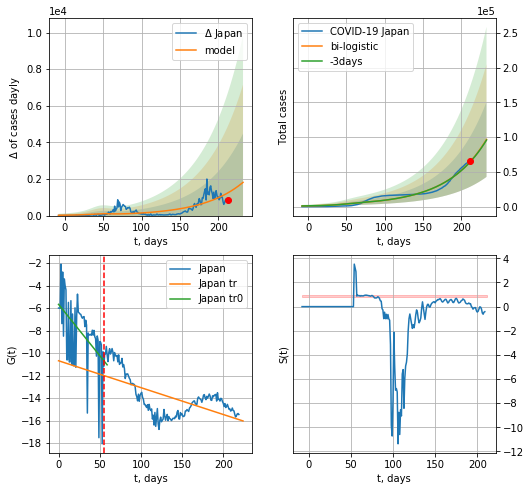

Japan data at: 2020-08-29
+3 day model MAPE: 0.007018311989803828
model: bi-logistic
coeffs:  [2.07392024e+08 1.93019545e-02 6.31319079e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5578637264533808
forecast at the end of period: +21 days
	 deltaDaycases:  1814
	 total cases:  96837 ± 54022
	 total death:  1829 ± 3060
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.386295
 intercept: -10.685900
 slope: -0.023885


In [1836]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

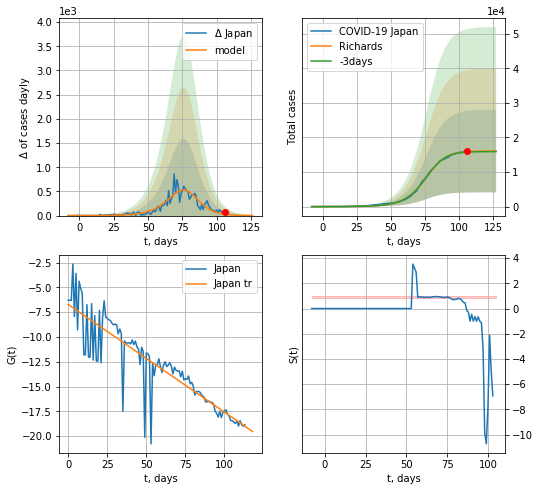

Japan data at: 2020-08-29
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043525e+04 1.05070375e-01 7.85362635e+01 1.40112814e+00]
rational stdev: 0.743333
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 16095 ± 11964
	 total death: 304 ± 677
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


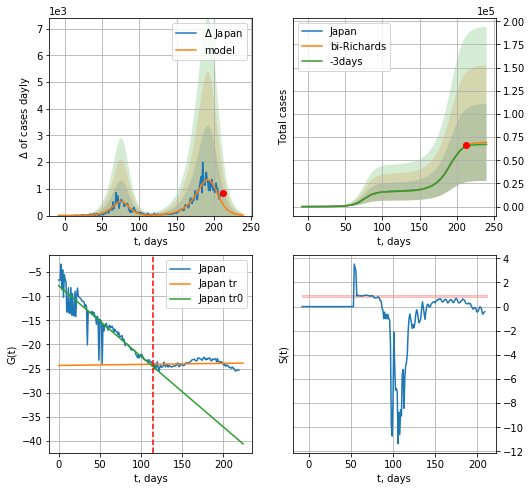

Japan data at: 2020-08-29
+3 day model MAPE: 0.016510
model: bi-Richards
coeffs: [5.32749714e+04 6.77758684e-02 1.97443935e+02 1.89122219e+00]
rational stdev: 0.599799
forecast at the end of period: +28 days
	 deltaDaycases: 16
	 total cases: 69259 ± 41541
	 total death: 1308 ± 2353
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.865446
 intercept: -7.800924
 slope: -0.146530
trend coefficient of determination: 0.007587
 intercept: -24.357324
 slope: 0.002170


In [1837]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


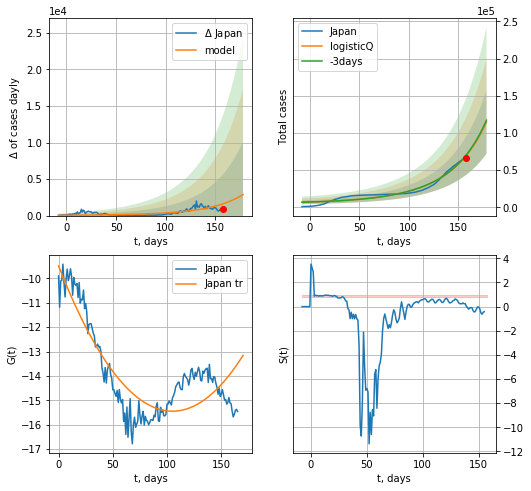

Japan data at: 2020-08-29
+3 day model MAPE: 0.011982
model: logisticQ
coeffs: [ 4.47267501e+07  5.53944407e-05  3.49506787e+02 -4.52482072e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372157
forecast at the end of period: +21 days
	 deltaDaycases: 2875
	 total cases: 114587 ± 42644
	 total death: 2165 ± 2417
trend coefficient of determination: 0.756963
 intercept_: -9.484760157485105
 coeffs_: [ 0.         -0.11364711  0.00054128]


In [1839]:
x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
180 2020-08-25  67543.0       0  6207.0
181 2020-08-26  68114.0       0  6215.0
182 2020-08-27  68624.0       0  6218.0
183 2020-08-28  69131.0       0  6220.0
184 2020-08-29  69632.0       0  6224.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


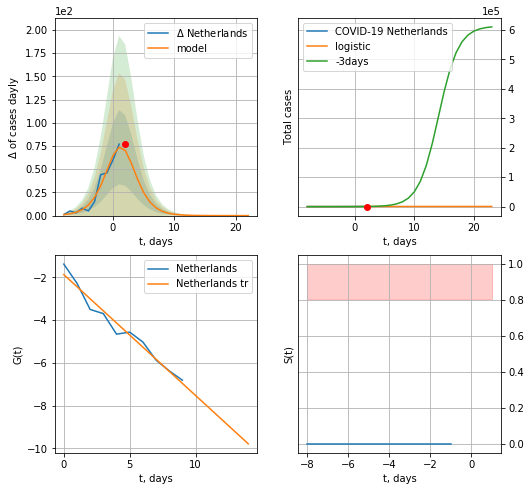

Netherlands data at: 2020-08-29
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  43 ± 30
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


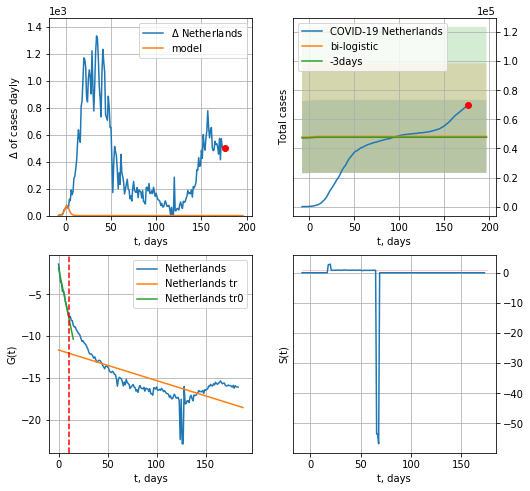

Netherlands data at: 2020-08-29
+3 day model MAPE: 0.01313255879668049
model: bi-logistic
coeffs:  [ 3.82529794e+04 -7.15204361e+00  2.01283966e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5195900382997976
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  48303 ± 25098
	 total death:  4317 ± 6729
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.502972
 intercept: -11.651182
 slope: -0.036553


In [1840]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


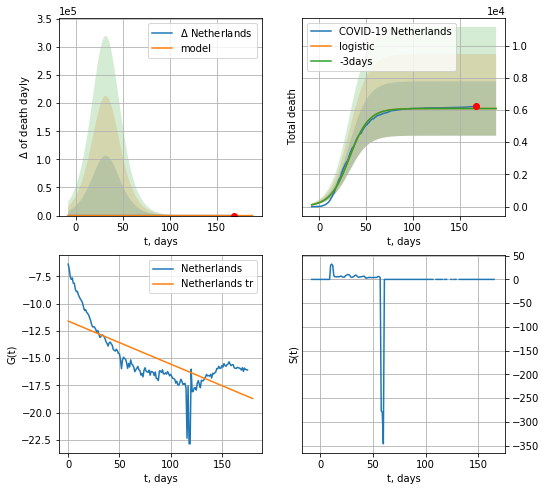

Netherlands data at: 2020-08-29
+3 day model MAPE: 0.0006802021397528837
model: logistic
coeffs:  [6.09240824e+03 9.79740515e-02 3.24016231e+01]
rational stdev:  0.27704768265632335
forecast at the end of period: +21 days
	 total death:  6092 ± 1687
trend coefficient of determination: 0.524003
 intercept: -11.603158
 slope: -0.039455


In [1841]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


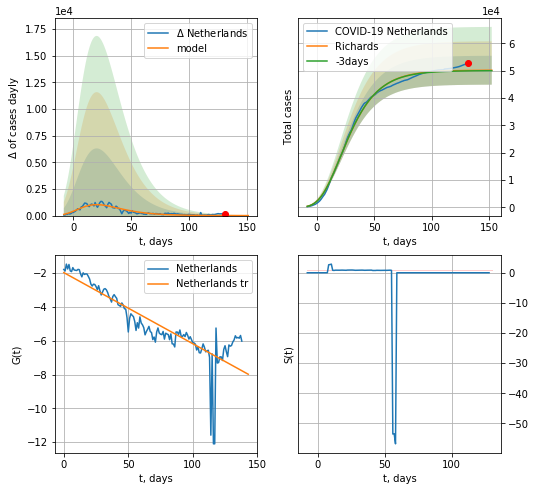

Netherlands data at: 2020-08-29
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 50208 ± 5287
	 total death: 4487 ± 1417
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


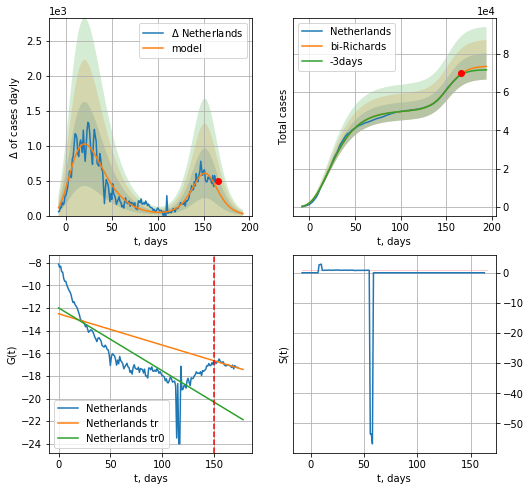

Netherlands data at: 2020-08-29
+3 day model MAPE: 0.007660
model: bi-Richards
coeffs: [2.33019701e+04 9.70217443e-02 1.52771830e+02 1.10567129e+00]
rational stdev: 0.093630
forecast at the end of period: +28 days
	 deltaDaycases: 28
	 total cases: 73290 ± 6862
	 total death: 6550 ± 1839
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.674128
 intercept: -11.994215
 slope: -0.055475
trend coefficient of determination: 0.728247
 intercept: -12.513353
 slope: -0.027651


In [1842]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1843]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


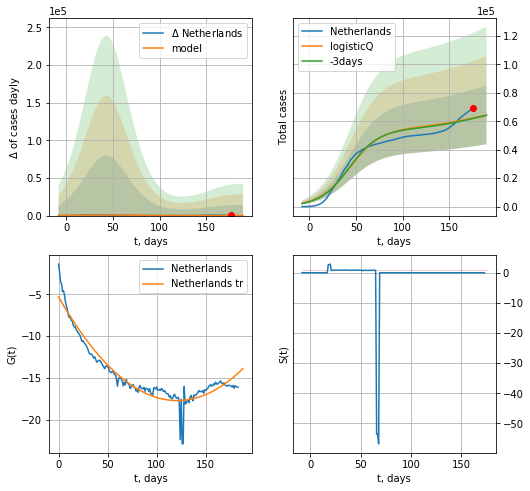

Netherlands data at: 2020-08-29
+3 day model MAPE: 0.006576
model: logisticQ
coeffs: [ 5.46130721e+04  4.27988983e-08  4.32680391e+01 -1.41449733e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319937
forecast at the end of period: +14 days
	 deltaDaycases: 147
	 total cases: 64484 ± 20630
	 total death: 5763 ± 5531
trend coefficient of determination: 0.915779
 intercept_: -5.31379464639957
 coeffs_: [ 0.         -0.20483617  0.00084754]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


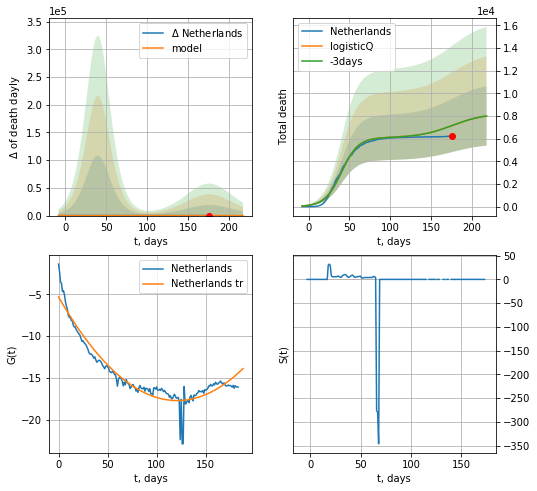

Netherlands data at: 2020-08-29
+3 day model MAPE: 0.000309
model: logisticQ
coeffs: [ 6.09168618e+03  3.12390225e-07  4.04028933e+01 -3.14310239e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327344
forecast at the end of period: +42 days
	 total death: 8007 ± 2621
trend coefficient of determination: 0.915779
 intercept_: -5.31379464639957
 coeffs_: [ 0.         -0.20483617  0.00084754]


In [1844]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1845]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
181 2020-08-25  25706.0    3085  733.0
182 2020-08-26  26361.0    3311  733.0
183 2020-08-27  26590.0    3263  733.0
184 2020-08-28  26985.0    3386  733.0
185 2020-08-29  27166.0    3363  733.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


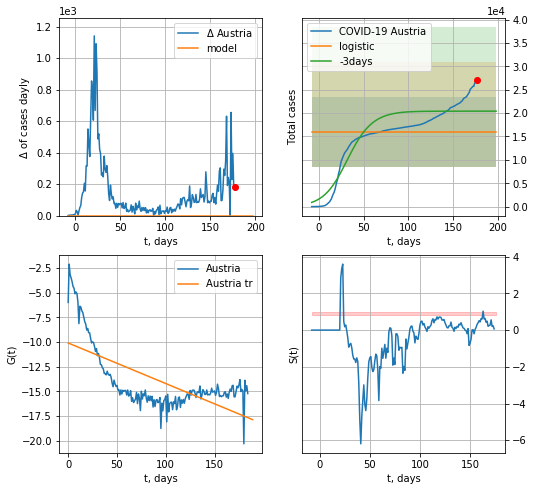

Austria data at: 2020-08-29
+3 day model MAPE: 0.2169485707539633
model: logistic
coeffs:  [ 1.50443387e+04 -9.32720391e-01  2.54185481e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.46794951100529203
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  15984 ± 7479
	 total death:  431 ± 605
trend coefficient of determination: 0.442242
 intercept: -10.104686
 slope: -0.041056


In [1846]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


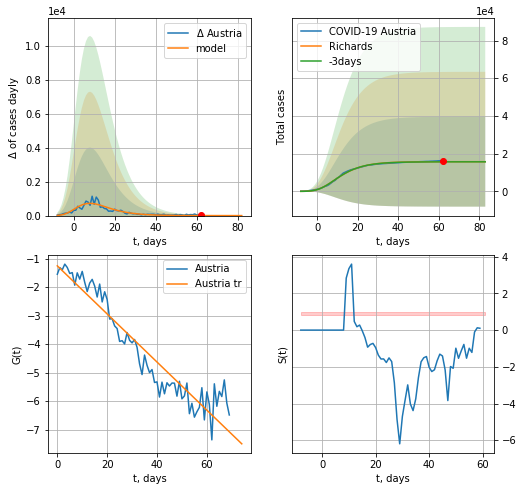

Austria data at: 2020-08-29
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373348e+04  1.44322302e+01 -2.95282735e+01  8.67503130e-03]
rational stdev: 1.514093
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 15735 ± 23825
	 total death: 424 ± 1925
trend coefficient of determination: 0.902786
 intercept: -1.255535
 slope: -0.084343


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


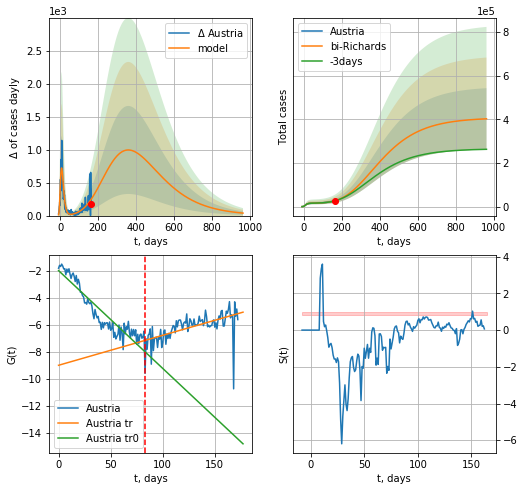

Austria data at: 2020-08-29
+3 day model MAPE: 0.010765
model: bi-Richards
coeffs: [ 3.91680106e+05  1.21412662e-01 -3.98072732e+01  5.85795607e-02]
rational stdev: 0.348851
forecast at the end of period: +798 days
	 deltaDaycases: 37
	 total cases: 402114 ± 140278
	 total death: 10849 ± 11354
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.867414
 intercept: -1.969142
 slope: -0.072675
trend coefficient of determination: 0.337015
 intercept: -9.001144
 slope: 0.022280


In [1847]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,136*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


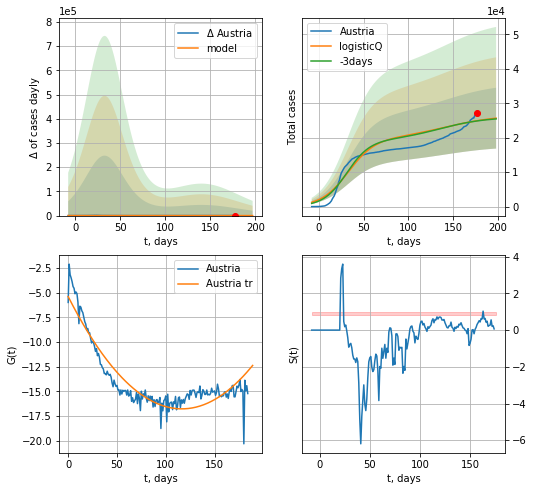

Austria data at: 2020-08-29
+3 day model MAPE: 0.002995
model: logisticQ
coeffs: [ 1.96557528e+04  2.45899086e-08  3.26727508e+01 -2.72441962e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343818
forecast at the end of period: +21 days
	 deltaDaycases: 27
	 total cases: 25690 ± 8832
	 total death: 693 ± 714
trend coefficient of determination: 0.861262
 intercept_: -5.409376002271705
 coeffs_: [ 0.         -0.19500153  0.00083666]


In [1848]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
177 2020-08-25  82447.0   54160  9996.0
178 2020-08-26  83030.0   54820  9879.0
179 2020-08-27  83500.0   55256  9884.0
180 2020-08-28  83952.0   55706  9886.0
181 2020-08-29  84599.0   56305  9891.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


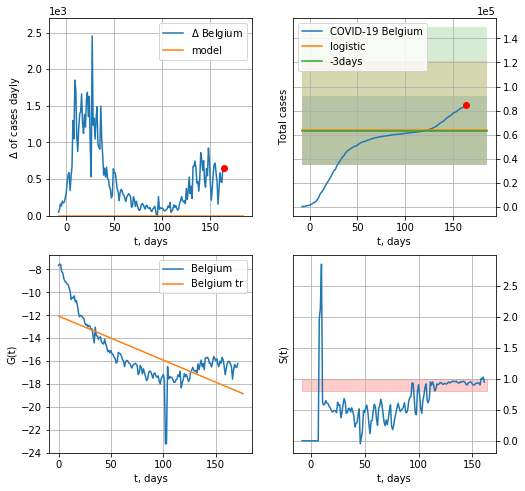

Belgium data at: 2020-08-29
+3 day model MAPE: 0.011662565376305415
model: logistic
coeffs:  [ 5.08189879e+04 -1.02891950e+01  3.13243316e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.4511030763916385
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  63523 ± 28655
	 total death:  7426 ± 10049
trend coefficient of determination: 0.514684
 intercept: -12.072513
 slope: -0.038481


In [1849]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

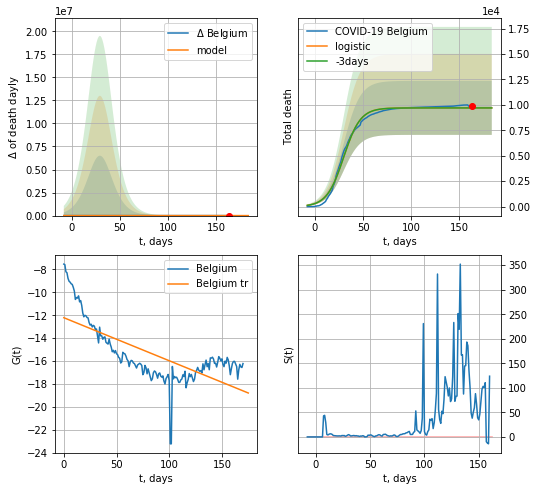

Belgium data at: 2020-08-29
+3 day model MAPE: 0.0005826124453904388
model: logistic
coeffs:  [9.70840509e+03 1.14719930e-01 2.98335156e+01]
rational stdev:  0.27325106264840565
forecast at the end of period: +21 days
	 total death:  9708 ± 2652
trend coefficient of determination: 0.506912
 intercept: -12.214476
 slope: -0.037568


In [1850]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


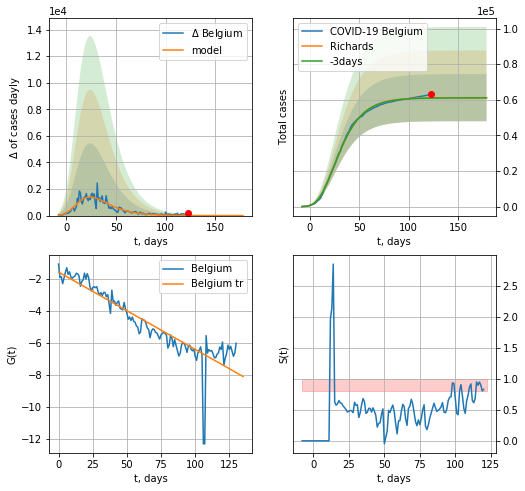

Belgium data at: 2020-08-29
+3 day model MAPE: 0.002325
model: Richards
coeffs: [ 6.11994198e+04  7.57384886e+00 -5.28924887e+01  8.21594131e-03]
rational stdev: 0.216332
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 61195 ± 13238
	 total death: 7154 ± 4642
trend coefficient of determination: 0.812352
 intercept: -1.573316
 slope: -0.048332


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


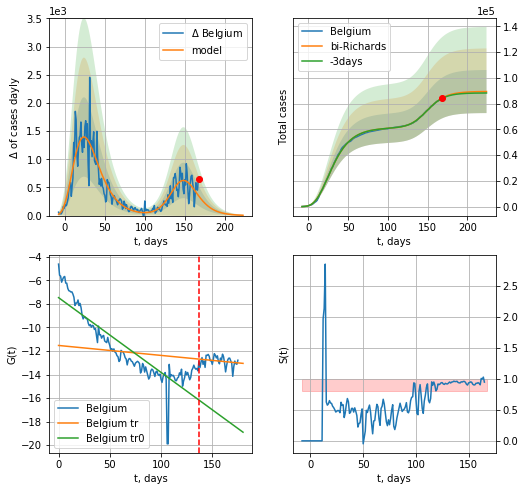

Belgium data at: 2020-08-29
+3 day model MAPE: 0.003391
model: bi-Richards
coeffs: [2.82599446e+04 1.14488387e-01 1.44397537e+02 6.96957326e-01]
rational stdev: 0.187102
forecast at the end of period: +56 days
	 deltaDaycases: 5
	 total cases: 89388 ± 16724
	 total death: 10450 ± 5865
bi-Richards approximation splitting point: 137
trend coefficient of determination: 0.791383
 intercept: -7.460438
 slope: -0.063562
trend coefficient of determination: 0.053563
 intercept: -11.527244
 slope: -0.008459


In [1851]:
iL = 5
vL = 137+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


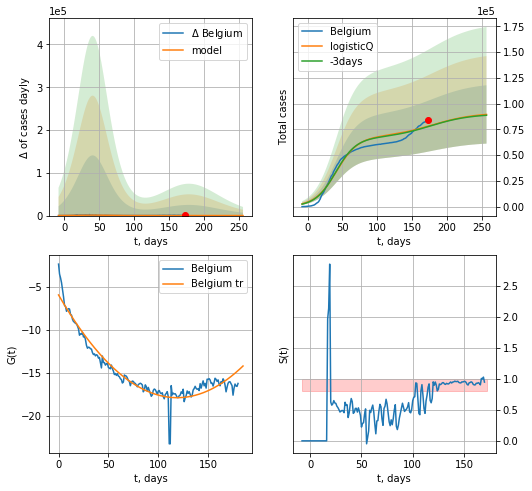

Belgium data at: 2020-08-29
+3 day model MAPE: 0.005054
model: logisticQ
coeffs: [ 6.73939109e+04  4.86552144e-08  4.11375324e+01 -1.33993864e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316520
forecast at the end of period: +84 days
	 deltaDaycases: 53
	 total cases: 89531 ± 28338
	 total death: 10467 ± 9939
trend coefficient of determination: 0.922485
 intercept_: -5.947580421851153
 coeffs_: [ 0.         -0.20050609  0.00084288]


In [1852]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1853]:
dfBZ.tail()

,date,cases,active,death
182,2020-08-25,3674176.0,709115,116666.0
183,2020-08-26,3722004.0,695400,117756.0
184,2020-08-27,3764493.0,698517,118726.0
185,2020-08-28,3812605.0,716215,119594.0
186,2020-08-29,3846965.0,719655,120498.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


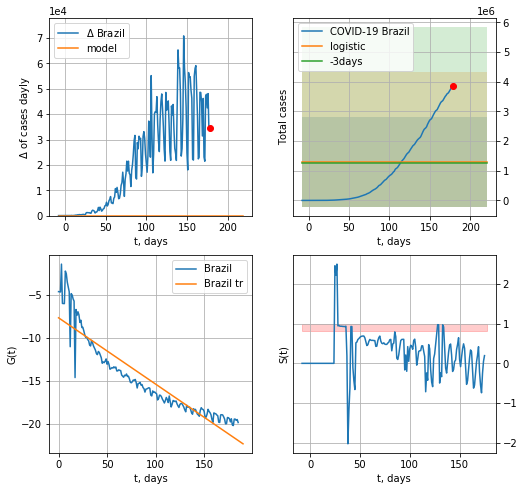

Brazil data at: 2020-08-29
+3 day model MAPE: 0.0451006716890409
model: logistic
coeffs:  [ 1.04420834e+06 -1.91537371e+01  4.62589210e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.1595557418089733
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  1305260 ± 1513522
	 total death:  40884 ± 142221
trend coefficient of determination: 0.854457
 intercept: -7.673093
 slope: -0.077300


In [1854]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


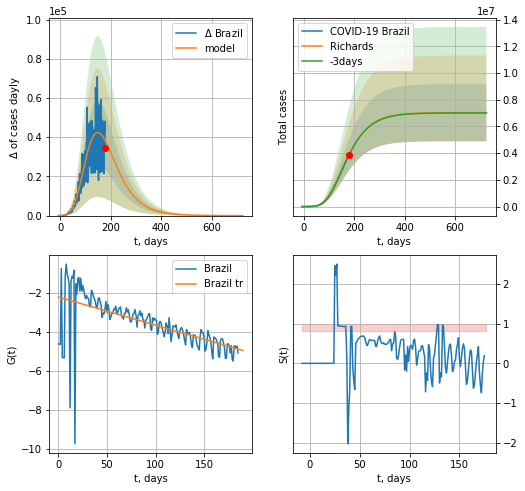

Brazil data at: 2020-08-29
+3 day model MAPE: 0.000585
model: Richards
coeffs: [ 7.03430724e+06  7.00108372e-01 -7.77068195e+01  2.36749852e-02]
rational stdev: 0.304065
forecast at the end of period: +546 days
	 deltaDaycases: 8
	 total cases: 7033803 ± 2138730
	 total death: 220318 ± 200972
trend coefficient of determination: 0.393128
 intercept: -2.210370
 slope: -0.014423


In [1855]:
x = forecastRR('Brazil',dfBZ[:],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


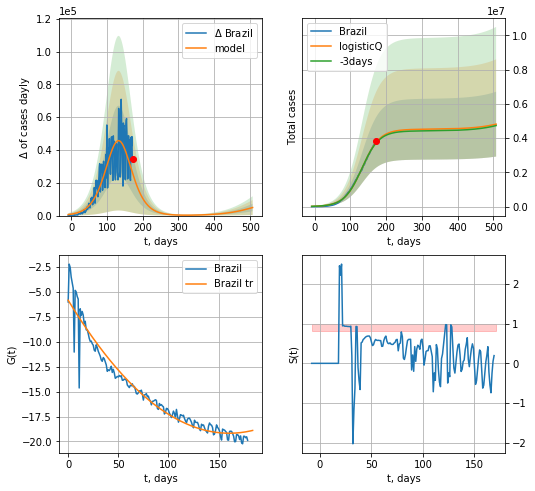

Brazil data at: 2020-08-29
+3 day model MAPE: 0.010050
model: logisticQ
coeffs: [ 4.51640586e+06  3.17729818e-07  1.33122759e+02 -1.27182803e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393038
forecast at the end of period: +336 days
	 deltaDaycases: 4916
	 total cases: 4815726 ± 1892761
	 total death: 150842 ± 177859
trend coefficient of determination: 0.942328
 intercept_: -5.846574508220439
 coeffs_: [ 0.         -0.16588209  0.00051611]


In [1856]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1857]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
192 2020-08-25  25204.0    4555  549.0
193 2020-08-26  25322.0    4650  572.0
194 2020-08-27  25448.0    4232  583.0
195 2020-08-28  25547.0    4091  600.0
196 2020-08-29  25670.0    3943  611.0


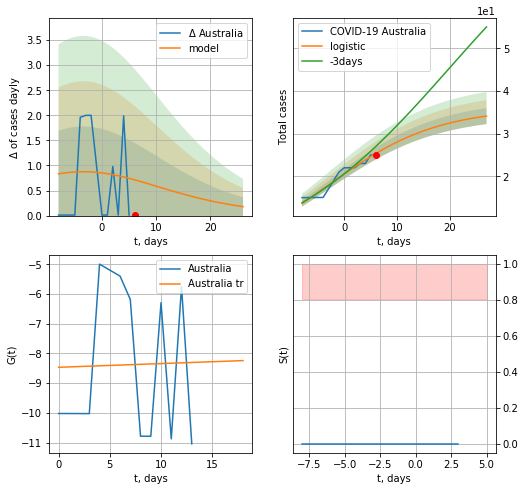

Australia data at: 2020-08-29
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  34 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


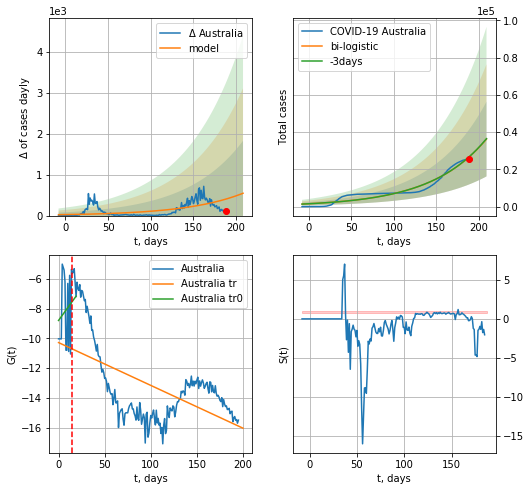

Australia data at: 2020-08-29
+3 day model MAPE: 0.004104754458203698
model: bi-logistic
coeffs:  [7.34748789e+07 1.51462513e-02 7.11690787e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5526845862828087
forecast at the end of period: +21 days
	 deltaDaycases:  544
	 total cases:  36281 ± 20052
	 total death:  863 ± 1430
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.322834
 intercept: -10.275350
 slope: -0.028814


In [1858]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


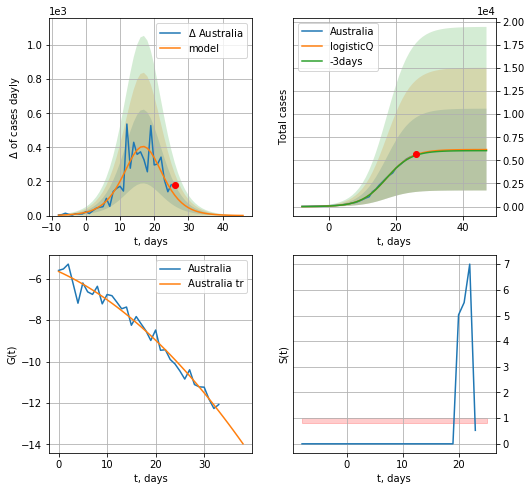

Australia data at: 2020-08-29
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 6165 ± 4419
	 total death: 146 ± 313
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


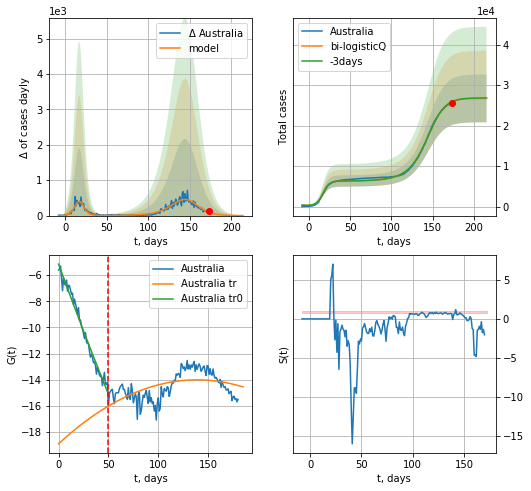

Australia data at: 2020-08-29
+3 day model MAPE: 0.003352
model: bi-logisticQ
coeffs: [ 2.05591925e+04  4.07885277e-04  1.42271992e+02 -7.32396412e+01]
rational stdev: 0.220296
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 26723 ± 5887
	 total death: 636 ± 420
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.283264
 intercept_: -18.908464868561897
 coeffs_: [ 0.          0.07056329 -0.00025415]


In [1859]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,28*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


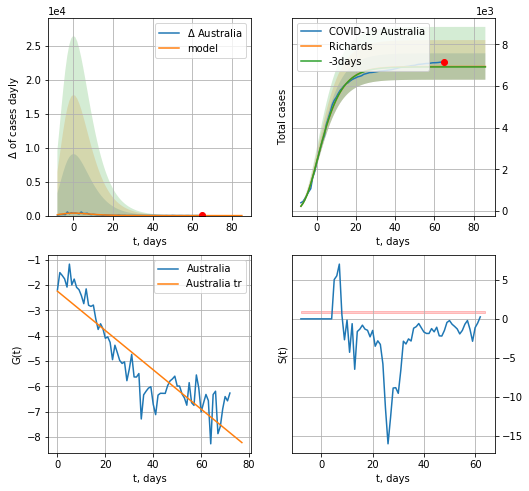

Australia data at: 2020-08-29
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 165 ± 45
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


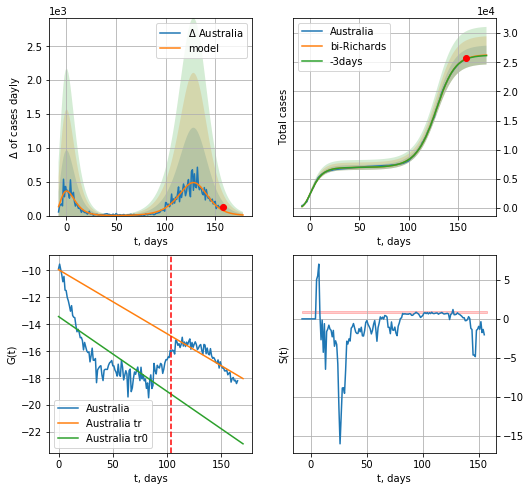

Australia data at: 2020-08-29
+3 day model MAPE: 0.002330
model: bi-Richards
coeffs: [1.93838079e+04 8.59714499e-02 1.30651319e+02 1.26539415e+00]
rational stdev: 0.061412
forecast at the end of period: +21 days
	 deltaDaycases: 9
	 total cases: 26238 ± 1611
	 total death: 624 ± 114
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544628
 intercept: -13.420178
 slope: -0.055577
trend coefficient of determination: 0.768968
 intercept: -9.940840
 slope: -0.047558


In [1860]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,25*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
180 2020-08-25  9285.0     189  125.0
181 2020-08-26  9291.0     188  125.0
182 2020-08-27  9296.0     177  125.0
183 2020-08-28  9306.0     151  125.0
184 2020-08-29  9334.0     160  126.0


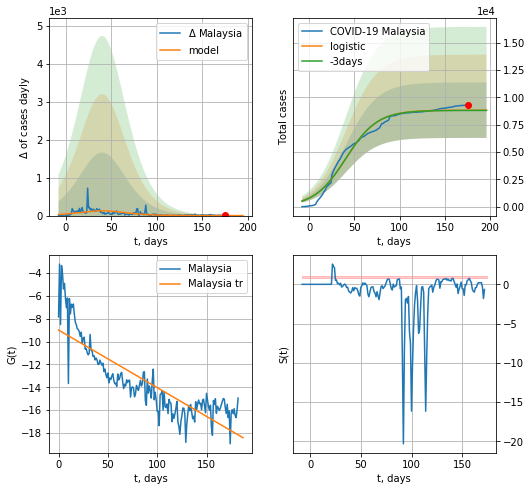

Malaysia data at: 2020-08-29
+3 day model MAPE: 0.002672128043578185
model: logistic
coeffs:  [8.83985942e+03 5.71371983e-02 4.05153992e+01]
rational stdev:  0.2875913993895591
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  8838 ± 2541
	 total death:  119 ± 102
trend coefficient of determination: 0.718346
 intercept: -8.983651
 slope: -0.050473


In [1861]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

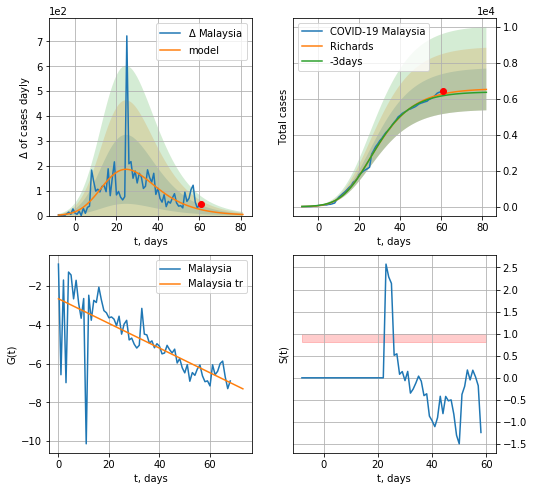

Malaysia data at: 2020-08-29
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55737988e+03 3.88576721e-01 7.38244597e+00 2.20016068e-01]
rational stdev: 0.177893
forecast at the end of period: +21 days
	 deltaDaycases: 4
	 total cases: 6507 ± 1157
	 total death: 87 ± 46
trend coefficient of determination: 0.508700
 intercept: -2.652908
 slope: -0.063638


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


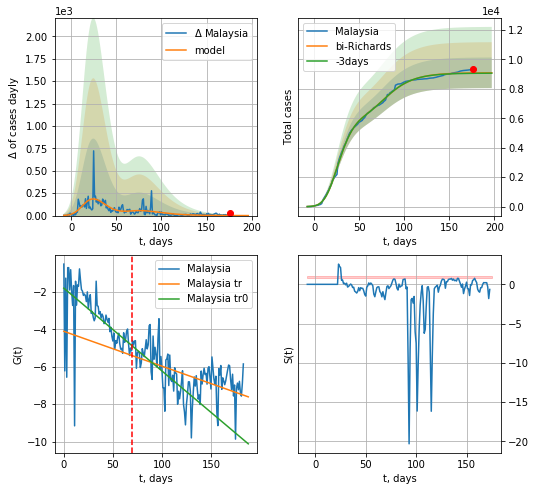

Malaysia data at: 2020-08-29
+3 day model MAPE: 0.002700
model: bi-Richards
coeffs: [ 2.53217858e+03  1.17388277e+01 -2.10132595e+01  4.55763532e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.114292
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 9084 ± 1038
	 total death: 122 ± 41
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.324736
 intercept: -1.802556
 slope: -0.044229
trend coefficient of determination: 0.270563
 intercept: -4.106940
 slope: -0.018624


In [1862]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d12f(1),T18*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


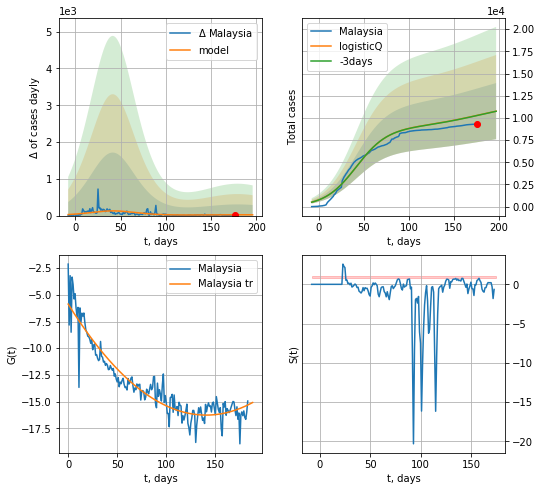

Malaysia data at: 2020-08-29
+3 day model MAPE: 0.001191
model: logisticQ
coeffs: [ 8.83745874e+03  8.09362891e-08  4.15112553e+01 -7.07755199e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294300
forecast at the end of period: +21 days
	 deltaDaycases: 21
	 total cases: 10757 ± 3165
	 total death: 145 ± 128
trend coefficient of determination: 0.880784
 intercept_: -5.866989478440118
 coeffs_: [ 0.         -0.14791476  0.00052591]


In [1863]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
179 2020-08-25  1695.0     134   22.0
180 2020-08-26  1702.0     126   22.0
181 2020-08-27  1714.0     131   22.0
182 2020-08-28  1727.0     137   22.0
183 2020-08-29  1729.0     137   22.0


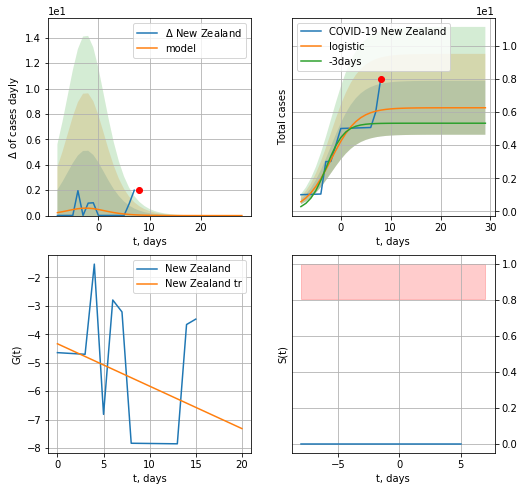

New Zealand data at: 2020-08-29
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


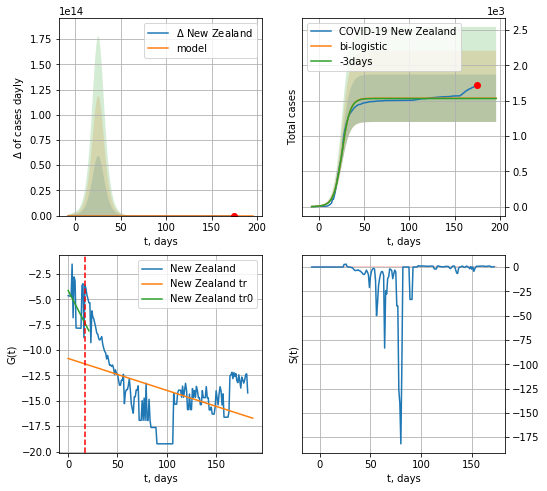

New Zealand data at: 2020-08-29
+3 day model MAPE: 0.0028476475070557373
model: bi-logistic
coeffs:  [1.53010014e+03 2.22219459e-01 2.55588140e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.21907802288509035
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1536 ± 336
	 total death:  19 ± 12
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.200444
 intercept: -10.829967
 slope: -0.031441


In [1864]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

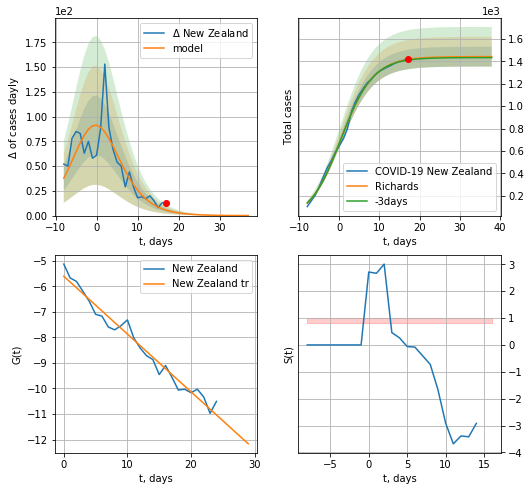

New Zealand data at: 2020-08-29
+3 day model MAPE: 0.004470
model: Richards
coeffs: [ 1.44139481e+03  2.97776460e-01 -7.01796738e-01  8.00257136e-01]
rational stdev: 0.061378
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1441 ± 88
	 total death: 18 ± 3
trend coefficient of determination: 0.970990
 intercept: -5.604763
 slope: -0.226279


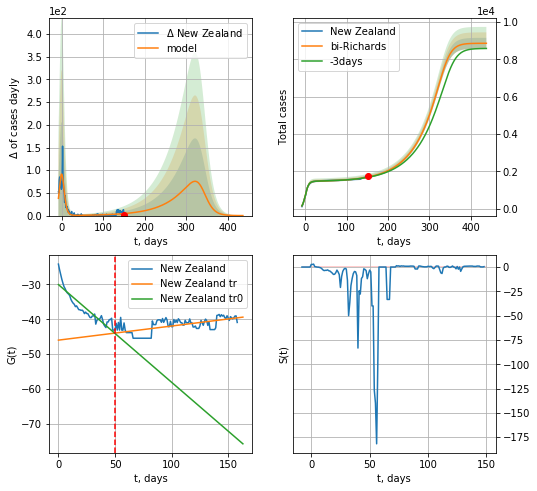

New Zealand data at: 2020-08-29
+3 day model MAPE: 0.007060
model: bi-Richards
coeffs: [7.42610377e+03 1.80494346e-02 3.40415622e+02 4.58061776e+00]
rational stdev: 0.033044
forecast at the end of period: +287 days
	 deltaDaycases: 0
	 total cases: 8866 ± 293
	 total death: 112 ± 11
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.828950
 intercept: -30.062886
 slope: -0.279947
trend coefficient of determination: 0.383404
 intercept: -45.981968
 slope: 0.040438


In [1865]:
iL = 24
vL = 50+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[iL:],d1,63*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


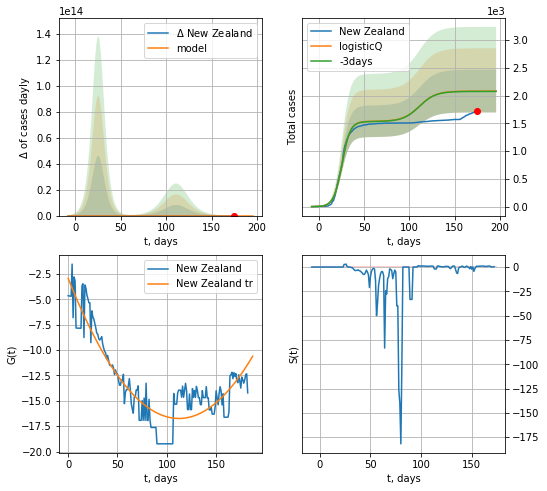

New Zealand data at: 2020-08-29
+3 day model MAPE: 0.002832
model: logisticQ
coeffs: [ 1.53651659e+03  1.11940265e-06  2.55108912e+01 -1.96649378e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.185094
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 2080 ± 385
	 total death: 26 ± 14
trend coefficient of determination: 0.818457
 intercept_: -2.9270651184264853
 coeffs_: [ 0.         -0.2461426   0.00109648]


In [1867]:
x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
179 2020-08-25  70727.0     978  652.0
180 2020-08-26  70974.0     939  657.0
181 2020-08-27  71165.0     853  662.0
182 2020-08-28  71346.0     792  667.0
183 2020-08-29  71523.0     645  671.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


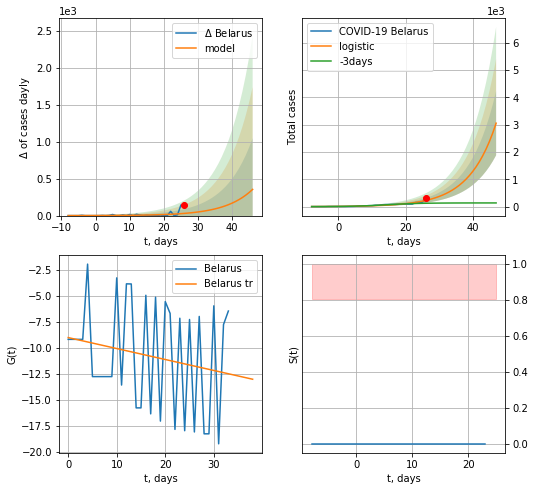

Belarus data at: 2020-08-29
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +21 days
	 deltaDaycases:  355
	 total cases:  3051 ± 1173
	 total death:  28 ± 32
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


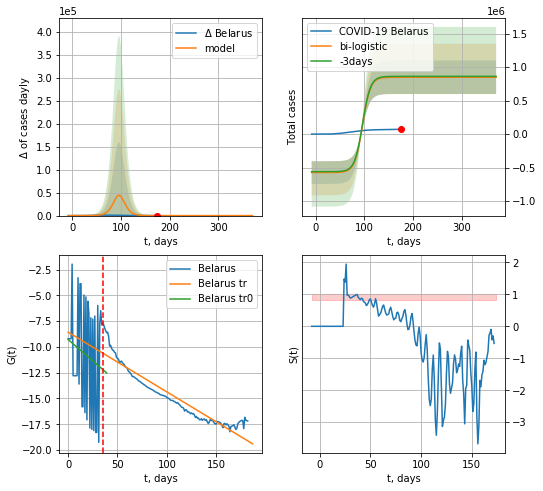

Belarus data at: 2020-08-29
+3 day model MAPE: 0.0149529014444163
model: bi-logistic
coeffs:  [-5.73785582e+05  1.52196744e+01 -3.45174534e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.2950499585202323
forecast at the end of period: +196 days
	 deltaDaycases:  0
	 total cases:  848188 ± 250257
	 total death:  7957 ± 7043
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.891205
 intercept: -8.574700
 slope: -0.057865


In [1868]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
179 2020-08-25  70727.0     978  652.0
180 2020-08-26  70974.0     939  657.0
181 2020-08-27  71165.0     853  662.0
182 2020-08-28  71346.0     792  667.0
183 2020-08-29  71523.0     645  671.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


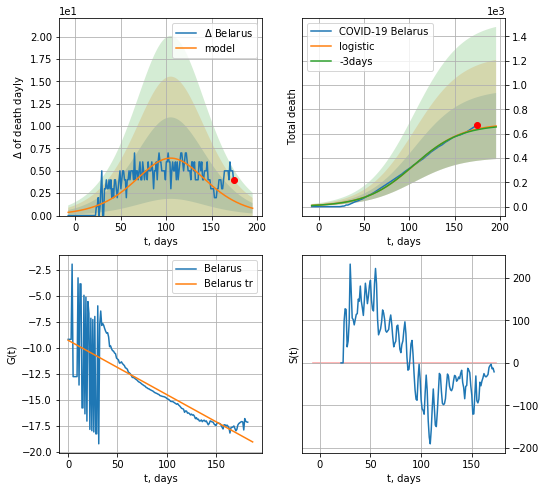

Belarus data at: 2020-08-29
+3 day model MAPE: 0.009573696774979802
model: logistic
coeffs:  [6.84598553e+02 3.75128204e-02 1.05340179e+02]
rational stdev:  0.4099066081333892
forecast at the end of period: +21 days
	 total death:  662 ± 271
trend coefficient of determination: 0.571701
 intercept: -9.301832
 slope: -0.052267


In [1869]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


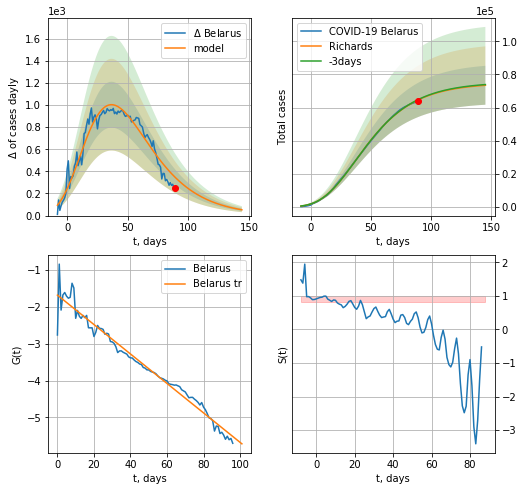

Belarus data at: 2020-08-29
+3 day model MAPE: 0.003209
model: Richards
coeffs: [ 7.48953664e+04  2.57392080e+00 -7.89506341e+01  1.42399820e-02]
rational stdev: 0.159991
forecast at the end of period: +56 days
	 deltaDaycases: 52
	 total cases: 73476 ± 11755
	 total death: 689 ± 330
trend coefficient of determination: 0.965894
 intercept: -1.688272
 slope: -0.039854


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


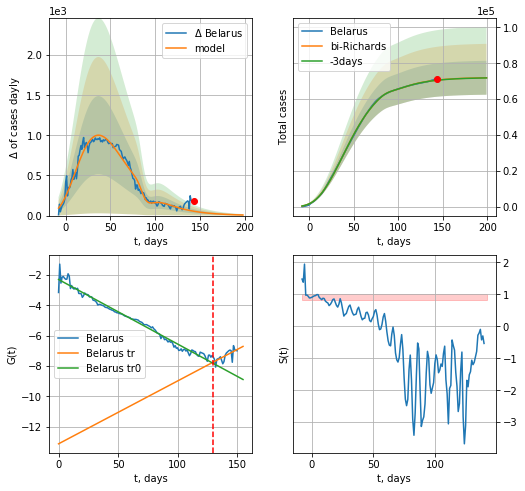

Belarus data at: 2020-08-29
+3 day model MAPE: 0.001338
model: bi-Richards
coeffs: [-2.74176250e+03  1.74134100e+00  7.58676906e+01  8.91236197e-02]
rational stdev: 0.131288
forecast at the end of period: +56 days
	 deltaDaycases: 7
	 total cases: 71955 ± 9446
	 total death: 675 ± 265
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.980427
 intercept: -2.292214
 slope: -0.042577
trend coefficient of determination: 0.479286
 intercept: -13.135396
 slope: 0.041466


In [1875]:
iL=32
vL = 130+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belarus',dfBR[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


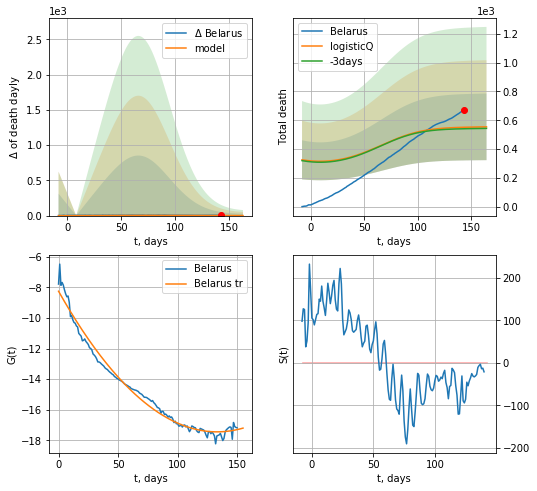

Belarus data at: 2020-08-29
+3 day model MAPE: 0.019108
model: logisticQ
coeffs: [4.67523037e+02 3.14597119e-04 1.53121082e+01 1.67077072e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.416917
forecast at the end of period: +21 days
	 total death: 554 ± 231
trend coefficient of determination: 0.981730
 intercept_: -8.257790935308531
 coeffs_: [ 0.         -0.13786207  0.00051731]


In [1877]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

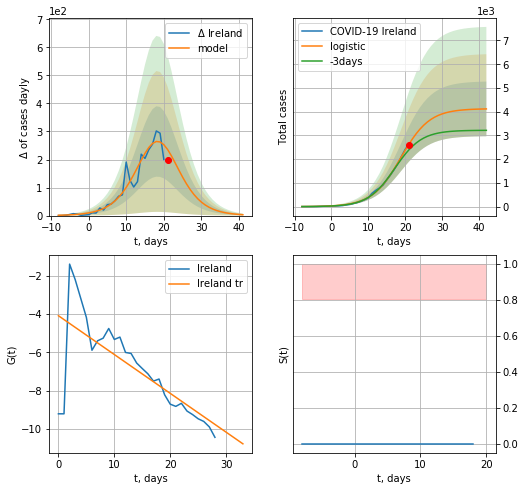

Ireland data at: 2020-08-29
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +21 days
	 deltaDaycases:  3
	 total cases:  4116 ± 1151
	 total death:  254 ± 213
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


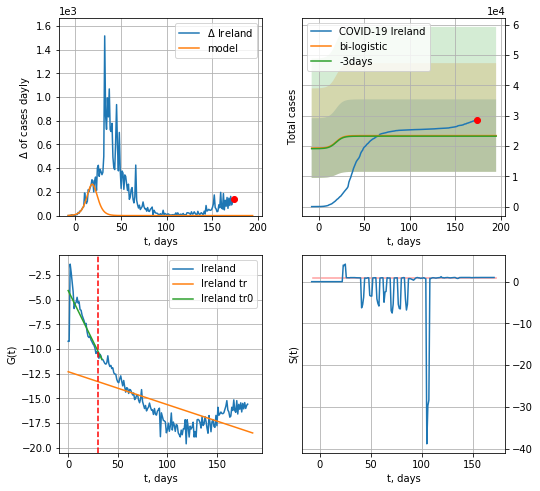

Ireland data at: 2020-08-29
+3 day model MAPE: 0.008095972249620454
model: bi-logistic
coeffs:  [ 1.54301952e+04 -1.18856261e+01  2.96993285e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5101567456263199
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  23415 ± 11945
	 total death:  1448 ± 2216
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.446303
 intercept: -12.290079
 slope: -0.033361


In [1878]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


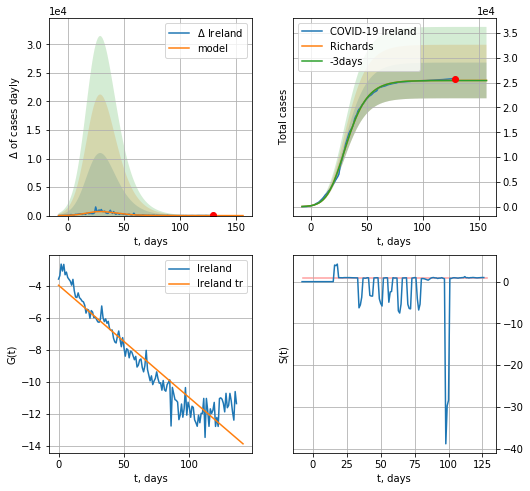

Ireland data at: 2020-08-29
+3 day model MAPE: 0.000894
model: Richards
coeffs: [2.54407353e+04 2.28847737e-01 1.92916171e+01 3.96517588e-01]
rational stdev: 0.141278
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 25440 ± 3594
	 total death: 1574 ± 667
trend coefficient of determination: 0.901596
 intercept: -3.946012
 slope: -0.070416


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


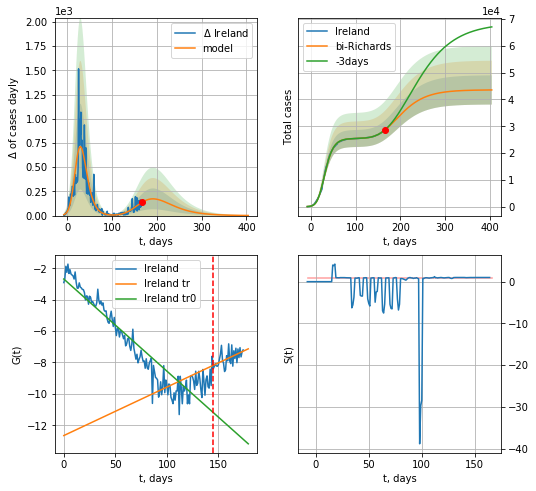

Ireland data at: 2020-08-29
+3 day model MAPE: 0.002659
model: bi-Richards
coeffs: [1.81377666e+04 1.53441805e-01 1.31700474e+02 1.84254354e-01]
rational stdev: 0.125079
forecast at the end of period: +238 days
	 deltaDaycases: 1
	 total cases: 43535 ± 5445
	 total death: 2693 ± 1010
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.869061
 intercept: -2.684663
 slope: -0.058644
trend coefficient of determination: 0.280039
 intercept: -12.656353
 slope: 0.030859


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


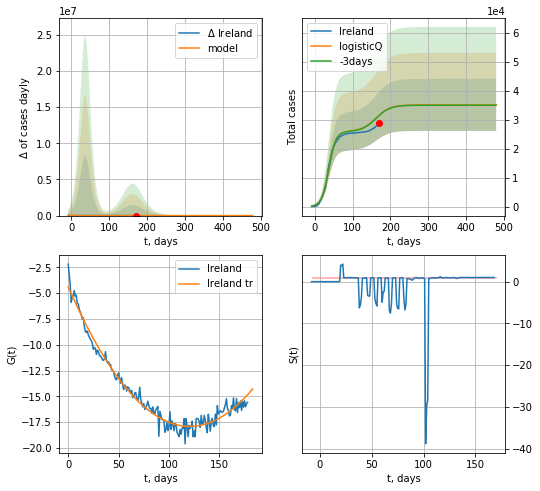

Ireland data at: 2020-08-29
+3 day model MAPE: 0.001374
model: logisticQ
coeffs: [ 2.59017373e+04  3.52410989e-07  3.71445605e+01 -3.04338910e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.255497
forecast at the end of period: +308 days
	 deltaDaycases: 0
	 total cases: 35075 ± 8961
	 total death: 2170 ± 1663
trend coefficient of determination: 0.973824
 intercept_: -4.37452010680234
 coeffs_: [ 0.         -0.22435185  0.00092989]


In [1883]:
ivL = 7
vL = 145 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,56*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
175 2020-08-25  400985   15564  10958.0
176 2020-08-26  402365   15107  10990.0
177 2020-08-27  404102   15108  11072.0
178 2020-08-28  405972   15388  11132.0
179 2020-08-29  408009   15645  11181.0


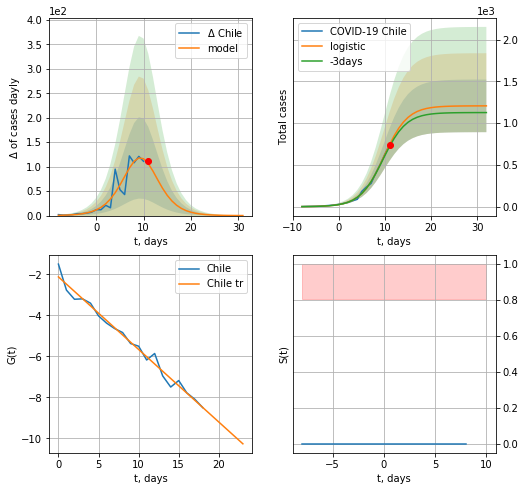

Chile data at: 2020-08-29
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


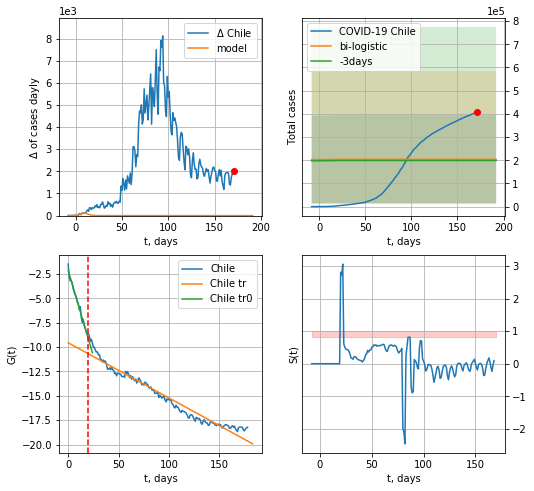

Chile data at: 2020-08-29
+3 day model MAPE: 0.025875038181115976
model: bi-logistic
coeffs:  [ 1.62123245e+05 -3.32052615e+01  7.98170450e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9335287284784463
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  203861 ± 190310
	 total death:  5586 ± 15644
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.953128
 intercept: -9.561410
 slope: -0.056598


In [1884]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


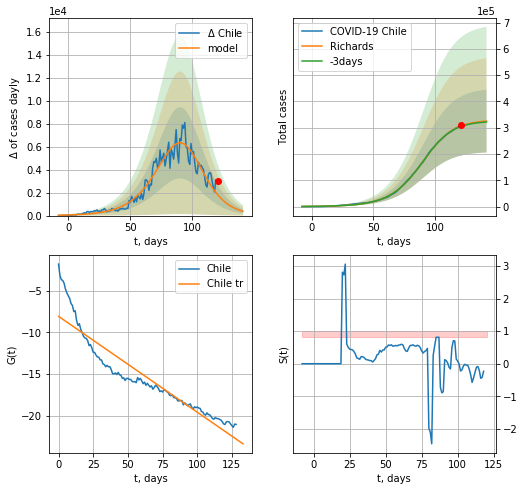

Chile data at: 2020-08-29
+3 day model MAPE: 0.006062
model: Richards
coeffs: [3.29740872e+05 6.47237974e-02 9.37490232e+01 1.29835958e+00]
rational stdev: 0.366980
forecast at the end of period: +21 days
	 deltaDaycases: 373
	 total cases: 325403 ± 119416
	 total death: 8917 ± 9817
trend coefficient of determination: 0.871763
 intercept: -8.084056
 slope: -0.114797


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


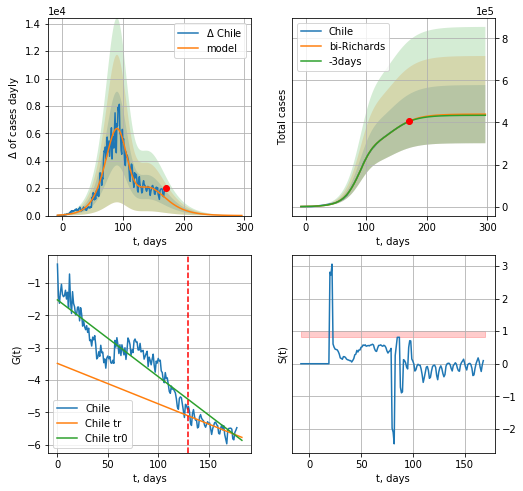

Chile data at: 2020-08-29
+3 day model MAPE: 0.003224
model: bi-Richards
coeffs: [1.09716078e+05 3.30836573e+00 5.21032859e+01 1.35299662e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.314471
forecast at the end of period: +126 days
	 deltaDaycases: 6
	 total cases: 439316 ± 138152
	 total death: 12038 ± 11356
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.821326
 intercept: -1.524927
 slope: -0.023718
trend coefficient of determination: 0.562959
 intercept: -3.488663
 slope: -0.012488


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


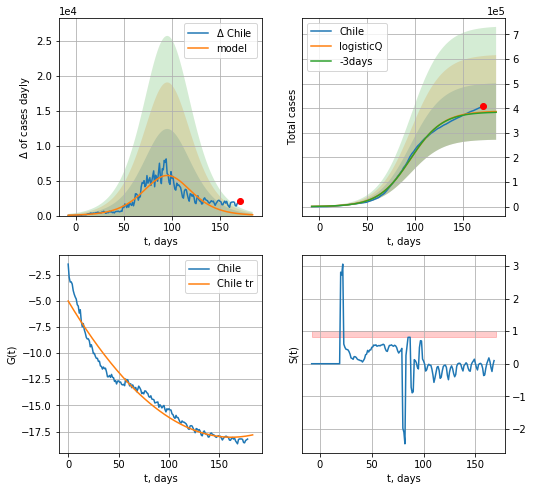

Chile data at: 2020-08-29
+3 day model MAPE: 0.007885
model: logisticQ
coeffs: [ 3.88605927e+05  2.50925862e-07  9.55885840e+01 -2.35638055e+05]
rational stdev: 0.296702
forecast at the end of period: +14 days
	 deltaDaycases: 118
	 total cases: 386658 ± 114722
	 total death: 10595 ± 9430
trend coefficient of determination: 0.958510
 intercept_: -5.030171575636357
 coeffs_: [ 0.         -0.16089479  0.00049733]


In [1885]:
vL = 130
x = forecastRR('Chile',dfCL[:vL],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

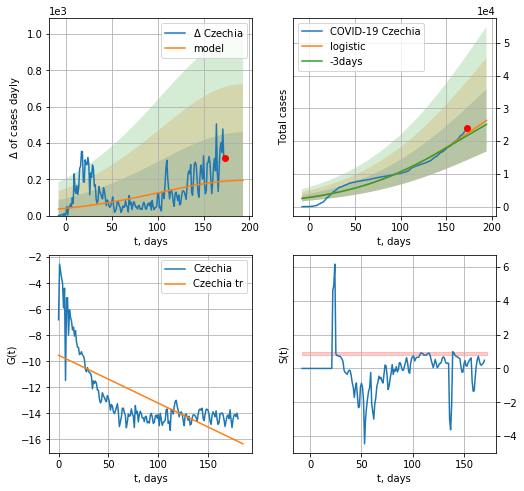

Czechia data at: 2020-08-29
+3 day model MAPE: 0.028452385460972725
model: logistic
coeffs:  [5.27502983e+04 1.47125950e-02 1.94039335e+02]
rational stdev:  0.36125359901608267
forecast at the end of period: +21 days
	 deltaDaycases:  194
	 total cases:  26367 ± 9525
	 total death:  460 ± 498
trend coefficient of determination: 0.510630
 intercept: -9.535356
 slope: -0.036797


In [1886]:
x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


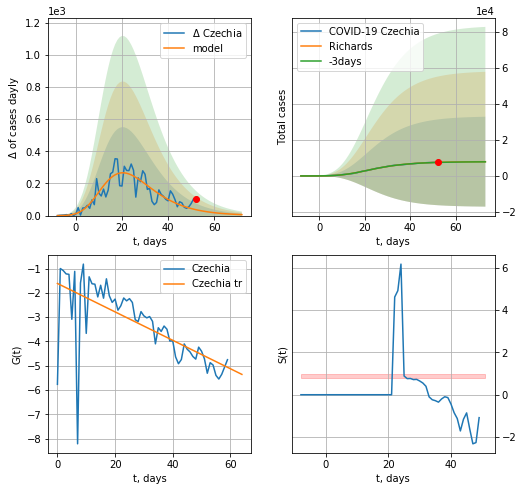

Czechia data at: 2020-08-29
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936803e+03  1.90705450e+00 -1.17115779e+01  4.87276061e-02]
rational stdev: 3.153640
forecast at the end of period: +21 days
	 deltaDaycases: 6
	 total cases: 7927 ± 24999
	 total death: 138 ± 1305
trend coefficient of determination: 0.449013
 intercept: -1.614151
 slope: -0.058413


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


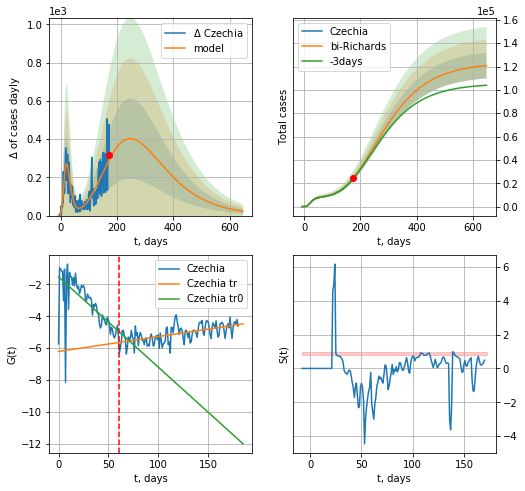

Czechia data at: 2020-08-29
+3 day model MAPE: 0.007712
model: bi-Richards
coeffs: [ 1.15269569e+05  3.32257079e-01 -1.20144875e+02  2.89821000e-02]
rational stdev: 0.091163
forecast at the end of period: +476 days
	 deltaDaycases: 22
	 total cases: 120869 ± 11018
	 total death: 2111 ± 577
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.442139
 intercept: -1.532520
 slope: -0.056612
trend coefficient of determination: 0.354044
 intercept: -6.212163
 slope: 0.009365


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


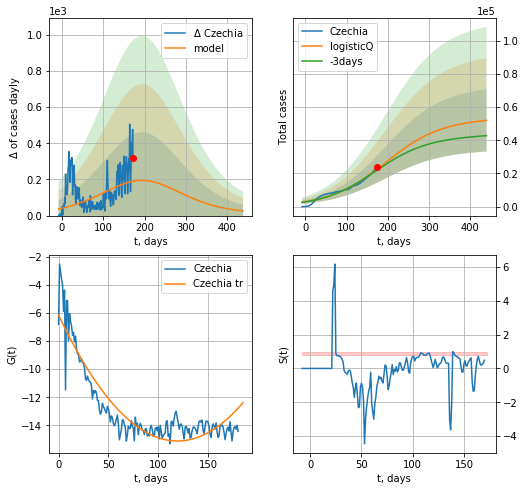

Czechia data at: 2020-08-29
+3 day model MAPE: 0.026186
model: logisticQ
coeffs: [ 5.25119086e+04  1.56016888e-07  1.93445620e+02 -9.43942721e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361137
forecast at the end of period: +266 days
	 deltaDaycases: 25
	 total cases: 52045 ± 18795
	 total death: 909 ± 984
trend coefficient of determination: 0.837339
 intercept_: -6.15320452644778
 coeffs_: [ 0.         -0.15016628  0.00062983]


In [1888]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

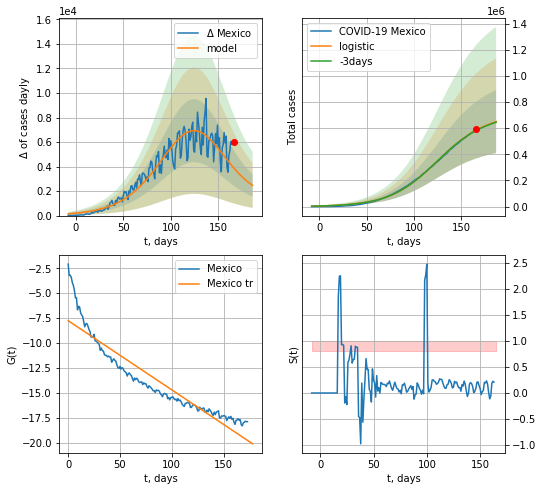

Mexico data at: 2020-08-29
+3 day model MAPE: 0.006178814808536543
model: logistic
coeffs:  [6.90378290e+05 3.98525446e-02 1.24507575e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3706045246096756
forecast at the end of period: +21 days
	 deltaDaycases:  2463
	 total cases:  650987 ± 241258
	 total death:  70212 ± 78062
trend coefficient of determination: 0.867144
 intercept: -7.757313
 slope: -0.069409


In [1890]:
x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


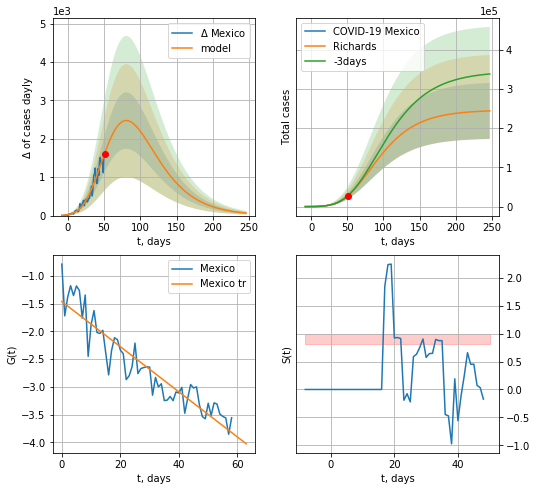

Mexico data at: 2020-08-29
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +196 days
	 deltaDaycases: 64
	 total cases: 243940 ± 71378
	 total death: 26310 ± 23095
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


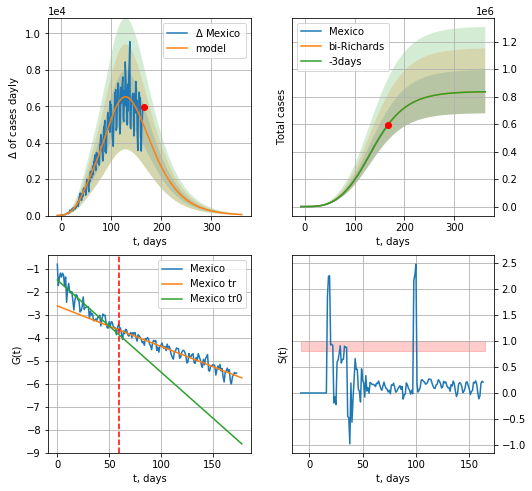

Mexico data at: 2020-08-29
+3 day model MAPE: 0.000016
model: bi-Richards
coeffs: [5.92139730e+05 3.55379162e-01 3.14848529e+01 7.04445759e-02]
rational stdev: 0.188010
forecast at the end of period: +196 days
	 deltaDaycases: 56
	 total cases: 836110 ± 157197
	 total death: 90178 ± 50863
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.861660
 intercept: -1.480221
 slope: -0.040054
trend coefficient of determination: 0.918947
 intercept: -2.610499
 slope: -0.017585


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


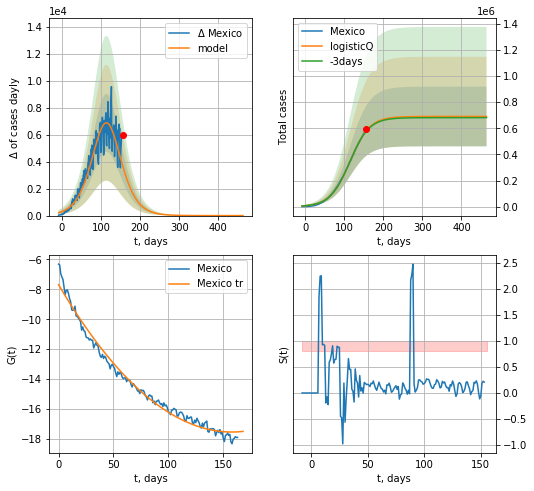

Mexico data at: 2020-08-29
+3 day model MAPE: 0.006418
model: logisticQ
coeffs: [ 6.90687994e+05  4.06647876e-07  1.14540320e+02 -9.78175198e+04]
rational stdev: 0.331087
forecast at the end of period: +308 days
	 deltaDaycases: 0
	 total cases: 690687 ± 228677
	 total death: 74493 ± 73991
trend coefficient of determination: 0.984597
 intercept_: -7.695200207112463
 coeffs_: [ 0.         -0.12456893  0.00039461]


In [1891]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
169 2020-08-25  2726.0     847   85.0  618405.0
170 2020-08-26  2762.0     875   85.0  623841.0
171 2020-08-27  2810.0     908   86.0  629443.0
172 2020-08-28  2839.0     920   86.0  634751.0
173 2020-08-29  2874.0     951   86.0  637509.0


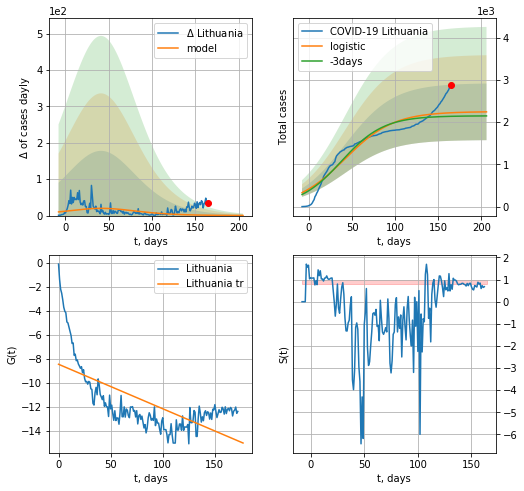

Lithuania data at: 2020-08-29
+3 day model MAPE: 0.03964032405748445
model: logistic
coeffs:  [2.24836303e+03 3.55221882e-02 4.15244252e+01]
rational stdev:  0.29883916338661776
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  2241 ± 669
	 total death:  67 ± 60
trend coefficient of determination: 0.441350
 intercept: -8.447391
 slope: -0.037050


In [1893]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [1894]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [1895]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


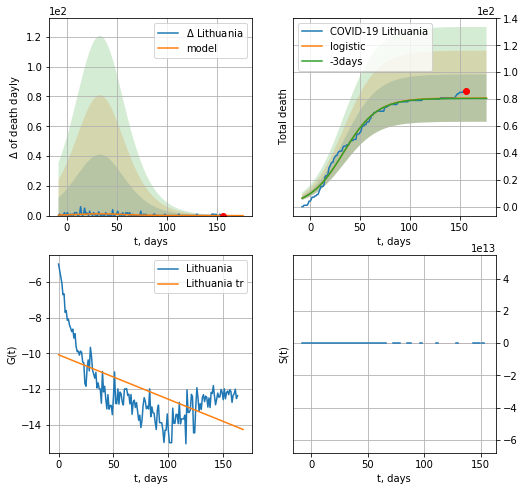

Lithuania data at: 2020-08-29
+3 day model MAPE: 0.003485068721955477
model: logistic
coeffs:  [8.07980577e+01 5.91863879e-02 3.37447184e+01]
rational stdev:  0.21840023185438923
forecast at the end of period: +21 days
	 total death:  80 ± 17
trend coefficient of determination: 0.380404
 intercept: -10.083682
 slope: -0.024900


In [1896]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


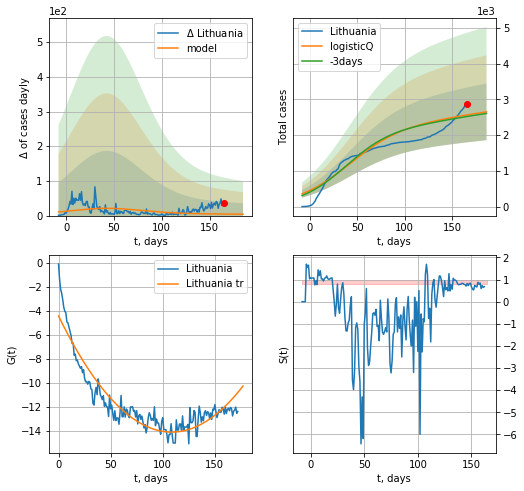

Lithuania data at: 2020-08-29
+3 day model MAPE: 0.017041
model: logisticQ
coeffs: [ 2.24847520e+03  2.56823564e-08  4.15304192e+01 -1.38231765e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.298856
forecast at the end of period: +21 days
	 deltaDaycases: 4
	 total cases: 2651 ± 792
	 total death: 80 ± 71
trend coefficient of determination: 0.872676
 intercept_: -4.427877429686838
 coeffs_: [ 0.         -0.17808592  0.00081998]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


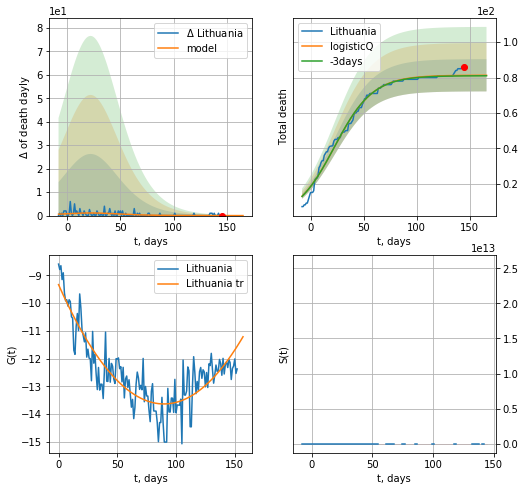

Lithuania data at: 2020-08-29
+3 day model MAPE: 0.003426
model: logisticQ
coeffs: [ 8.13132619e+01  2.01593794e-07  2.24981023e+01 -2.71667352e+05]
rational stdev: 0.112200
forecast at the end of period: +21 days
	 total death: 81 ± 9
trend coefficient of determination: 0.762894
 intercept_: -9.330082488603988
 coeffs_: [ 0.         -0.09599525  0.00053515]


In [1897]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


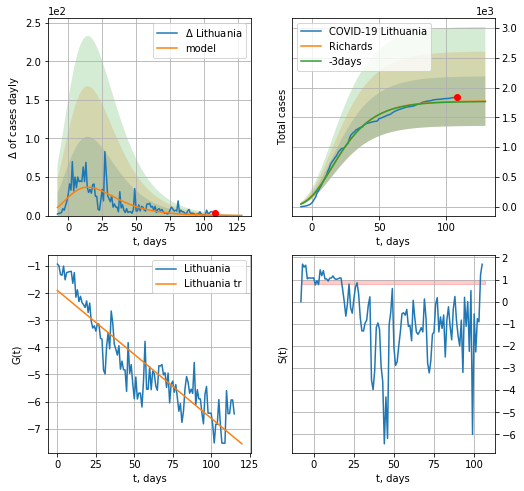

Lithuania data at: 2020-08-29
+3 day model MAPE: 0.004317
model: Richards
coeffs: [ 1.77501763e+03  1.31639926e+01 -8.14596876e+01  4.29803165e-03]
rational stdev: 0.234279
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1772 ± 415
	 total death: 53 ± 37
trend coefficient of determination: 0.820394
 intercept: -1.897700
 slope: -0.047186


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


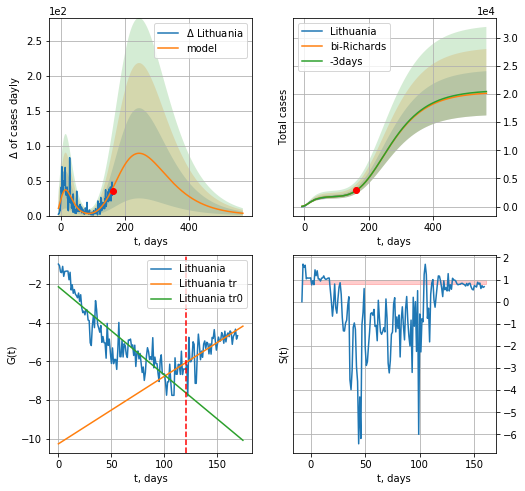

Lithuania data at: 2020-08-29
+3 day model MAPE: 0.000203
model: bi-Richards
coeffs: [ 1.86059815e+04  3.98478268e-01 -1.26779123e+01  3.32863313e-02]
rational stdev: 0.195284
forecast at the end of period: +406 days
	 deltaDaycases: 3
	 total cases: 20130 ± 3931
	 total death: 609 ± 356
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.802286
 intercept: -2.142355
 slope: -0.045607
trend coefficient of determination: 0.465299
 intercept: -10.260566
 slope: 0.034956


In [1898]:
iL = 3
vL =120+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

In [1899]:
#dfLT['cases'].values
#x = forecastRR('Lithuania',dfLT[130:],d1,30*7-dT,addpred=False)#

In [1900]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
171 2020-08-25  6432.0     600  124.0
172 2020-08-26  6506.0     664  124.0
173 2020-08-27  6506.5     664  124.0
174 2020-08-28  6580.0     684  124.0
175 2020-08-29  6625.0    -639  124.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


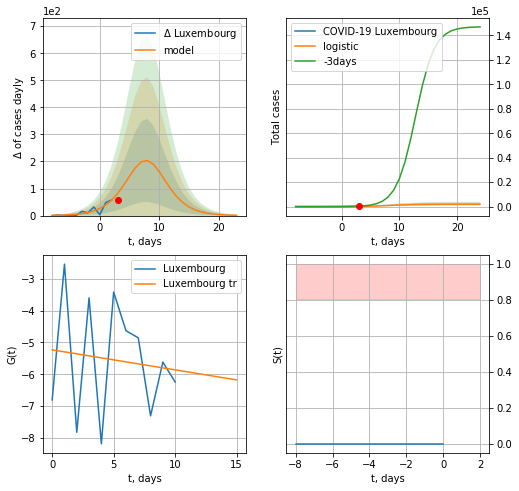

Luxembourg data at: 2020-08-29
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +21 days
	 deltaDaycases:  1
	 total cases:  1875 ± 671
	 total death:  35 ± 37
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


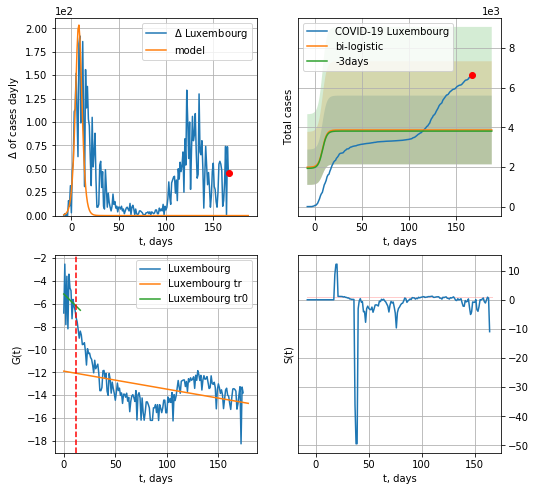

Luxembourg data at: 2020-08-29
+3 day model MAPE: 0.015001849442194142
model: bi-logistic
coeffs:  [1765.58693163  -10.32251611  278.12045918] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.447953099117158
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  3863 ± 1730
	 total death:  72 ± 96
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.175440
 intercept: -11.896578
 slope: -0.015730


In [1901]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


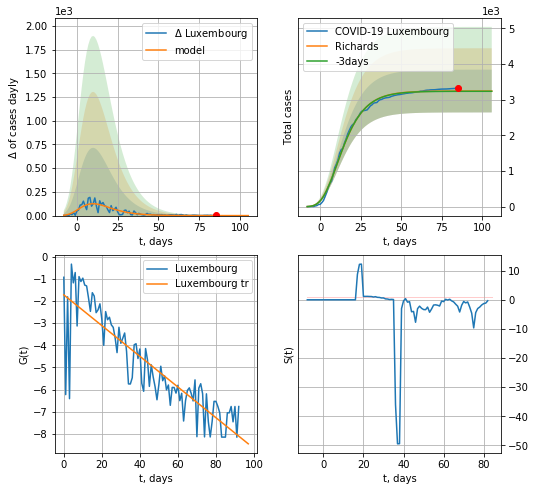

Luxembourg data at: 2020-08-29
+3 day model MAPE: 0.002007
model: Richards
coeffs: [ 3.24138545e+03  2.02715004e+01 -3.96622957e+01  5.18542030e-03]
rational stdev: 0.184858
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 3241 ± 599
	 total death: 60 ± 33
trend coefficient of determination: 0.764532
 intercept: -1.723997
 slope: -0.069294


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


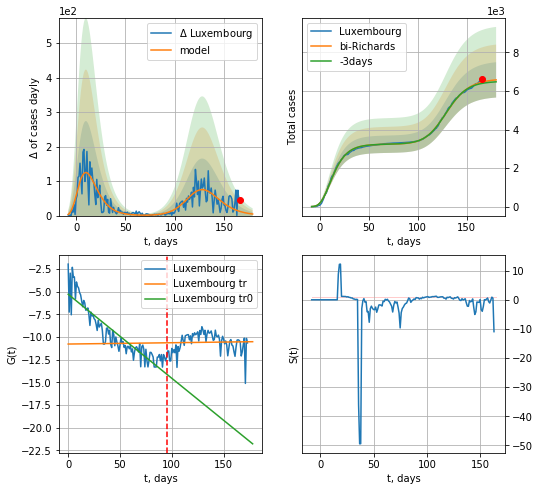

Luxembourg data at: 2020-08-29
+3 day model MAPE: 0.011235
model: bi-Richards
coeffs: [3.39279991e+03 1.22879500e-01 1.22761257e+02 6.43240960e-01]
rational stdev: 0.139277
forecast at the end of period: +14 days
	 deltaDaycases: 4
	 total cases: 6577 ± 916
	 total death: 123 ± 51
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.819568
 intercept: -5.283596
 slope: -0.092708
trend coefficient of determination: 0.000956
 intercept: -10.776057
 slope: 0.001449


In [1902]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


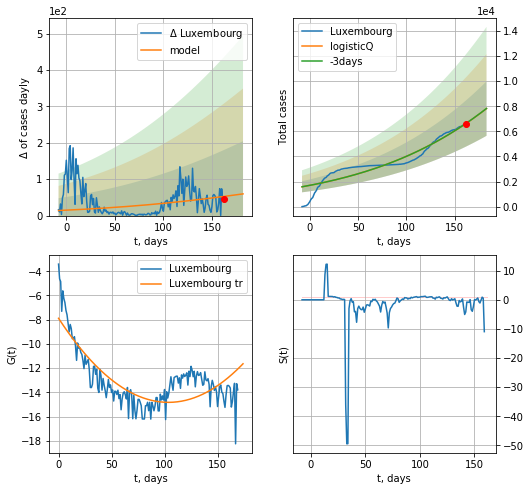

Luxembourg data at: 2020-08-29
+3 day model MAPE: 0.000830
model: logisticQ
coeffs: [ 4.54662443e+04  4.36718787e-07  3.51817575e+02 -2.11464728e+04]
rational stdev: 0.277499
forecast at the end of period: +21 days
	 deltaDaycases: 59
	 total cases: 7813 ± 2168
	 total death: 146 ± 121
trend coefficient of determination: 0.623157
 intercept_: -7.885808935686631
 coeffs_: [ 0.         -0.13388014  0.00064533]


In [1903]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date     cases   active   death
178 2020-08-25  109030.0   7637.0  6368.0
179 2020-08-26  110549.0   9042.0  6410.0
180 2020-08-27  111219.0   9546.0  6471.0
181 2020-08-28  112141.0  10326.0  6504.0
182 2020-08-29  112906.0  10940.0  6537.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


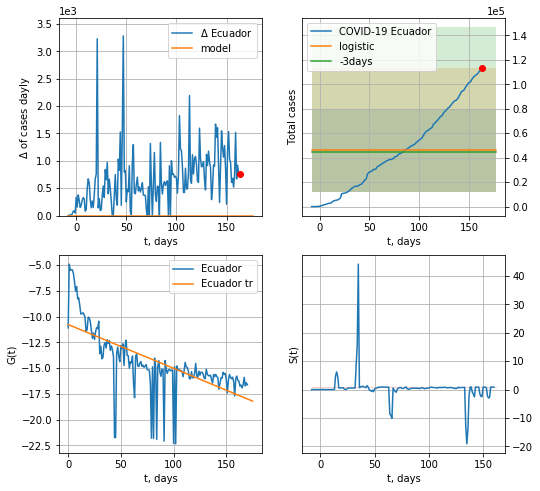

Ecuador data at: 2020-08-29
+3 day model MAPE: 0.026250812127166234
model: logistic
coeffs:  [ 4.59197387e+04 -8.68215218e+00  2.28921629e+02]
rational stdev:  0.7326463244669382
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  45919 ± 33642
	 total death:  2658 ± 5842
trend coefficient of determination: 0.458524
 intercept: -10.768707
 slope: -0.042522


In [1904]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


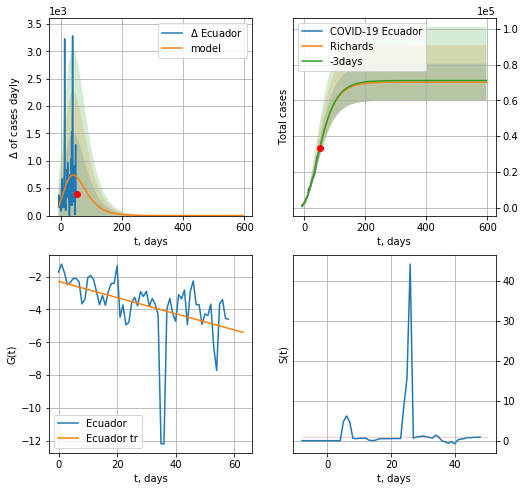

Ecuador data at: 2020-08-29
+3 day model MAPE: 0.001508
model: Richards
coeffs: [ 7.02508577e+04  1.76844856e+00 -1.01710647e+02  1.63770361e-02]
rational stdev: 0.146403
forecast at the end of period: +546 days
	 deltaDaycases: 0
	 total cases: 70250 ± 10284
	 total death: 4067 ± 1786
trend coefficient of determination: 0.183686
 intercept: -2.292555
 slope: -0.049246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


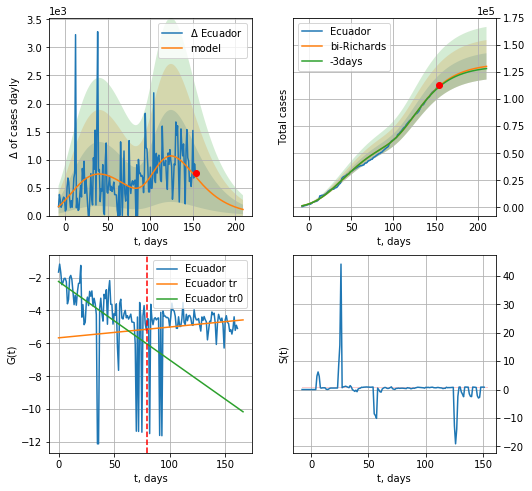

Ecuador data at: 2020-08-29
+3 day model MAPE: 0.005228
model: bi-Richards
coeffs: [6.30013158e+04 4.61508554e+00 6.82526821e+00 8.54363588e-03]
rational stdev: 0.093414
forecast at the end of period: +56 days
	 deltaDaycases: 109
	 total cases: 130340 ± 12175
	 total death: 7546 ± 2114
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.240724
 intercept: -2.240058
 slope: -0.047713
trend coefficient of determination: 0.012584
 intercept: -5.665084
 slope: 0.006566


In [1905]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


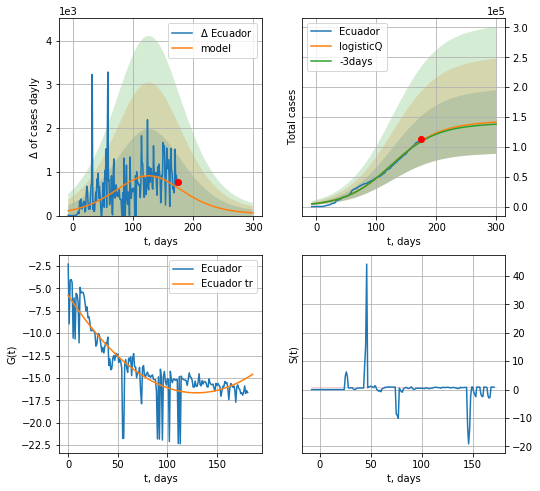

Ecuador data at: 2020-08-29
+3 day model MAPE: 0.010002
model: logisticQ
coeffs: [ 1.41185291e+05  1.03130741e-07  1.26443806e+02 -2.49319979e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375615
forecast at the end of period: +126 days
	 deltaDaycases: 64
	 total cases: 141452 ± 53131
	 total death: 8189 ± 9227
trend coefficient of determination: 0.728580
 intercept_: -5.798753710178985
 coeffs_: [ 0.         -0.16785795  0.00064819]


In [1906]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
182 2020-08-25  7981.0     546  335.0
183 2020-08-26  8002.0     467  335.0
184 2020-08-27  8019.0     484  335.0
185 2020-08-28  8042.0     507  335.0
186 2020-08-29  8077.0     542  335.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


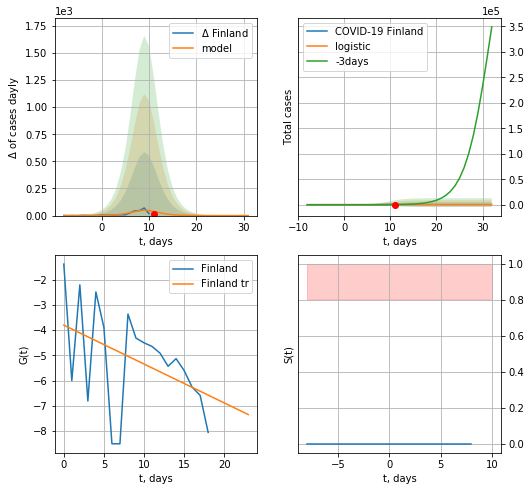

Finland data at: 2020-08-29
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  15 ± 496
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


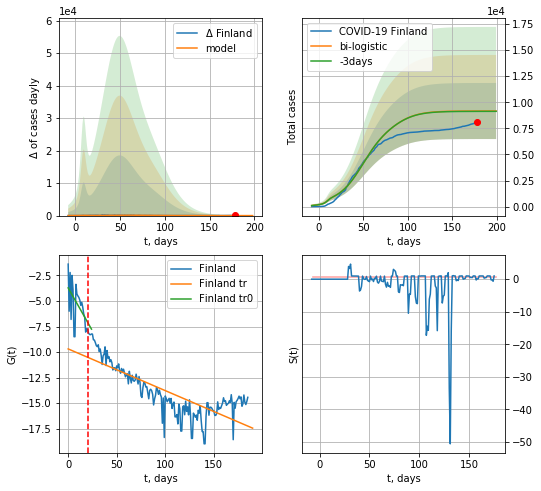

Finland data at: 2020-08-29
+3 day model MAPE: 0.003549446698372942
model: bi-logistic
coeffs:  [7.03424020e+03 7.40778966e-02 4.87420650e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.29316188386665576
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  9165 ± 2686
	 total death:  380 ± 334
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.635014
 intercept: -9.695439
 slope: -0.040863


In [1907]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


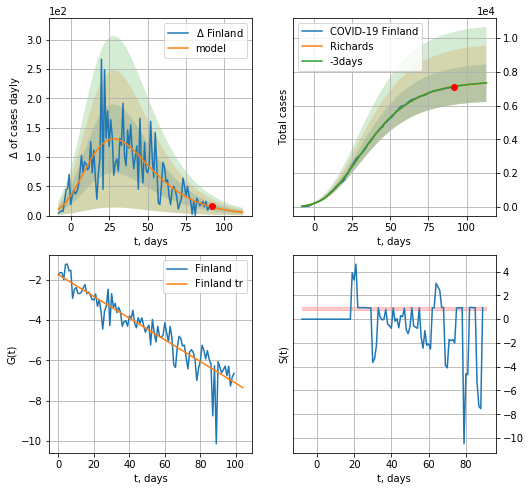

Finland data at: 2020-08-29
+3 day model MAPE: 0.001115
model: Richards
coeffs: [ 7.44184304e+03  7.14884094e-01 -2.55188087e+01  6.92679823e-02]
rational stdev: 0.151514
forecast at the end of period: +21 days
	 deltaDaycases: 5
	 total cases: 7329 ± 1110
	 total death: 304 ± 138
trend coefficient of determination: 0.862147
 intercept: -1.759889
 slope: -0.053817


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


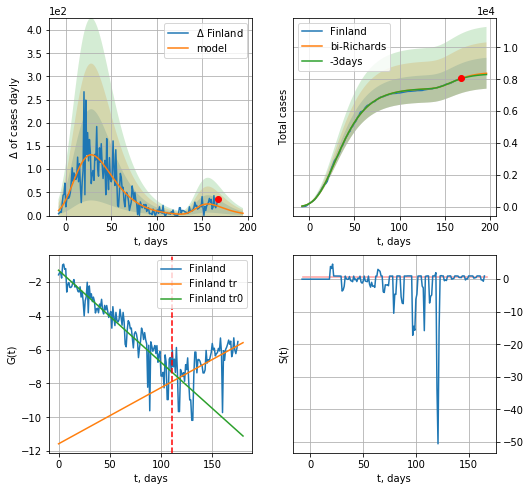

Finland data at: 2020-08-29
+3 day model MAPE: 0.002675
model: bi-Richards
coeffs: [1.01191226e+03 7.00733183e+00 8.64193699e+01 9.42463850e-03]
rational stdev: 0.115656
forecast at the end of period: +28 days
	 deltaDaycases: 4
	 total cases: 8377 ± 968
	 total death: 347 ± 120
bi-Richards approximation splitting point: 111
trend coefficient of determination: 0.868775
 intercept: -1.311594
 slope: -0.054436
trend coefficient of determination: 0.284144
 intercept: -11.571142
 slope: 0.033209


In [1908]:
vL = 86 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


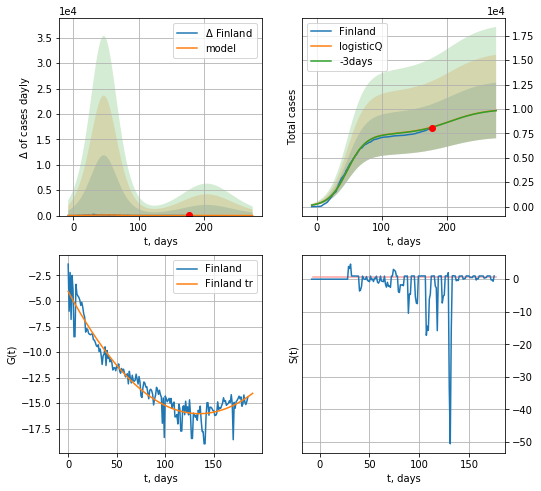

Finland data at: 2020-08-29
+3 day model MAPE: 0.002369
model: logisticQ
coeffs: [ 7.42083572e+03  1.53166318e-07  4.70211325e+01 -4.56101960e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289362
forecast at the end of period: +98 days
	 deltaDaycases: 6
	 total cases: 9849 ± 2849
	 total death: 408 ± 354
trend coefficient of determination: 0.920700
 intercept_: -4.072645358561605
 coeffs_: [ 0.         -0.17741707  0.00065749]


In [1909]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
168 2020-08-25  15589  4416.0  572.0
169 2020-08-26  15751  4415.0  586.0
170 2020-08-27  15908  4270.0  594.0
171 2020-08-28  16065  4231.0  603.0
172 2020-08-29  16164  4306.0  605.0


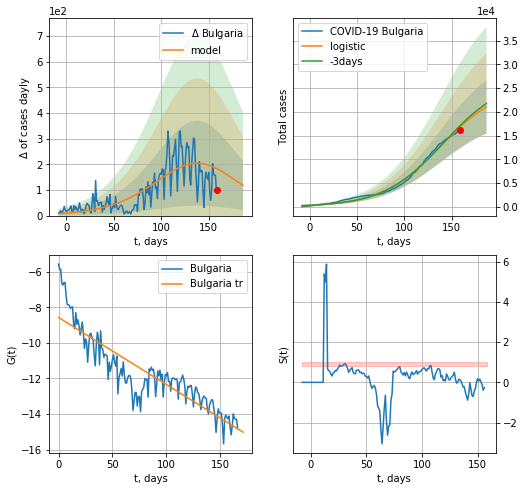

Bulgaria data at: 2020-08-29
+3 day model MAPE: 0.016231712735054787
model: logistic
coeffs:  [2.54480299e+04 3.21256674e-02 1.38154239e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.26672270152101873
forecast at the end of period: +28 days
	 deltaDaycases:  117
	 total cases:  21063 ± 5617
	 total death:  788 ± 630
trend coefficient of determination: 0.786248
 intercept: -8.565739
 slope: -0.037768


In [1910]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


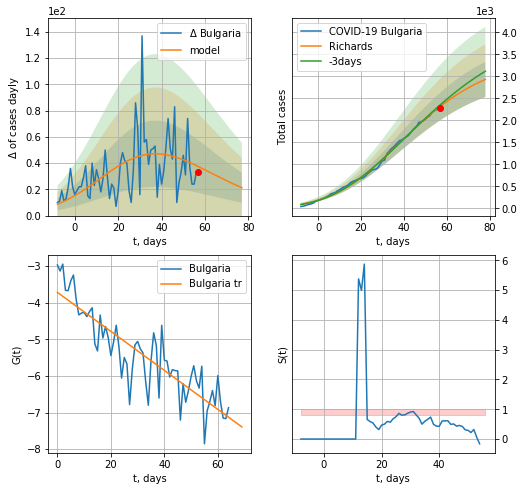

Bulgaria data at: 2020-08-29
+3 day model MAPE: 0.017233
model: Richards
coeffs: [3.47700846e+03 1.26494247e-01 1.24704401e+01 3.39632264e-01]
rational stdev: 0.135837
forecast at the end of period: +21 days
	 deltaDaycases: 21
	 total cases: 2929 ± 397
	 total death: 109 ± 44
trend coefficient of determination: 0.758376
 intercept: -3.716233
 slope: -0.053312


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


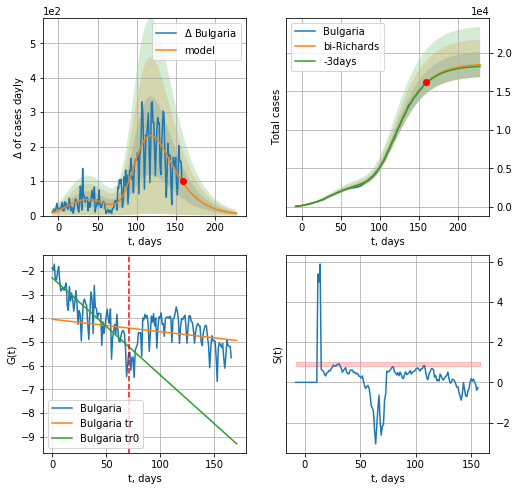

Bulgaria data at: 2020-08-29
+3 day model MAPE: 0.003908
model: bi-Richards
coeffs: [1.51512243e+04 7.20478074e-01 5.14899687e+01 5.84270969e-02]
rational stdev: 0.088368
forecast at the end of period: +70 days
	 deltaDaycases: 6
	 total cases: 18480 ± 1633
	 total death: 691 ± 183
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.696218
 intercept: -2.281465
 slope: -0.041057
trend coefficient of determination: 0.043452
 intercept: -4.037461
 slope: -0.005234


In [1911]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


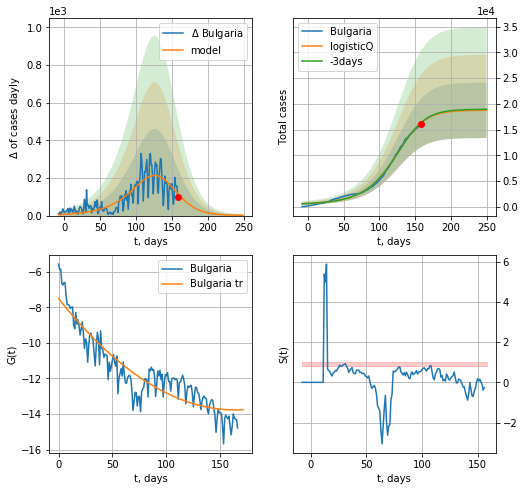

Bulgaria data at: 2020-08-29
+3 day model MAPE: 0.004366
model: logisticQ
coeffs: [ 1.86614400e+04  1.41950268e-04  1.20534602e+02 -1.95648628e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287424
forecast at the end of period: +91 days
	 deltaDaycases: 1
	 total cases: 18763 ± 5393
	 total death: 702 ± 605
trend coefficient of determination: 0.842027
 intercept_: -7.500757343354774
 coeffs_: [ 0.         -0.07649521  0.0002333 ]


In [1912]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
180 2020-08-25  3403.0   108.0   58.0
181 2020-08-26  3404.0   109.0   58.0
182 2020-08-27  3410.0   115.0   58.0
183 2020-08-28  3411.0   111.0   58.0
184 2020-08-29  3411.0   101.0   58.0
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


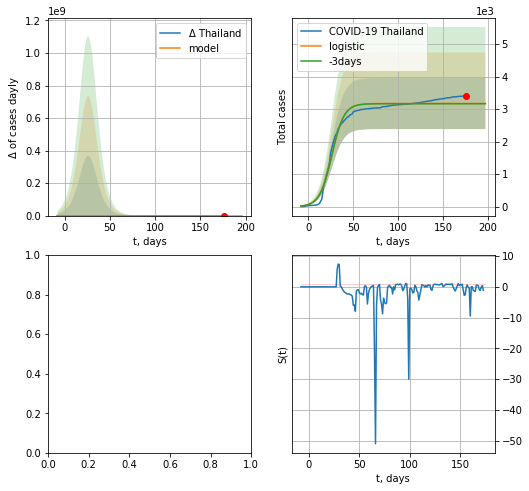

In [1913]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [1493]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

In [ ]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d12f(1),30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


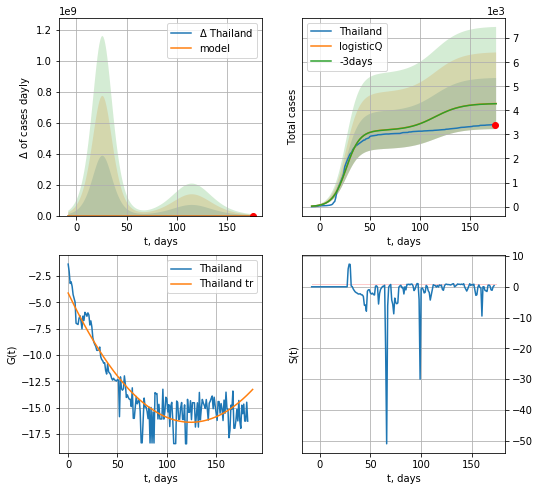

Thailand data at: 2020-08-28
+3 day model MAPE: 0.001811
model: logisticQ
coeffs: [ 3.17255616e+03  3.43926921e-07  2.64133913e+01 -4.28771780e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.247729
forecast at the end of period: +1 days
	 deltaDaycases: 0
	 total cases: 4284 ± 1061
	 total death: 72 ± 53
trend coefficient of determination: 0.857405
 intercept_: -4.127489999491068
 coeffs_: [ 0.         -0.19708699  0.00079262]


In [1495]:
x = forecastRRR("Thailand",dfTH[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


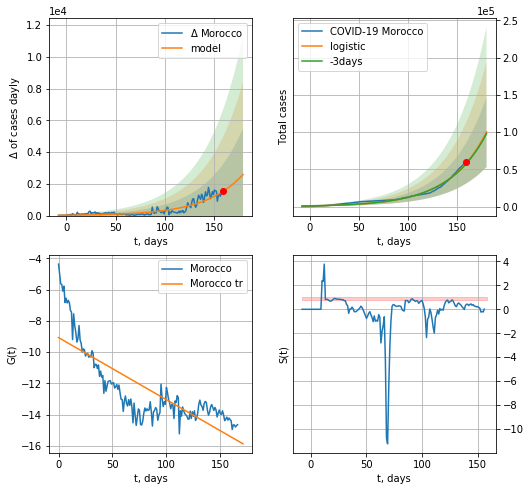

Morocco data at: 2020-08-29
+3 day model MAPE: 0.01554901995834424
model: logistic
coeffs:  [1.98813160e+08 2.61175153e-02 4.70662492e+02]
rational stdev:  0.46856280782534837
forecast at the end of period: +21 days
	 deltaDaycases:  2584
	 total cases:  100306 ± 47000
	 total death:  1800 ± 2530
trend coefficient of determination: 0.654614
 intercept: -9.070077
 slope: -0.039790


In [1915]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


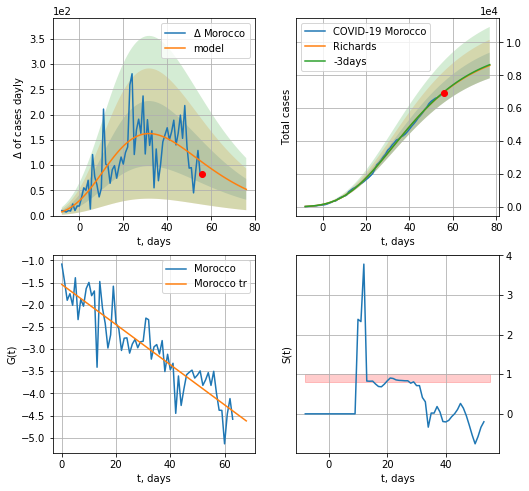

Morocco data at: 2020-08-29
+3 day model MAPE: 0.002854
model: Richards
coeffs: [ 9.80051535e+03  2.80051836e+00 -5.84633428e+01  1.62270604e-02]
rational stdev: 0.090760
forecast at the end of period: +21 days
	 deltaDaycases: 51
	 total cases: 8601 ± 780
	 total death: 154 ± 41
trend coefficient of determination: 0.815717
 intercept: -1.543258
 slope: -0.045268


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


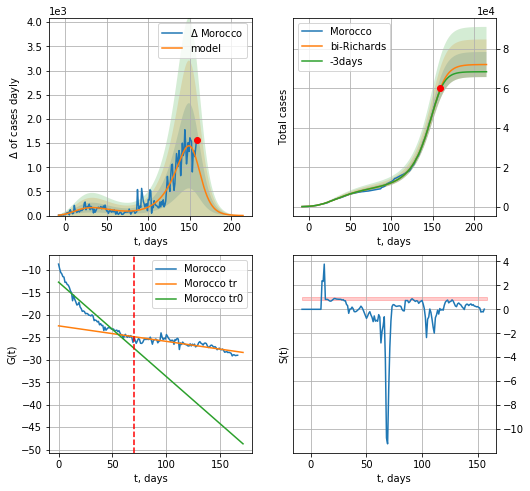

Morocco data at: 2020-08-29
+3 day model MAPE: 0.010485
model: bi-Richards
coeffs: [6.23648457e+04 5.57330129e-02 1.55879448e+02 2.30355239e+00]
rational stdev: 0.088240
forecast at the end of period: +56 days
	 deltaDaycases: 1
	 total cases: 72149 ± 6366
	 total death: 1295 ± 342
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.903669
 intercept: -12.717534
 slope: -0.210427
trend coefficient of determination: 0.709362
 intercept: -22.447522
 slope: -0.034589


In [1916]:
vL = 75 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


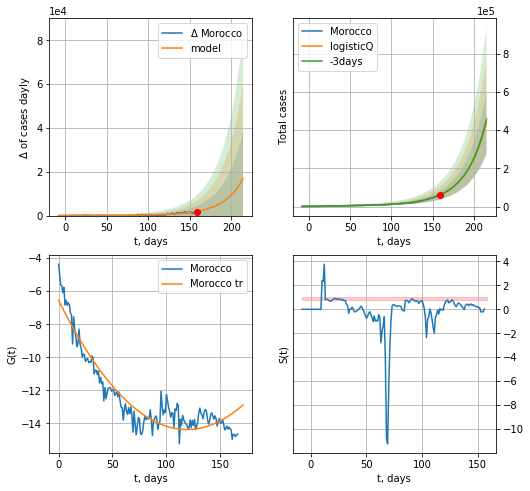

Morocco data at: 2020-08-29
+3 day model MAPE: 0.007781
model: logisticQ
coeffs: [ 4.51751094e+07  6.89507702e-05  3.14893517e+02 -4.55435012e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376333
forecast at the end of period: +56 days
	 deltaDaycases: 16850
	 total cases: 441729 ± 166237
	 total death: 7928 ± 8950
trend coefficient of determination: 0.888901
 intercept_: -6.5499259543485255
 coeffs_: [ 0.         -0.1314324   0.00055207]


In [1917]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases   active   death
181 2020-08-25  80390.0  41207.0  3367.0
182 2020-08-26  81646.0  41939.0  3421.0
183 2020-08-27  83150.0  43014.0  3459.0
184 2020-08-28  84468.0  43905.0  3507.0
185 2020-08-29  85833.0  44906.0  3539.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


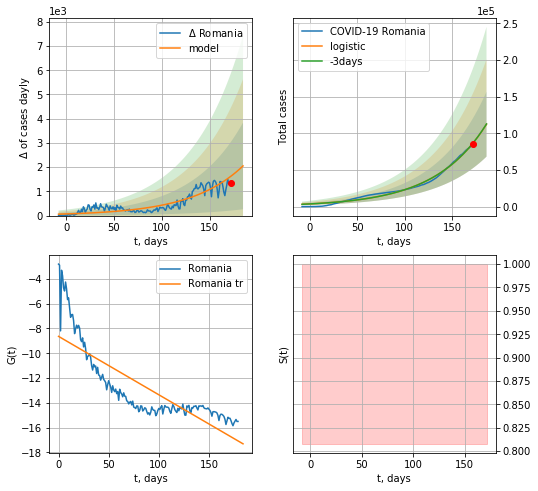

Romania data at: 2020-08-29
+3 day model MAPE: 0.002368480656239256
model: logistic
coeffs:  [5.63404866e+07 1.84514005e-02 5.22858572e+02]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.39356420620017313
forecast at the end of period: +14 days
	 deltaDaycases:  2050
	 total cases:  112411 ± 44241
	 total death:  4634 ± 5471
trend coefficient of determination: 0.669460
 intercept: -8.635596
 slope: -0.047135


In [1918]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


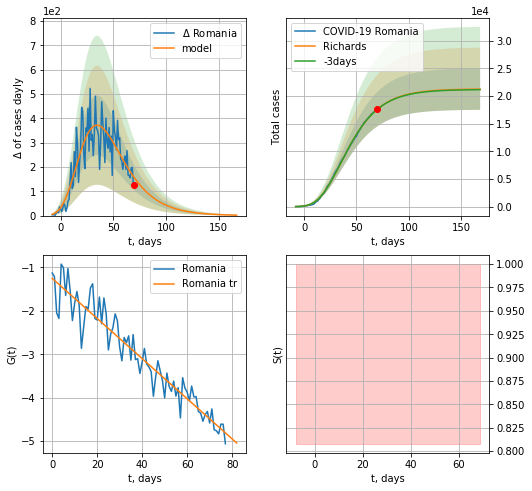

Romania data at: 2020-08-29
+3 day model MAPE: 0.002252
model: Richards
coeffs: [ 2.13019559e+04  3.77233819e+00 -5.65502366e+01  1.26521698e-02]
rational stdev: 0.176385
forecast at the end of period: +98 days
	 deltaDaycases: 1
	 total cases: 21264 ± 3750
	 total death: 876 ± 463
trend coefficient of determination: 0.908550
 intercept: -1.252366
 slope: -0.046196


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


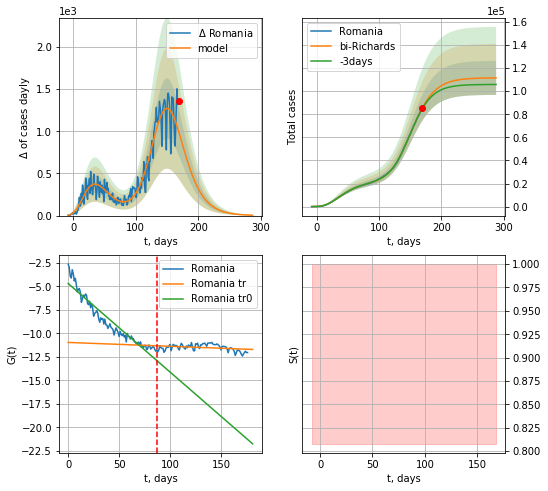

Romania data at: 2020-08-29
+3 day model MAPE: 0.008642
model: bi-Richards
coeffs: [9.03264376e+04 7.31300239e-02 1.43465862e+02 6.95203508e-01]
rational stdev: 0.132029
forecast at the end of period: +119 days
	 deltaDaycases: 4
	 total cases: 111544 ± 14727
	 total death: 4599 ± 1821
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.913809
 intercept: -4.692387
 slope: -0.094222
trend coefficient of determination: 0.095030
 intercept: -10.962321
 slope: -0.004111


In [1919]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,39*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


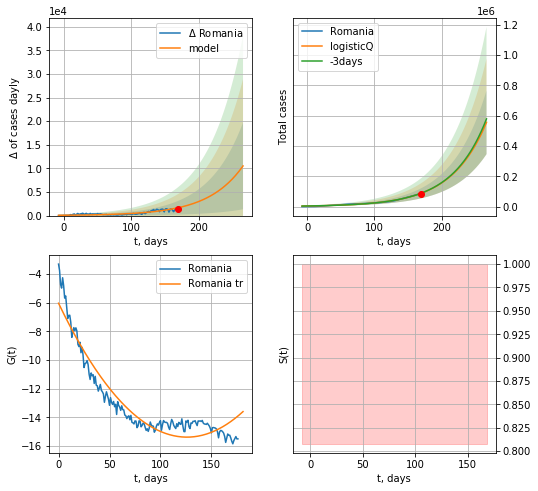

Romania data at: 2020-08-29
+3 day model MAPE: 0.005596
model: logisticQ
coeffs: [ 3.81105904e+07  3.12599001e-06  4.77421251e+02 -6.13607648e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377493
forecast at the end of period: +98 days
	 deltaDaycases: 10515
	 total cases: 556548 ± 210093
	 total death: 22947 ± 25986
trend coefficient of determination: 0.908493
 intercept_: -6.03159274479481
 coeffs_: [ 0.         -0.14842094  0.00058902]


In [1920]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1921]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
199 2020-08-25  1769246  327959  139414.0
200 2020-08-26  1787359  333233  139470.0
201 2020-08-27  1823532  343412  139624.0
202 2020-08-28  1842128  353552  139754.0
203 2020-08-29  1856497  362382  139833.0


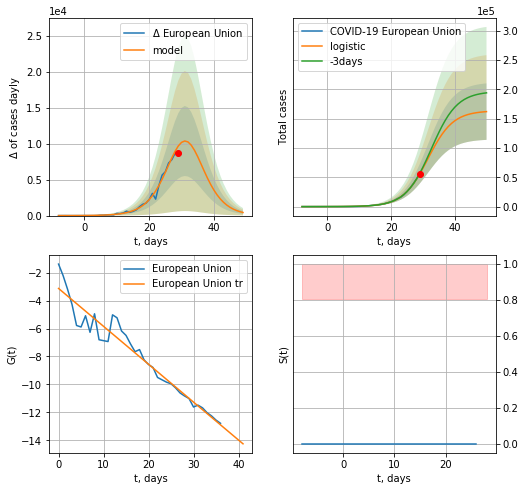

European Union data at: 2020-08-29
+3 day model MAPE: 0.026430260679971996
model: logistic
coeffs:  [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.29731227366451135
forecast at the end of period: +21 days
	 deltaDaycases:  431
	 total cases:  162048 ± 48179
	 total death:  12205 ± 10886
trend coefficient of determination: 0.939076
 intercept: -3.128192
 slope: -0.271364


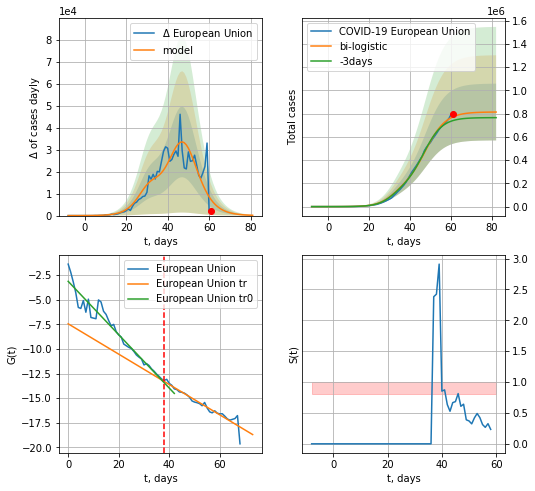

European Union data at: 2020-08-29
+3 day model MAPE: 0.04651915802684479
model: bi-logistic
coeffs:  [6.50647976e+05 2.01824362e-01 4.76677897e+01] [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.30016662391822424
forecast at the end of period: +21 days
	 deltaDaycases:  142
	 total cases:  813568 ± 244206
	 total death:  61278 ± 55180
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend coefficient of determination: 0.919558
 intercept: -7.446330
 slope: -0.154010


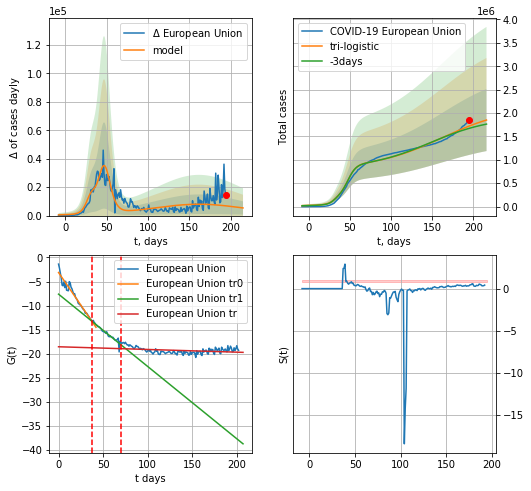

European Union data at: 2020-08-29
+3 day model MAPE: 0.030196775534116736
model: tri-logistic
coeffs:  [1.31601897e+06 2.43000592e-02 1.62052357e+02] [1.63557146e+05 2.54069754e-01 3.15927312e+01 6.50647976e+05
 2.01824362e-01 4.76677897e+01]
forecast rational stdev:  0.35850552756427845
forecast at the end of period: +21 days
	 deltaDaycases:  5385
	 total cases:  1850792 ± 663519
	 total death:  139403 ± 149930
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend1 coefficient of determination: 0.917496
 intercept: -7.627918
 slope: -0.150227
trend coefficient of determination: 0.109275
 intercept: -18.559104
 slope: -0.005614


In [1922]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


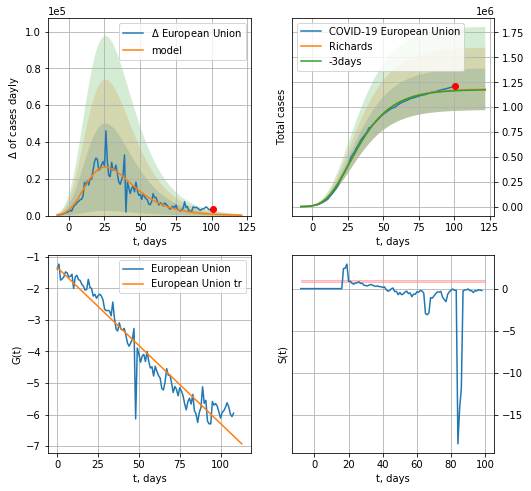

European Union data at: 2020-08-29
+3 day model MAPE: 0.004510
model: Richards
coeffs: [ 1.18204696e+06  8.96706485e+00 -5.59023207e+01  6.77910245e-03]
rational stdev: 0.177380
forecast at the end of period: +21 days
	 deltaDaycases: 219
	 total cases: 1178546 ± 209050
	 total death: 88769 ± 47237
trend coefficient of determination: 0.933679
 intercept: -1.341249
 slope: -0.049432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


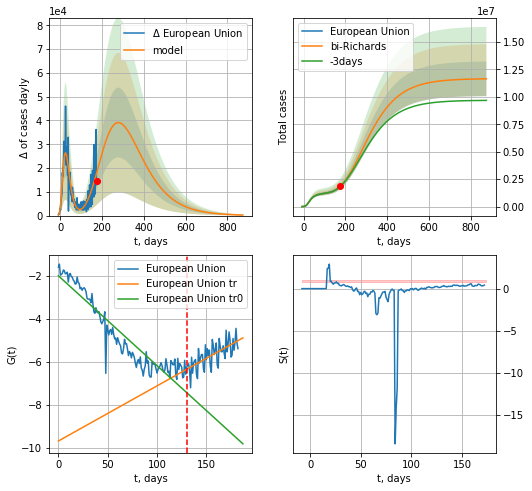

European Union data at: 2020-08-29
+3 day model MAPE: 0.007695
model: bi-Richards
coeffs: [ 1.04879323e+07  2.78328648e-01 -4.02171336e+01  3.71014029e-02]
rational stdev: 0.135474
forecast at the end of period: +700 days
	 deltaDaycases: 230
	 total cases: 11647779 ± 1577974
	 total death: 877321 ± 356563
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.881526
 intercept: -2.007721
 slope: -0.041814
trend coefficient of determination: 0.449963
 intercept: -9.695059
 slope: 0.025659


In [1923]:
vL = 130+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,122*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


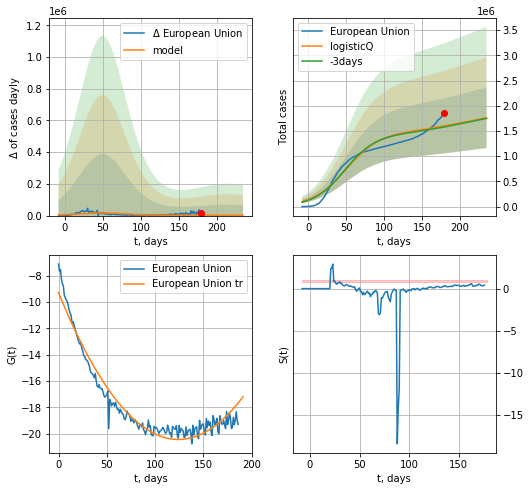

European Union data at: 2020-08-29
+3 day model MAPE: 0.014040
model: logisticQ
coeffs: [ 1.45405509e+06  3.01578124e-08  4.98388632e+01 -1.50893169e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.340694
forecast at the end of period: +56 days
	 deltaDaycases: 2850
	 total cases: 1762905 ± 600611
	 total death: 132783 ± 135715
trend coefficient of determination: 0.950118
 intercept_: -9.279439104770649
 coeffs_: [ 0.         -0.18007597  0.00072552]


In [1924]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1925]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [1926]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [1927]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [1928]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [1929]:
#dfIC[:]

IC
           date   cases  active  death
177 2020-08-25  2077.0     114   10.0
178 2020-08-26  2082.0     115   10.0
179 2020-08-27  2087.0     113   10.0
180 2020-08-28  2092.0     118   10.0
181 2020-08-29  2100.0     111   10.0


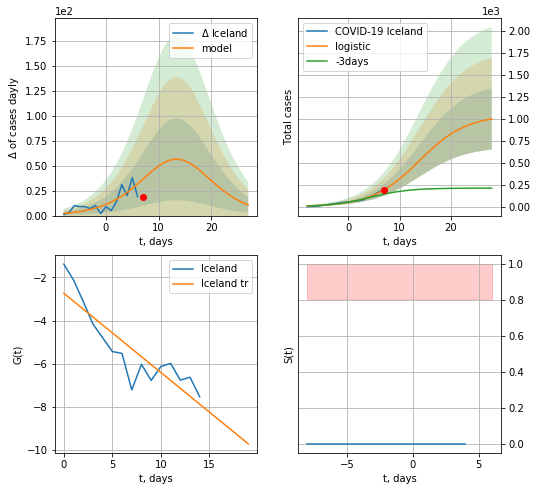

Iceland data at: 2020-08-29
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +21 days
	 deltaDaycases:  10
	 total cases:  996 ± 348
	 total death:  4 ± 4
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


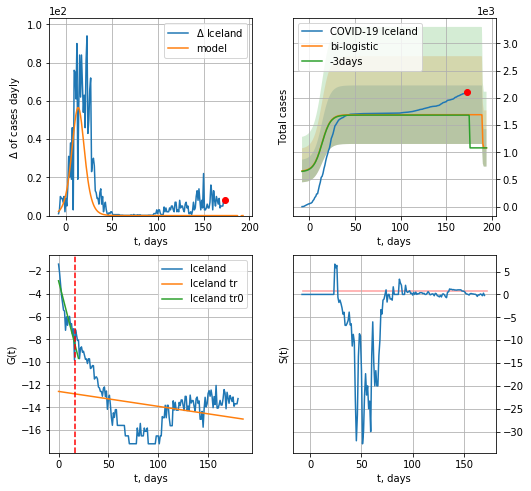

Iceland data at: 2020-08-29
+3 day model MAPE: 0.004664628247203618
model: bi-logistic
coeffs:  [609.41545758  -7.23465373 189.74070312] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3181571132131828
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1080 ± 343
	 total death:  5 ± 4
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.075243
 intercept: -12.588030
 slope: -0.013146


In [1930]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


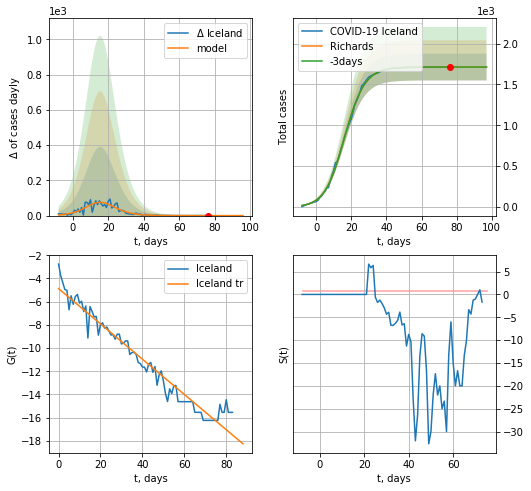

Iceland data at: 2020-08-29
+3 day model MAPE: 0.000010
model: Richards
coeffs: [1.71330052e+03 1.94502632e-01 1.51528095e+01 8.70905557e-01]
rational stdev: 0.095562
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1713 ± 163
	 total death: 8 ± 2
trend coefficient of determination: 0.952024
 intercept: -4.875300
 slope: -0.151986


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


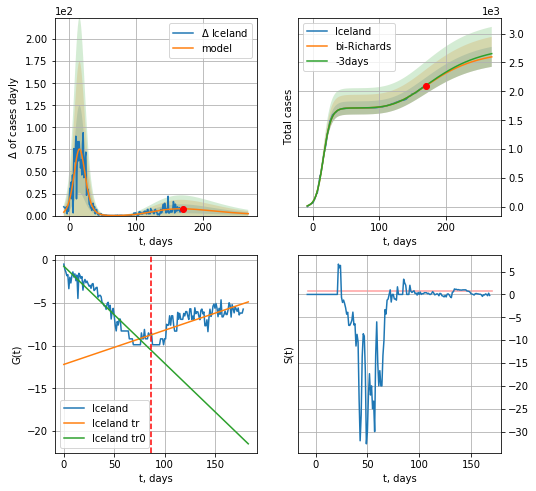

Iceland data at: 2020-08-29
+3 day model MAPE: 0.002122
model: bi-Richards
coeffs: [ 9.92131425e+02  1.01101153e+00 -1.21286212e+01  2.11779141e-02]
rational stdev: 0.066499
forecast at the end of period: +98 days
	 deltaDaycases: 2
	 total cases: 2597 ± 172
	 total death: 12 ± 2
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.916748
 intercept: -0.706863
 slope: -0.113678
trend coefficient of determination: 0.575345
 intercept: -12.212557
 slope: 0.040016


In [1931]:
vL = 87+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


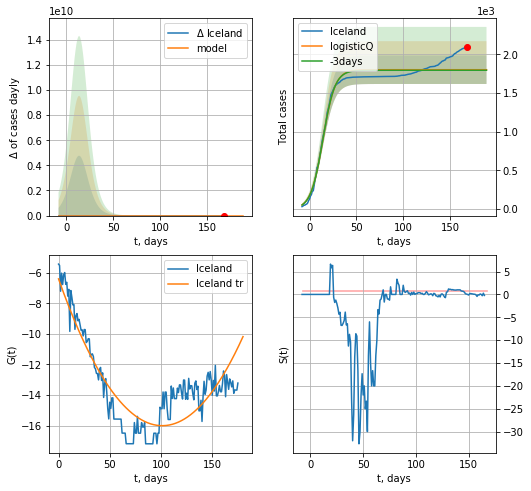

Iceland data at: 2020-08-29
+3 day model MAPE: 0.003868
model: logisticQ
coeffs: [ 1.80288361e+03  5.68003295e-07  1.43002737e+01 -2.72664927e+05]
rational stdev: 0.102332
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1802 ± 184
	 total death: 8 ± 2
trend coefficient of determination: 0.786692
 intercept_: -6.4014338720977495
 coeffs_: [ 0.         -0.18996643  0.00093878]


In [1932]:
x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active   death
168 2020-08-25  88381  23703.0  1919.0
169 2020-08-26  89082  23555.0  1932.0
170 2020-08-27  89982  24038.0  1948.0
171 2020-08-28  90624  24056.0  1966.0
172 2020-08-29  91337  24235.0  1983.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


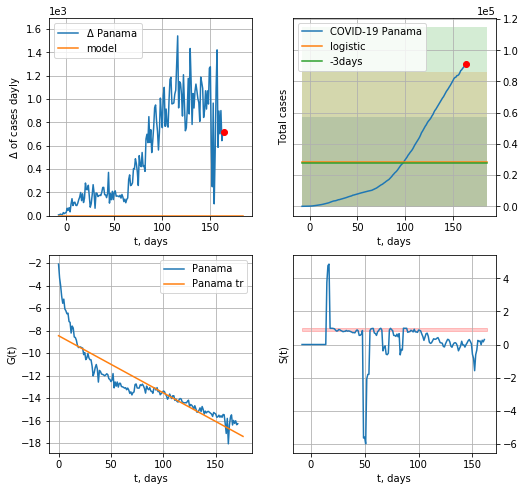

Panama data at: 2020-08-29
+3 day model MAPE: 0.039807764332876916
model: logistic
coeffs:  [ 2.86007689e+04 -2.43942213e+01  6.03732400e+02]
rational stdev:  1.0067003560939618
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  28600 ± 28792
	 total death:  620 ± 1872
trend coefficient of determination: 0.802941
 intercept: -8.459141
 slope: -0.050786


In [1933]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


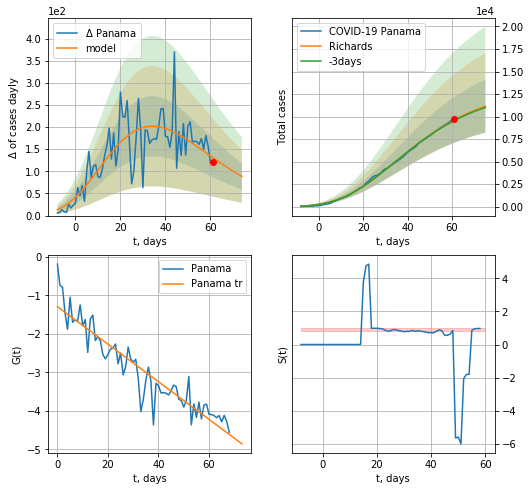

Panama data at: 2020-08-29
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +14 days
	 deltaDaycases: 88
	 total cases: 11151 ± 2934
	 total death: 242 ± 191
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


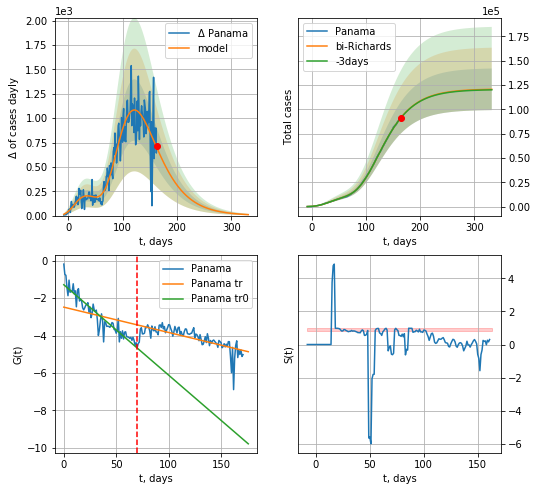

Panama data at: 2020-08-29
+3 day model MAPE: 0.001524
model: bi-Richards
coeffs: [ 1.07432152e+05  1.85491167e+00 -3.18180278e+01  1.47013801e-02]
rational stdev: 0.177308
forecast at the end of period: +168 days
	 deltaDaycases: 9
	 total cases: 120562 ± 21376
	 total death: 2617 ± 1392
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874101
 intercept: -1.284739
 slope: -0.048289
trend coefficient of determination: 0.505380
 intercept: -2.481816
 slope: -0.013529


In [1934]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


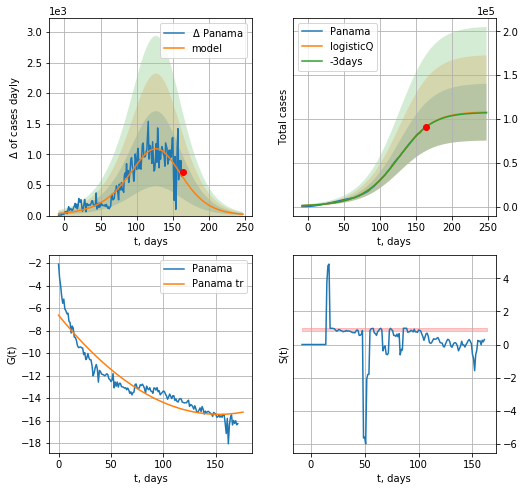

Panama data at: 2020-08-29
+3 day model MAPE: 0.002422
model: logisticQ
coeffs: [ 1.07901160e+05  4.63818249e-05  1.24262300e+02 -7.45439573e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300658
forecast at the end of period: +84 days
	 deltaDaycases: 22
	 total cases: 107752 ± 32396
	 total death: 2339 ± 2109
trend coefficient of determination: 0.889849
 intercept_: -6.6363544587093815
 coeffs_: [ 0.         -0.11511978  0.00037622]


In [1935]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


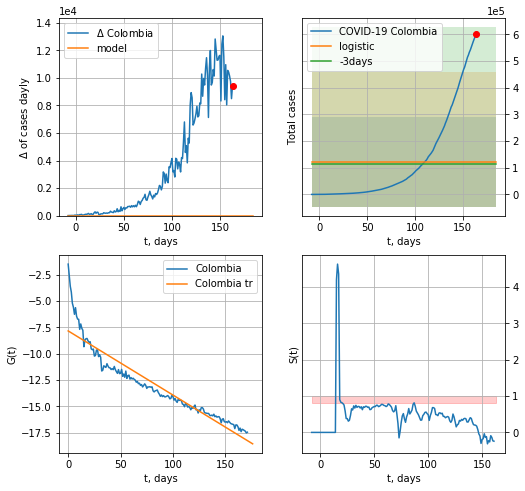

Colombia data at: 2020-08-29
+3 day model MAPE: 0.0722241063831276
model: logistic
coeffs:  [ 1.22652353e+05 -9.32306940e+00  2.32112339e+02]
rational stdev:  1.372469605770831
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  122652 ± 168336
	 total death:  3897 ± 16045
trend coefficient of determination: 0.880599
 intercept: -7.846410
 slope: -0.060901


In [1936]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

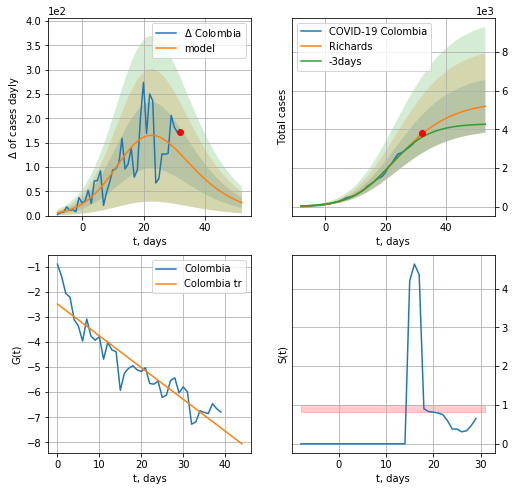

Colombia data at: 2020-08-29
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +21 days
	 deltaDaycases: 26
	 total cases: 5189 ± 1368
	 total death: 164 ± 129
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


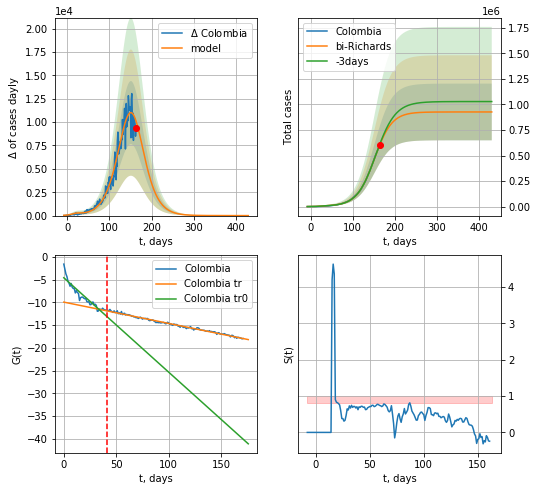

Colombia data at: 2020-08-29
+3 day model MAPE: 0.010288
model: bi-Richards
coeffs: [9.21167305e+05 4.66850983e-02 1.52127432e+02 1.03645328e+00]
rational stdev: 0.299515
forecast at the end of period: +266 days
	 deltaDaycases: 0
	 total cases: 926619 ± 277536
	 total death: 29446 ± 26458
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.884710
 intercept: -4.548052
 slope: -0.207939
trend coefficient of determination: 0.990460
 intercept: -9.919078
 slope: -0.046918


In [1938]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


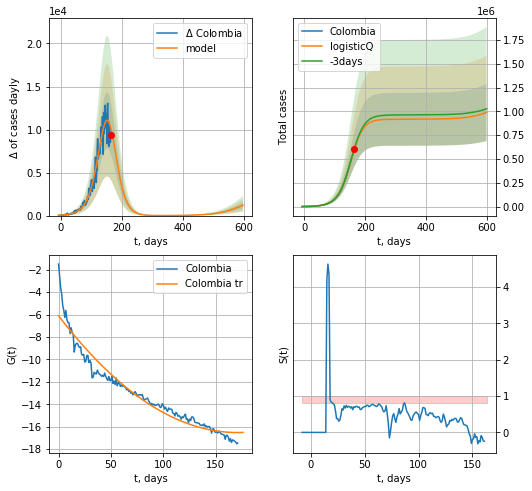

Colombia data at: 2020-08-29
+3 day model MAPE: 0.007921
model: logisticQ
coeffs: [ 9.16982385e+05  4.07036906e-05  1.50445328e+02 -1.03530649e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302845
forecast at the end of period: +434 days
	 deltaDaycases: 1209
	 total cases: 988712 ± 299426
	 total death: 31419 ± 28545
trend coefficient of determination: 0.940752
 intercept_: -6.10994034690019
 coeffs_: [ 0.         -0.12218882  0.00035841]


In [1939]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
174 2020-08-25  42228.0  11185.0  1456.0
175 2020-08-26  42619.0  11268.0  1465.0
176 2020-08-27  43016.0  11384.0  1475.0
177 2020-08-28  43403.0  11484.0  1483.0
178 2020-08-29  43781.0  11573.0  1491.0


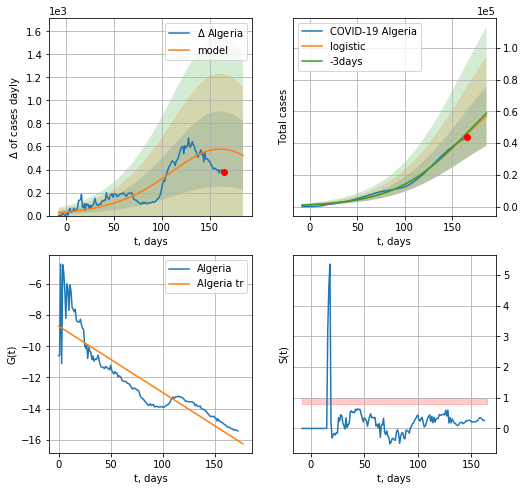

Algeria data at: 2020-08-29
+3 day model MAPE: 0.01587155038761694
model: logistic
coeffs:  [8.68138196e+04 2.66463031e-02 1.61452901e+02]
rational stdev:  0.32711064618724905
forecast at the end of period: +21 days
	 deltaDaycases:  522
	 total cases:  57117 ± 18683
	 total death:  1945 ± 1908
trend coefficient of determination: 0.794900
 intercept: -8.706322
 slope: -0.042681


In [1940]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

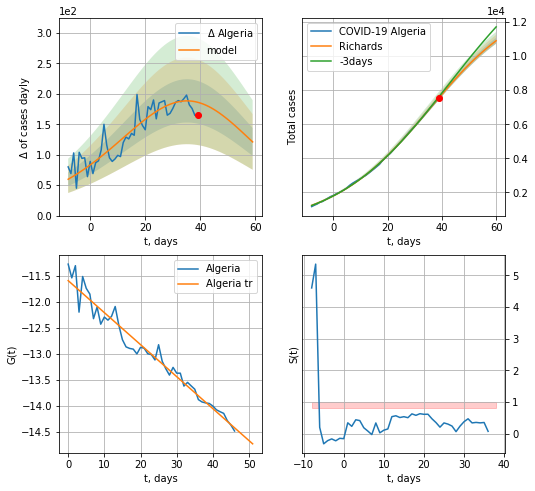

Algeria data at: 2020-08-29
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014715e+04 4.98947140e-02 3.86388173e+01 1.19488229e+00]
rational stdev: 0.015787
forecast at the end of period: +21 days
	 deltaDaycases: 121
	 total cases: 10901 ± 172
	 total death: 371 ± 17
trend coefficient of determination: 0.959635
 intercept: -11.589811
 slope: -0.061720


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


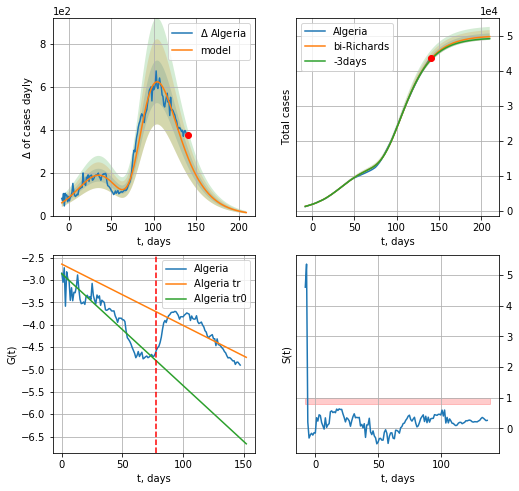

Algeria data at: 2020-08-29
+3 day model MAPE: 0.005032
model: bi-Richards
coeffs: [3.66919786e+04 3.22729704e+00 1.19303692e+01 1.41454792e-02]
rational stdev: 0.018552
forecast at the end of period: +70 days
	 deltaDaycases: 14
	 total cases: 49787 ± 923
	 total death: 1695 ± 94
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.888879
 intercept: -2.862066
 slope: -0.025003
trend coefficient of determination: 0.515170
 intercept: -2.647405
 slope: -0.013702


In [1941]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


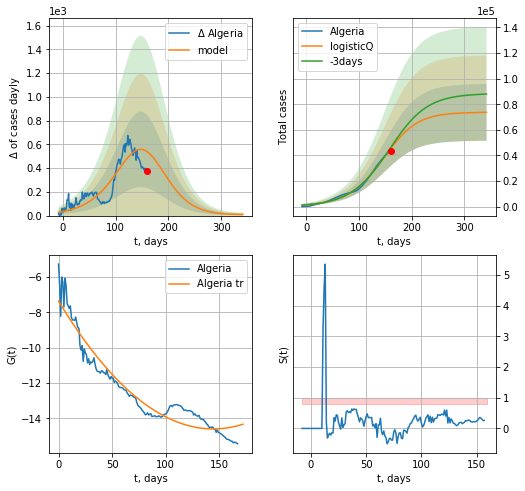

Algeria data at: 2020-08-29
+3 day model MAPE: 0.019479
model: logisticQ
coeffs: [ 7.33107712e+04  2.42637123e-05  1.44495889e+02 -1.10591159e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301355
forecast at the end of period: +182 days
	 deltaDaycases: 9
	 total cases: 73731 ± 22219
	 total death: 2510 ± 2269
trend coefficient of determination: 0.922110
 intercept_: -7.362903339260477
 coeffs_: [ 0.         -0.10030486  0.0003477 ]


In [1942]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active   death
169 2020-08-25  160165  37812.0  6944.0
170 2020-08-26  162884  37245.0  7064.0
171 2020-08-27  165887  37818.0  7169.0
172 2020-08-28  169195  39132.0  7261.0
173 2020-08-29  172053  40525.0  7343.0


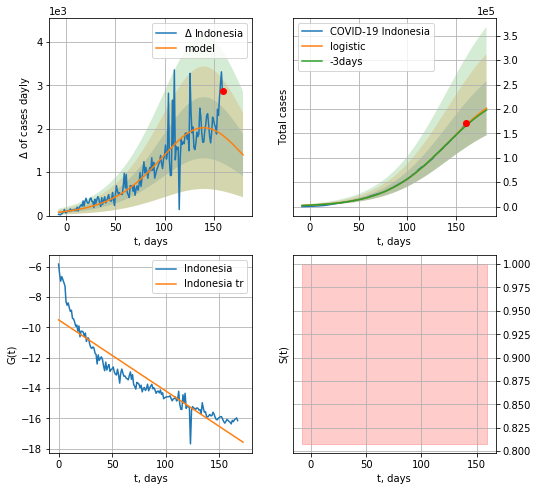

Indonesia data at: 2020-08-29
+3 day model MAPE: 0.010832059507346798
model: logistic
coeffs:  [2.58097861e+05 3.13429518e-02 1.40490707e+02]
rational stdev:  0.2753203804289558
forecast at the end of period: +21 days
	 deltaDaycases:  1397
	 total cases:  201493 ± 55475
	 total death:  8647 ± 7142
trend coefficient of determination: 0.861376
 intercept: -9.507577
 slope: -0.046895


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


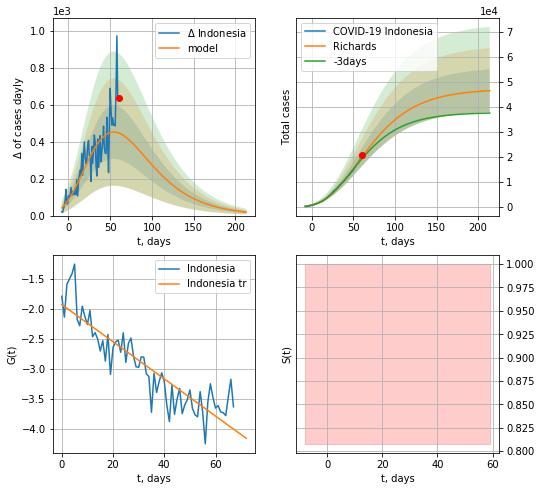

Indonesia data at: 2020-08-29
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +154 days
	 deltaDaycases: 18
	 total cases: 46414 ± 8490
	 total death: 1991 ± 1092
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


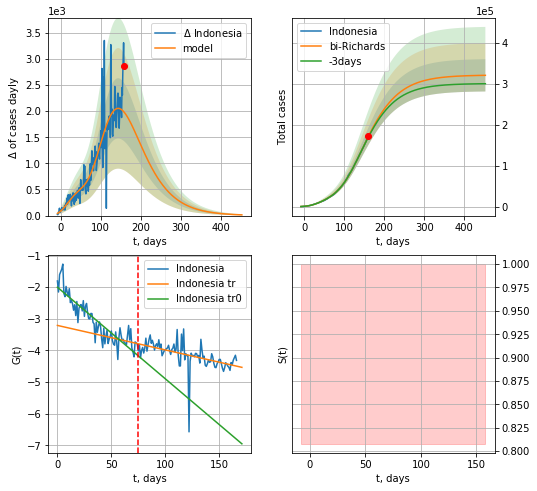

Indonesia data at: 2020-08-29
+3 day model MAPE: 0.010082
model: bi-Richards
coeffs: [ 2.73870790e+05  1.07734518e+00 -5.80632277e+01  1.81205258e-02]
rational stdev: 0.122882
forecast at the end of period: +294 days
	 deltaDaycases: 13
	 total cases: 320292 ± 39358
	 total death: 13745 ± 5067
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.798871
 intercept: -2.002020
 slope: -0.028959
trend coefficient of determination: 0.280657
 intercept: -3.209816
 slope: -0.007753


In [1944]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d1,64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


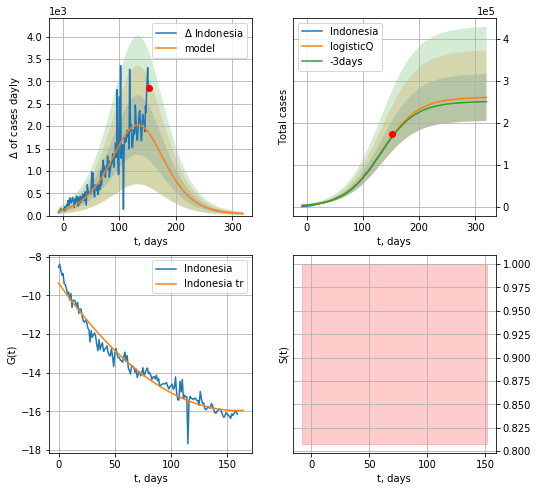

Indonesia data at: 2020-08-29
+3 day model MAPE: 0.010715
model: logisticQ
coeffs: [ 2.59144828e+05  7.90122567e-07  1.32769119e+02 -3.94556003e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214922
forecast at the end of period: +168 days
	 deltaDaycases: 46
	 total cases: 259983 ± 55876
	 total death: 11157 ± 7193
trend coefficient of determination: 0.961624
 intercept_: -9.368270039392153
 coeffs_: [ 0.         -0.08259679  0.00025867]


In [1945]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date   cases   active   death
171 2020-08-25  202361  65764.0  3137.0
172 2020-08-26  205581  68357.0  3234.0
173 2020-08-27  209544  71835.0  3235.0
174 2020-08-28  213131  74611.0  3419.0
175 2020-08-29  217396  56473.0  3520.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


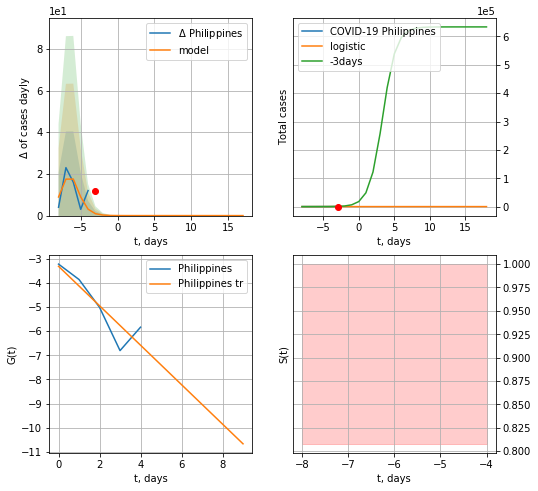

Philippines data at: 2020-08-29
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  0 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


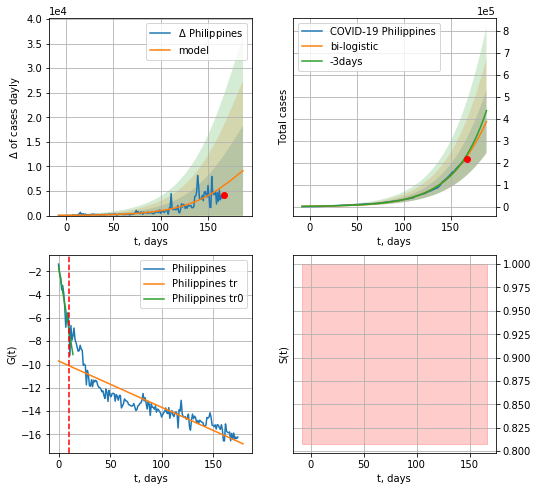

Philippines data at: 2020-08-29
+3 day model MAPE: 0.036378187320163624
model: bi-logistic
coeffs:  [1.63090684e+06 3.12048301e-02 2.25384759e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.37068413527657434
forecast at the end of period: +21 days
	 deltaDaycases:  9139
	 total cases:  387357 ± 143587
	 total death:  6271 ± 6973
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.797388
 intercept: -9.700266
 slope: -0.039681


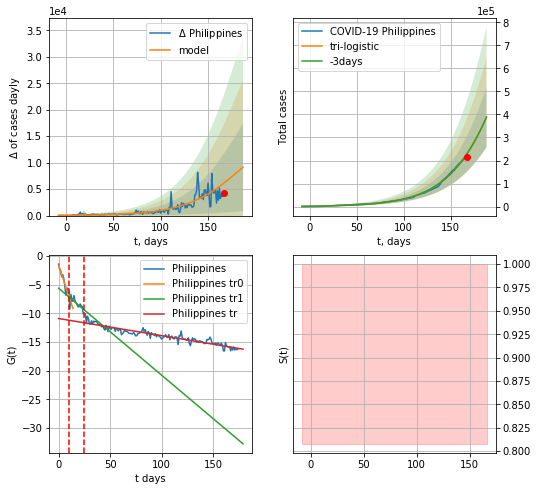

Philippines data at: 2020-08-29
+3 day model MAPE: 0.0007496056921012254
model: tri-logistic
coeffs:  [586.0752042    1.84646675  19.13147274] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.63090684e+06
  3.12048301e-02  2.25384759e+02]
forecast rational stdev:  0.3367286197111564
forecast at the end of period: +21 days
	 deltaDaycases:  9139
	 total cases:  387943 ± 130631
	 total death:  6281 ± 6344
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.884191
 intercept: -10.890572
 slope: -0.029922


In [1946]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

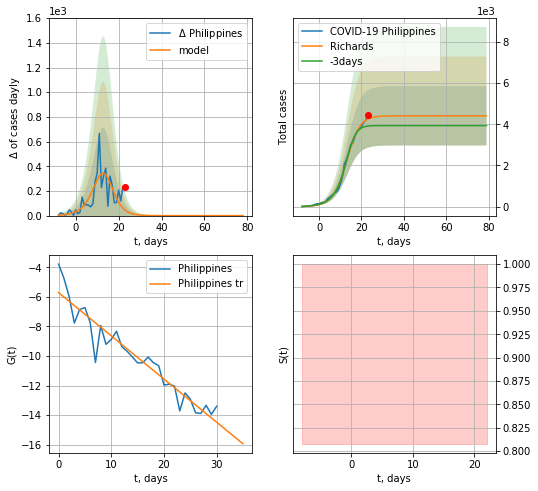

Philippines data at: 2020-08-29
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 71 ± 69
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


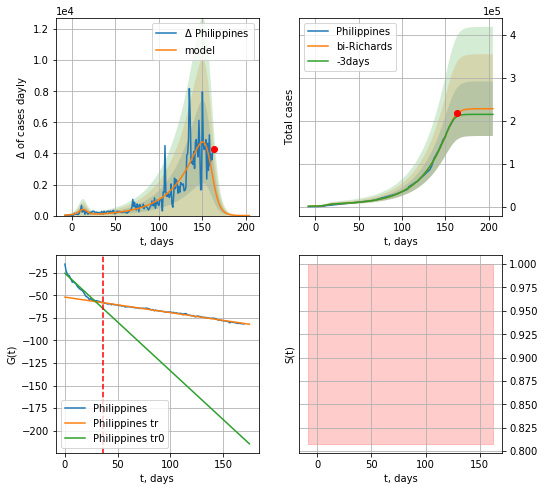

Philippines data at: 2020-08-29
+3 day model MAPE: 0.029940
model: bi-Richards
coeffs: [2.23780878e+05 3.36391564e-02 1.59500000e+02 6.31717527e+00]
rational stdev: 0.278578
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 228186 ± 63567
	 total death: 3694 ± 3087
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.929942
 intercept: -25.623991
 slope: -1.078863
trend coefficient of determination: 0.993618
 intercept: -51.993715
 slope: -0.171776


In [1947]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


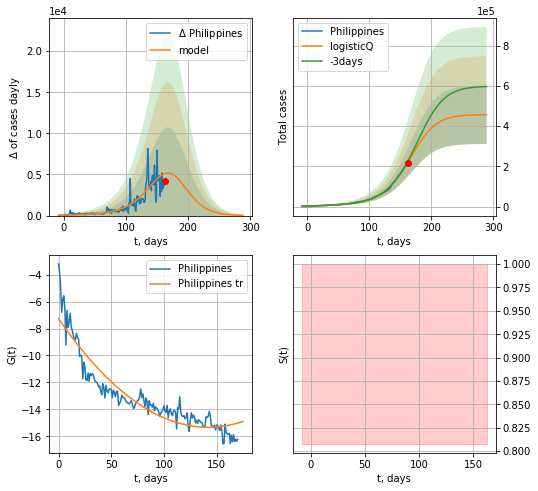

Philippines data at: 2020-08-29
+3 day model MAPE: 0.029033
model: logisticQ
coeffs: [ 4.56767922e+05  9.36856977e-05  1.63970987e+02 -3.16784244e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318427
forecast at the end of period: +126 days
	 deltaDaycases: 29
	 total cases: 456597 ± 145392
	 total death: 7393 ± 7062
trend coefficient of determination: 0.866020
 intercept_: -7.278362435279561
 coeffs_: [ 0.         -0.11337432  0.00039905]


In [1948]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
178 2020-08-25  8987.0    4940  243.0
179 2020-08-26  9280.0    5228  248.0
180 2020-08-27  9531.0    5473  254.0
181 2020-08-28  9800.0    5737  259.0
182 2020-08-29  9977.0    5913  260.0


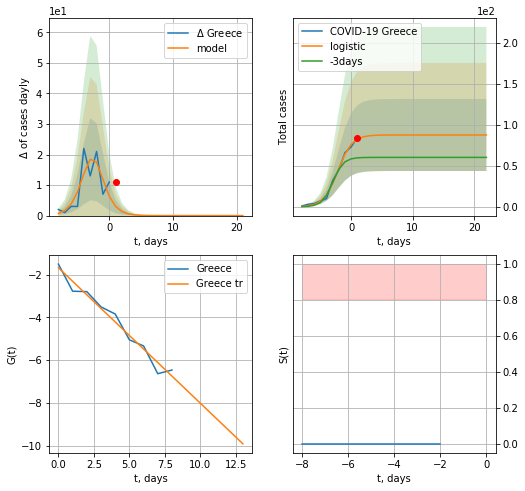

Greece data at: 2020-08-29
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  2 ± 3
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


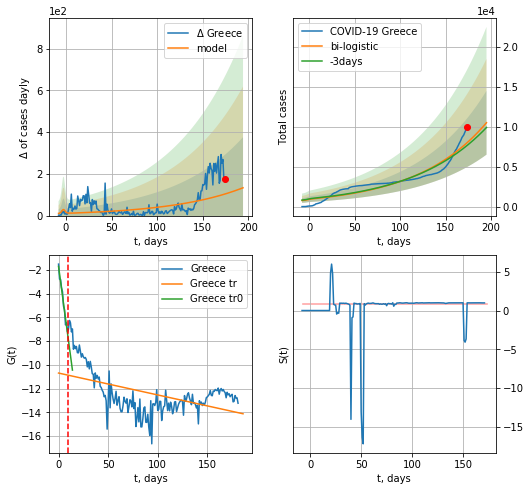

Greece data at: 2020-08-29
+3 day model MAPE: 0.04629344615474684
model: bi-logistic
coeffs:  [2.63011485e+07 1.28781346e-02 8.03181737e+02] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.3805414064138244
forecast at the end of period: +21 days
	 deltaDaycases:  133
	 total cases:  10517 ± 4002
	 total death:  274 ± 312
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.253796
 intercept: -10.695004
 slope: -0.018458


In [1949]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


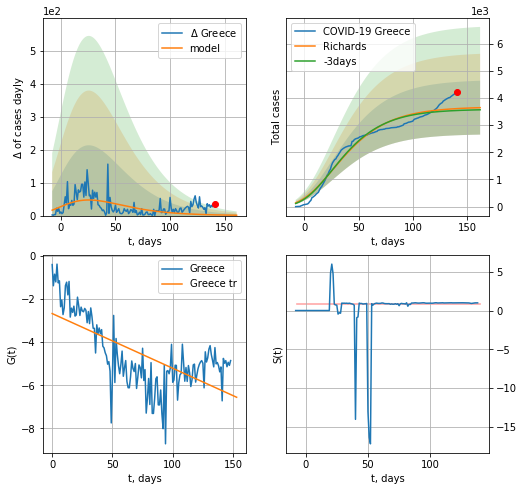

Greece data at: 2020-08-29
+3 day model MAPE: 0.019952
model: Richards
coeffs: [ 3.67300317e+03  8.86166446e+00 -1.31342745e+02  3.96579151e-03]
rational stdev: 0.271998
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 3642 ± 990
	 total death: 94 ± 76
trend coefficient of determination: 0.441158
 intercept: -2.678204
 slope: -0.025333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


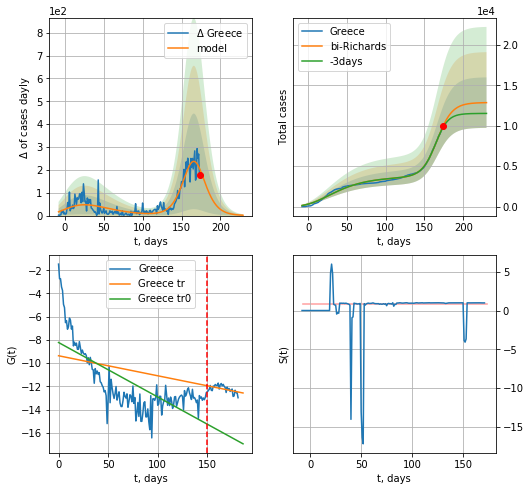

Greece data at: 2020-08-29
+3 day model MAPE: 0.020103
model: bi-Richards
coeffs: [9.19190686e+03 1.04963971e-01 1.65998440e+02 9.71438014e-01]
rational stdev: 0.242778
forecast at the end of period: +56 days
	 deltaDaycases: 1
	 total cases: 12848 ± 3119
	 total death: 334 ± 243
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.534180
 intercept: -8.221432
 slope: -0.046893
trend coefficient of determination: 0.246575
 intercept: -9.361966
 slope: -0.017233


In [1950]:
iL = 0
vL = 150+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


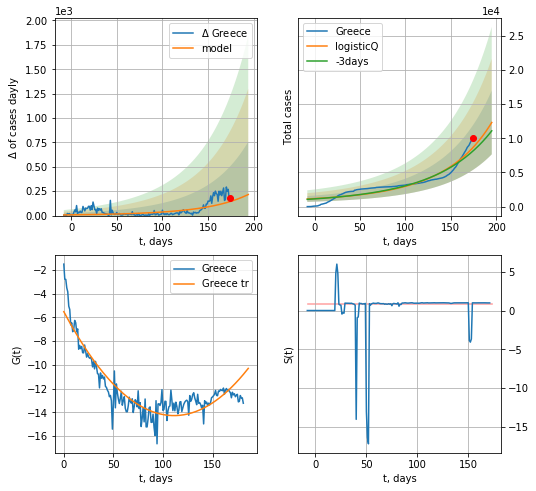

Greece data at: 2020-08-29
+3 day model MAPE: 0.064055
model: logisticQ
coeffs: [ 1.45185875e+07  2.91660758e-05  4.69606757e+02 -6.87835107e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378461
forecast at the end of period: +21 days
	 deltaDaycases: 216
	 total cases: 12323 ± 4664
	 total death: 321 ± 364
trend coefficient of determination: 0.825961
 intercept_: -5.514225989060148
 coeffs_: [ 0.         -0.15783451  0.00071021]


In [1952]:
x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
172 2020-08-25  5288.0     940  614.0
173 2020-08-26  5379.0    1008  614.0
174 2020-08-27  5511.0    1138  614.0
175 2020-08-28  5669.0    1296  614.0
176 2020-08-29  5961.0    1588  614.0


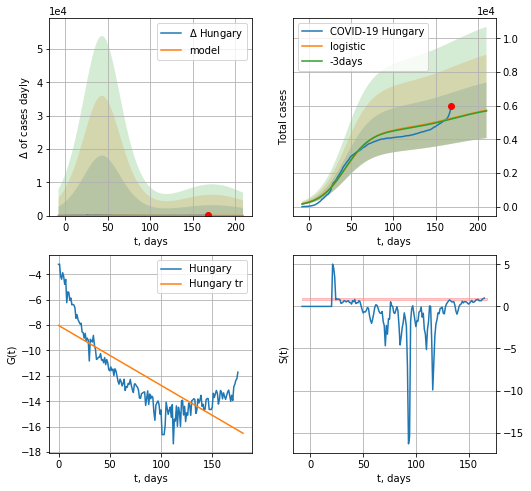

Hungary data at: 2020-08-29
+3 day model MAPE: 0.006963647093747278
model: logistic
coeffs:  [4.52739948e+03 6.34747022e-02 4.34555775e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.28840807740700547
forecast at the end of period: +42 days
	 deltaDaycases:  9
	 total cases:  5730 ± 1652
	 total death:  590 ± 510
trend coefficient of determination: 0.614778
 intercept: -8.026504
 slope: -0.047170


In [1953]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


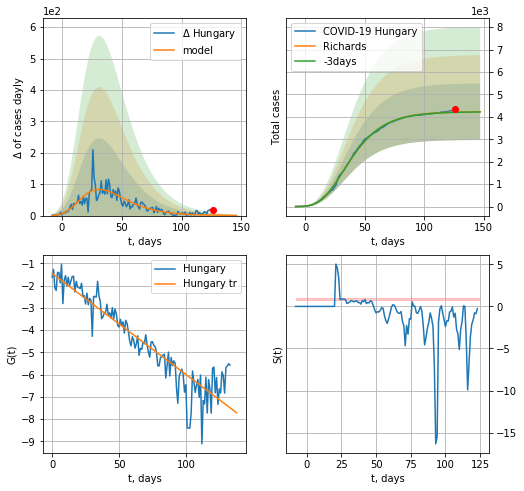

Hungary data at: 2020-08-29
+3 day model MAPE: 0.002387
model: Richards
coeffs: [ 4.23828265e+03  5.38358230e+00 -5.39211621e+01  9.98607004e-03]
rational stdev: 0.297967
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 4229 ± 1260
	 total death: 435 ± 388
trend coefficient of determination: 0.854867
 intercept: -1.456286
 slope: -0.045321


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


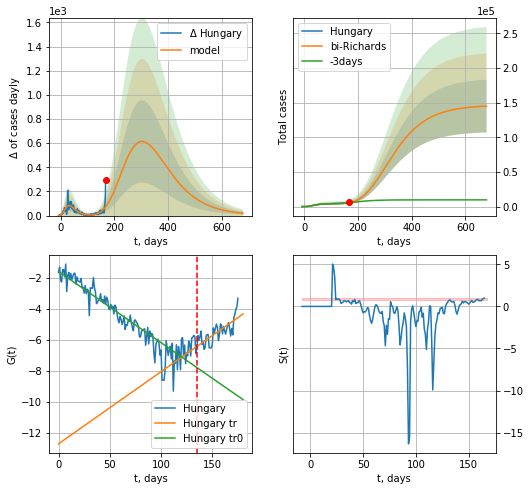

Hungary data at: 2020-08-29
+3 day model MAPE: 0.044913
model: bi-Richards
coeffs: [1.42457950e+05 3.33363370e-01 2.38752894e+01 3.58037807e-02]
rational stdev: 0.262337
forecast at the end of period: +511 days
	 deltaDaycases: 18
	 total cases: 145106 ± 38066
	 total death: 14946 ± 11762
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.858558
 intercept: -1.597570
 slope: -0.045922
trend coefficient of determination: 0.548269
 intercept: -12.715366
 slope: 0.046524


In [1962]:
vL = 135
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,95*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


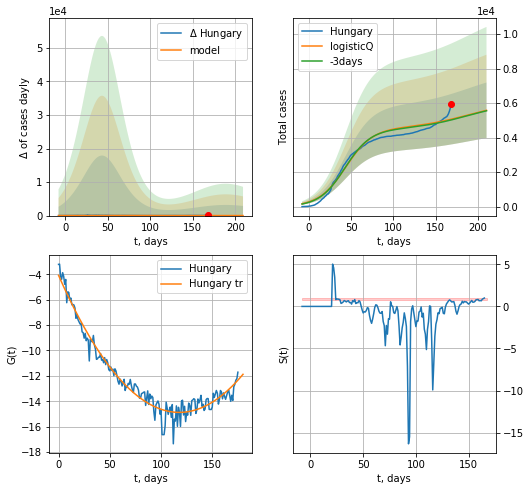

Hungary data at: 2020-08-29
+3 day model MAPE: 0.008178
model: logisticQ
coeffs: [ 4.52742813e+03  6.84985757e-08  4.34572546e+01 -9.26291825e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288459
forecast at the end of period: +42 days
	 deltaDaycases: 11
	 total cases: 5583 ± 1610
	 total death: 575 ± 497
trend coefficient of determination: 0.959144
 intercept_: -4.083824152904491
 coeffs_: [ 0.         -0.18312539  0.00077689]


In [1963]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


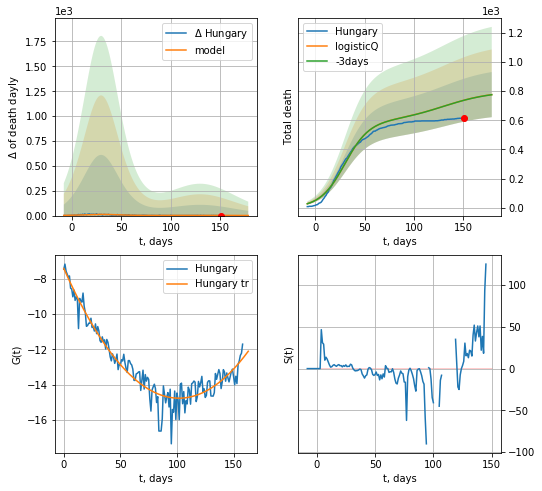

Hungary data at: 2020-08-29
+3 day model MAPE: 0.000682
model: logisticQ
coeffs: [ 5.92496561e+02  1.93849014e-07  2.99538422e+01 -4.13868638e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199486
forecast at the end of period: +28 days
	 total death: 776 ± 154
trend coefficient of determination: 0.916248
 intercept_: -7.424637893998324
 coeffs_: [ 0.         -0.1442972   0.00070894]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


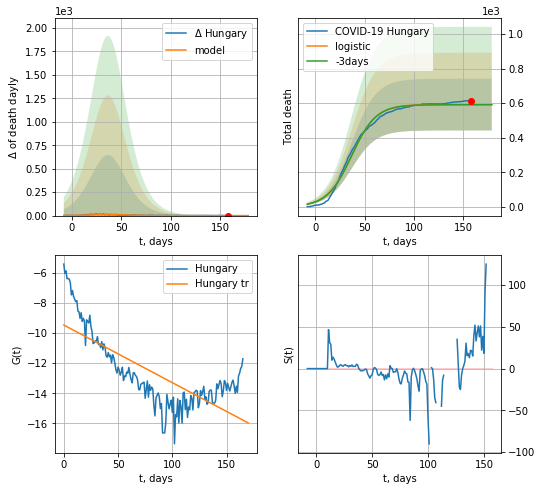

Hungary data at: 2020-08-29
+3 day model MAPE: 0.0016138269207810049
model: logistic
coeffs:  [5.92117132e+02 8.10778469e-02 3.69523703e+01]
rational stdev:  0.2532534671115003
forecast at the end of period: +21 days
	 total death:  592 ± 149
trend coefficient of determination: 0.559001
 intercept: -9.469088
 slope: -0.038218


In [1964]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

MT
           date   cases  active  death
170 2020-08-25  1705.0     666   10.0
171 2020-08-26  1751.0     664   10.0
172 2020-08-27  1788.0     657   10.0
173 2020-08-28  1820.0     624   10.0
174 2020-08-29  1847.0     592   11.0


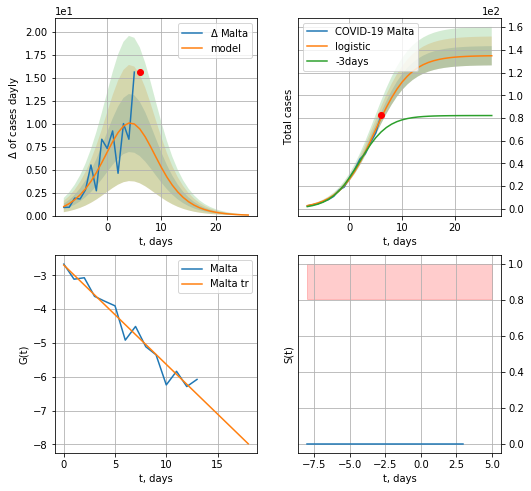

Malta data at: 2020-08-29
model: logistic
coeffs:  [135.01423457   0.29914202   4.75768623]
rational stdev:  0.06279874283082902
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  134 ± 8
	 total death:  0 ± 0
trend coefficient of determination: 0.952124
 intercept: -2.695789
 slope: -0.293811


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


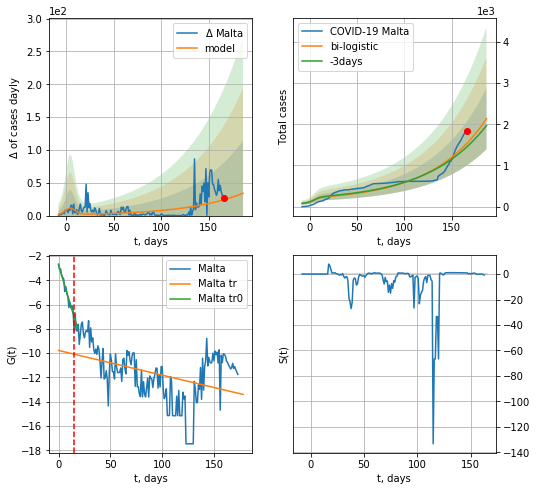

Malta data at: 2020-08-29
+3 day model MAPE: 0.05925991776777803
model: bi-logistic
coeffs:  [8.67030087e+06 1.71732827e-02 6.74626517e+02] [135.01423457   0.29914202   4.75768623]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.3474725735987031
forecast at the end of period: +21 days
	 deltaDaycases:  34
	 total cases:  2135 ± 741
	 total death:  12 ± 12
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.953633
 intercept: -2.737437
 slope: -0.284200
trend coefficient of determination: 0.164156
 intercept: -9.774084
 slope: -0.020330


In [1965]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


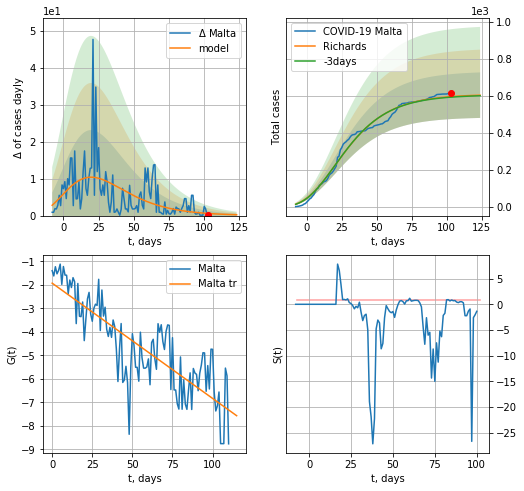

Malta data at: 2020-08-29
+3 day model MAPE: 0.004738
model: Richards
coeffs: [ 6.08571201e+02  8.24808839e+00 -9.10069288e+01  5.64853369e-03]
rational stdev: 0.203304
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 603 ± 122
	 total death: 3 ± 1
trend coefficient of determination: 0.678551
 intercept: -1.925365
 slope: -0.049026


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


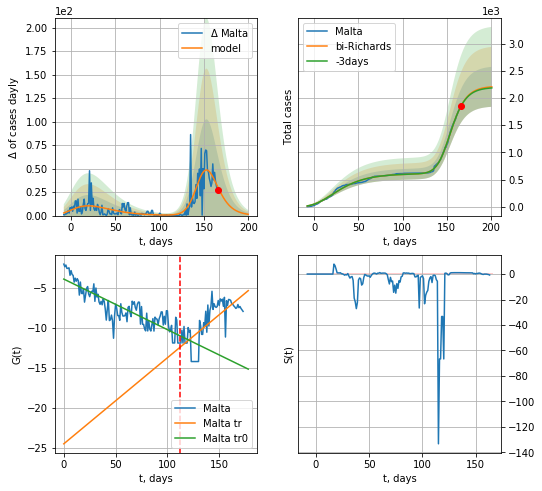

Malta data at: 2020-08-29
+3 day model MAPE: 0.002471
model: bi-Richards
coeffs: [1.60947159e+03 2.06233226e-01 1.46348608e+02 4.91872732e-01]
rational stdev: 0.166502
forecast at the end of period: +35 days
	 deltaDaycases: 1
	 total cases: 2205 ± 367
	 total death: 13 ± 6
bi-Richards approximation splitting point: 112
trend coefficient of determination: 0.738267
 intercept: -3.887910
 slope: -0.063217
trend coefficient of determination: 0.544295
 intercept: -24.475747
 slope: 0.107565


In [1966]:
vL = 112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,27*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


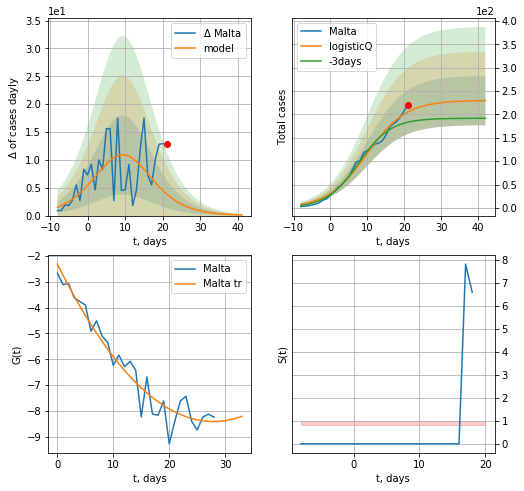

Malta data at: 2020-08-29
+3 day model MAPE: 0.130307
model: logisticQ
coeffs: [ 2.30072980e+02  3.58401181e-06  9.85050068e+00 -5.29673769e+04]
rational stdev: 0.229349
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 229 ± 52
	 total death: 1 ± 0
trend coefficient of determination: 0.934916
 intercept_: -2.3194397645380054
 coeffs_: [ 0.         -0.4365547   0.00782096]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


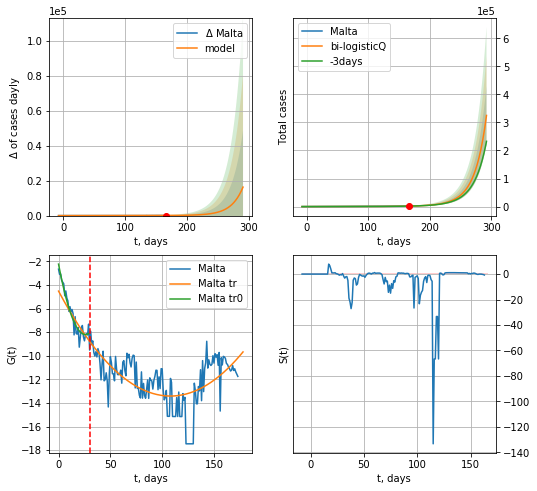

Malta data at: 2020-08-29
+3 day model MAPE: 0.032521
model: bi-logisticQ
coeffs: [ 5.84861685e+06  9.20062447e-05  3.40118728e+02 -3.48115484e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323598
forecast at the end of period: +126 days
	 deltaDaycases: 16278
	 total cases: 324932 ± 105147
	 total death: 1935 ± 1878
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.927936
 intercept_: -2.238018849909004
 coeffs_: [ 0.         -0.46099164  0.00890422]
trend coefficient of determination: 0.362891
 intercept_: -4.525902568442728
 coeffs_: [ 0.         -0.16462472  0.00076229]


In [1967]:
x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
168 2020-08-25  3536.0  1311.0   33.0
169 2020-08-26  3626.0  1387.0   33.0
170 2020-08-27  3728.0  1470.0   33.0
171 2020-08-28  3842.0  1555.0   33.0
172 2020-08-29  3876.0  1565.0   33.0


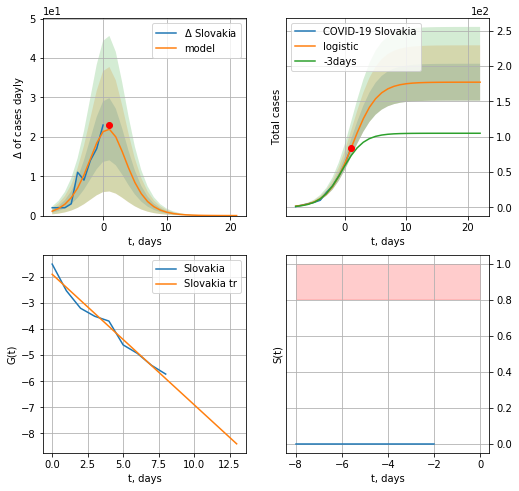

Slovakia data at: 2020-08-29
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  177 ± 26
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


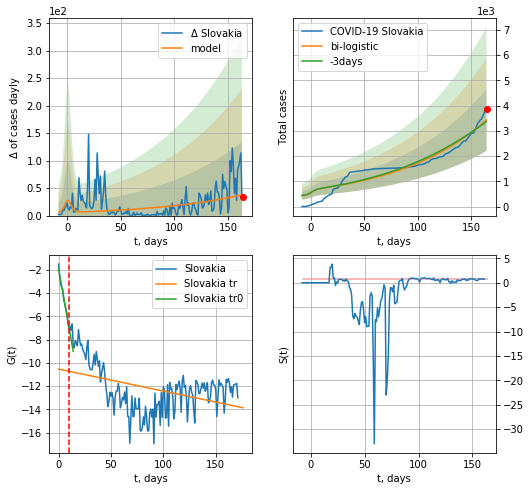

Slovakia data at: 2020-08-29
Exception ocurs


In [1969]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,22*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


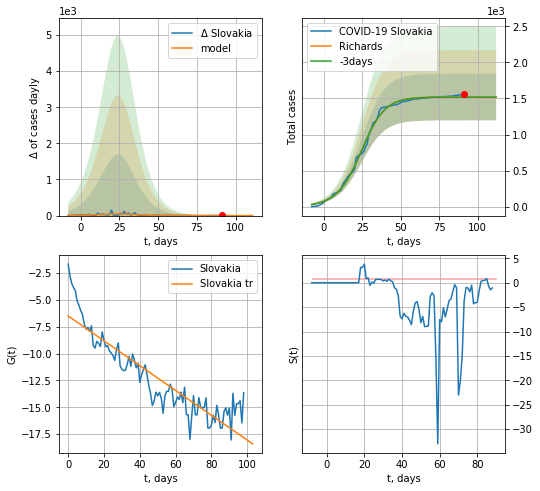

Slovakia data at: 2020-08-29
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109568e+03 1.16938732e-01 2.55808264e+01 1.14750291e+00]
rational stdev: 0.212800
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1521 ± 323
	 total death: 13 ± 8
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


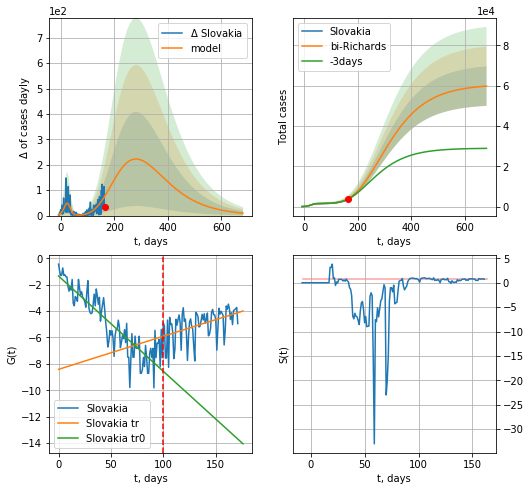

Slovakia data at: 2020-08-29
+3 day model MAPE: 0.020603
model: bi-Richards
coeffs: [ 5.91496150e+04  4.12687808e-01 -7.38705011e+01  2.51115952e-02]
rational stdev: 0.163693
forecast at the end of period: +518 days
	 deltaDaycases: 9
	 total cases: 59744 ± 9779
	 total death: 513 ± 251
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.798457
 intercept: -1.337674
 slope: -0.072314
trend coefficient of determination: 0.207400
 intercept: -8.416386
 slope: 0.025144


In [1970]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d12f(1),96*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


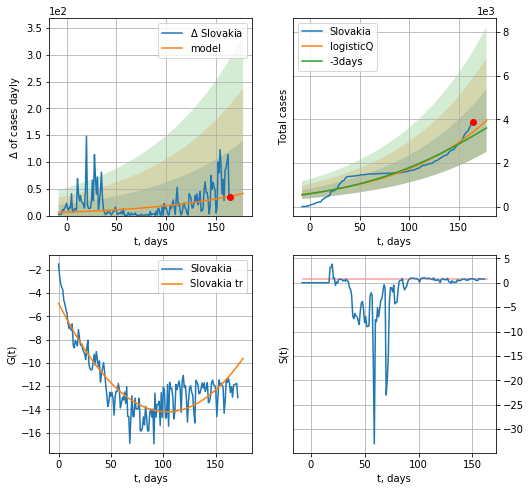

Slovakia data at: 2020-08-29
+3 day model MAPE: 0.057816
model: logisticQ
coeffs: [ 1.92548729e+05  6.46496219e-07  5.30473523e+02 -1.67863491e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362055
forecast at the end of period: +14 days
	 deltaDaycases: 41
	 total cases: 3951 ± 1430
	 total death: 33 ± 35
trend coefficient of determination: 0.778918
 intercept_: -4.872341115919006
 coeffs_: [ 0.         -0.18064474  0.00087314]


In [1971]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
173 2020-08-25  2686.0   414.0  133.0
174 2020-08-26  2722.0   419.0  133.0
175 2020-08-27  2755.0   423.0  133.0
176 2020-08-28  2797.0   428.0  133.0
177 2020-08-29  2865.0   449.0  133.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


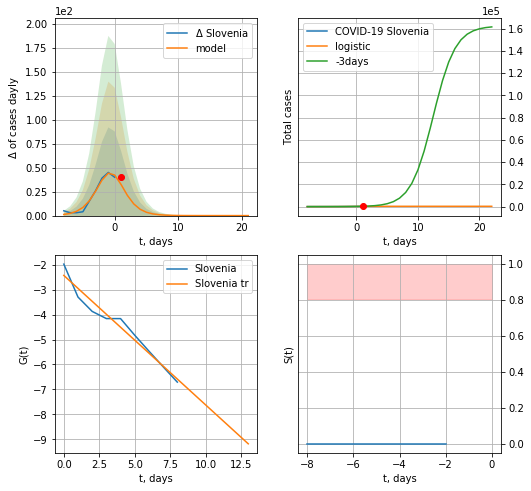

Slovenia data at: 2020-08-29
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  12 ± 19
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


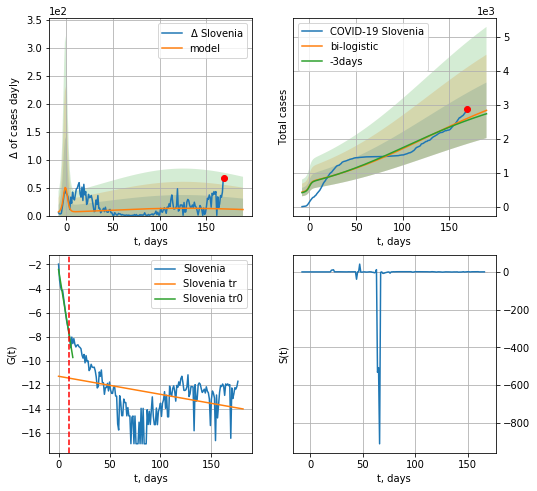

Slovenia data at: 2020-08-29
+3 day model MAPE: 0.022729198444011316
model: bi-logistic
coeffs:  [3.43016062e+03 1.49895444e-02 1.22625984e+02] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.2887700900236376
forecast at the end of period: +21 days
	 deltaDaycases:  10
	 total cases:  2831 ± 817
	 total death:  131 ± 113
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.123988
 intercept: -11.285573
 slope: -0.014986


In [1972]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


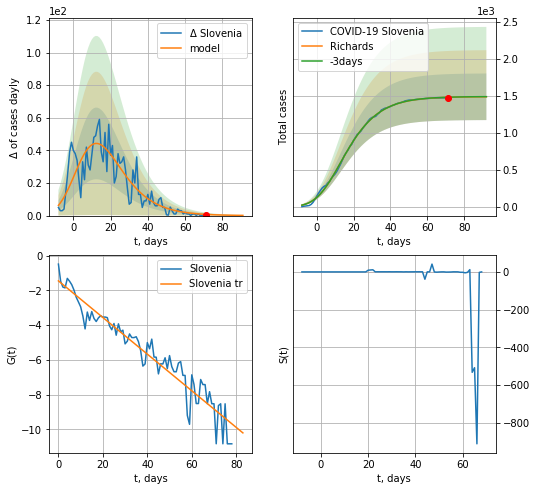

Slovenia data at: 2020-08-29
+3 day model MAPE: 0.001063
model: Richards
coeffs: [ 1.48543612e+03  5.20176508e-01 -7.42026148e+00  1.68829761e-01]
rational stdev: 0.211962
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1484 ± 314
	 total death: 68 ± 43
trend coefficient of determination: 0.919511
 intercept: -1.449330
 slope: -0.105393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


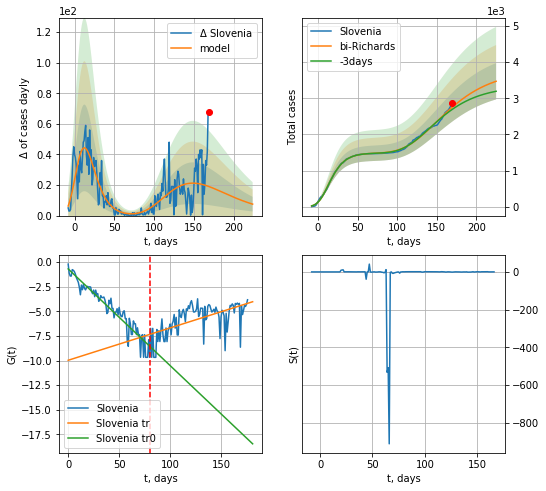

Slovenia data at: 2020-08-29
+3 day model MAPE: 0.022577
model: bi-Richards
coeffs: [ 2.30343543e+03  2.46400296e+00 -3.28673387e+01  1.02171149e-02]
rational stdev: 0.144617
forecast at the end of period: +56 days
	 deltaDaycases: 7
	 total cases: 3471 ± 502
	 total death: 161 ± 69
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.909161
 intercept: -0.689320
 slope: -0.098162
trend coefficient of determination: 0.358184
 intercept: -9.970003
 slope: 0.032858


In [1973]:
vL = 80
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


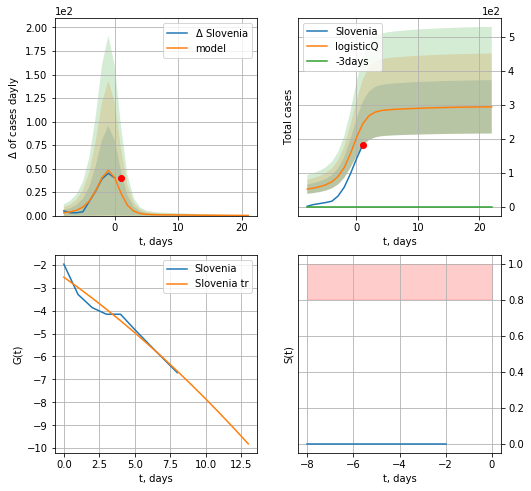

Slovenia data at: 2020-08-29
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965797e+02  4.01733259e-02 -2.21208421e+01 -7.00287218e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 294 ± 78
	 total death: 13 ± 10
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


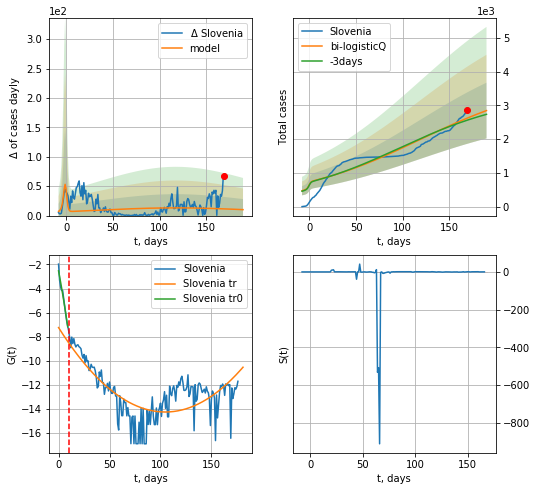

Slovenia data at: 2020-08-29
+3 day model MAPE: 0.024527
model: bi-logisticQ
coeffs: [ 3.35389837e+03  4.01589689e-08  1.15802009e+02 -3.76979130e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290383
forecast at the end of period: +21 days
	 deltaDaycases: 10
	 total cases: 2848 ± 827
	 total death: 132 ± 114
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.543503
 intercept_: -7.242068198285176
 coeffs_: [ 0.         -0.1338942   0.00063929]


In [1974]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
168 2020-08-25  30820   983.0  705.0
169 2020-08-26  30974   924.0  707.0
170 2020-08-27  31099   859.0  707.0
171 2020-08-28  31207   696.0  709.0
172 2020-08-29  31282   747.0  710.0


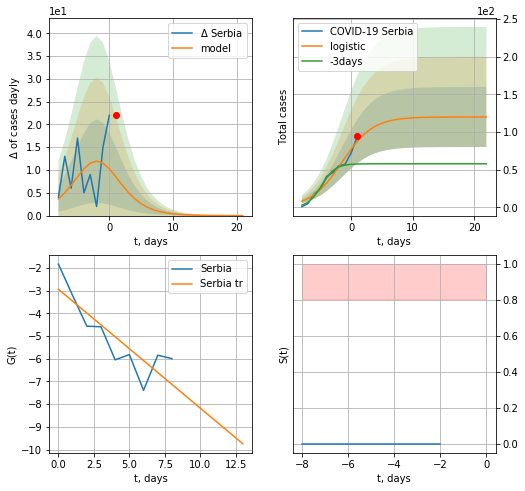

Serbia data at: 2020-08-29
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


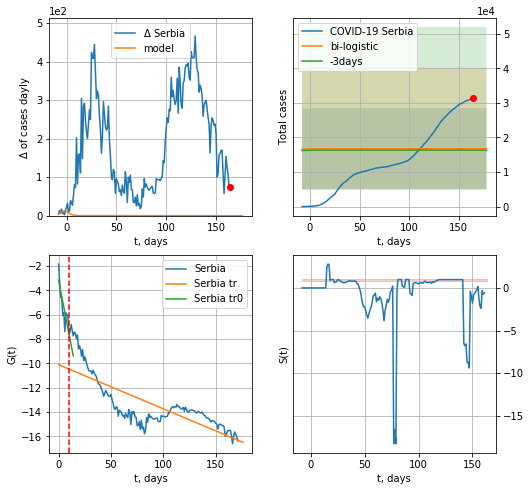

Serbia data at: 2020-08-29
+3 day model MAPE: 0.02399483761777091
model: bi-logistic
coeffs:  [ 1.32950376e+04 -1.85843089e+00  1.82707141e+02] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.7016442712167731
forecast at the end of period: +14 days
	 deltaDaycases:  -1
	 total cases:  16736 ± 11743
	 total death:  379 ± 797
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.616447
 intercept: -10.108464
 slope: -0.036345


In [1975]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,24*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


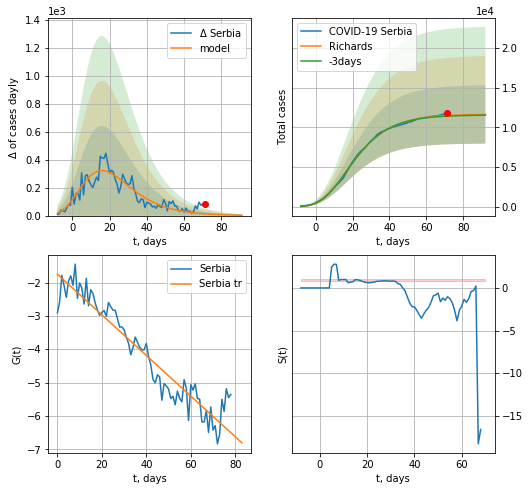

Serbia data at: 2020-08-29
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +21 days
	 deltaDaycases: 2
	 total cases: 11626 ± 3672
	 total death: 263 ± 249
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


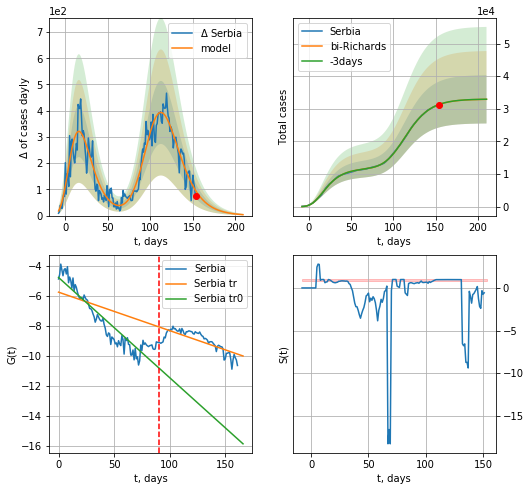

Serbia data at: 2020-08-29
+3 day model MAPE: 0.000458
model: bi-Richards
coeffs: [2.12948941e+04 1.36837402e-01 9.96388270e+01 4.45673750e-01]
rational stdev: 0.224850
forecast at the end of period: +56 days
	 deltaDaycases: 3
	 total cases: 32900 ± 7397
	 total death: 746 ± 503
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.864239
 intercept: -4.796401
 slope: -0.066632
trend coefficient of determination: 0.596207
 intercept: -5.772258
 slope: -0.025568


In [1976]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


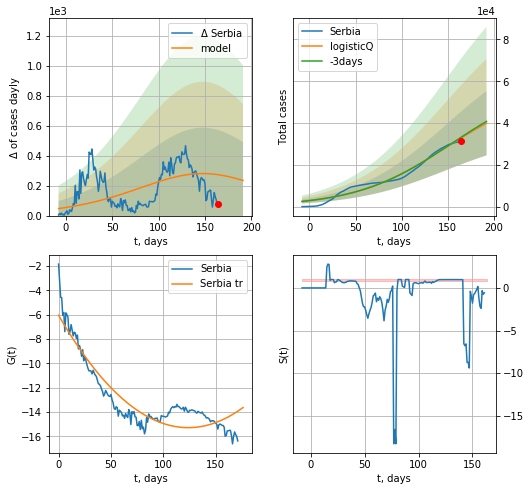

Serbia data at: 2020-08-29
+3 day model MAPE: 0.011243
model: logisticQ
coeffs: [ 5.60736452e+04  1.84698574e-07  1.47663613e+02 -1.07770738e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385193
forecast at the end of period: +28 days
	 deltaDaycases: 234
	 total cases: 39894 ± 15367
	 total death: 905 ± 1045
trend coefficient of determination: 0.850764
 intercept_: -6.037306527138364
 coeffs_: [ 0.         -0.14962904  0.00060481]


In [1977]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date    cases  active  death
178 2020-08-25   8530.0  2231.0  175.0
179 2020-08-26   8888.0  2351.0  175.0
180 2020-08-27   9192.0  2420.0  177.0
181 2020-08-28   9549.0  2560.0  180.0
182 2020-08-29  10123.0  2727.0  184.0


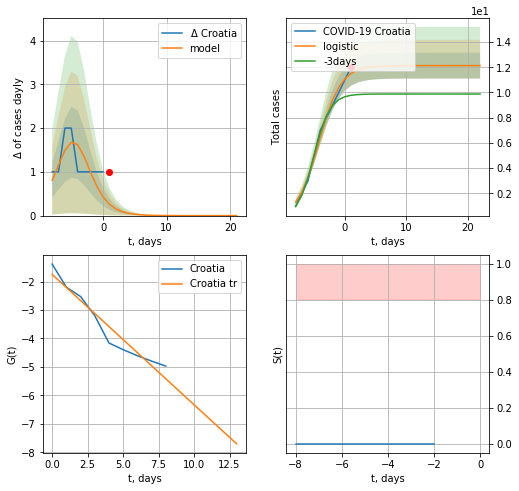

Croatia data at: 2020-08-29
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


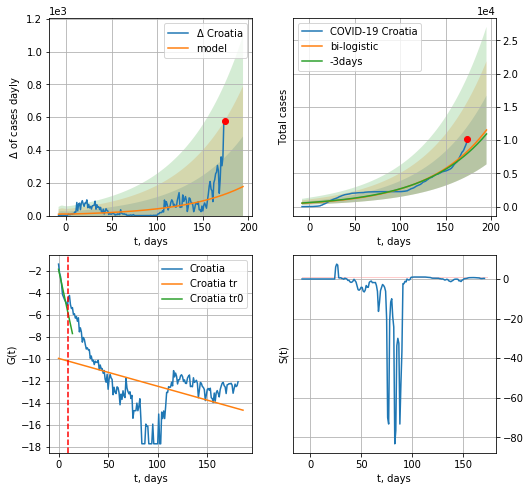

Croatia data at: 2020-08-29
+3 day model MAPE: 0.04094028916616622
model: bi-logistic
coeffs:  [2.53934246e+07 1.54834089e-02 6.92180871e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.4483960530006197
forecast at the end of period: +21 days
	 deltaDaycases:  176
	 total cases:  11528 ± 5169
	 total death:  209 ± 281
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.199079
 intercept: -9.965318
 slope: -0.025342


In [1978]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


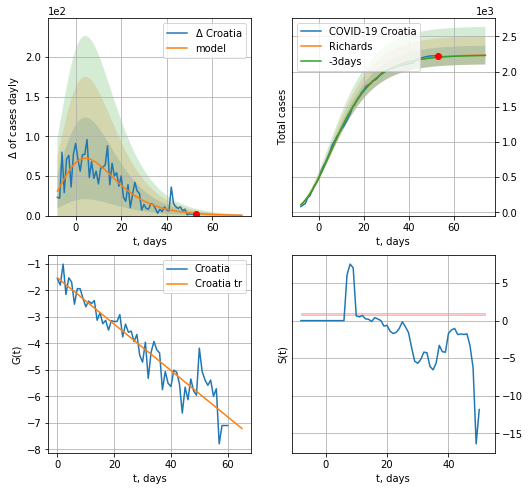

Croatia data at: 2020-08-29
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963098e+03  7.95198453e+00 -4.62549964e+01  1.10913889e-02]
rational stdev: 0.059687
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 2234 ± 133
	 total death: 40 ± 7
trend coefficient of determination: 0.897394
 intercept: -1.522030
 slope: -0.087533


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


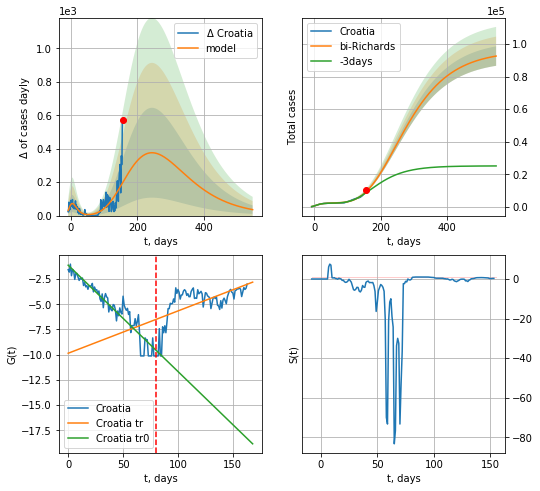

Croatia data at: 2020-08-29
+3 day model MAPE: 0.076675
model: bi-Richards
coeffs: [ 9.37607046e+04  8.03723912e-01 -1.46453660e+02  1.36602663e-02]
rational stdev: 0.064491
forecast at the end of period: +392 days
	 deltaDaycases: 35
	 total cases: 92708 ± 5978
	 total death: 1685 ± 326
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.902871
 intercept: -1.124566
 slope: -0.105460
trend coefficient of determination: 0.366853
 intercept: -9.859434
 slope: 0.041968


In [1979]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,78*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


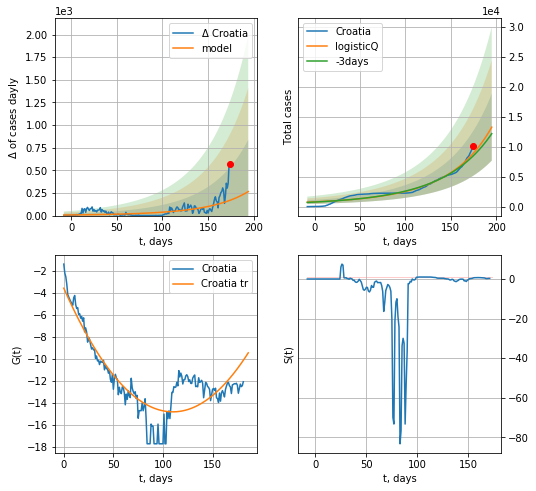

Croatia data at: 2020-08-29
+3 day model MAPE: 0.050459
model: logisticQ
coeffs: [ 1.03438681e+07  2.97223892e-05  4.37453657e+02 -7.28810283e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.420515
forecast at the end of period: +21 days
	 deltaDaycases: 265
	 total cases: 13271 ± 5580
	 total death: 241 ± 304
trend coefficient of determination: 0.774937
 intercept_: -3.5787944272064927
 coeffs_: [ 0.         -0.20458068  0.00092992]


In [1981]:
x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
172 2020-08-25  97619   24604  5298.0
173 2020-08-26  97825   23795  5317.0
174 2020-08-27  98062   23108  5342.0
175 2020-08-28  98285   22504  5362.0
176 2020-08-29  98497   21819  5376.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


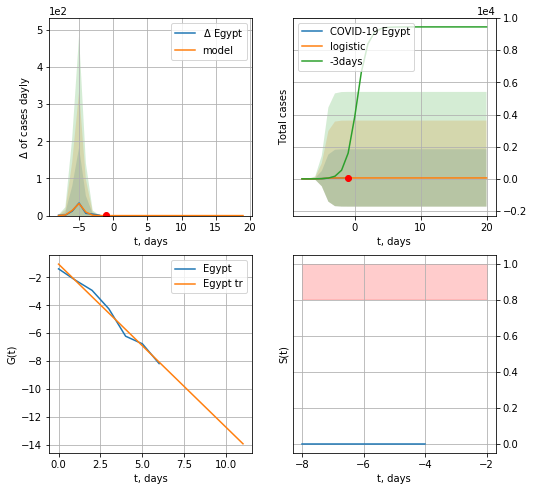

Egypt data at: 2020-08-29
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


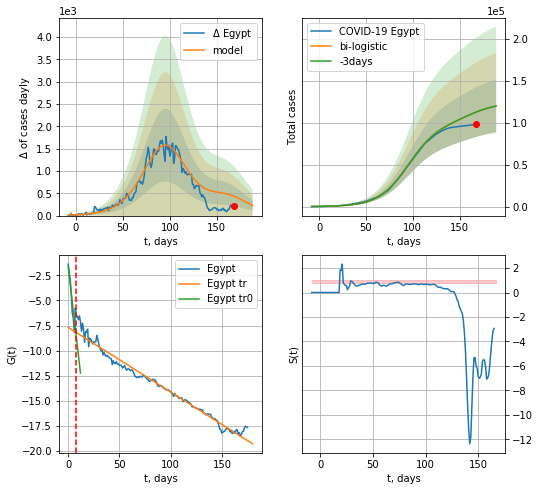

Egypt data at: 2020-08-29
+3 day model MAPE: 1.2145744222109915e-05
model: bi-logistic
coeffs:  [9.93395128e+04 6.26509979e-02 9.53177705e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2625567860580044
forecast at the end of period: +21 days
	 deltaDaycases:  227
	 total cases:  120081 ± 31528
	 total death:  6554 ± 5162
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.975649
 intercept: -7.679721
 slope: -0.064357


In [1982]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
xx = forecast2("Egypt",dfEG[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


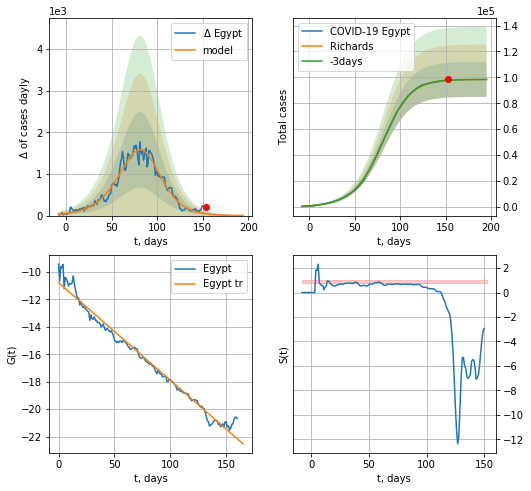

Egypt data at: 2020-08-29
+3 day model MAPE: 0.000962
model: Richards
coeffs: [9.84817976e+04 5.49793284e-02 8.51845033e+01 1.26529770e+00]
rational stdev: 0.137081
forecast at the end of period: +42 days
	 deltaDaycases: 2
	 total cases: 98444 ± 13494
	 total death: 5373 ± 2209
trend coefficient of determination: 0.980839
 intercept: -10.782866
 slope: -0.071145


In [1985]:
x = forecastRR("Egypt",dfEG[15:],d1,28*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


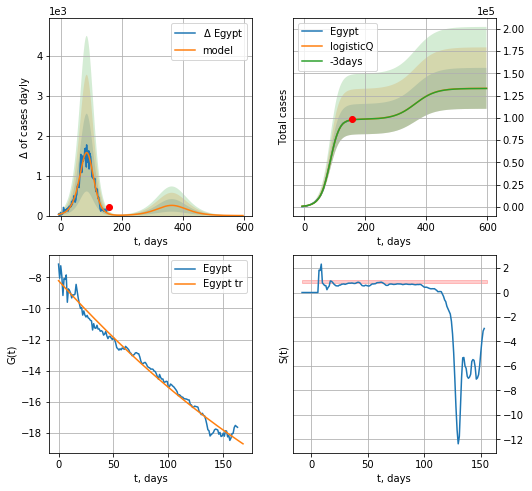

Egypt data at: 2020-08-29
+3 day model MAPE: 0.000990
model: logisticQ
coeffs: [ 9.83313750e+04  8.81160626e-05  8.32241185e+01 -6.45233906e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.172953
forecast at the end of period: +441 days
	 deltaDaycases: 0
	 total cases: 133126 ± 23024
	 total death: 7266 ± 3770
trend coefficient of determination: 0.984323
 intercept_: -8.22070237994371
 coeffs_: [ 0.00000000e+00 -7.75005387e-02  8.99754844e-05]


In [1986]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
175 2020-08-25  211947  51590.0  6596.0
176 2020-08-26  215784  51901.0  6668.0
177 2020-08-27  219435  51686.0  6740.0
178 2020-08-28  223612  51924.0  6814.0
179 2020-08-29  227446  51535.0  6891.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


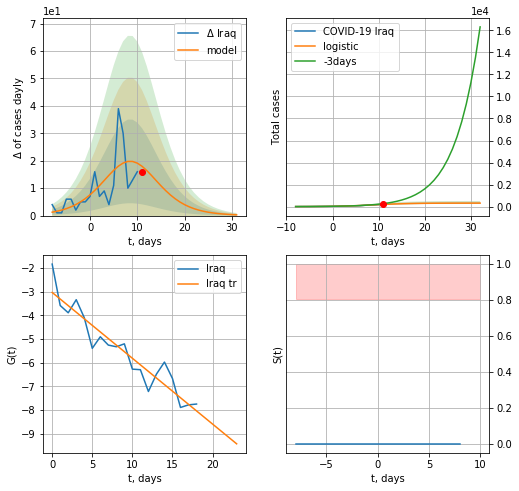

Iraq data at: 2020-08-29
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  316 ± 65
	 total death:  9 ± 5
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


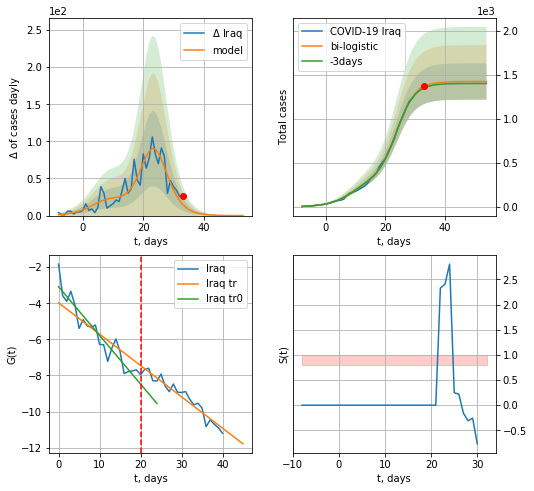

Iraq data at: 2020-08-29
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  43 ± 18
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


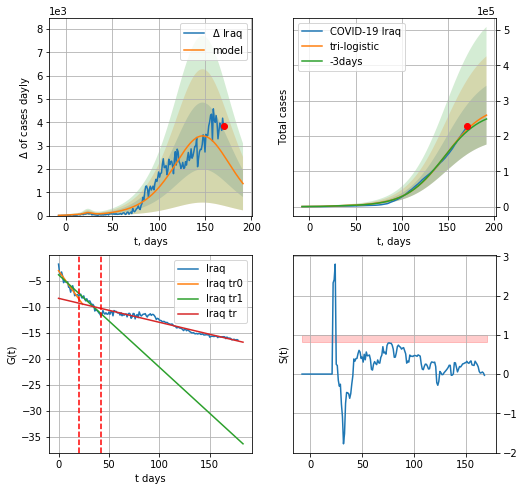

Iraq data at: 2020-08-29
+3 day model MAPE: 0.024562822313147714
model: tri-logistic
coeffs:  [2.89651370e+05 4.71754025e-02 1.47836162e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.3215300909691654
forecast at the end of period: +21 days
	 deltaDaycases:  1370
	 total cases:  259008 ± 83278
	 total death:  7847 ± 7569
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.934010
 intercept: -8.394478
 slope: -0.045966


In [1987]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


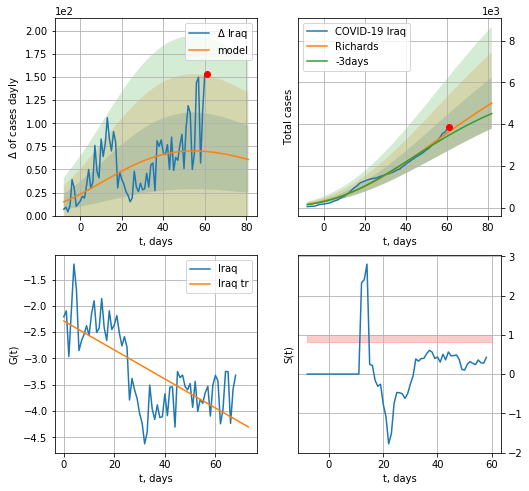

Iraq data at: 2020-08-29
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +21 days
	 deltaDaycases: 60
	 total cases: 5005 ± 1216
	 total death: 151 ± 110
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


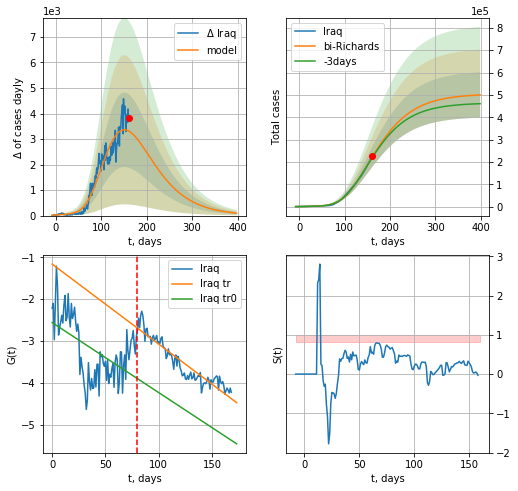

Iraq data at: 2020-08-29
+3 day model MAPE: 0.013459
model: bi-Richards
coeffs: [ 4.96264269e+05  1.61473588e+00 -9.10709212e+01  1.14065587e-02]
rational stdev: 0.203056
forecast at the end of period: +238 days
	 deltaDaycases: 96
	 total cases: 499727 ± 101472
	 total death: 15140 ± 9222
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.276445
 intercept: -2.557631
 slope: -0.016721
trend coefficient of determination: 0.875397
 intercept: -1.162437
 slope: -0.019107


In [1988]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,56*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

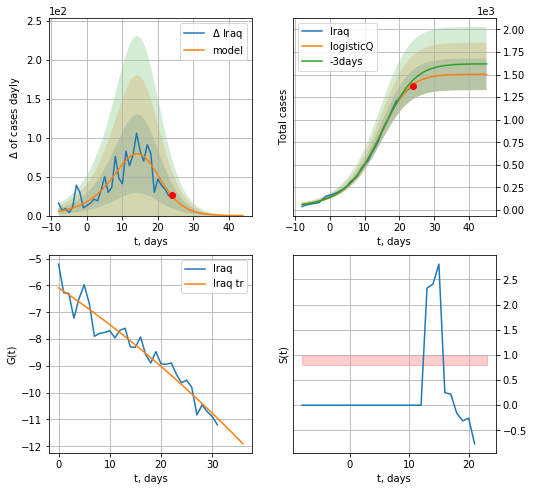

Iraq data at: 2020-08-29
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291917e+03  2.94853842e-03  1.34415511e+01 -5.72228370e+01]
rational stdev: 0.116469
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1502 ± 175
	 total death: 45 ± 15
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


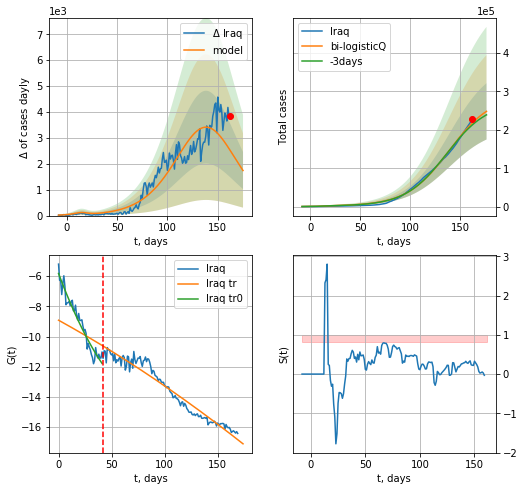

Iraq data at: 2020-08-29
+3 day model MAPE: 0.024663
model: bi-logisticQ
coeffs: [ 2.89047734e+05  4.02795142e-07  1.38764827e+02 -1.17217595e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295486
forecast at the end of period: +14 days
	 deltaDaycases: 1740
	 total cases: 248149 ± 73324
	 total death: 7518 ± 6664
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.948193
 intercept_: -8.920134968421763
 coeffs_: [ 0.00000000e+00 -3.86733450e-02 -4.81004768e-05]


In [1989]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [1990]:
#len(dfAR)

AR
           date    cases   active   death
174 2020-08-25  42228.0  11185.0  1456.0
175 2020-08-26  42619.0  11268.0  1465.0
176 2020-08-27  43016.0  11384.0  1475.0
177 2020-08-28  43403.0  11484.0  1483.0
178 2020-08-29  43781.0  11573.0  1491.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


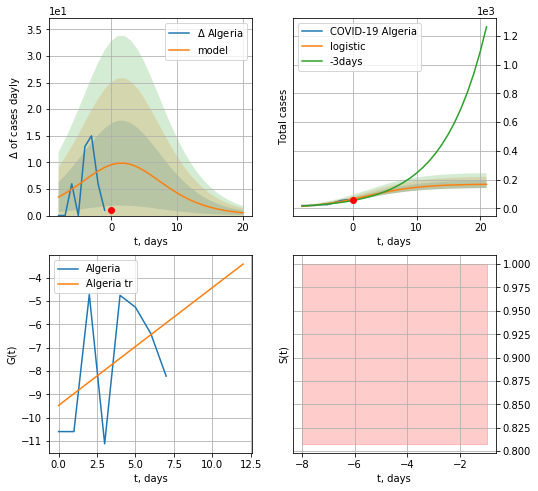

Algeria data at: 2020-08-29
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  167 ± 25
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


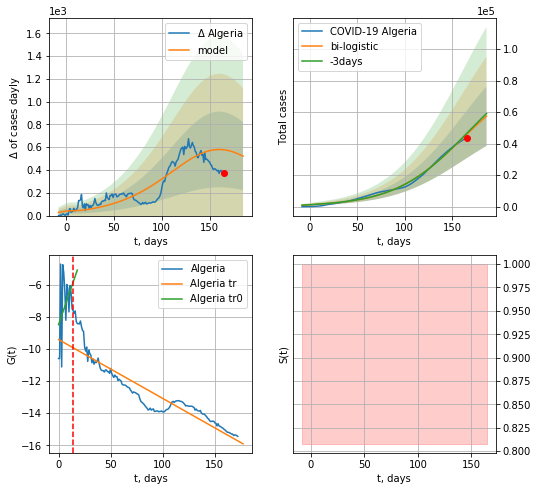

Algeria data at: 2020-08-29
+3 day model MAPE: 0.01468370838562071
model: bi-logistic
coeffs:  [8.42792419e+04 2.71777449e-02 1.59577785e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3289767699359984
forecast at the end of period: +21 days
	 deltaDaycases:  521
	 total cases:  57371 ± 18873
	 total death:  1953 ± 1927
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.846908
 intercept: -9.420156
 slope: -0.036631


In [1991]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


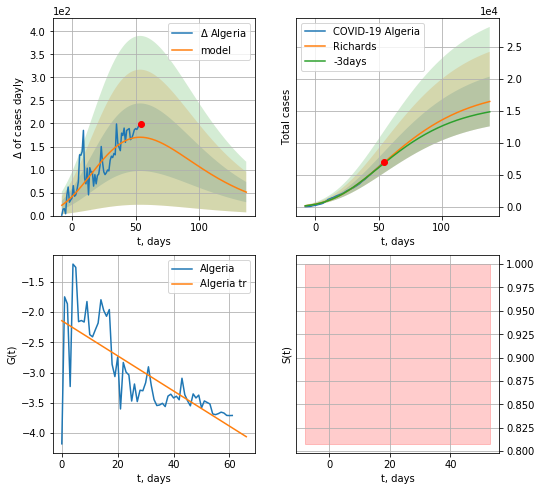

Algeria data at: 2020-08-29
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +84 days
	 deltaDaycases: 50
	 total cases: 16486 ± 3884
	 total death: 561 ± 396
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


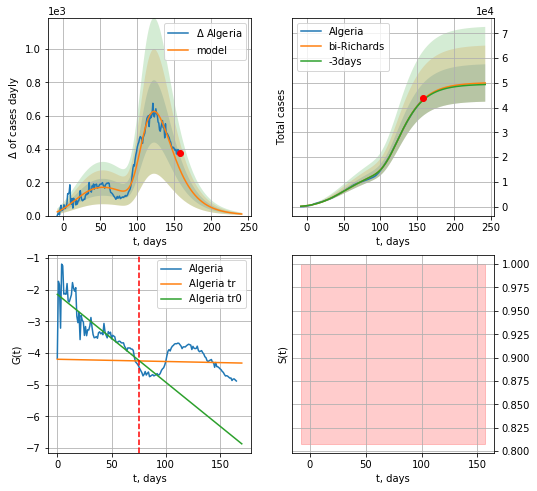

Algeria data at: 2020-08-29
+3 day model MAPE: 0.005424
model: bi-Richards
coeffs: [3.15670382e+04 3.96898912e+00 3.30023157e+01 1.21800681e-02]
rational stdev: 0.151062
forecast at the end of period: +84 days
	 deltaDaycases: 9
	 total cases: 49924 ± 7541
	 total death: 1700 ± 770
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.672294
 intercept: -2.143092
 slope: -0.027788
trend coefficient of determination: 0.002190
 intercept: -4.194926
 slope: -0.000704


In [1992]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


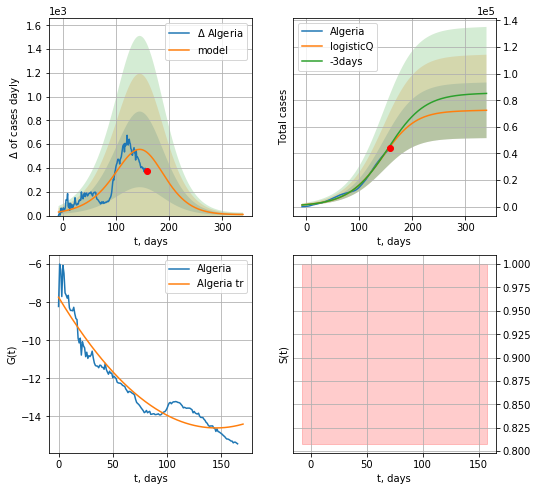

Algeria data at: 2020-08-29
+3 day model MAPE: 0.019030
model: logisticQ
coeffs: [ 7.19469835e+04  2.83070164e-05  1.41240553e+02 -9.47191580e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288428
forecast at the end of period: +182 days
	 deltaDaycases: 9
	 total cases: 72460 ± 20899
	 total death: 2467 ± 2134
trend coefficient of determination: 0.920865
 intercept_: -7.7360969618997855
 coeffs_: [ 0.         -0.09465303  0.0003261 ]


In [1993]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
166 2020-08-25  1448.0   519.0   20.0
167 2020-08-26  1458.0   529.0   20.0
168 2020-08-27  1467.0   512.0   20.0
169 2020-08-28  1481.0   526.0   20.0
170 2020-08-29  1483.0   528.0   20.0


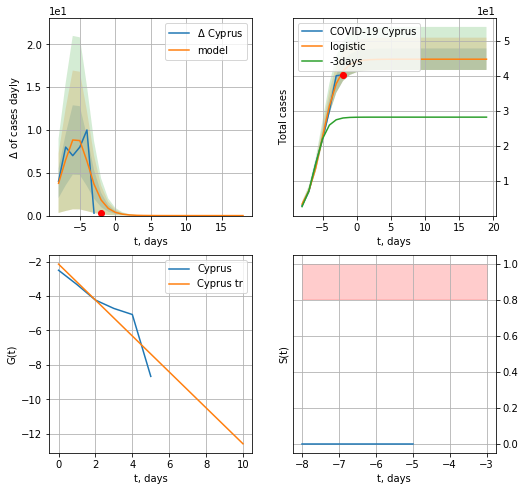

Cyprus data at: 2020-08-29
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


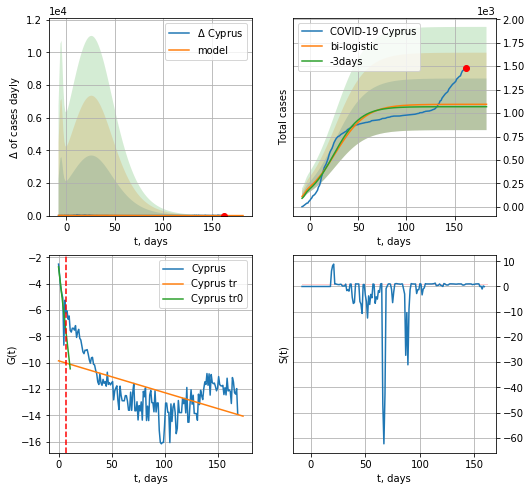

Cyprus data at: 2020-08-29
+3 day model MAPE: 0.023802898041942657
model: bi-logistic
coeffs:  [1.04906910e+03 6.28068673e-02 2.63099471e+01] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.2514875310171428
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1093 ± 275
	 total death:  14 ± 10
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.300300
 intercept: -9.852567
 slope: -0.024162


In [1994]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


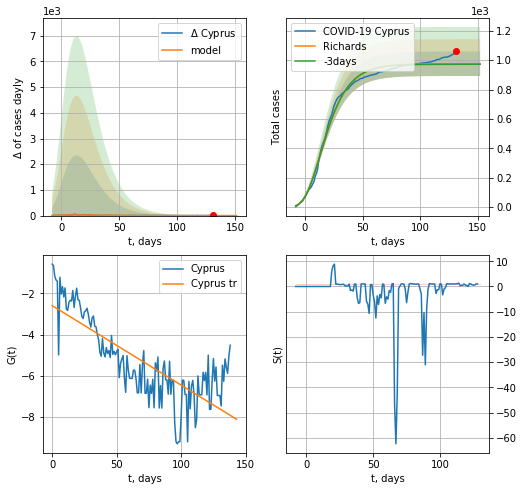

Cyprus data at: 2020-08-29
+3 day model MAPE: 0.003899
model: Richards
coeffs: [ 9.76316968e+02  1.29526584e+01 -5.80116939e+01  5.60254248e-03]
rational stdev: 0.085570
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 976 ± 83
	 total death: 13 ± 3
trend coefficient of determination: 0.611365
 intercept: -2.592811
 slope: -0.038703


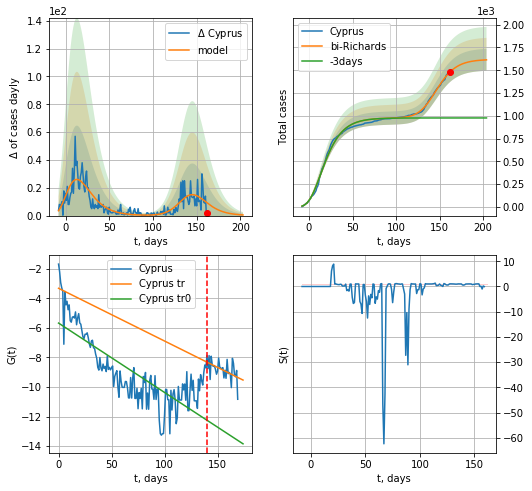

Cyprus data at: 2020-08-29
+3 day model MAPE: 0.525726
model: bi-Richards
coeffs: [6.43473666e+02 1.40587805e-01 1.38753195e+02 5.77746407e-01]
rational stdev: 0.074679
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 1614 ± 120
	 total death: 21 ± 4
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.622367
 intercept: -5.672412
 slope: -0.046942
trend coefficient of determination: 0.236633
 intercept: -3.319301
 slope: -0.035677


In [1995]:
iL = 0
vL=140+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


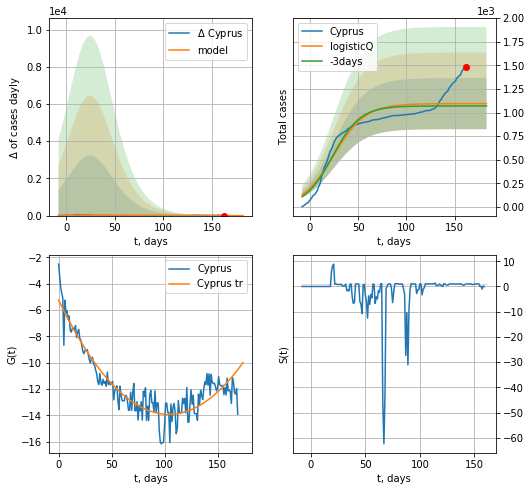

Cyprus data at: 2020-08-29
+3 day model MAPE: 0.023277
model: logisticQ
coeffs: [ 1.09484955e+03  2.47694003e-08  2.49230466e+01 -2.46759540e+06]
rational stdev: 0.247485
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1094 ± 270
	 total death: 14 ± 10
trend coefficient of determination: 0.851775
 intercept_: -5.240341239785513
 coeffs_: [ 0.         -0.16695795  0.00080264]


In [1996]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active    death
171 2020-08-25  607382  164804.0  28001.0
172 2020-08-26  613378  163377.0  28124.0
173 2020-08-27  621997  164058.0  28277.0
174 2020-08-28  629961  163473.0  28471.0
175 2020-08-29  639435  164153.0  28607.0


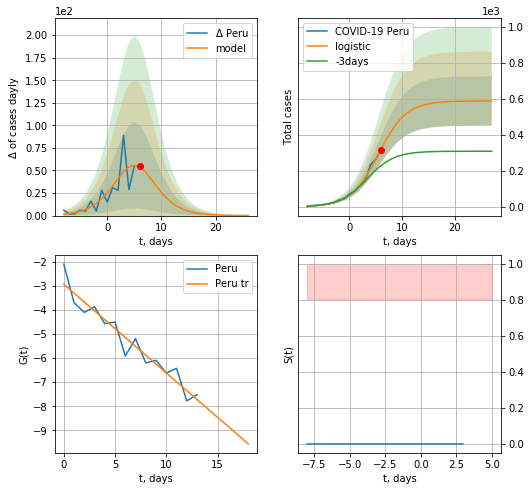

Peru data at: 2020-08-29
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  26 ± 18
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


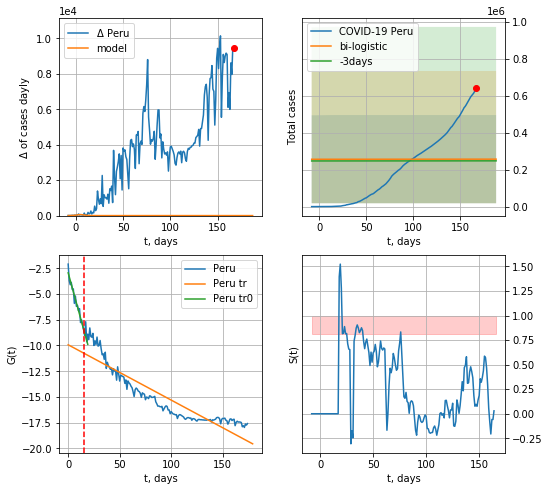

Peru data at: 2020-08-29
+3 day model MAPE: 0.037178420244732883
model: bi-logistic
coeffs:  [ 2.05047355e+05 -2.44310327e+01  5.90099346e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.92882809128339
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  256898 ± 238614
	 total death:  11493 ± 32025
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.840591
 intercept: -9.931114
 slope: -0.053710


In [1997]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


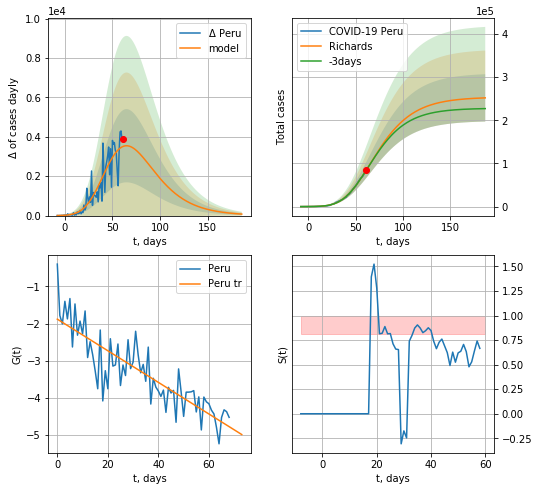

Peru data at: 2020-08-29
+3 day model MAPE: 0.004154
model: Richards
coeffs: [2.53863506e+05 3.16853284e-01 1.42828252e+01 1.27510046e-01]
rational stdev: 0.217550
forecast at the end of period: +126 days
	 deltaDaycases: 75
	 total cases: 252015 ± 54825
	 total death: 11274 ± 7357
trend coefficient of determination: 0.729631
 intercept: -1.882711
 slope: -0.042524


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


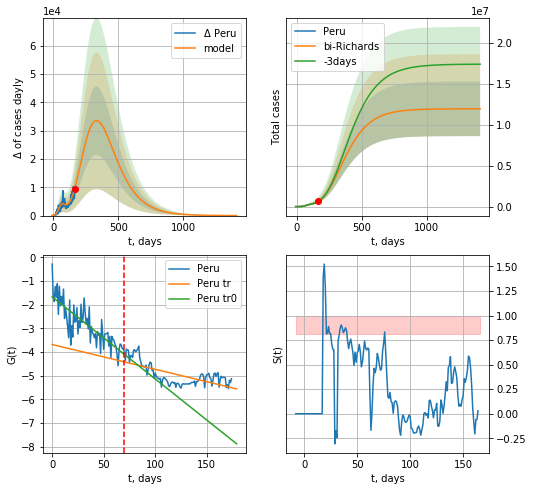

Peru data at: 2020-08-29
+3 day model MAPE: 0.003514
model: bi-Richards
coeffs: [1.17160568e+07 1.17054575e-01 1.22027639e+00 6.88016395e-02]
rational stdev: 0.279128
forecast at the end of period: +1246 days
	 deltaDaycases: 15
	 total cases: 11967955 ± 3340594
	 total death: 535421 ± 448353
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.659672
 intercept: -1.671339
 slope: -0.034704
trend coefficient of determination: 0.457222
 intercept: -3.685998
 slope: -0.010481


In [1998]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,200*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


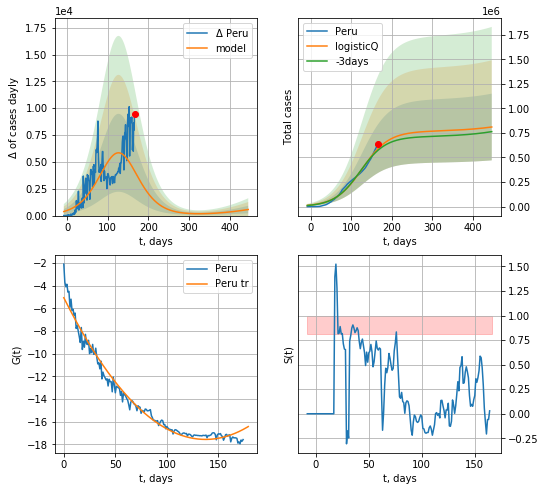

Peru data at: 2020-08-29
+3 day model MAPE: 0.029312
model: logisticQ
coeffs: [ 7.66406445e+05  1.13977475e-07  1.27058473e+02 -2.67404935e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419007
forecast at the end of period: +280 days
	 deltaDaycases: 565
	 total cases: 810543 ± 339623
	 total death: 36262 ± 45582
trend coefficient of determination: 0.976299
 intercept_: -5.065116468243287
 coeffs_: [ 0.         -0.18177192  0.00066071]


In [1999]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active    death
178 2020-08-25  3235725  707405.0  59632.0
179 2020-08-26  3314953  729783.0  60652.0
180 2020-08-27  3392295  745540.0  61725.0
181 2020-08-28  3468272  755901.0  62750.0
182 2020-08-29  3546705  768020.0  63690.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


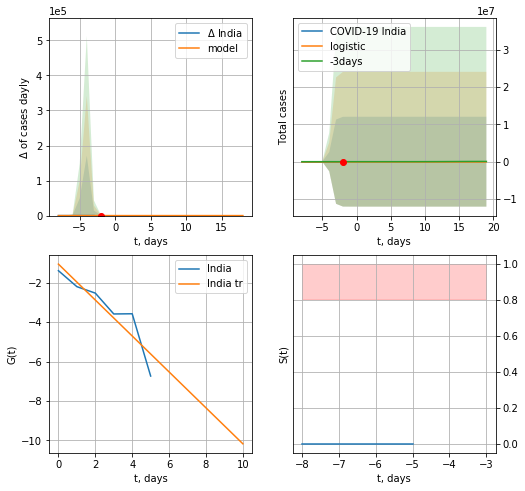

India data at: 2020-08-29
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


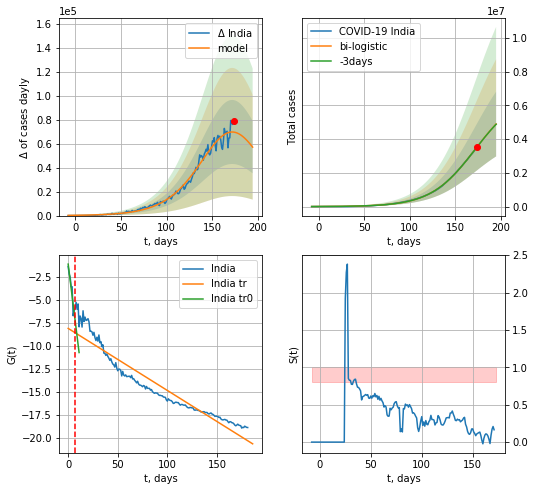

India data at: 2020-08-29
+3 day model MAPE: 0.00119044306907786
model: bi-logistic
coeffs:  [6.77645481e+06 4.09932878e-02 1.71894754e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3919526414199819
forecast at the end of period: +21 days
	 deltaDaycases:  57052
	 total cases:  4898181 ± 1919855
	 total death:  87959 ± 103427
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.907823
 intercept: -8.109115
 slope: -0.067508


In [2000]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


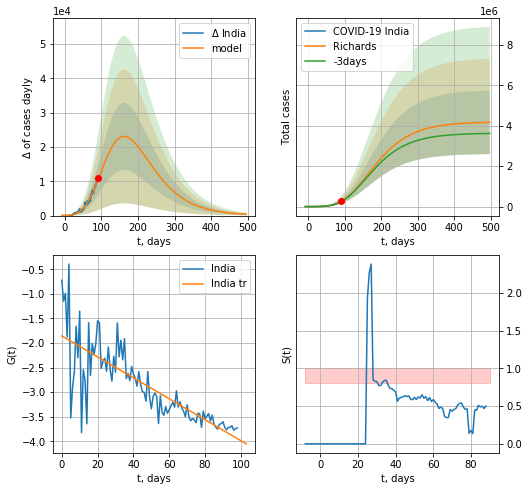

India data at: 2020-08-29
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +406 days
	 deltaDaycases: 383
	 total cases: 4172718 ± 1573553
	 total death: 74931 ± 84770
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


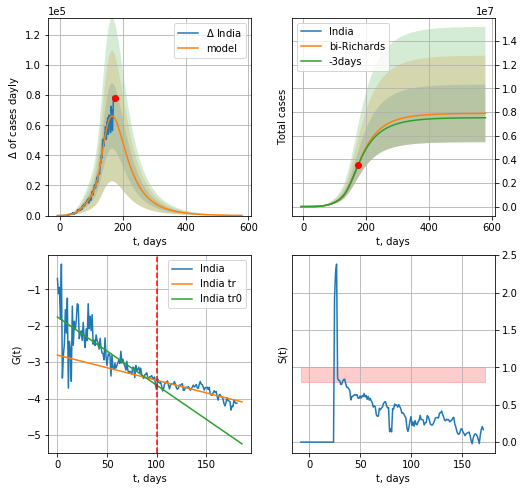

India data at: 2020-08-29
+3 day model MAPE: 0.008244
model: bi-Richards
coeffs: [3.69199811e+06 1.54022522e+00 4.66066524e+01 2.08531004e-02]
rational stdev: 0.309182
forecast at the end of period: +406 days
	 deltaDaycases: 108
	 total cases: 7882639 ± 2437166
	 total death: 141552 ± 131295
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.582369
 intercept: -1.761741
 slope: -0.018716
trend coefficient of determination: 0.684959
 intercept: -2.808083
 slope: -0.006910


In [2001]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


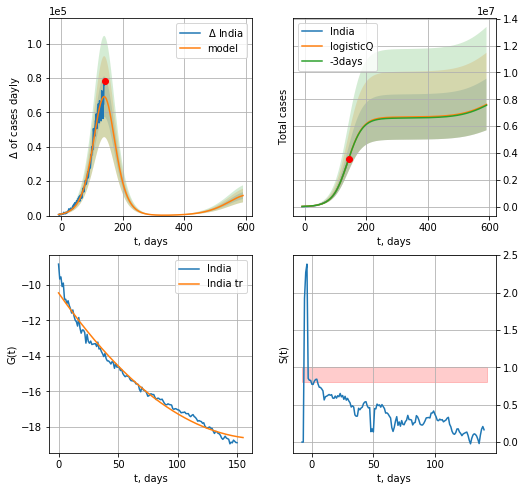

India data at: 2020-08-29
+3 day model MAPE: 0.001636
model: logisticQ
coeffs: [ 6.67575491e+06  4.37423026e-06  1.40174728e+02 -9.34111714e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252918
forecast at the end of period: +448 days
	 deltaDaycases: 11662
	 total cases: 7617914 ± 1926709
	 total death: 136798 ± 103796
trend coefficient of determination: 0.984451
 intercept_: -10.447487318531106
 coeffs_: [ 0.         -0.09633472  0.00028207]


In [2002]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases    active   death
174 2020-08-25  359638.0   88873.0  7563.0
175 2020-08-26  370188.0   93548.0  7839.0
176 2020-08-27  380292.0   97784.0  8050.0
177 2020-08-28  392009.0  103573.0  8271.0
178 2020-08-29  401239.0  105666.0  8353.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


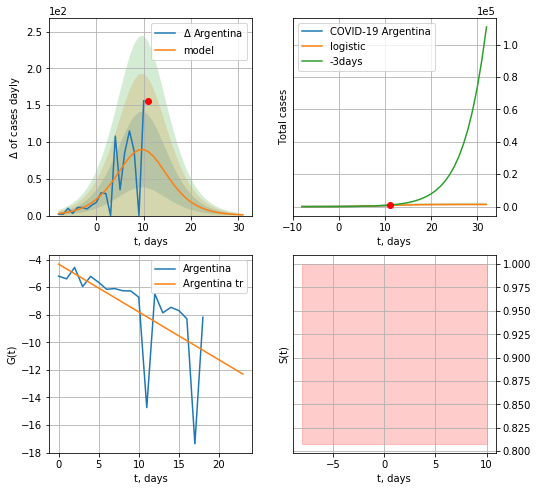

Argentina data at: 2020-08-29
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  1302 ± 361
	 total death:  27 ± 22
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


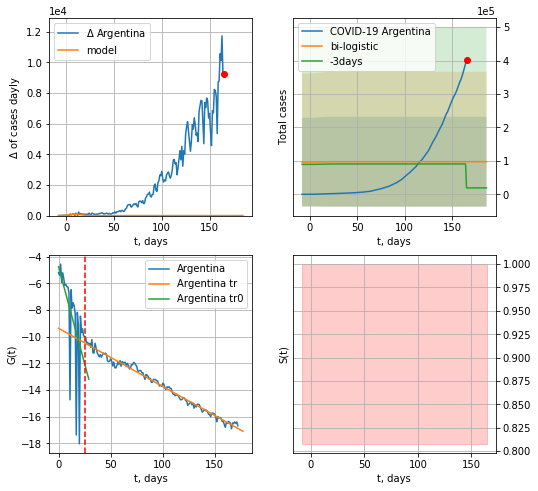

Argentina data at: 2020-08-29
+3 day model MAPE: 4.085340505840828
model: bi-logistic
coeffs:  [ 7.69958455e+04 -7.51814616e+00  1.67639946e+03] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3768046801787444
forecast at the end of period: +21 days
	 deltaDaycases:  0
	 total cases:  97550 ± 134308
	 total death:  2030 ± 8384
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.984441
 intercept: -9.371972
 slope: -0.043569


In [2003]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

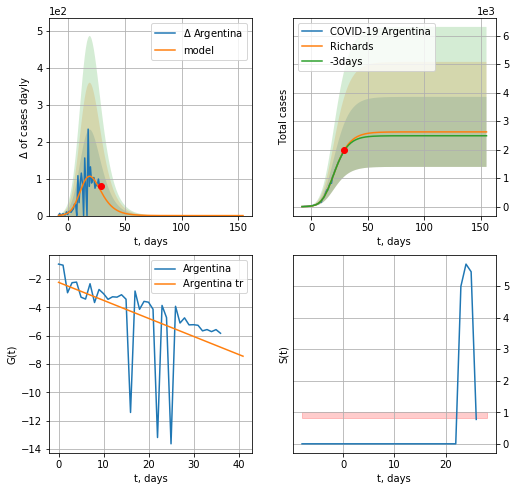

Argentina data at: 2020-08-29
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 54 ± 75
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


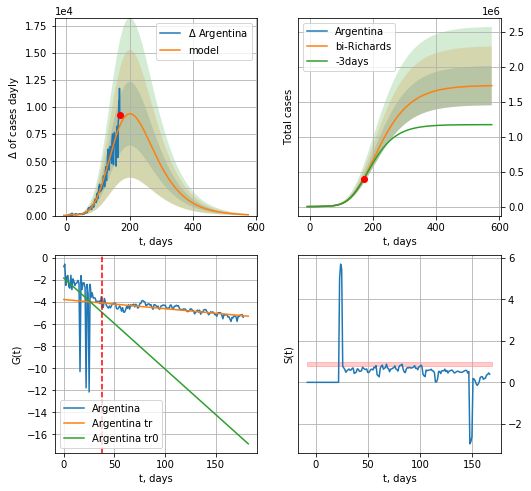

Argentina data at: 2020-08-29
+3 day model MAPE: 0.013555
model: bi-Richards
coeffs: [1.73559539e+06 1.25503311e-01 6.76087625e+01 1.24223706e-01]
rational stdev: 0.161971
forecast at the end of period: +406 days
	 deltaDaycases: 79
	 total cases: 1733177 ± 280724
	 total death: 36081 ± 17532
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.128656
 intercept: -1.815483
 slope: -0.082600
trend coefficient of determination: 0.650054
 intercept: -3.758839
 slope: -0.008311


In [2004]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


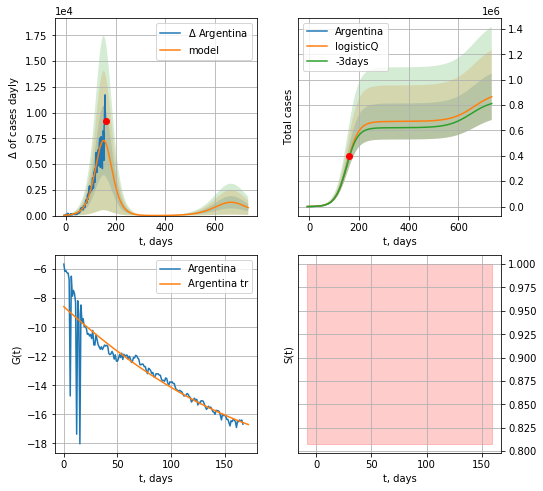

Argentina data at: 2020-08-29
+3 day model MAPE: 0.018523
model: logisticQ
coeffs: [ 6.70531254e+05  1.73969914e-06  1.52351477e+02 -2.48574912e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.211650
forecast at the end of period: +574 days
	 deltaDaycases: 765
	 total cases: 865552 ± 183193
	 total death: 18019 ± 11441
trend coefficient of determination: 0.791207
 intercept_: -8.580806193549531
 coeffs_: [ 0.         -0.06722105  0.0001165 ]


In [2005]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


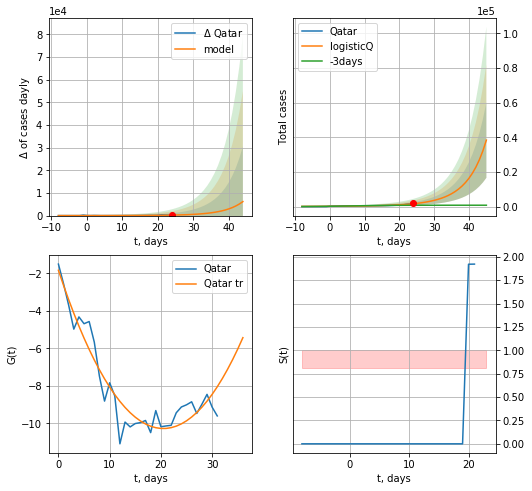

Qatar data at: 2020-08-29
+3 day model MAPE: 1.403665
model: logisticQ
coeffs: [ 4.67644951e+06  1.32940327e-03  6.79780107e+01 -1.11960184e+02]
rational stdev: 0.567221
forecast at the end of period: +21 days
	 deltaDaycases: 6175
	 total cases: 38374 ± 21766
	 total death: 63 ± 107
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


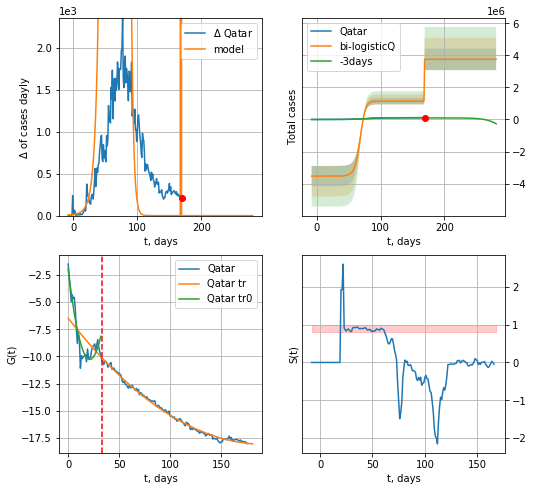

Qatar data at: 2020-08-29
+3 day model MAPE: 36.138205
model: bi-logisticQ
coeffs: [-2.60802558e+06 -4.75141711e+02  1.68155474e+02 -3.70078183e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.179284
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 3752765 ± 672809
	 total death: 6211 ± 3340
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.994031
 intercept_: -6.482359386575723
 coeffs_: [ 0.         -0.12050661  0.00031296]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [2006]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


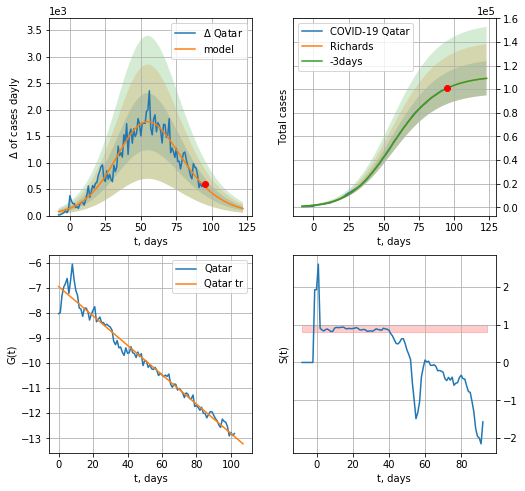

Qatar data at: 2020-08-29
+3 day model MAPE: 0.000426
model: Richards
coeffs: [1.11582674e+05 8.53892196e-02 4.81969406e+01 6.66987844e-01]
rational stdev: 0.132740
forecast at the end of period: +28 days
	 deltaDaycases: 133
	 total cases: 109261 ± 14503
	 total death: 180 ± 71
trend coefficient of determination: 0.972801
 intercept: -6.946309
 slope: -0.058648


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


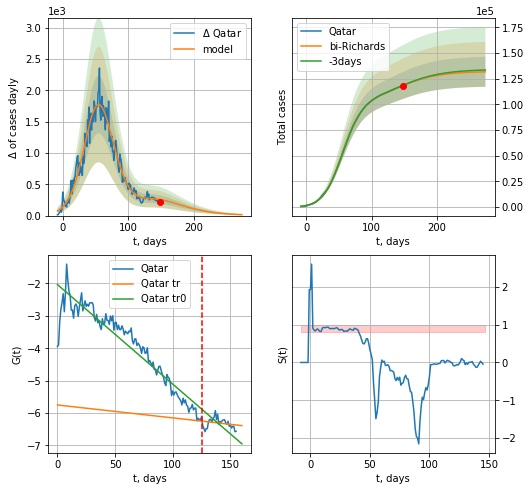

Qatar data at: 2020-08-29
+3 day model MAPE: 0.000807
model: bi-Richards
coeffs: [2.06984562e+04 1.49739464e+00 1.81811817e+01 1.99945043e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.110588
forecast at the end of period: +126 days
	 deltaDaycases: 14
	 total cases: 131798 ± 14575
	 total death: 218 ± 72
bi-Richards approximation splitting point: 125
trend coefficient of determination: 0.889846
 intercept: -2.033993
 slope: -0.030720
trend coefficient of determination: 0.052804
 intercept: -5.750880
 slope: -0.003977


In [2007]:
iL = 21
vL = 125 + iL
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2008]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
192 2020-08-25  67621.0    8490  377.0
193 2020-08-26  68020.0    8572  378.0
194 2020-08-27  68511.0    8661  378.0
195 2020-08-28  68901.0    8661  379.0
196 2020-08-29  69328.0    8747  379.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


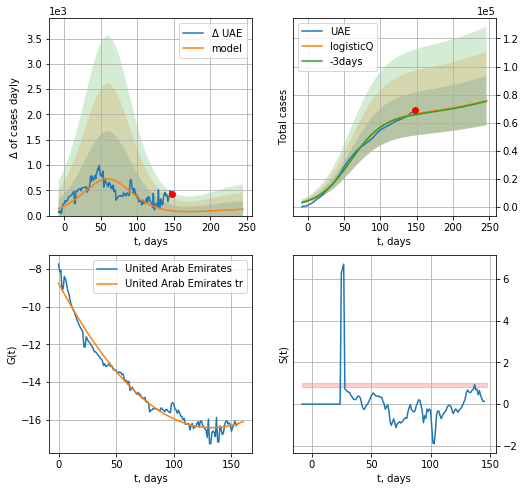

UAE data at: 2020-08-29
+3 day model MAPE: 0.008785
model: logisticQ
coeffs: [ 6.57552358e+04  1.24553444e-07  5.94048607e+01 -3.52088789e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.230949
forecast at the end of period: +98 days
	 deltaDaycases: 126
	 total cases: 75732 ± 17490
	 total death: 414 ± 286
trend coefficient of determination: 0.976466
 intercept_: -8.748606503613761
 coeffs_: [ 0.         -0.11555639  0.00043488]


In [2009]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


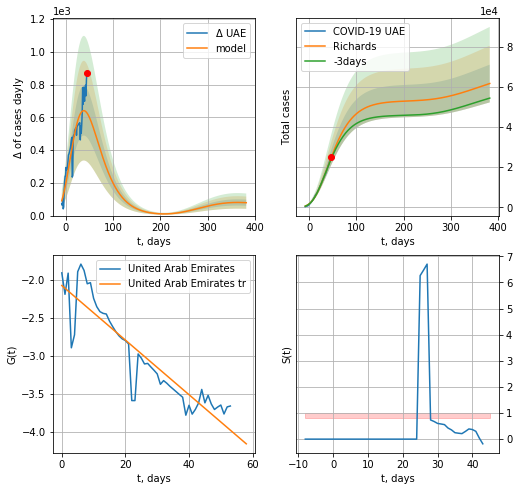

UAE data at: 2020-08-29
+3 day model MAPE: 0.028663
model: Richards
coeffs: [ 5.30983241e+04  1.11859290e+00 -6.66767514e+01  2.97618969e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152464
forecast at the end of period: +336 days
	 deltaDaycases: 78
	 total cases: 61688 ± 9405
	 total death: 337 ± 154
trend coefficient of determination: 0.830364
 intercept: -2.072723
 slope: -0.035923


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


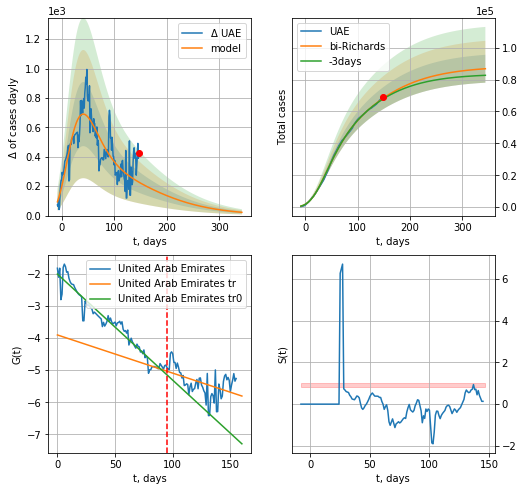

UAE data at: 2020-08-29
+3 day model MAPE: 0.006488
model: bi-Richards
coeffs: [ 3.52149334e+04  9.55002062e-01 -1.58739102e+02  1.51794594e-02]
rational stdev: 0.100731
forecast at the end of period: +196 days
	 deltaDaycases: 22
	 total cases: 86760 ± 8739
	 total death: 474 ± 143
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.942750
 intercept: -2.000512
 slope: -0.033109
trend coefficient of determination: 0.227676
 intercept: -3.900455
 slope: -0.011914


In [2010]:
iL = 40
vL = 95 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,50*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [2011]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
175 2020-08-25  309768.0   22114  3722.0
176 2020-08-26  310836.0   22136  3755.0
177 2020-08-27  311855.0   21815  3785.0
178 2020-08-28  312924.0   21708  3813.0
179 2020-08-29  313911.0   21630  3840.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


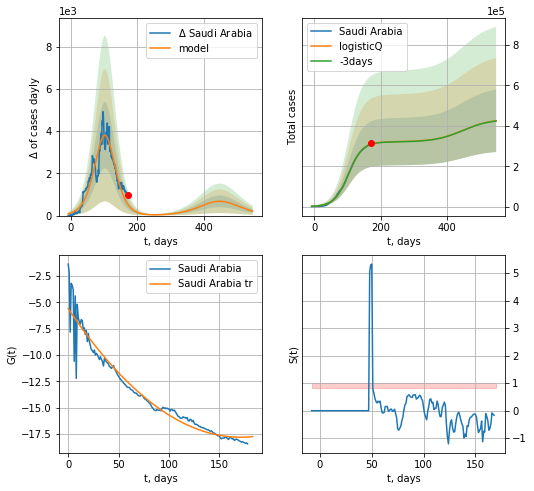

Saudi Arabia data at: 2020-08-29
+3 day model MAPE: 0.002693
model: logisticQ
coeffs: [ 3.21093587e+05  5.30085370e-07  1.03005480e+02 -8.92891043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364287
forecast at the end of period: +378 days
	 deltaDaycases: 211
	 total cases: 425208 ± 154898
	 total death: 5201 ± 5683
trend coefficient of determination: 0.944758
 intercept_: -5.604583708975161
 coeffs_: [ 0.         -0.14254638  0.00041676]


In [2012]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


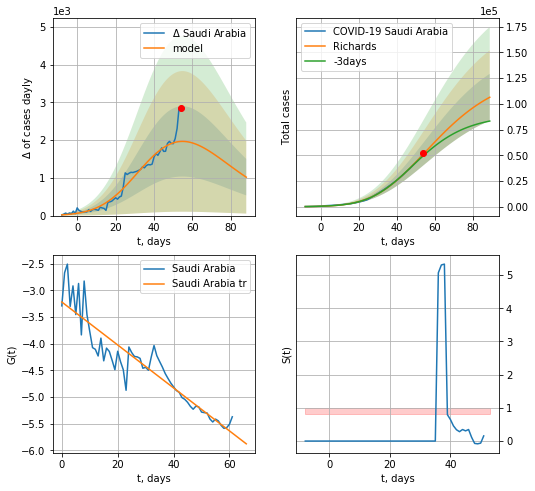

Saudi Arabia data at: 2020-08-29
+3 day model MAPE: 0.035873
model: Richards
coeffs: [1.31817079e+05 1.98592402e-01 2.23760353e+01 2.26893478e-01]
rational stdev: 0.214320
forecast at the end of period: +35 days
	 deltaDaycases: 1017
	 total cases: 106452 ± 22814
	 total death: 1302 ± 837
trend coefficient of determination: 0.862733
 intercept: -3.219410
 slope: -0.040287


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


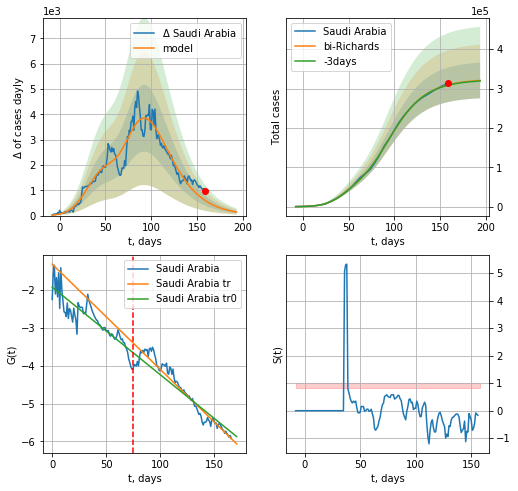

Saudi Arabia data at: 2020-08-29
+3 day model MAPE: 0.003261
model: bi-Richards
coeffs: [ 1.92011593e+05  3.35181659e+00 -2.54399287e+00  1.29313289e-02]
rational stdev: 0.141393
forecast at the end of period: +35 days
	 deltaDaycases: 140
	 total cases: 320632 ± 45335
	 total death: 3922 ± 1663
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.772398
 intercept: -1.920403
 slope: -0.023121
trend coefficient of determination: 0.931068
 intercept: -1.310132
 slope: -0.027810


In [2013]:
x = forecastRR('Saudi Arabia',dfSA[12:75],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
168 2020-08-25  2971.0     143   12.0
169 2020-08-26  2984.0     153   12.0
170 2020-08-27  2986.0     144   12.0
171 2020-08-28  2989.0     135   12.0
172 2020-08-29  2998.0     126   12.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


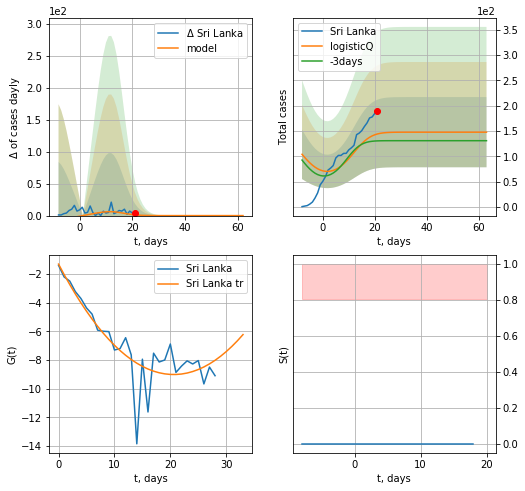

Sri Lanka data at: 2020-08-29
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


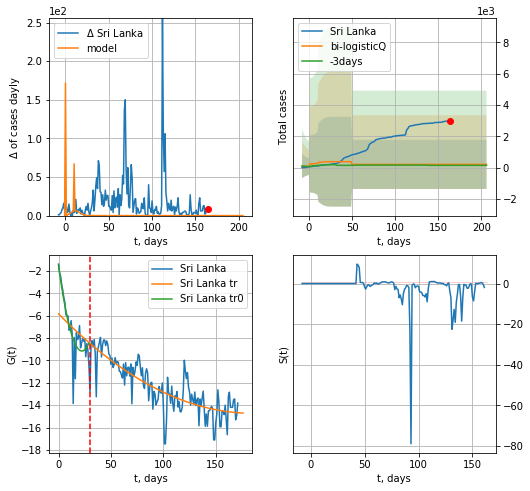

Sri Lanka data at: 2020-08-29
+3 day model MAPE: 0.413761
model: bi-logisticQ
coeffs: [172.75435853  -6.92175896  49.3294242    0.53631669]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 7.513751
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 209 ± 1570
	 total death: 0 ± 0
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.666220
 intercept_: -5.835161534828796
 coeffs_: [ 0.         -0.09583513  0.00025806]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [2014]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

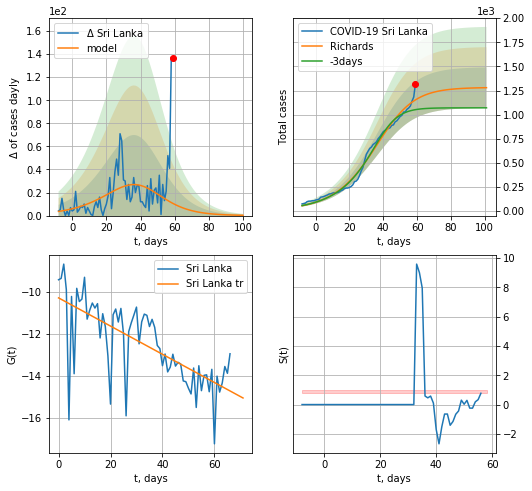

Sri Lanka data at: 2020-08-29
+3 day model MAPE: 0.103361
model: Richards
coeffs: [1.28171157e+03 6.47995832e-02 4.07030001e+01 1.48770145e+00]
rational stdev: 0.164364
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 1279 ± 210
	 total death: 5 ± 2
trend coefficient of determination: 0.481079
 intercept: -10.284657
 slope: -0.067327


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


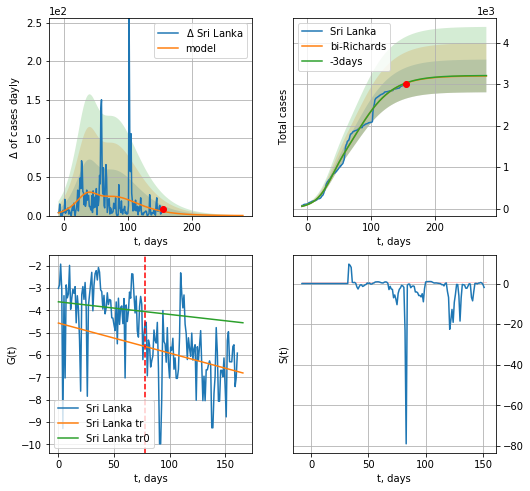

Sri Lanka data at: 2020-08-29
+3 day model MAPE: 0.001556
model: bi-Richards
coeffs: [ 1.91579478e+03  2.56057547e+00 -4.76380422e+01  1.29240608e-02]
rational stdev: 0.123275
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 3194 ± 393
	 total death: 12 ± 4
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.009041
 intercept: -3.613626
 slope: -0.005659
trend coefficient of determination: 0.055666
 intercept: -4.566519
 slope: -0.013467


In [2015]:
vL=88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
180 2020-08-25  294193.0    8987  6267.0
181 2020-08-26  294638.0    8803  6274.0
182 2020-08-27  295053.0    8833  6283.0
183 2020-08-28  295372.0    8748  6284.0
184 2020-08-29  295636.0    8801  6288.0


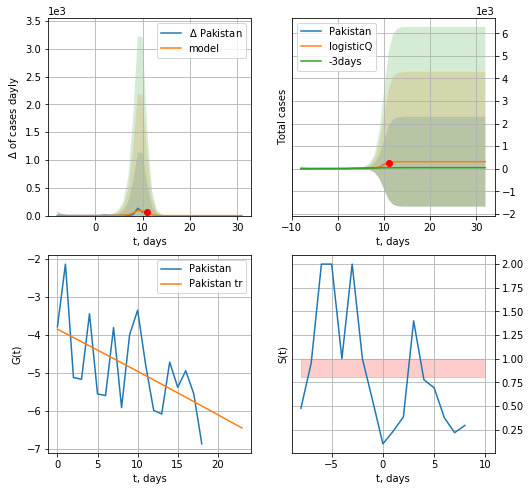

Pakistan data at: 2020-08-29
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


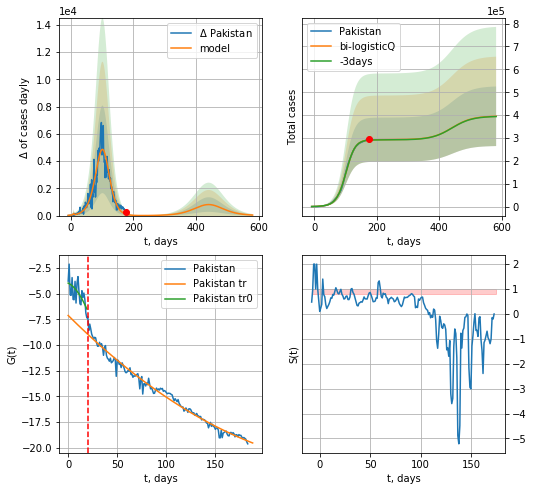

Pakistan data at: 2020-08-29
+3 day model MAPE: 0.002574
model: bi-logisticQ
coeffs: [ 2.92269616e+05  5.49969315e-05  1.01110038e+02 -1.10729277e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329731
forecast at the end of period: +406 days
	 deltaDaycases: 38
	 total cases: 394894 ± 130208
	 total death: 8399 ± 8308
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.982825
 intercept_: -7.126862718063373
 coeffs_: [ 0.         -0.0948507   0.00015345]


In [2016]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


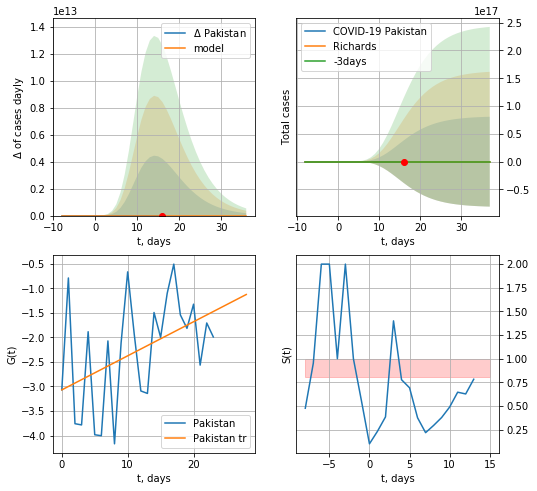

Pakistan data at: 2020-08-29
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
rational stdev: 49944222119087.820312
forecast at the end of period: +21 days
	 deltaDaycases: 4
	 total cases: 1616 ± 80752051001193744
	 total death: 34 ± 5094310656146958
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


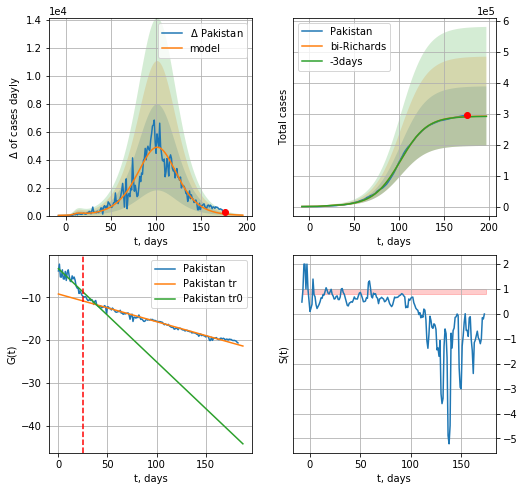

Pakistan data at: 2020-08-29
+3 day model MAPE: 0.002370
model: bi-Richards
coeffs: [2.91371489e+05 6.34144123e-02 1.02942282e+02 1.08477835e+00]
rational stdev: 0.329068
forecast at the end of period: +21 days
	 deltaDaycases: 29
	 total cases: 292594 ± 96283
	 total death: 6223 ± 6143
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.705411
 intercept: -3.309962
 slope: -0.217922
trend coefficient of determination: 0.978330
 intercept: -9.242183
 slope: -0.064714


In [2017]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
170 2020-08-25  299628.0  108844  4028.0
171 2020-08-26  302147.0  107882  4082.0
172 2020-08-27  304583.0  106998  4127.0
173 2020-08-28  306794.0  105784  4174.0
174 2020-08-29  310822.0  104667  4248.0


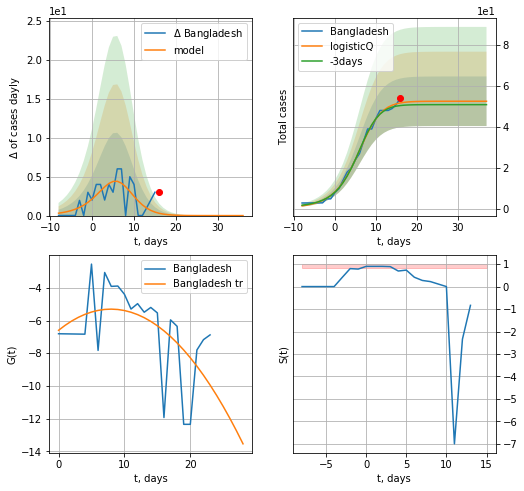

Bangladesh data at: 2020-08-29
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


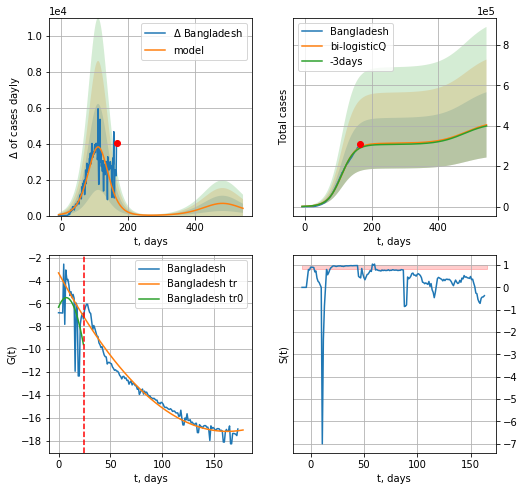

Bangladesh data at: 2020-08-29
+3 day model MAPE: 0.012896
model: bi-logisticQ
coeffs: [ 3.13578449e+05  2.86122819e-07  1.10571001e+02 -1.70179546e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399442
forecast at the end of period: +378 days
	 deltaDaycases: 403
	 total cases: 404772 ± 161683
	 total death: 5532 ± 6629
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.973083
 intercept_: -3.3209412842736636
 coeffs_: [ 0.         -0.17056683  0.000524  ]


In [2018]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

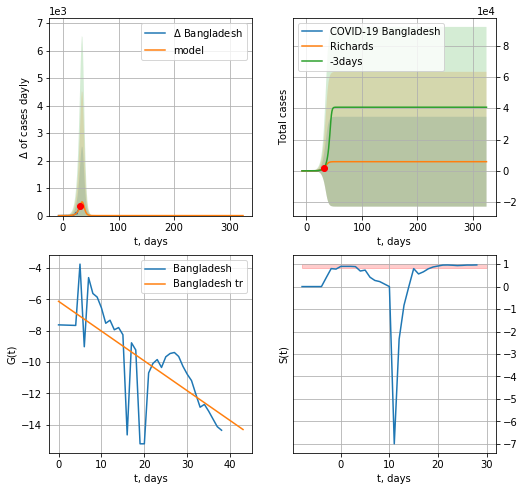

Bangladesh data at: 2020-08-29
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +294 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 79 ± 1164
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


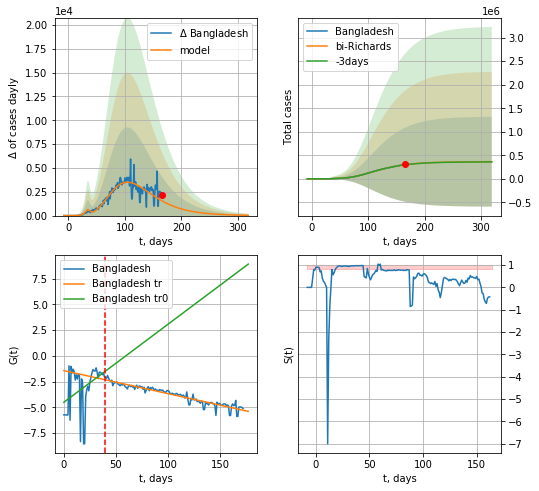

Bangladesh data at: 2020-08-29
+3 day model MAPE: 0.005831
model: bi-Richards
coeffs: [ 3.60158539e+05  1.88881802e+00 -5.52263136e+01  1.40871089e-02]
rational stdev: 2.617076
forecast at the end of period: +154 days
	 deltaDaycases: 32
	 total cases: 364785 ± 954672
	 total death: 4985 ± 39138
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.164934
 intercept: -4.503970
 slope: 0.075764
trend coefficient of determination: 0.903388
 intercept: -1.430551
 slope: -0.022320


In [2019]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
183 2020-08-25  81573.0    7652  519.0
184 2020-08-26  82271.0    7844  521.0
185 2020-08-27  82945.0    7901  522.0
186 2020-08-28  83578.0    7733  525.0
187 2020-08-29  84224.0    7703  528.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


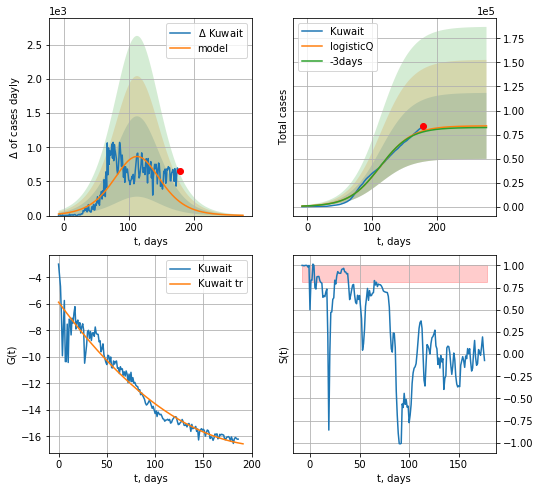

Kuwait data at: 2020-08-29
+3 day model MAPE: 0.013942
model: logisticQ
coeffs: [ 8.40739760e+04  1.24569270e-07  1.13248071e+02 -3.30611130e+05]
rational stdev: 0.408934
forecast at the end of period: +98 days
	 deltaDaycases: 4
	 total cases: 83975 ± 34340
	 total death: 526 ± 645
trend coefficient of determination: 0.940523
 intercept_: -5.877879952889594
 coeffs_: [ 0.         -0.09947874  0.0002279 ]


In [2020]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


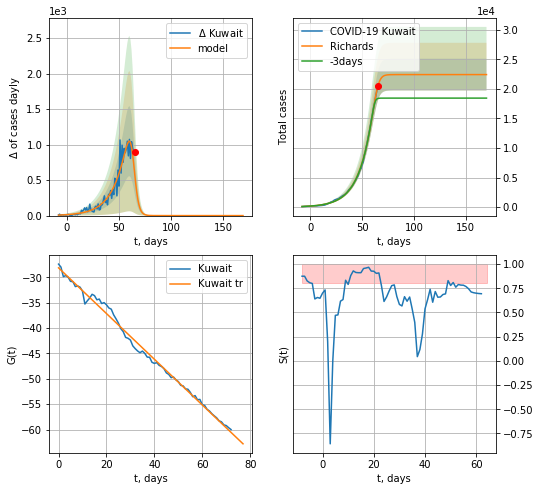

Kuwait data at: 2020-08-29
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +105 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 140 ± 50
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


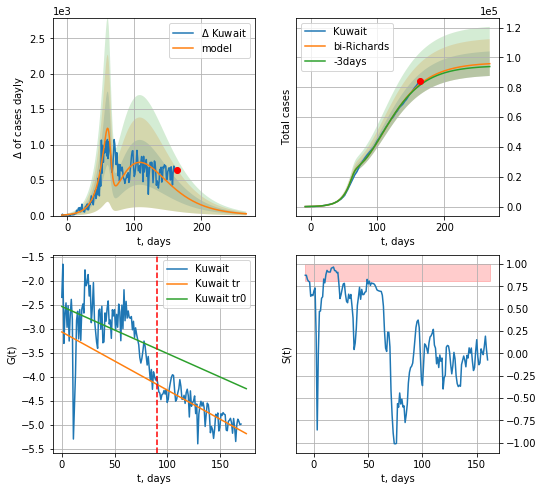

Kuwait data at: 2020-08-29
+3 day model MAPE: 0.008220
model: bi-Richards
coeffs: [ 7.43068997e+04  2.82452525e+00 -5.89995244e+01  9.77469039e-03]
rational stdev: 0.085736
forecast at the end of period: +105 days
	 deltaDaycases: 25
	 total cases: 95836 ± 8216
	 total death: 600 ± 154
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.168410
 intercept: -2.535498
 slope: -0.009772
trend coefficient of determination: 0.663451
 intercept: -3.065566
 slope: -0.012082


In [2021]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active   death
177 2020-08-25  92217.0   28172  1585.0
178 2020-08-26  92557.0   27466  1613.0
179 2020-08-27  92964.0   26987  1630.0
180 2020-08-28  93390.0   26457  1648.0
181 2020-08-29  93732.0   25739  1673.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


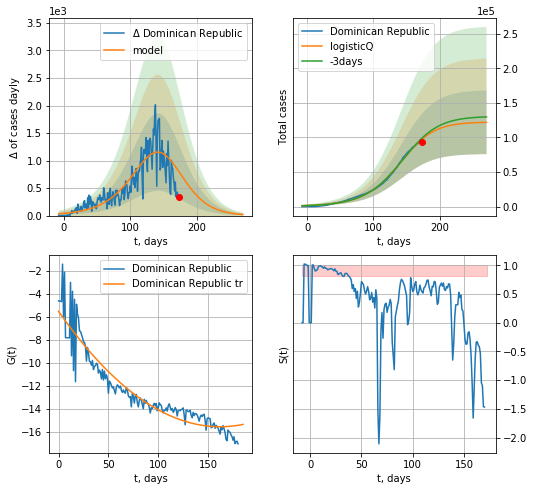

Dominican Republic data at: 2020-08-29
+3 day model MAPE: 0.016610
model: logisticQ
coeffs: [ 1.22262663e+05  4.57988949e-05  1.38529750e+02 -6.82432965e+02]
rational stdev: 0.377365
forecast at the end of period: +98 days
	 deltaDaycases: 19
	 total cases: 121887 ± 45996
	 total death: 2175 ± 2462
trend coefficient of determination: 0.885327
 intercept_: -5.539976239169591
 coeffs_: [ 0.         -0.12387572  0.00038223]


In [2022]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


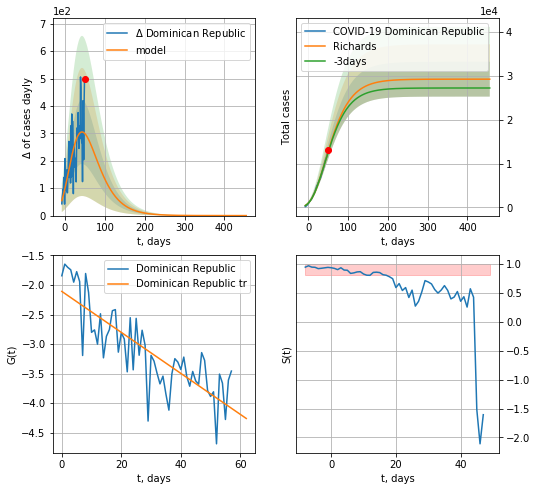

Dominican Republic data at: 2020-08-29
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +406 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 522 ± 212
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


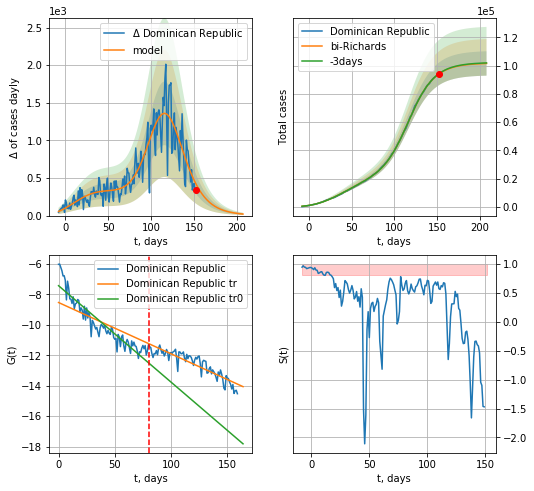

Dominican Republic data at: 2020-08-29
+3 day model MAPE: 0.001511
model: bi-Richards
coeffs: [7.27145914e+04 8.34444176e-02 1.12797952e+02 7.78579710e-01]
rational stdev: 0.084915
forecast at the end of period: +56 days
	 deltaDaycases: 20
	 total cases: 101525 ± 8621
	 total death: 1812 ± 461
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.865261
 intercept: -7.427877
 slope: -0.063370
trend coefficient of determination: 0.808297
 intercept: -8.533822
 slope: -0.033714


In [2023]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
171 2020-08-25  34358.0    9529  960.0
172 2020-08-26  34982.0    9859  967.0
173 2020-08-27  35546.0   10413  977.0
174 2020-08-28  35904.0   10767  981.0
175 2020-08-29  36404.0   10275  990.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


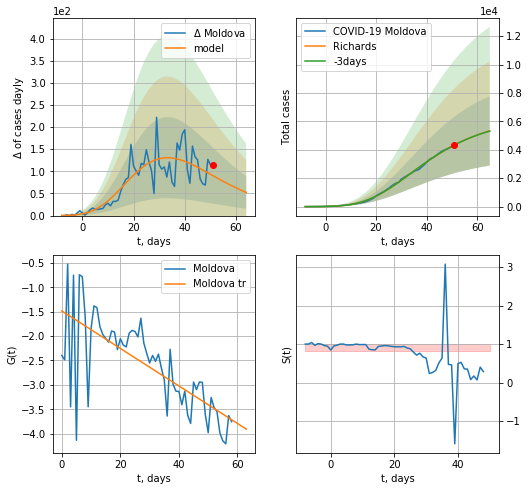

Moldova data at: 2020-08-29
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +14 days
	 deltaDaycases: 52
	 total cases: 5324 ± 2440
	 total death: 144 ± 198
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


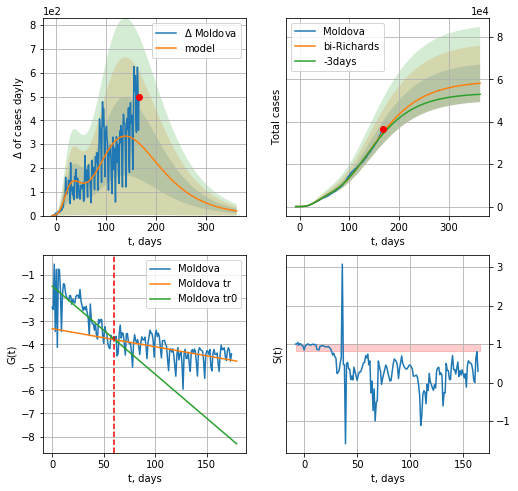

Moldova data at: 2020-08-29
+3 day model MAPE: 0.019617
model: bi-Richards
coeffs: [ 5.29441616e+04  1.46024699e+00 -1.18678055e+02  1.17753450e-02]
rational stdev: 0.152239
forecast at the end of period: +196 days
	 deltaDaycases: 19
	 total cases: 58124 ± 8848
	 total death: 1580 ± 721
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.521071
 intercept: -1.478470
 slope: -0.038194
trend coefficient of determination: 0.274963
 intercept: -3.321633
 slope: -0.007861


In [2024]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [1601]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
173 2020-08-25  613017.0   79328  13308.0
174 2020-08-26  615701.0   76957  13502.0
175 2020-08-27  618286.0   73320  13628.0
176 2020-08-28  620132.0   72454  13743.0
177 2020-08-29  622551.0   71876  13981.0


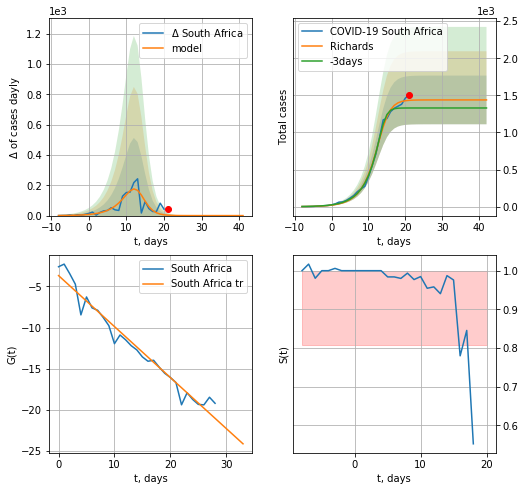

South Africa data at: 2020-08-29
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 32 ± 21
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


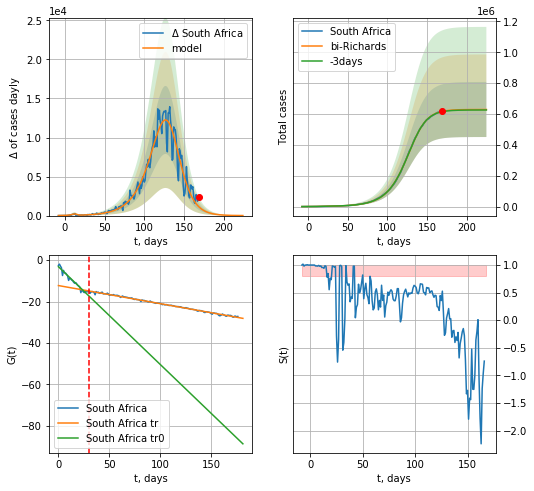

South Africa data at: 2020-08-29
+3 day model MAPE: 0.003523
model: bi-Richards
coeffs: [6.27860047e+05 5.71645888e-02 1.32363895e+02 1.62179207e+00]
rational stdev: 0.283476
forecast at the end of period: +56 days
	 deltaDaycases: 7
	 total cases: 629226 ± 178370
	 total death: 14130 ± 12016
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.947547
 intercept: -3.169464
 slope: -0.472886
trend coefficient of determination: 0.994531
 intercept: -12.288148
 slope: -0.087535


In [2025]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
163 2020-08-25  39790    3518  289.0
164 2020-08-26  40195    3338  295.0
165 2020-08-27  40613    3113  300.0
166 2020-08-28  40953    2701  305.0
167 2020-08-29  41303    2633  311.0


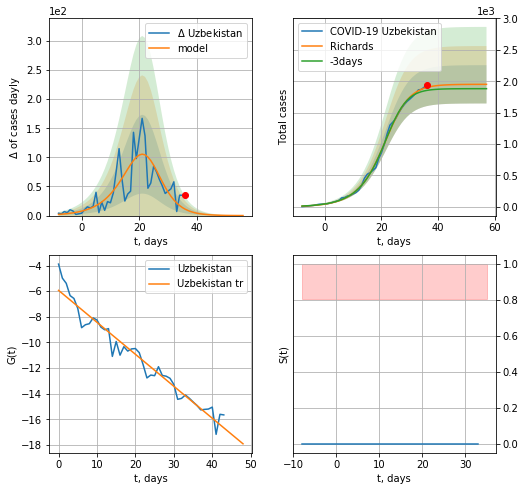

Uzbekistan data at: 2020-08-29
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1950 ± 304
	 total death: 14 ± 6
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


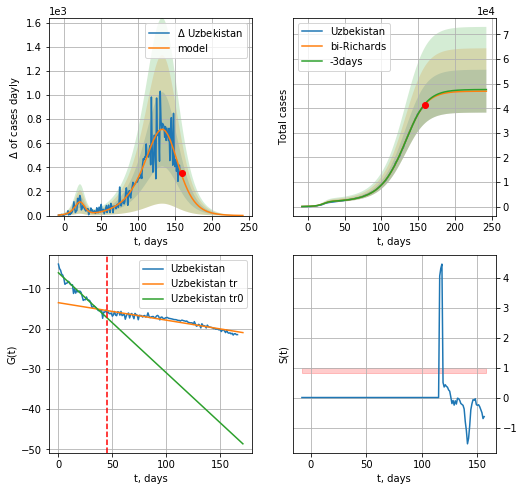

Uzbekistan data at: 2020-08-29
+3 day model MAPE: 0.004380
model: bi-Richards
coeffs: [4.50024821e+04 4.74163537e-02 1.39120567e+02 1.57270195e+00]
rational stdev: 0.185595
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 46940 ± 8712
	 total death: 353 ± 196
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.949337
 intercept: -6.118634
 slope: -0.248573
trend coefficient of determination: 0.903077
 intercept: -13.552751
 slope: -0.043453


In [2026]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [1604]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [1620]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [1621]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,271,857","+7,413","269,770",696,"4,181,078","+4,865","2,821,009","20,403",,,,,,North America,\n,,
1,,\nSouth America\n,"6,201,039",945,"200,051",92,"4,773,295","+1,835","1,227,693","15,134",,,,,,South America,\n,,
2,,\nAsia\n,"6,903,437","+14,561","139,831",197,"5,527,657","+29,372","1,235,949","18,867",,,,,,Asia,\n,,
3,,\nEurope\n,"3,542,387","+9,170","207,308",110,"2,063,028","+4,281","1,272,051","5,617",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,241,912",,"29,472",,"972,908",,"239,532","1,264",,,,,,Africa,\n,,
5,,\nOceania\n,"28,391",131,640,11,"23,166",262,"4,585",44,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"25,189,744","+32,220","847,087","+1,106","17,541,783","+40,615","6,800,874","61,333","3,232",108.7,,,,All,\n,,
8,1,USA,"6,139,466",388,"186,857",2,"3,408,908",109,"2,543,701","16,025","18,530",564,"81,105,190","244,794","331,319,877",North America,54,"1,773",4
9,2,Brazil,"3,846,965",,"120,498",,"3,006,812",,"719,655","8,318","18,077",566,"14,352,484","67,444","212,805,498",South America,55,"1,766",15


In [1622]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,271,857","+7,413","269,770",696,"4,181,078","+4,865","2,821,009","20,403",,,,,,North America,\n,,
1,,\nSouth America\n,"6,201,039",945,"200,051",92,"4,773,295","+1,835","1,227,693","15,134",,,,,,South America,\n,,
2,,\nAsia\n,"6,903,437","+14,561","139,831",197,"5,527,657","+29,372","1,235,949","18,867",,,,,,Asia,\n,,
3,,\nEurope\n,"3,542,387","+9,170","207,308",110,"2,063,028","+4,281","1,272,051","5,617",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,241,912",,"29,472",,"972,908",,"239,532","1,264",,,,,,Africa,\n,,


In [1623]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
134,127,Lithuania,"2,839",,86,,"1,833",,920,5,"1,045",32,"634,751","233,729","2,715,752",Europe,957,"31,579",4
366,127,Lithuania,"2,839",29,86,,"1,833",17,920,5,"1,045",32,"634,751","233,729","2,715,752",Europe,957,"31,579",4
596,125,Lithuania,"2,810",48,86,1,"1,816",14,908,5,"1,035",32,"629,443","231,775","2,715,752",Europe,966,"31,579",4


In [1624]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [1625]:
df.head(50)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,271,857","+7,413","269,770",696,"4,181,078","+4,865","2,821,009","20,403",,,,,,North America,\n,,
1,,\nSouth America\n,"6,201,039",945,"200,051",92,"4,773,295","+1,835","1,227,693","15,134",,,,,,South America,\n,,
2,,\nAsia\n,"6,903,437","+14,561","139,831",197,"5,527,657","+29,372","1,235,949","18,867",,,,,,Asia,\n,,
3,,\nEurope\n,"3,542,387","+9,170","207,308",110,"2,063,028","+4,281","1,272,051","5,617",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,241,912",,"29,472",,"972,908",,"239,532","1,264",,,,,,Africa,\n,,
5,,\nOceania\n,"28,391",131,640,11,"23,166",262,"4,585",44,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"25,189,744","+32,220","847,087","+1,106","17,541,783","+40,615","6,800,874","61,333","3,232",108.7,,,,All,\n,,
8,1,USA,"6,139,466",388,"186,857",2,"3,408,908",109,"2,543,701","16,025","18,530",564,"81,105,190","244,794","331,319,877",North America,54,"1,773",4
9,2,Brazil,"3,846,965",,"120,498",,"3,006,812",,"719,655","8,318","18,077",566,"14,352,484","67,444","212,805,498",South America,55,"1,766",15


In [1626]:
df.at[20, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[45, 'TotalRecovered'] = 0
df.at[48, 'TotalRecovered'] = 0
df.at[20,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[45,"ActiveCases"] = 0
df.at[48,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [1627]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,7271857,7413.0,269770.0,696.0,4181078.0,"+4,865",2821009,20403.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nSouth America\n,6201039,945.0,200051.0,92.0,4773295.0,"+1,835",1227693,15134.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,\nAsia\n,6903437,14561.0,139831.0,197.0,5527657.0,"+29,372",1235949,18867.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,\nEurope\n,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1241912,NaN,29472.0,NaN,972908.0,,239532,1264.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,28391,131.0,640.0,11.0,23166.0,262,4585,44.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,25189744,32220.0,847087.0,1106.0,17541783.0,"+40,615",6800874,61333.0,3232.0,108.7,NaN,NaN,,All,\n,,
8,1,USA,6139466,388.0,186857.0,2.0,3408908.0,109,2543701,16025.0,18530.0,564.0,81105190.0,244794.0,"331,319,877",North America,54,"1,773",4
9,2,Brazil,3846965,NaN,120498.0,NaN,3006812.0,,719655,8318.0,18077.0,566.0,14352484.0,67444.0,"212,805,498",South America,55,"1,766",15


In [1628]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,,Total:,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,,Europe,,,
227,,Total:,1241912,NaN,29472.0,NaN,972908.0,,239532,1264.0,NaN,NaN,NaN,NaN,,Africa,,,
228,,Total:,28391,131.0,640.0,11.0,23166.0,262,4585,44.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
229,,Total:,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,,,
230,NaN,European Union,1856497,2094.0,139833.0,7.0,786766.0,NaN,362382,2423.0,4169.556107,314.054663,56121134.0,126043.951069,NaN,Europe,NaN,NaN,NaN


In [1629]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,7271857,7413.0,269770.0,696.0,4181078.0,"+4,865",2821009,20403.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,South America,6201039,945.0,200051.0,92.0,4773295.0,"+1,835",1227693,15134.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,Asia,6903437,14561.0,139831.0,197.0,5527657.0,"+29,372",1235949,18867.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,Europe,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1241912,NaN,29472.0,NaN,972908.0,,239532,1264.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [1630]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [1631]:
#df

In [1632]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,7271857,7413.0,269770.0,696.0,4181078.0,"+4,865",2821009,20403.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,South America,6201039,945.0,200051.0,92.0,4773295.0,"+1,835",1227693,15134.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,Asia,6903437,14561.0,139831.0,197.0,5527657.0,"+29,372",1235949,18867.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,Europe,3542387,9170.0,207308.0,110.0,2063028.0,"+4,281",1272051,5617.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1241912,NaN,29472.0,NaN,972908.0,,239532,1264.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,28391,131.0,640.0,11.0,23166.0,262,4585,44.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,25189744,32220.0,847087.0,1106.0,17541783.0,"+40,615",6800874,61333.0,3232.0,108.7,NaN,NaN,,All,\n,,
8,1,USA,6139466,388.0,186857.0,2.0,3408908.0,109,2543701,16025.0,18530.0,564.0,81105190.0,244794.0,"331,319,877",North America,54,"1,773",4
9,2,Brazil,3846965,NaN,120498.0,NaN,3006812.0,,719655,8318.0,18077.0,566.0,14352484.0,67444.0,"212,805,498",South America,55,"1,766",15
10,3,India,3546705,6993.0,63690.0,33.0,2714995.0,"+2,475",768020,8944.0,2566.0,46.0,41461636.0,29997.0,"1,382,196,924",Asia,390,"21,702",33


In [1633]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [1634]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [1635]:
len(countryDic)

76

In [1636]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-08-29,7271857,2821009,269770.0
South America
South America
South America 2020-08-29,6201039,1227693,200051.0
Asia
Asia
Asia 2020-08-29,6903437,1235949,139831.0
Europe
Europe
Europe 2020-08-29,3542387,1272051,207308.0
Africa
Africa
Africa 2020-08-29,1241912,239532,29472.0
Oceania
Oceania
Oceania 2020-08-29,28391,4585,640.0
World
World
World 2020-08-29,25189744,6800874,847087.0
USA
USA
USA 2020-08-29,6139466,2543701,186857.0
Brazil
Brazil
Brazil 2020-08-29,3846965,719655,120498.0
India
India
India 2020-08-29,3546705,768020,63690.0
Russia
Russia
Russia 2020-08-29,990326,166251,17093.0
Peru
Peru
Peru 2020-08-29,639435,164153,28607.0
South Africa
South Africa
South Africa 2020-08-29,622551,71876,13981.0
Colombia
Colombia
Colombia 2020-08-29,599914,140276,19064.0
Mexico
Mexico
Mexico 2020-08-29,591712,118766,63819.0
Spain
Spain
Spain 2020-08-29,455621,0,29011.0
Chile
Chile
Chile 2020-08-29,408009,15645,11181.0
Argentina
Argentina
Argentina 2020-

Belize 2020-08-29,964,836,13.0
Sao Tome and Principe
Sao Tome and Principe
Sao Tome and Principe 2020-08-29,895,32,15.0
Myanmar
Myanmar
Myanmar 2020-08-29,749,392,6.0
Diamond Princess
Diamond Princess
Diamond Princess 2020-08-29,712,48,13.0
San Marino
San Marino
San Marino 2020-08-29,710,10,42.0
Channel Islands
Channel Islands
Channel Islands 2020-08-29,625,32,48.0
Martinique
Martinique
Martinique 2020-08-29,596,482,16.0
Tanzania
Tanzania
Tanzania 2020-08-29,509,305,21.0
Turks and Caicos
Turks and Caicos
Turks and Caicos 2020-08-29,490,339,3.0
Taiwan
Taiwan
Taiwan 2020-08-29,488,19,7.0
French Polynesia
French Polynesia
French Polynesia 2020-08-29,482,280,nan
Sint Maarten
Sint Maarten
Sint Maarten 2020-08-29,460,264,17.0
Papua New Guinea
Papua New Guinea
Papua New Guinea 2020-08-29,459,222,5.0
Burundi
Burundi
Burundi 2020-08-29,445,87,1.0
Comoros
Comoros
Comoros 2020-08-29,423,17,7.0
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-08-29,411,49,nan
Mauritius
Mauritius
Mauritius 2020-08

In [1637]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [1638]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-08-29,6139466,2543701,186857.0

append data/coronaIT.csv 2020-08-29,266853,23156,35473.0

append data/coronaSP.csv 2020-08-29,455621,0,29011.0

append data/coronaGR.csv 2020-08-29,242825,15978,9363.0

append data/coronaFR.csv 2020-08-29,272530,155751,30602.0

append data/coronaIN.csv 2020-08-29,371816,30610,21359.0

append data/coronaGB.csv 2020-08-29,332752,0,41498.0

append data/coronaSZ.csv 2020-08-29,41722,4517,2005.0

append data/coronaKR.csv 2020-08-29,19699,4473,323.0

append data/coronaNG.csv 2020-08-29,10611,999,264.0

append data/coronaSW.csv 2020-08-29,83958,0,5821.0

append data/coronaIS.csv 2020-08-29,113648,20151,909.0

append data/coronaDK.csv 2020-08-29,16779,1166,624.0

append data/coronaPL.csv 2020-08-29,66870,18645,2033.0

append data/coronaES.csv 2020-08-29,2373,221,64.0

append data/coronaUkr.csv 2020-08-29,119074,59813,2527.0

append data/coronaLV.csv 2020-08-29,1393,196,34.0

append data/coronaLT.csv 2020-08-29,2839,920,86.0

append 

In [1639]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [1640]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 38143


In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [ ]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

In [ ]:
TT/7.7776e3

In [ ]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

In [ ]:
sum(dfp.Population)/1e6

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [ ]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

In [ ]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

In [ ]:
#dfAll

In [ ]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

In [ ]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [ ]:
len(CList)

In [ ]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400